In [22]:
library(DESeq2)
library(RColorBrewer)
library(reshape2)
library("gplots")
library("GGally")                      # Load GGally package
library(goseq)
library(readxl)
library(tidyverse)
library("pheatmap")
library(corrplot)
library(circlize)

In [23]:
library(ComplexUpset)

In [24]:
library(ggrepel)

In [25]:
library(ComplexHeatmap)

In [26]:
options(repr.plot.width = 10, repr.plot.height = 10, repr.plot.res = 300)

In [27]:
hpath_fname = file.path('..', 'genomes', 'HOT1A3', 'HOT1A3_protein_list.csv')
hpath_df = read.csv(hpath_fname)


# Enrichment of differentially expressed proteins and transcripts

Compare DE genes and DE proteins and run enrichment for all

In [28]:
rnaseq_dpath = file.path('..', 'RNASEQ', 'DE_results')
list.files(rnaseq_dpath)


[1] "HOT1A3_DE_DESEQ_longterm_results.csv"       
 [2] "HOT1A3_DE_DESEQ_results.csv"                
 [3] "HOT1A3_DE_DESEQ_results_ref_vs_long.csv"    
 [4] "HOT1A3_DE_DESEQ_vsd.csv"                    
 [5] "HOT1A3_DE_genes_DESEQ_ref_vs_long_wKEGG.csv"
 [6] "HOT1A3_GOSEQ_results_ref_vs_long.csv"       
 [7] "MED4_DE_DESEQ_longterm_results.csv"         
 [8] "MED4_DE_DESEQ_results.csv"                  
 [9] "MED4_DE_DESEQ_results_ref_vs_long.csv"      
[10] "MED4_DE_DESEQ_vsd.csv"                      
[11] "MED4_DE_genes_DESEQ_wKEGG_ref_vs_long.csv"  
[12] "MED4_GOSEQ_results_ref_vs_long.csv"

In [29]:
proteome_dpath = file.path('..', 'Proteome', 'data')
list.files(proteome_dpath)


[1] "A_axenic_proteome.txt"                                                                          
 [2] "A_axenic_proteome_norm.txt"                                                                     
 [3] "ALT_Axenic_DE.csv"                                                                              
 [4] "ALT_CC_DE.csv"                                                                                  
 [5] "C_ALT_proteome.txt"                                                                             
 [6] "C_ALT_proteome_norm.txt"                                                                        
 [7] "C_PRO_proteome.txt"                                                                             
 [8] "C_PRO_proteome_norm.txt"                                                                        
 [9] "Nov22_Processing.xlsx"                                                                          
[10] "P_axenic_proteome.txt"                                                                          
[11] "P_axenic_proteome_norm.txt"                                                                     
[12] "PRO_Axenic_DE.csv"                                                                              
[13] "PRO_CC_DE.csv"                                                                                  
[14] "uniprot-compressed_true_download_true_fields_accession_2Cid_2Cprotei-2023.01.11-12.43.22.99.txt"

In [30]:
df_rnaseq1 = read.csv(file.path(rnaseq_dpath,'HOT1A3_DE_DESEQ_longterm_results.csv'))  %>% 
   mutate(gene_id = str_replace(gene_id, '\\.\\.\\.\\d+', '')) 

df_rnaseq2 = read.csv(file.path(rnaseq_dpath,'HOT1A3_DE_DESEQ_results.csv')) %>% 
   mutate(gene_id = str_replace(gene_id, '\\.\\.\\.\\d+', '')) 

In [31]:
unique(df_rnaseq2$contrast)

[1] "A2vsA1" "A3vsA1" "A3vsA2" "C1vsA1" "C2vsC1" "C3vsC1" "C4vsC1" "C5vsC1"
 [9] "C3vsC2" "C4vsC3" "C5vsC4"

In [32]:
df_prot1 = read.csv(file.path(proteome_dpath,'ALT_CC_DE.csv'))
df_prot2 = read.csv(file.path(proteome_dpath,'ALT_Axenic_DE.csv'))

In [33]:
names(df_rnaseq1)
names(df_rnaseq2)
names(df_prot1)
names(df_prot2)



[1] "gene_id"        "baseMean"       "log2FoldChange" "lfcSE"         
 [5] "stat"           "pvalue"         "padj"           "contrast"      
 [9] "na_pvalue"      "na_padj"        "significant"    "direction"     
[13] "status"

[1] "gene_id"        "baseMean"       "log2FoldChange" "lfcSE"         
 [5] "stat"           "pvalue"         "padj"           "contrast"      
 [9] "na_pvalue"      "na_padj"        "significant"    "direction"     
[13] "status"

[1] "X"            "logFC"        "AveExpr"      "t"            "P.Value"     
 [6] "adj.P.Val"    "B"            "gene"         "count"        "sca.t"       
[11] "sca.P.Value"  "sca.adj.pval" "contrast"     "log.sca.pval"

[1] "X"            "logFC"        "AveExpr"      "t"            "P.Value"     
 [6] "adj.P.Val"    "B"            "gene"         "count"        "sca.t"       
[11] "sca.P.Value"  "sca.adj.pval" "contrast"     "log.sca.pval"

In [34]:
dp1 = df_prot1 %>%  select(
    'contrast','gene','logFC','AveExpr',
    'sca.P.Value','sca.adj.pval') %>%
    rename('logFC' = 'logFC','AveExpr' = 'AveExpr',
    'pvalue' = 'sca.P.Value','padj' = 'sca.adj.pval', 'protein_id'='gene') %>%
    mutate(Assay = 'Proteome')
dp2 = df_prot2 %>%  select(
    'contrast','gene','logFC','AveExpr',
    'sca.P.Value','sca.adj.pval') %>%
    rename('logFC' = 'logFC','AveExpr' = 'AveExpr',
    'pvalue' = 'sca.P.Value','padj' = 'sca.adj.pval', 'protein_id'='gene')%>%
    mutate(Assay = 'Proteome')


In [35]:
dr1 = df_rnaseq1 %>% 
    select(
        'contrast', 'gene_id','baseMean','log2FoldChange',
        'pvalue','padj',
    ) %>%
    rename('logFC' = 'log2FoldChange','AveExpr' = 'baseMean',
    'pvalue' = 'pvalue','padj' = 'padj') %>%
    mutate(Assay = 'RNA')
dr2 = df_rnaseq2 %>% 
    select(
        'contrast', 'gene_id','baseMean','log2FoldChange',
        'pvalue','padj',
    ) %>%
    rename('logFC' = 'log2FoldChange','AveExpr' = 'baseMean',
    'pvalue' = 'pvalue','padj' = 'padj') %>%
    mutate(Assay = 'RNA')
    


In [36]:
dput(sort(unique(df_prot1$contrast)))
dput(sort(unique(df_prot2$contrast)))
dput(sort(unique(df_rnaseq1$contrast)))
dput(sort(unique(df_rnaseq2$contrast)))


c("C2 - C1", "C3 - C1", "C3 - C2", "C4 - C1", "C4 - C3", "C5 - C1", 
"C5 - C4", "Clongterm - C1", "Clongterm - C2", "Clongterm - C3"
)
c("A2 - A1", "A3 - A1", "A3 - A2", "A5 - A1", "A5 - A3")
c("longtermvsA1", "longtermvsA2", "longtermvsA3", "longtermvsC1", 
"longtermvsC2", "longtermvsC3")
c("A2vsA1", "A3vsA1", "A3vsA2", "C1vsA1", "C2vsC1", "C3vsC1", 
"C3vsC2", "C4vsC1", "C4vsC3", "C5vsC1", "C5vsC4")


In [37]:
lookup <- c(
    "C2 - C1" = 'C2vsC1_prot', 
    "C3 - C1" = 'C3vsC1_prot', 
    "C4 - C1" = 'C4vsC1_prot', 
    "C5 - C1" = 'C5vsC1_prot',

    "C3 - C2" = 'C3vsC2_prot', 
    "C4 - C2" = 'C4vsC2_prot', 
    "C5 - C2" = 'C5vsC2_prot', 

    "C4 - C3" = 'C4vsC3_prot', 
    "C5 - C3" = 'C5vsC3_prot', 
    "C5 - C4" = 'C5vsC4_prot', 

    "Clongterm - C1" = 'LATEvsC1_prot', 
    "Clongterm - C2" = 'LATEvsC2_prot', 
    "Clongterm - C3" = 'LATEvsC3_prot', 

    "A2 - A1" = 'A2vsA1_prot',
    "A3 - A1" = 'A3vsA1_prot',
    "A5 - A1" = 'A5vsA1_prot',
    "A3 - A2" = 'A3vsA2_prot',
    "A5 - A3" = 'A5vsA3_prot',
    "Intercept" = "Intercept",

    "longtermvsA1" = 'LATEvsA1_rna', 
    "longtermvsA2" = 'LATEvsA2_rna', 
    "longtermvsA3" = 'LATEvsA3_rna', 
    "longtermvsC1" = 'LATEvsC1_rna', 
    "longtermvsC2" = 'LATEvsC2_rna', 
    "longtermvsC3" = 'LATEvsC3_rna', 

    "A2vsA1" = 'A2vsA1_rna', 
    "A3vsA1" = 'A3vsA1_rna', 
    "A3vsA2" = 'A3vsA2_rna', 
    "C1vsA1" = 'C1vsA1_rna', 
    "C2vsC1" = 'C2vsC1_rna', 
    "C3vsC1" = 'C3vsC1_rna', 
    "C4vsC1" = 'C4vsC1_rna', 
    "C5vsC1" = 'C5vsC1_rna',
    "C3vsC2" = 'C3vsC2_rna', 
    "C4vsC3" = 'C4vsC3_rna',
    #"C5vsC3" = 'C5vsC3_rna',
    "C5vsC4" = 'C5vsC4_rna'
)
    
    


In [38]:
dr1 = dr1 %>% mutate(contrast1 = lookup[contrast]) %>% filter(contrast != 'Intercept')
dr2 = dr2 %>% mutate(contrast1 = lookup[contrast]) %>% filter(contrast != 'Intercept')
dp1 = dp1 %>% mutate(contrast1 = lookup[contrast]) %>% filter(contrast != 'Intercept')
dp2 = dp2 %>% mutate(contrast1 = lookup[contrast]) %>% filter(contrast != 'Intercept')


In [39]:
names(hpath_df)

[1] "seq_id"             "Name"               "gene"              
 [4] "gene_synonym"       "locus_tag"          "old_locus_tag"     
 [7] "source"             "start"              "end"               
[10] "strand"             "Note"               "exception"         
[13] "inference"          "product"            "protein_id"        
[16] "gene_length"        "path_id"            "main"              
[19] "sub"                "path"               "ecpath"            
[22] "Category"           "Membrane.transport" "kegg_gene1"        
[25] "kegg_gene2"

In [40]:
dp1 = left_join(dp1, hpath_df, by='protein_id') %>% mutate(gene_id = locus_tag)
dp2 = left_join(dp2, hpath_df, by='protein_id') %>% mutate(gene_id = locus_tag)


Warning message in left_join(dp1, hpath_df, by = "protein_id"):
"Each row in `x` is expected to match at most 1 row in `y`.
ℹ Row 1298 of `x` matches multiple rows.
ℹ If multiple matches are expected, set `multiple = "all"` to silence this warning."
Warning message in left_join(dp2, hpath_df, by = "protein_id"):
"Each row in `x` is expected to match at most 1 row in `y`.
ℹ Row 555 of `x` matches multiple rows.
ℹ If multiple matches are expected, set `multiple = "all"` to silence this warning."


In [41]:
names(dp1)# %>% mutate(gene_id = locus_tag)

[1] "contrast"           "protein_id"         "logFC"             
 [4] "AveExpr"            "pvalue"             "padj"              
 [7] "Assay"              "contrast1"          "seq_id"            
[10] "Name"               "gene"               "gene_synonym"      
[13] "locus_tag"          "old_locus_tag"      "source"            
[16] "start"              "end"                "strand"            
[19] "Note"               "exception"          "inference"         
[22] "product"            "gene_length"        "path_id"           
[25] "main"               "sub"                "path"              
[28] "ecpath"             "Category"           "Membrane.transport"
[31] "kegg_gene1"         "kegg_gene2"         "gene_id"

In [42]:
 dr1 = left_join(dr1, hpath_df, by=c('gene_id'='locus_tag'))
 dr2 = left_join(dr2, hpath_df, by=c('gene_id'='locus_tag'))
 


In [43]:
df_all = bind_rows(dp1, dp2, dr1, dr2)

In [44]:
df_all = df_all %>% 
    mutate(
        Category = if_else(is.na(Category), 'Uncharacterized', Category),
        Category = if_else(Category == 'Poorly characterized', 'Uncharacterized', Category)
          )

In [45]:
dput(unique(df_all$contrast))

c("C2 - C1", "C3 - C1", "C4 - C1", "C5 - C1", "C3 - C2", "C4 - C3", 
"C5 - C4", "Clongterm - C1", "Clongterm - C2", "Clongterm - C3", 
"A2 - A1", "A3 - A1", "A5 - A1", "A3 - A2", "A5 - A3", "longtermvsA1", 
"longtermvsA2", "longtermvsA3", "longtermvsC1", "longtermvsC2", 
"longtermvsC3", "A2vsA1", "A3vsA1", "A3vsA2", "C1vsA1", "C2vsC1", 
"C3vsC1", "C4vsC1", "C5vsC1", "C3vsC2", "C4vsC3", "C5vsC4")


In [46]:
df_all %>% count(contrast1, contrast,  .drop = FALSE)


contrast1,contrast,n
<chr>,<chr>,<int>
A2vsA1_prot,A2 - A1,2229
A2vsA1_rna,A2vsA1,4015
A3vsA1_prot,A3 - A1,2229
A3vsA1_rna,A3vsA1,4015
A3vsA2_prot,A3 - A2,2229
A3vsA2_rna,A3vsA2,4015
A5vsA1_prot,A5 - A1,2229
A5vsA3_prot,A5 - A3,2229
C1vsA1_rna,C1vsA1,4015


# GOSEQ

In [47]:
names(df_all)

[1] "contrast"           "protein_id"         "logFC"             
 [4] "AveExpr"            "pvalue"             "padj"              
 [7] "Assay"              "contrast1"          "seq_id"            
[10] "Name"               "gene"               "gene_synonym"      
[13] "locus_tag"          "old_locus_tag"      "source"            
[16] "start"              "end"                "strand"            
[19] "Note"               "exception"          "inference"         
[22] "product"            "gene_length"        "path_id"           
[25] "main"               "sub"                "path"              
[28] "ecpath"             "Category"           "Membrane.transport"
[31] "kegg_gene1"         "kegg_gene2"         "gene_id"

In [48]:
df_all = df_all %>% 
    mutate(
        down = ((logFC < 0) & (padj < 0.05)),
        up   = ((logFC > 0) & (padj < 0.05)),
        is_de   = (padj < 0.05),
)

In [49]:
kegg_fname = file.path('..', 'genomes', 'HOT1A3', 'signalp_ROS_protease','HOT1A3_ROS_protease.csv')
kegg_df = read.csv(kegg_fname)


In [52]:
kegg_df <- kegg_df %>% 
    mutate(
        ROS_degradation_b = if_else(ROS_degradation == 'ROS_degradation', TRUE, FALSE),
        Protease_Aminase_b = if_else(Protease_Aminase == 'Protease/Aminase', TRUE, FALSE),
        is_signal_b = if_else(is_signal == 'Is Signal', TRUE, FALSE),
        EXOprotease = Protease_Aminase_b & is_signal_b,
    )

In [56]:
table(kegg_df$is_signal_b)
table(kegg_df$ROS_degradation_b)
table(kegg_df$Protease_Aminase_b)
table(kegg_df$EXOprotease)


FALSE  TRUE 
 3299   724 


FALSE  TRUE 
 4007    16 


FALSE  TRUE 
 3990    33 


FALSE  TRUE 
 4009    14 

In [53]:
t(kegg_df)

seq_id,NZ_CP012202.1,NZ_CP012202.1,NZ_CP012202.1,NZ_CP012202.1,NZ_CP012202.1,NZ_CP012202.1,NZ_CP012202.1,NZ_CP012202.1,NZ_CP012202.1,NZ_CP012202.1,⋯,NZ_CP012203.1,NZ_CP012203.1,NZ_CP012203.1,NZ_CP012203.1,NZ_CP012203.1,NZ_CP012203.1,NZ_CP012203.1,NZ_CP012203.1,NZ_CP012203.1,NZ_CP012203.1
Name,dnaN,recF,gyrB,ACZ81_RS00025,glyS,glyQ,ACZ81_RS00040,ACZ81_RS00045,yihI,ACZ81_RS00055,⋯,ACZ81_RS20665,ACZ81_RS20670,ACZ81_RS20675,ACZ81_RS20680,ACZ81_RS20685,ACZ81_RS20690,ACZ81_RS21705,ACZ81_RS20705,ACZ81_RS20720,ACZ81_RS20730
gene,dnaN,recF,gyrB,,glyS,glyQ,(tag),,yihI,,⋯,,,"(copC,pcoC)",(pcoD),,,,,,
gene_synonym,,,,,,,,,,,⋯,,,,,,,,,,
locus_tag,ACZ81_RS00010,ACZ81_RS00015,ACZ81_RS00020,ACZ81_RS00025,ACZ81_RS00030,ACZ81_RS00035,ACZ81_RS00040,ACZ81_RS00045,ACZ81_RS00050,ACZ81_RS00055,⋯,ACZ81_RS20665,ACZ81_RS20670,ACZ81_RS20675,ACZ81_RS20680,ACZ81_RS20685,ACZ81_RS20690,ACZ81_RS21705,ACZ81_RS20705,ACZ81_RS20720,ACZ81_RS20730
old_locus_tag,ACZ81_00010,ACZ81_00015,ACZ81_00020,ACZ81_00025,ACZ81_00030,ACZ81_00035,ACZ81_00040,ACZ81_00045,ACZ81_00050,ACZ81_00055,⋯,ACZ81_20665,ACZ81_20670,ACZ81_20675,ACZ81_20680,ACZ81_20685,ACZ81_20690,,ACZ81_20705,ACZ81_20720,ACZ81_20730
source,Protein Homology,Protein Homology,Protein Homology,Protein Homology,Protein Homology,Protein Homology,Protein Homology,Protein Homology,Protein Homology,Protein Homology,⋯,Protein Homology,Protein Homology,Protein Homology,Protein Homology,Protein Homology,GeneMarkS-2+,Protein Homology,Protein Homology,Protein Homology,Protein Homology
start,1625,2851,3948,6540,7069,9150,10202,10923,11404,12035,⋯,137892,138872,139444,139819,140727,141226,142282,143592,146726,147705
end,2725,3939,6368,6983,9147,10055,10810,11384,11907,12736,⋯,138131,139363,139797,140706,141197,141534,142794,144026,147064,148115
strand,+,+,+,-,-,-,+,-,-,-,⋯,-,+,+,+,+,+,+,+,+,+
Note,,,,,,,,,,,⋯,,,,,,,,,,


In [60]:
run_enrichment <- function(contrastname, categorycolname, testcolname) {
    #cat_df = path_df %>% select(encolname, main) %>% distinct()    
    print(contrastname)
    print(testcolname)
    
    mpath_df = kegg_df %>%
       rename(gene_id = locus_tag) %>%
       select(gene_id, categorycolname)
    test_df = df_all %>% drop_na(padj) %>% filter(contrast1 == contrastname)
    test_df$sigval = if_else(test_df[[testcolname]], 1, 0)
    DEgenes = test_df$sigval
    names(DEgenes) = test_df$gene_id
    #table(DEgenes)
    LENgenes = test_df$gene_length
    names(LENgenes) = test_df$gene_id
    pwf = nullp(DEgenes, bias.data=LENgenes)
    goseq_res = goseq(pwf, gene2cat = as.data.frame(mpath_df))
    goseq_res = goseq_res %>% filter(numInCat>=5) 
    goseq_res$padj = p.adjust(goseq_res$over_represented_pvalue, method="BH")
    goseq_res = goseq_res %>%
       relocate(padj, .after = over_represented_pvalue) #%>%
       #relocate(PATH, .after = category) 
    goseq_res$type = testcolname
    goseq_res$PATH = categorycolname
    goseq_res$contrast = contrastname
    goseq_res$organism = 'HOT1A3'
    #return(mpath_df)
    return (goseq_res)
}

[1] "C2vsC1_prot"
[1] "down"


Warning message:
"Using an external vector in selections was deprecated in tidyselect 1.1.0.
ℹ Please use `all_of()` or `any_of()` instead.
  # Was:
  data %>% select(categorycolname)

  # Now:
  data %>% select(all_of(categorycolname))

See <https://tidyselect.r-lib.org/reference/faq-external-vector.html>."
Warning message in pcls(G):
"initial point very close to some inequality constraints"
Using manually entered categories.

Calculating the p-values...



[1] "C2vsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"
Using manually entered categories.

Calculating the p-values...



[1] "C2vsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


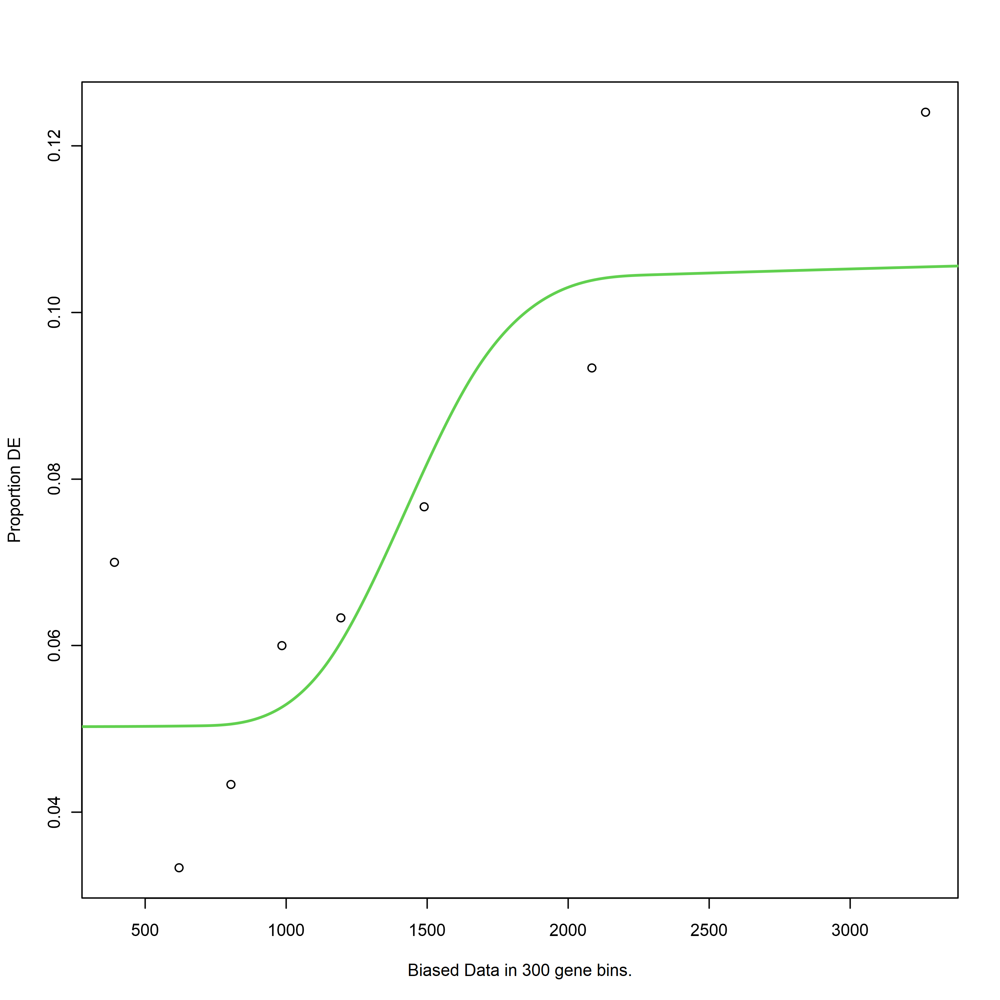

Using manually entered categories.

Calculating the p-values...



[1] "C2vsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


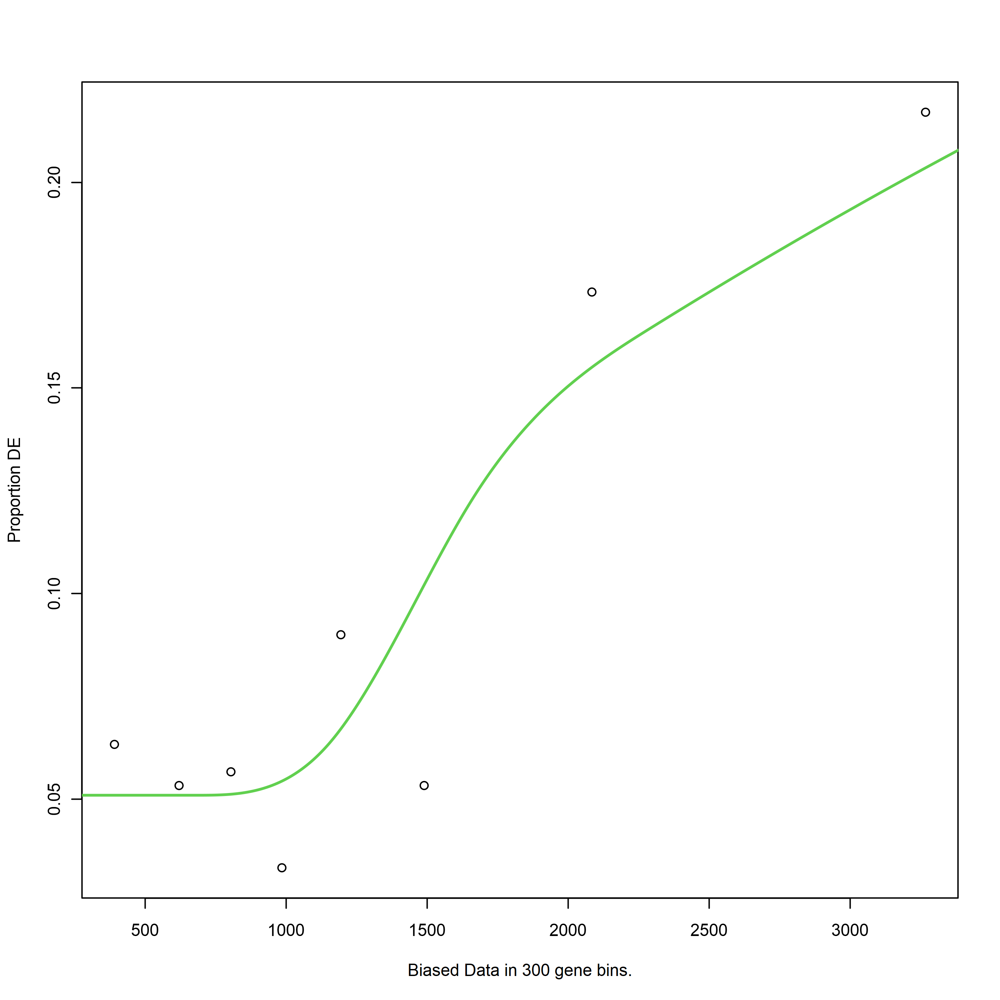

Using manually entered categories.

Calculating the p-values...



[1] "C2vsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


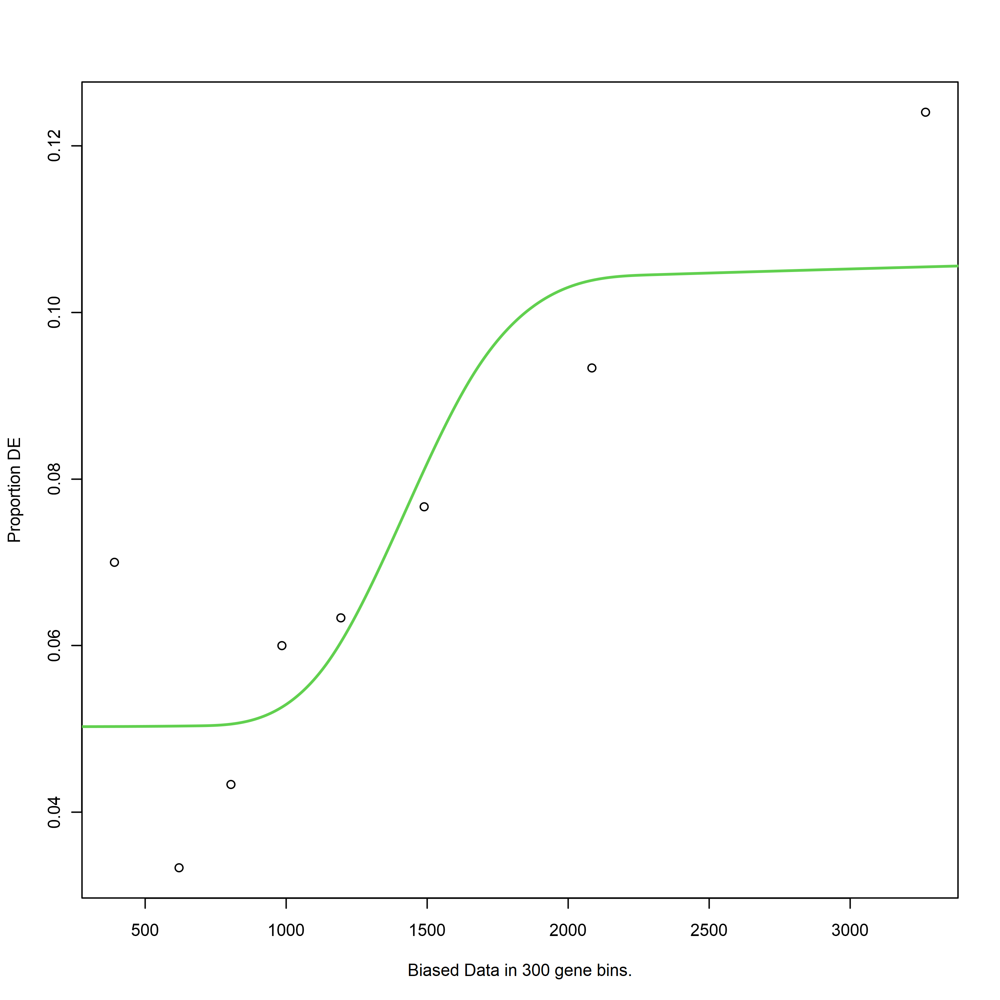

Using manually entered categories.

Calculating the p-values...



[1] "C2vsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


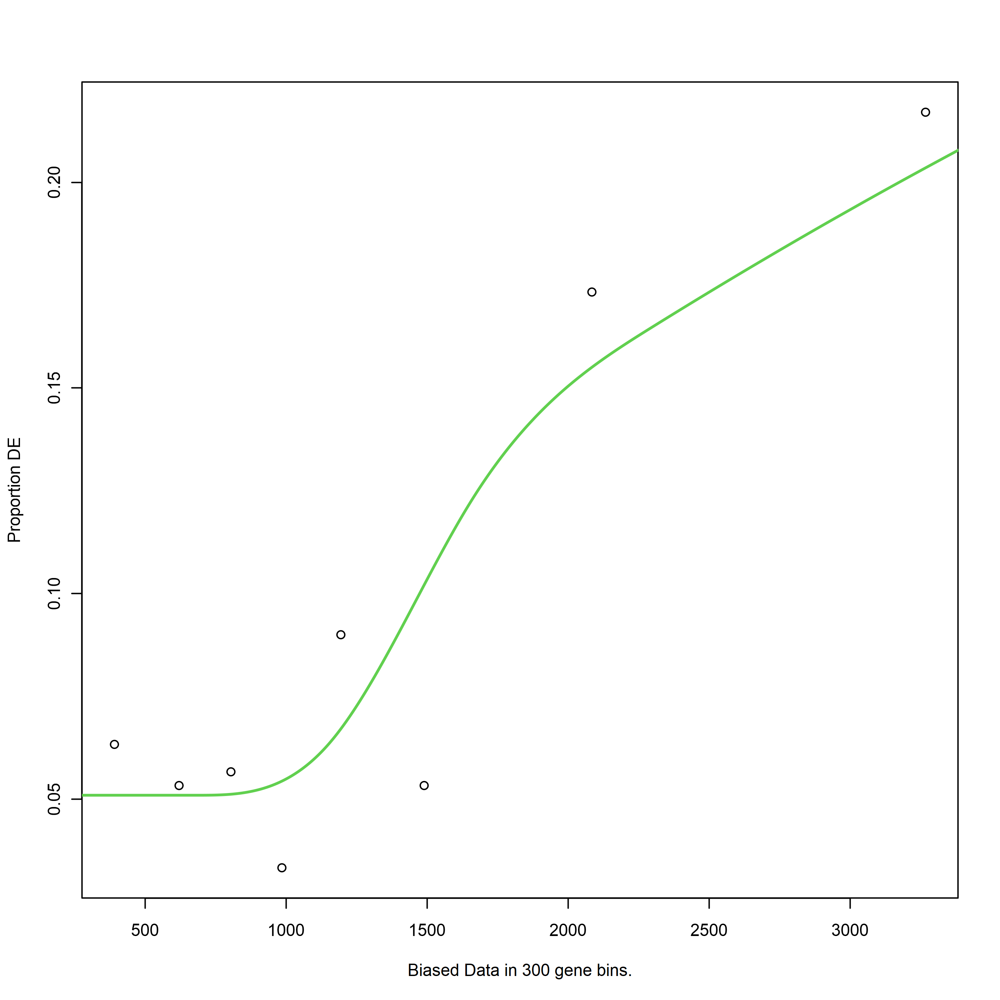

Using manually entered categories.

Calculating the p-values...



[1] "C2vsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


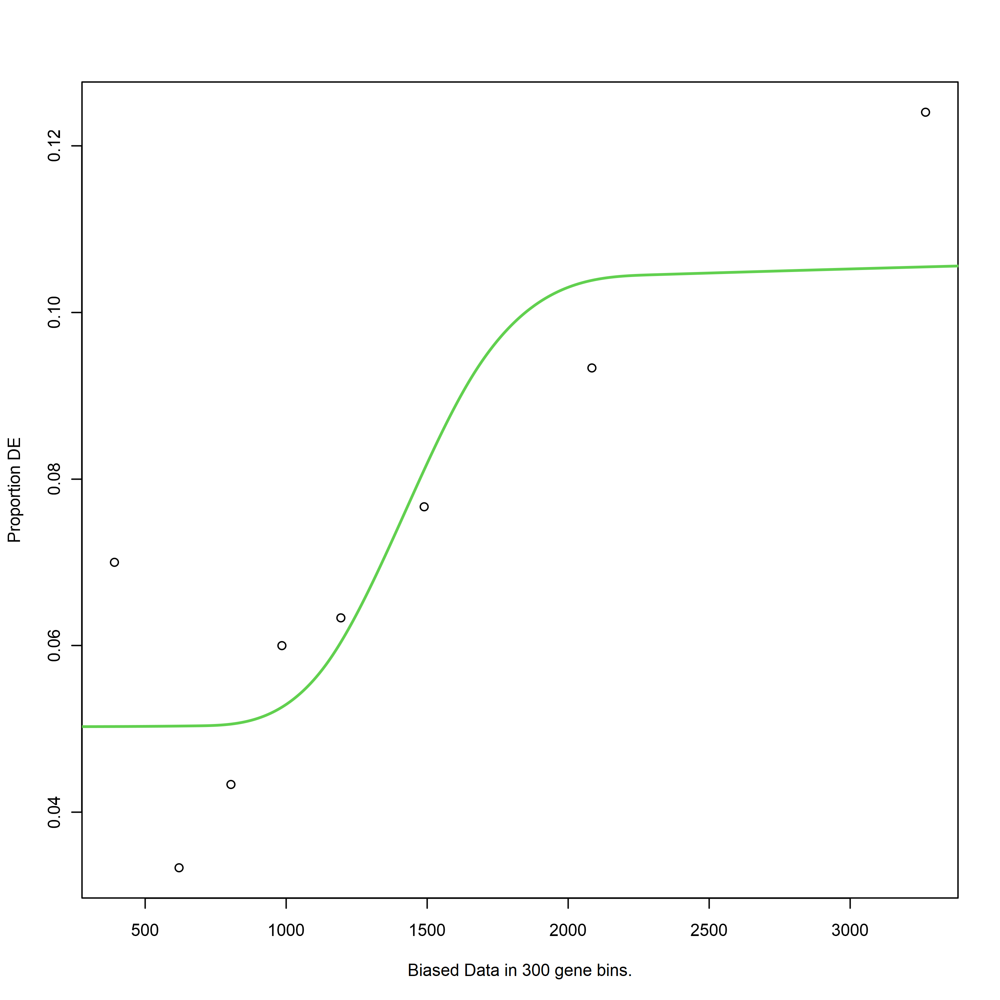

Using manually entered categories.

Calculating the p-values...



[1] "C2vsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


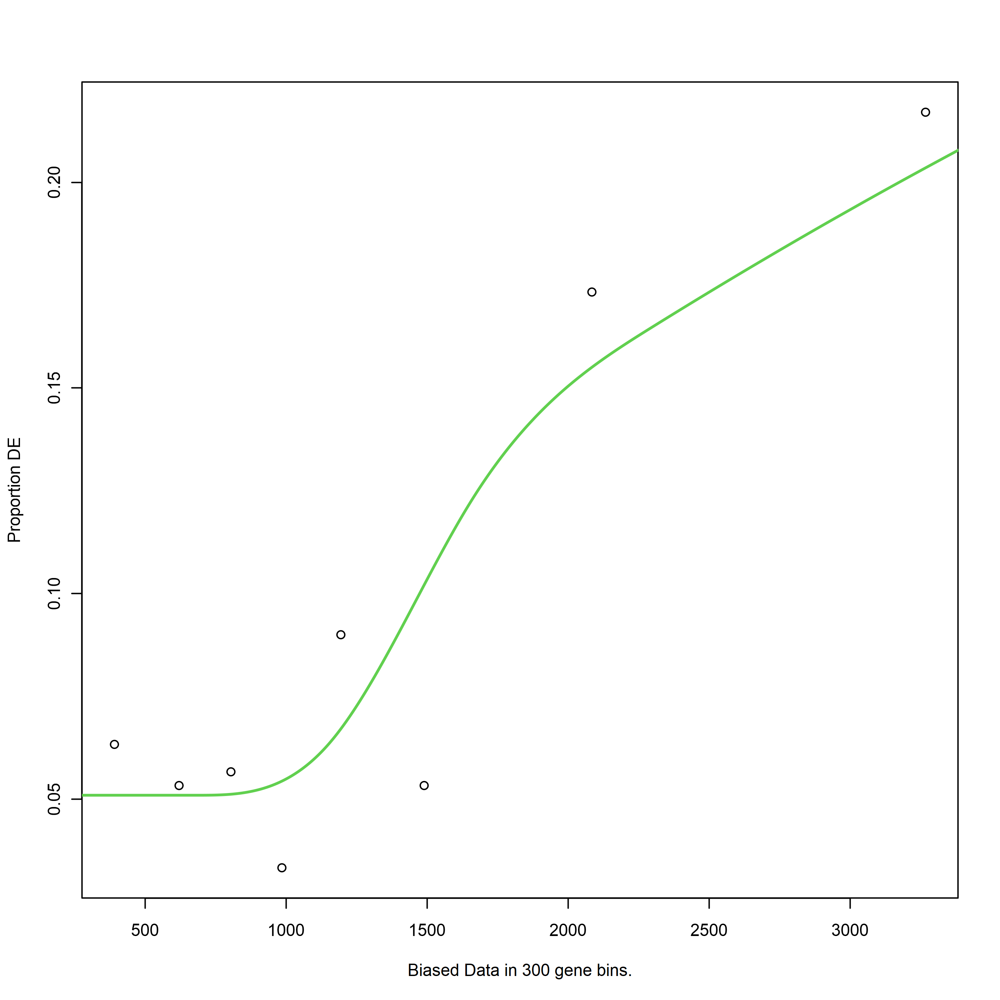

Using manually entered categories.

Calculating the p-values...



[1] "C3vsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


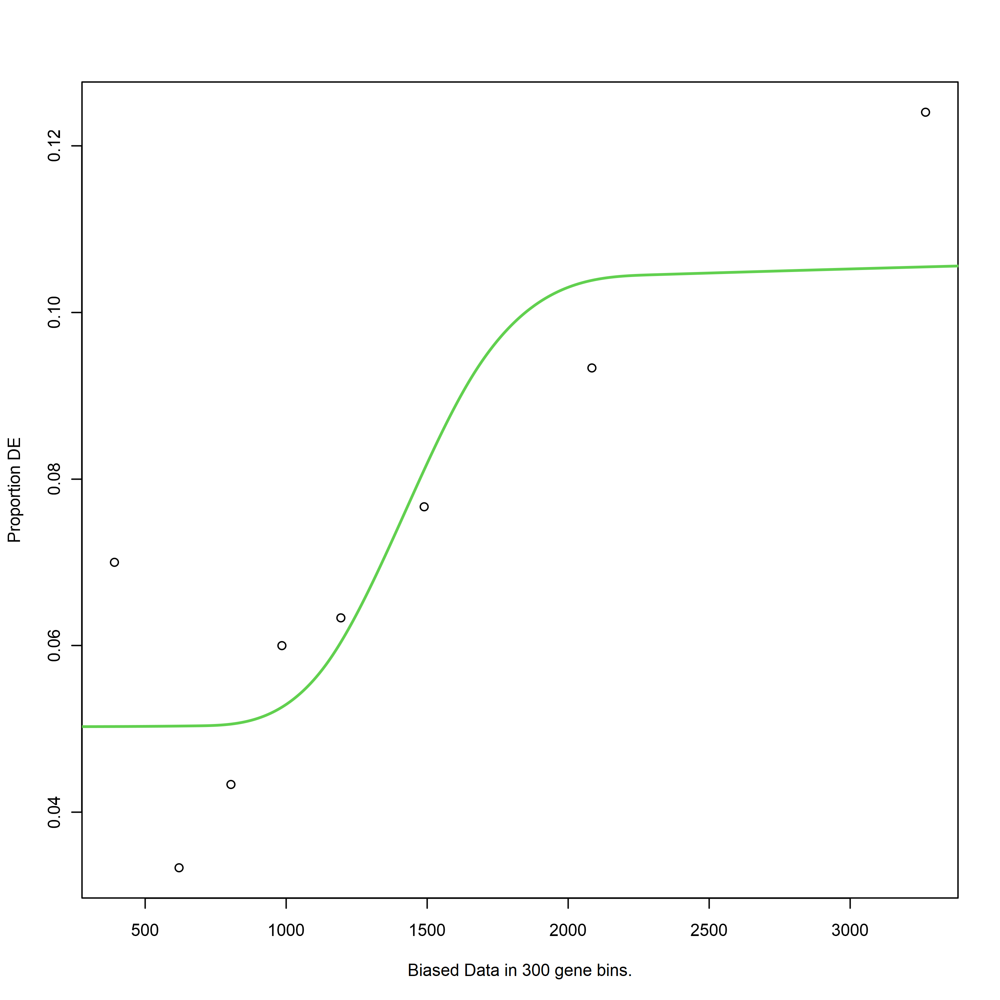

Using manually entered categories.

Calculating the p-values...



[1] "C3vsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


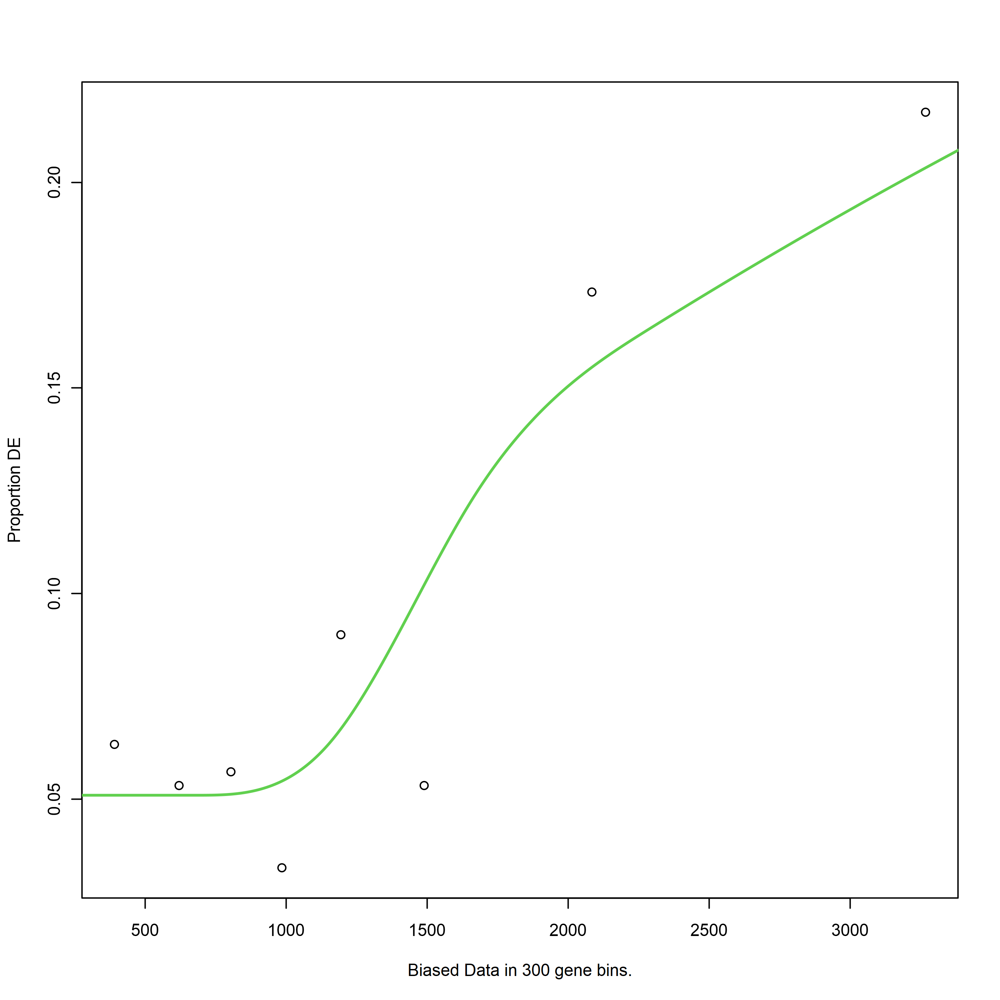

Using manually entered categories.

Calculating the p-values...



[1] "C3vsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


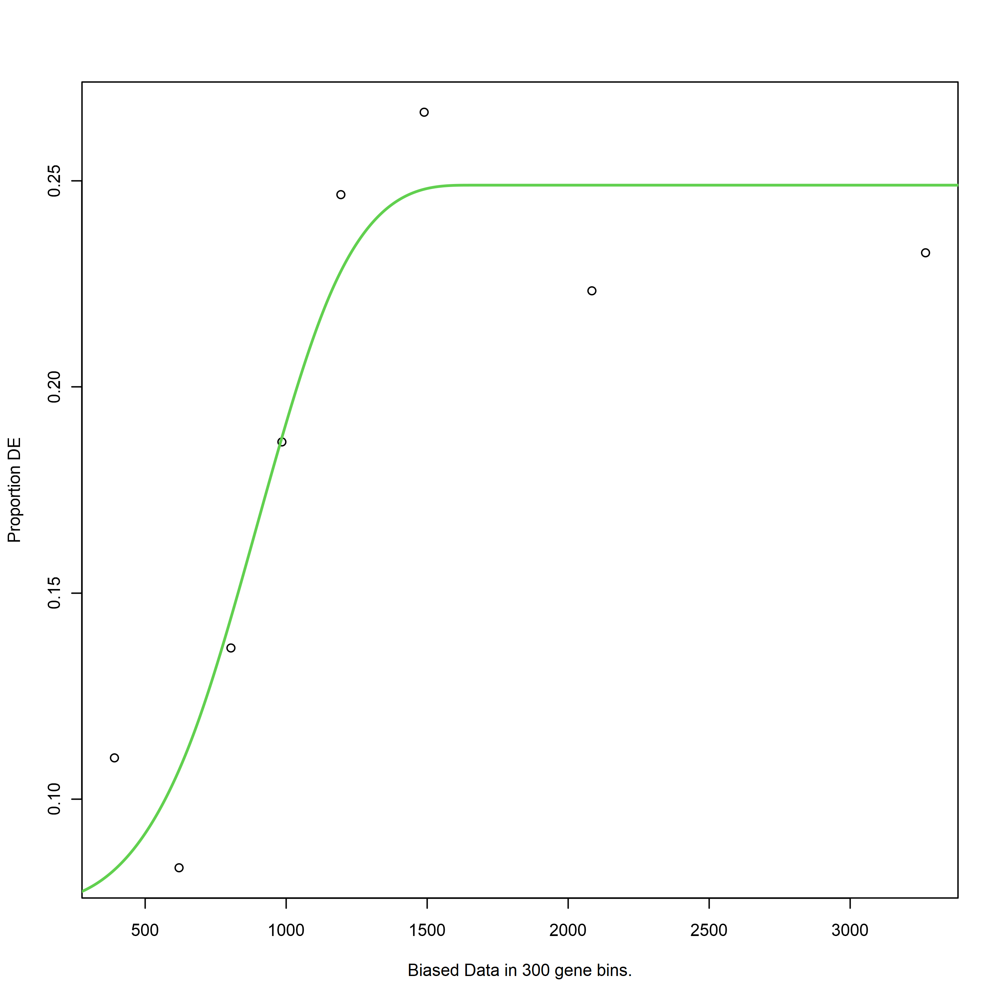

Using manually entered categories.

Calculating the p-values...



[1] "C3vsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


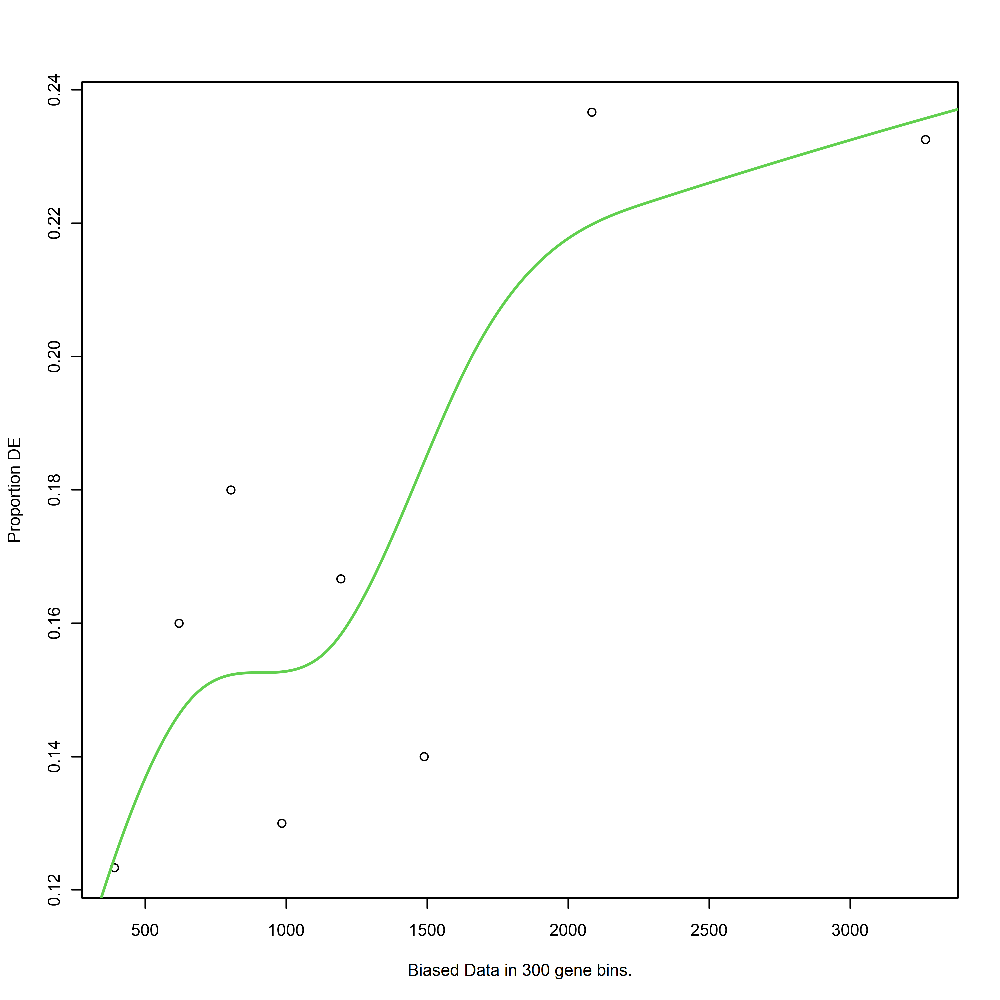

Using manually entered categories.

Calculating the p-values...



[1] "C3vsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


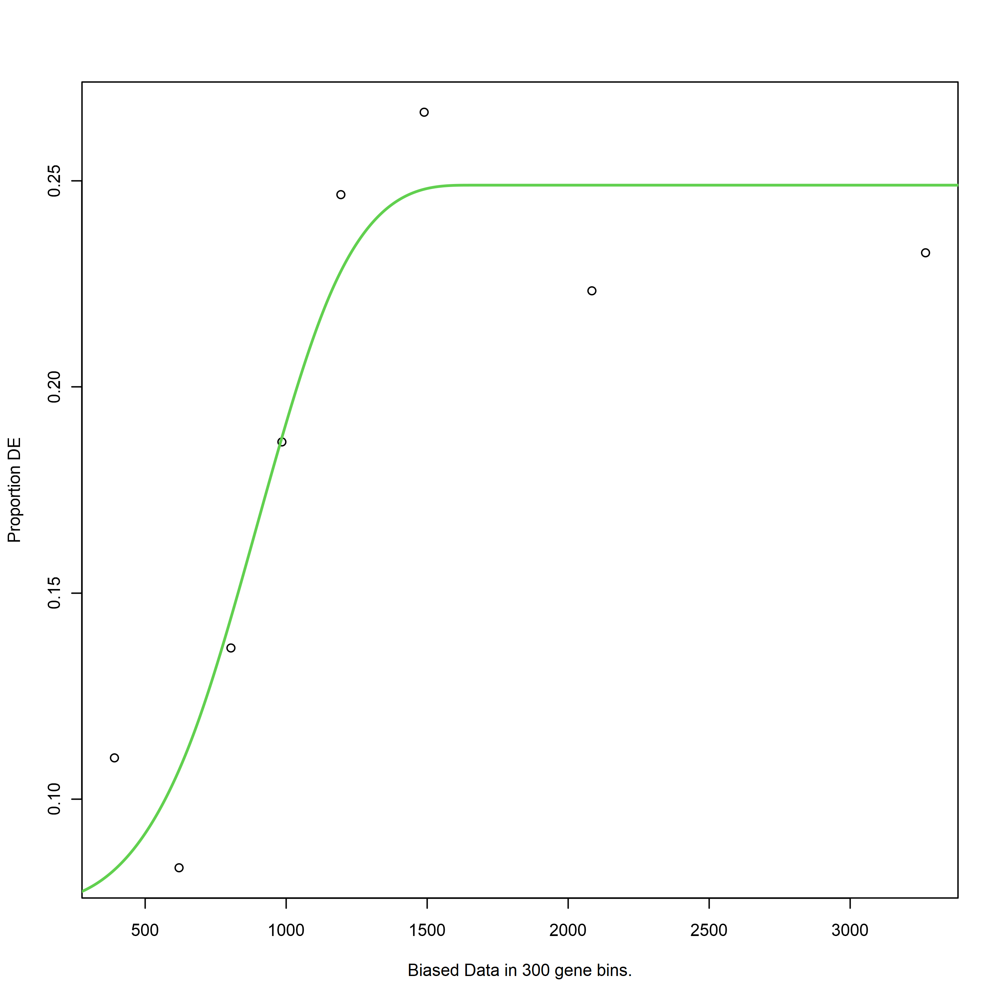

Using manually entered categories.

Calculating the p-values...



[1] "C3vsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


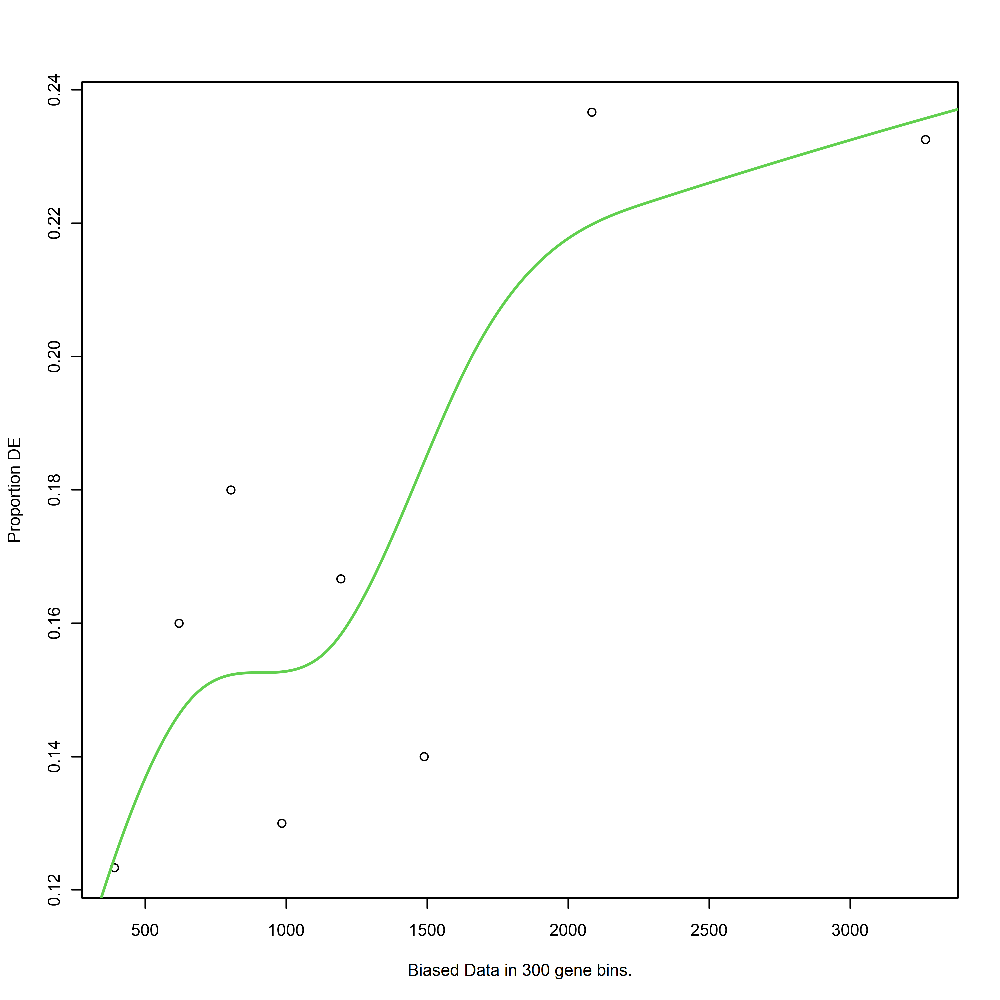

Using manually entered categories.

Calculating the p-values...



[1] "C3vsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


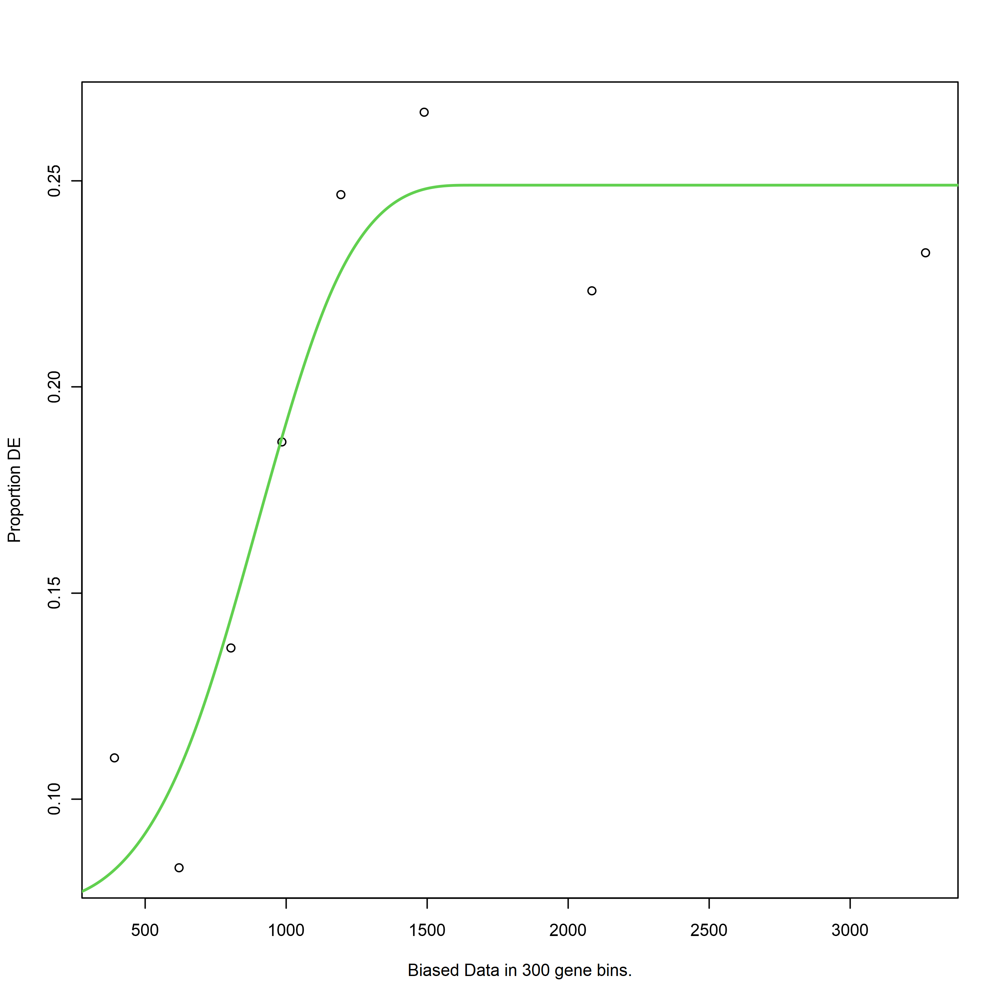

Using manually entered categories.

Calculating the p-values...



[1] "C3vsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


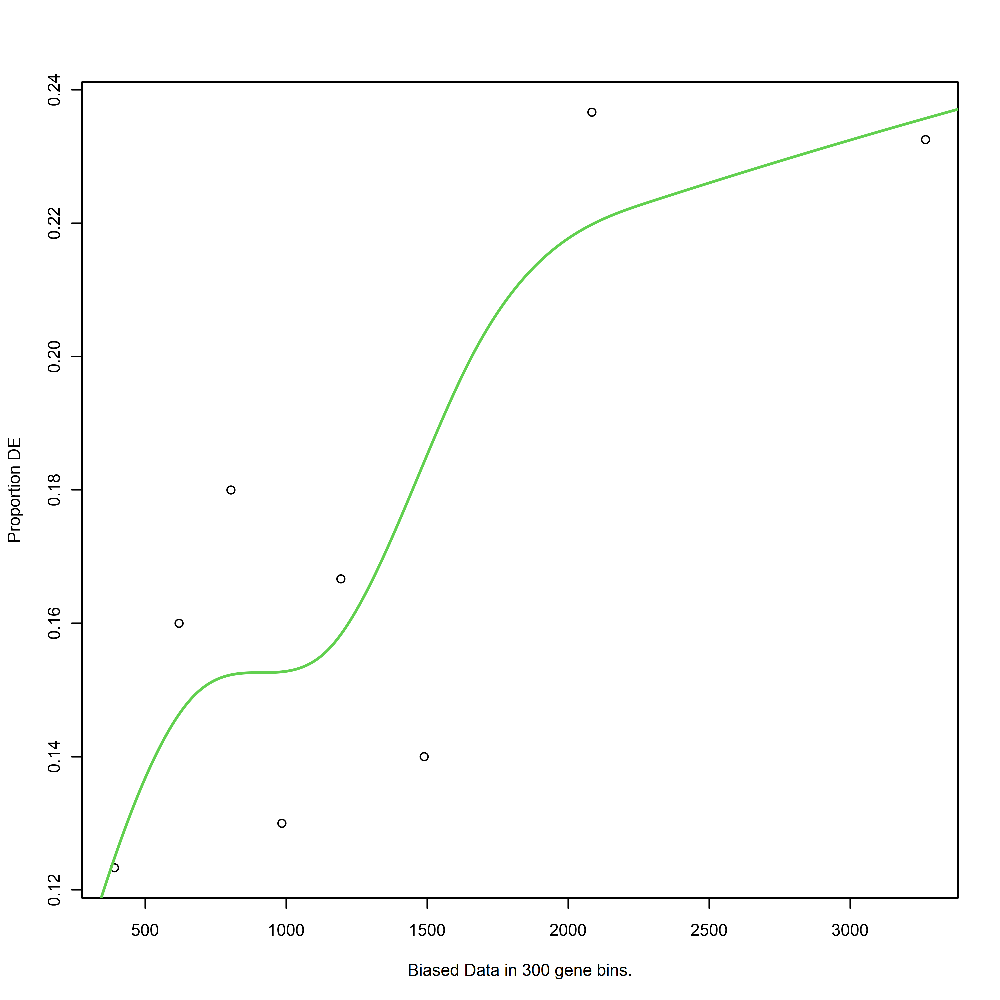

Using manually entered categories.

Calculating the p-values...



[1] "C4vsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


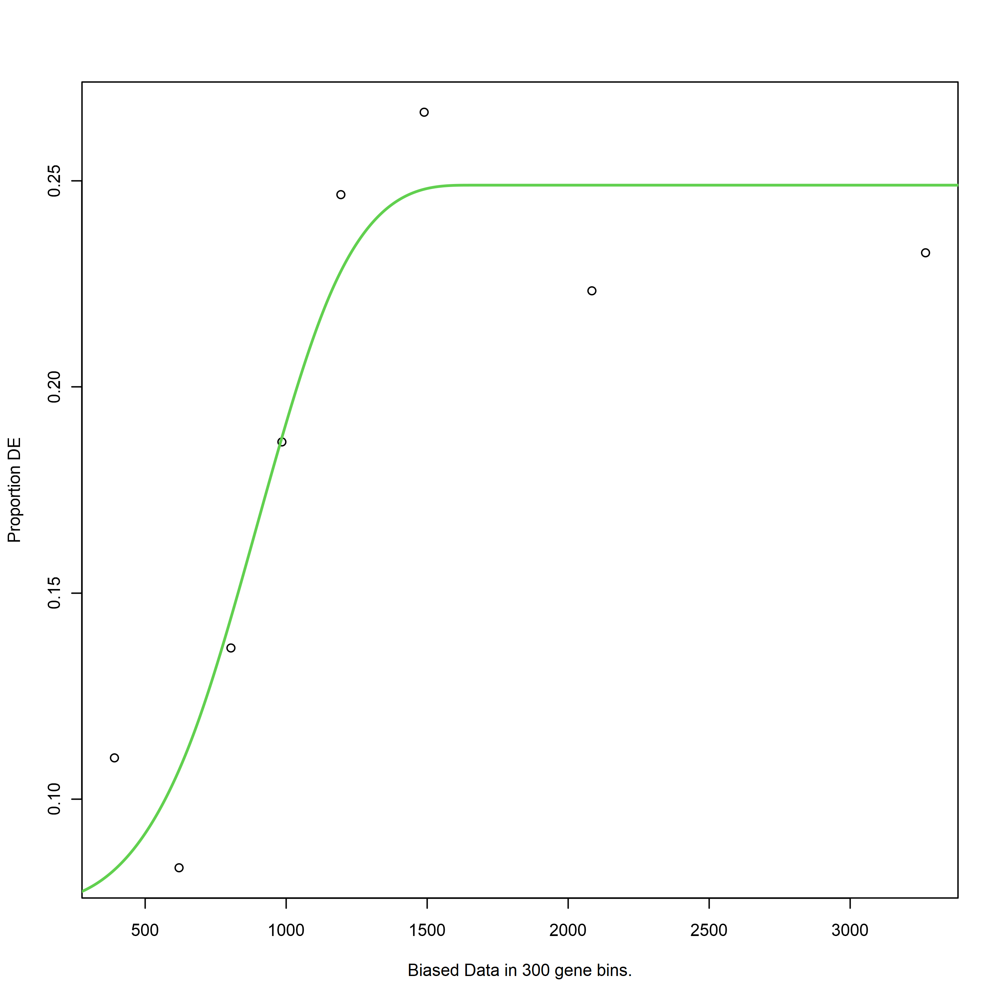

Using manually entered categories.

Calculating the p-values...



[1] "C4vsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


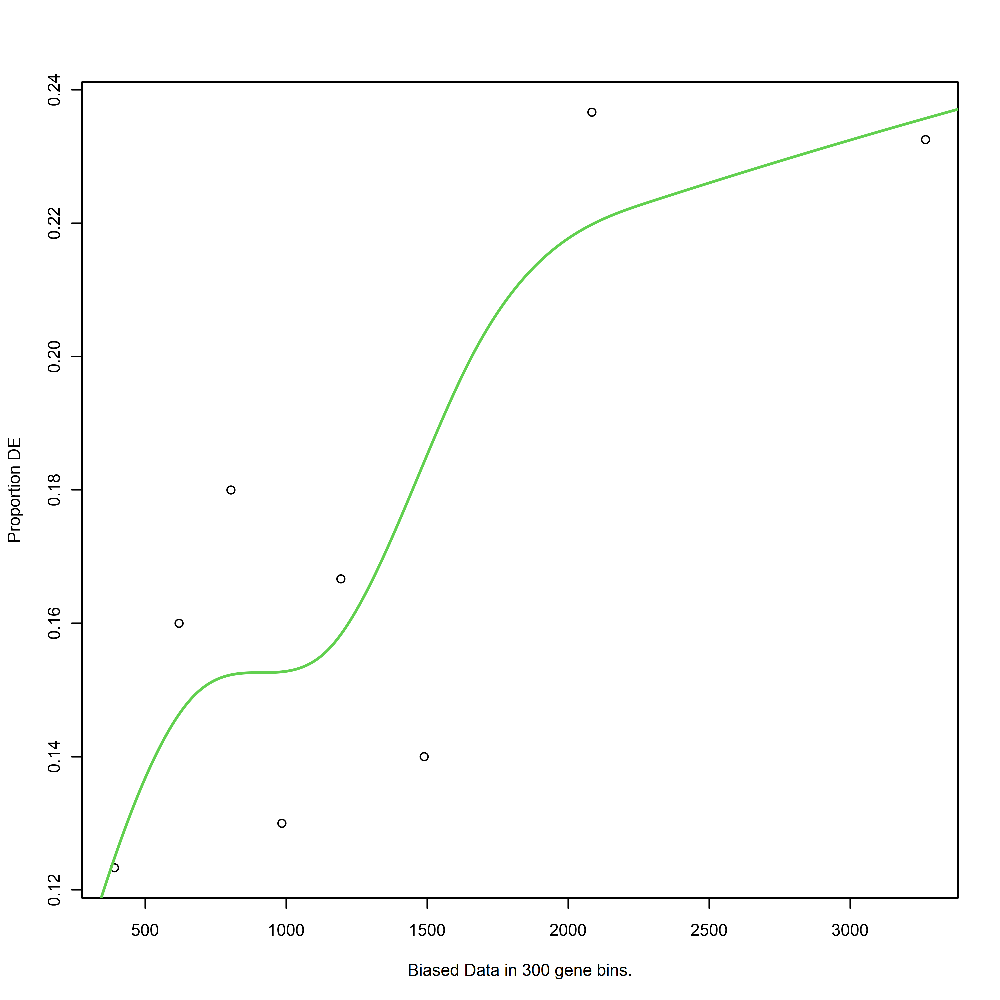

Using manually entered categories.

Calculating the p-values...



[1] "C4vsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


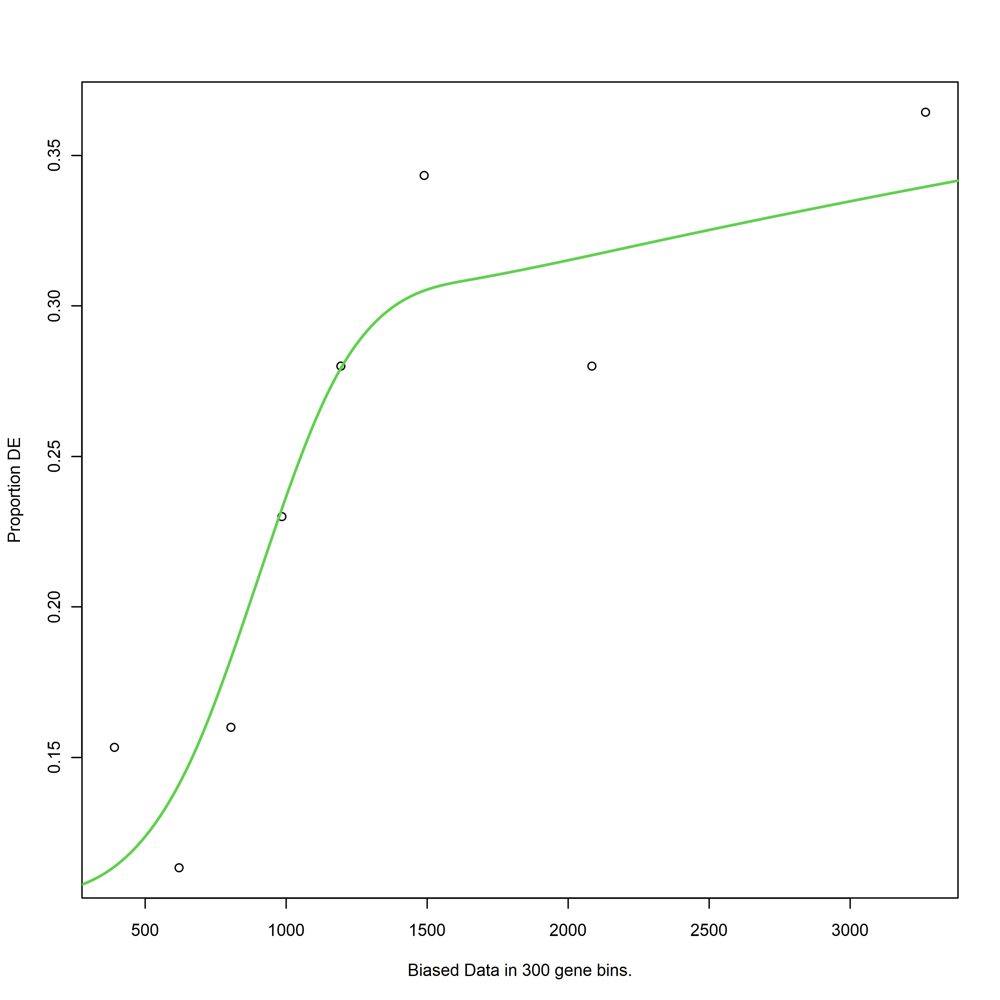

Using manually entered categories.

Calculating the p-values...



[1] "C4vsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


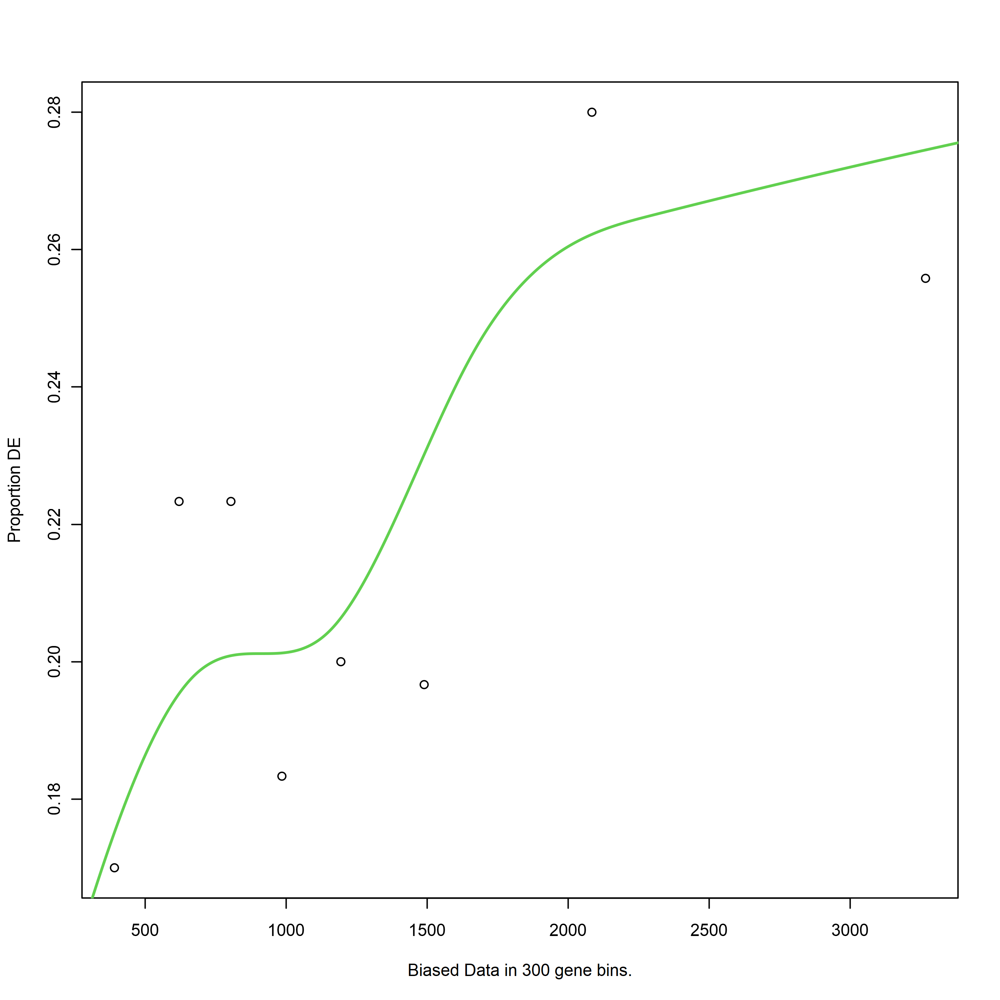

Using manually entered categories.

Calculating the p-values...



[1] "C4vsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


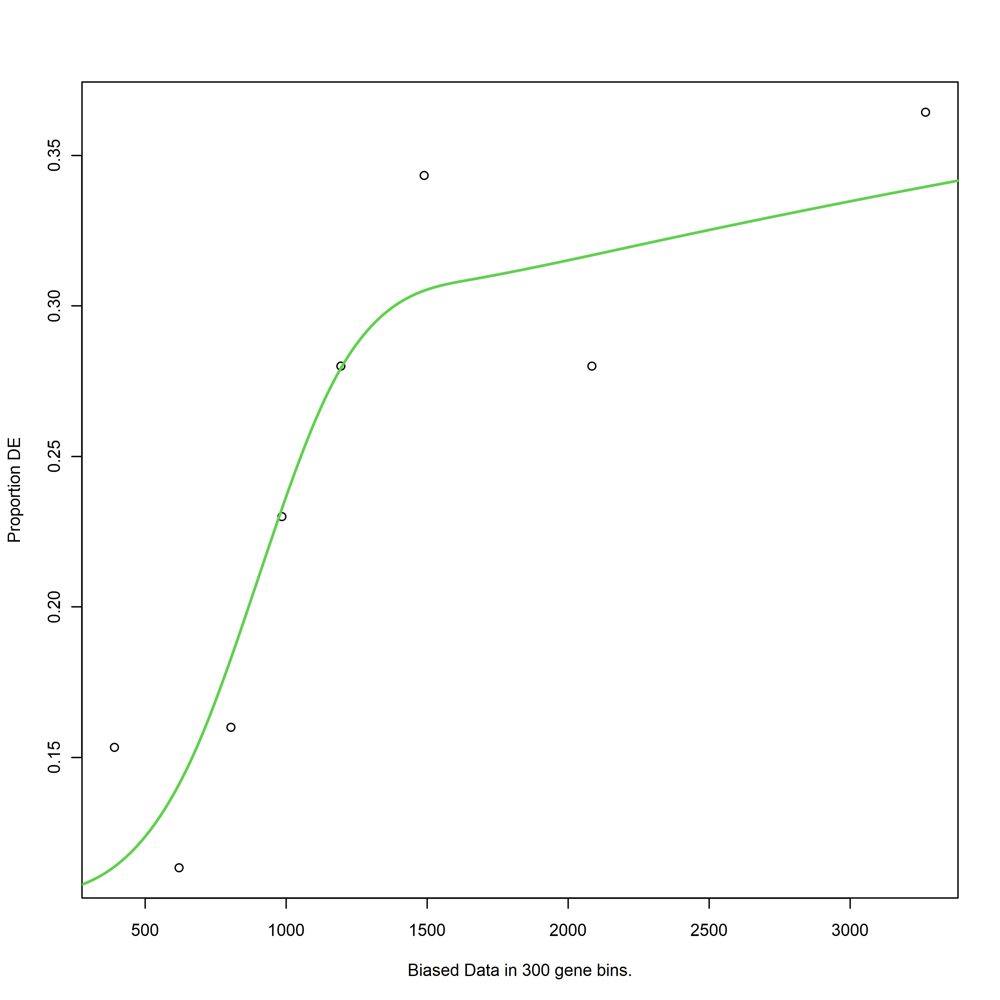

Using manually entered categories.

Calculating the p-values...



[1] "C4vsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


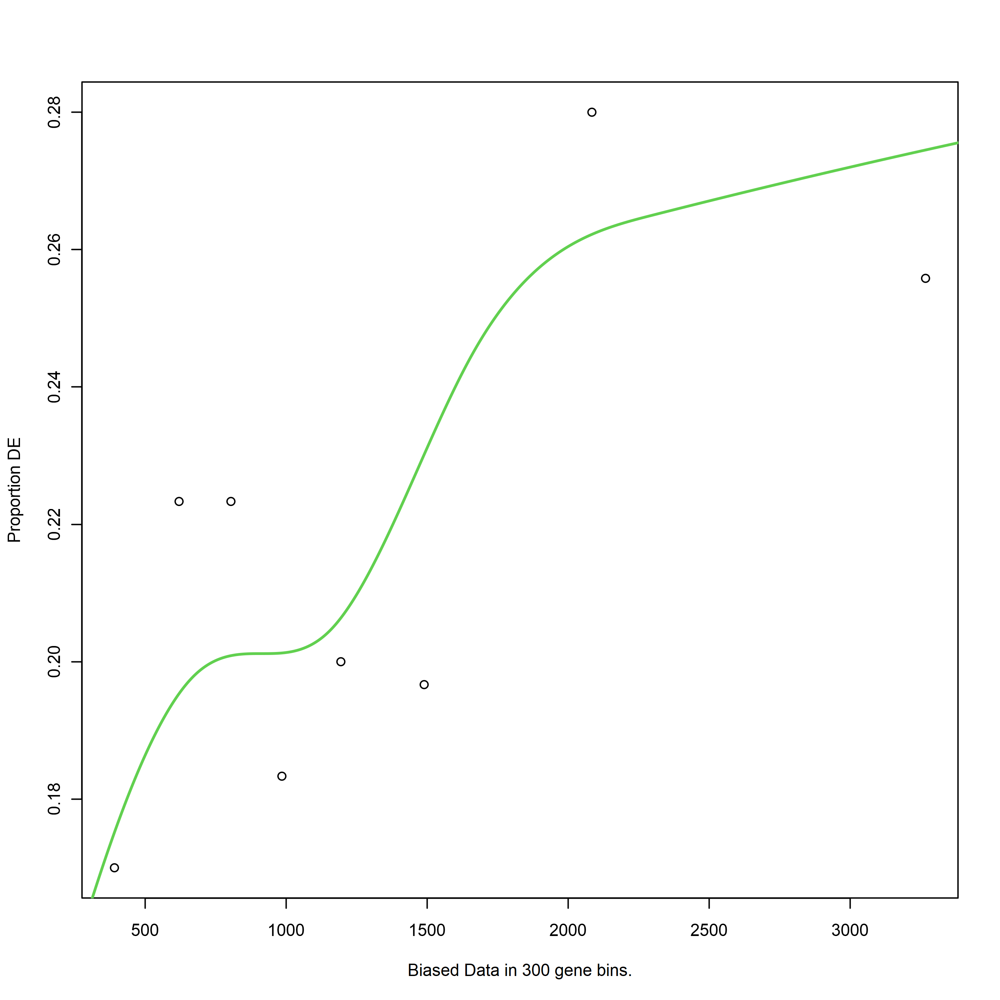

Using manually entered categories.

Calculating the p-values...



[1] "C4vsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


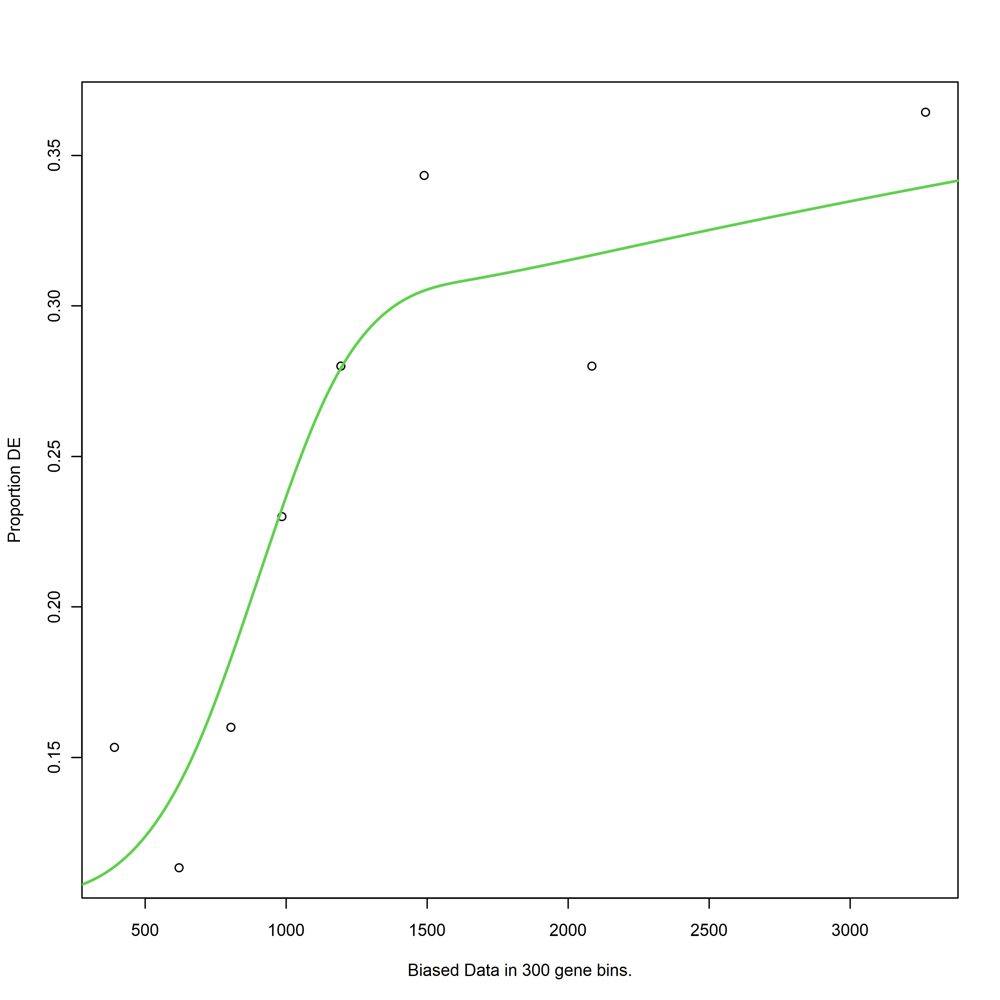

Using manually entered categories.

Calculating the p-values...



[1] "C4vsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


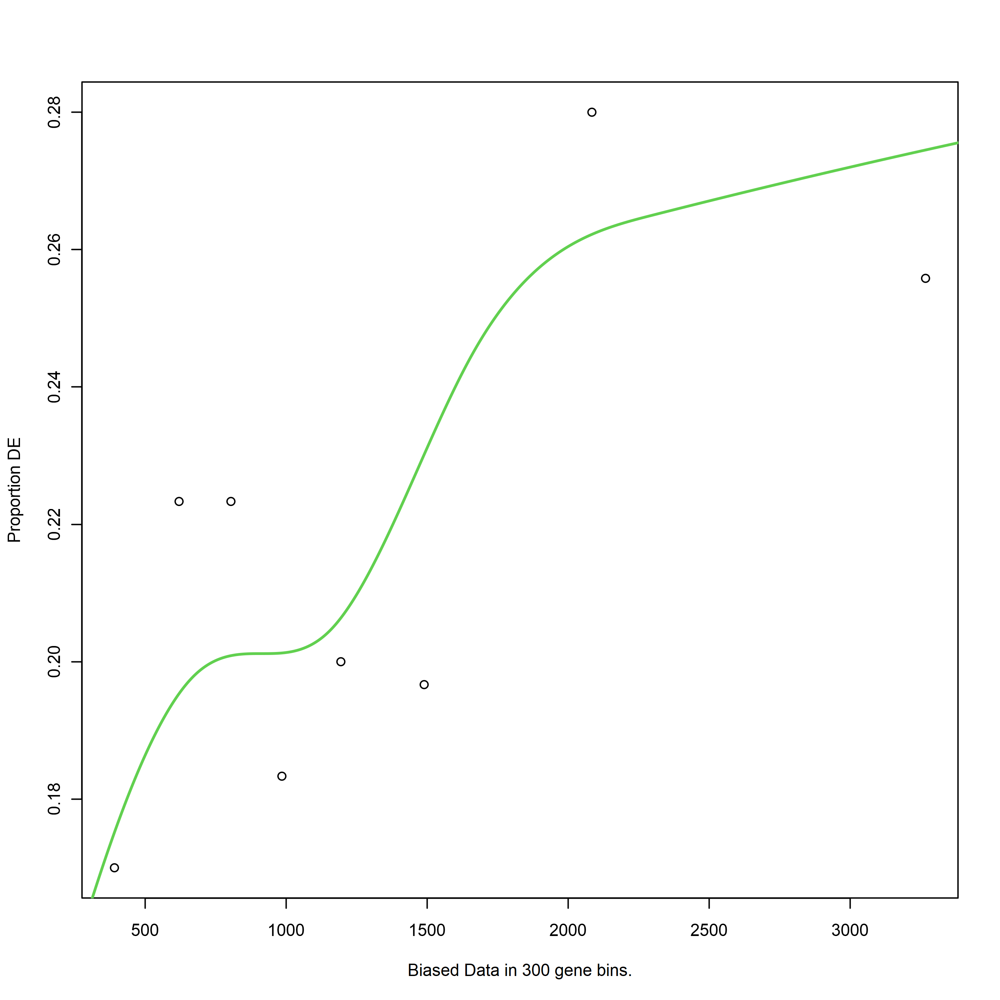

Using manually entered categories.

Calculating the p-values...



[1] "C5vsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


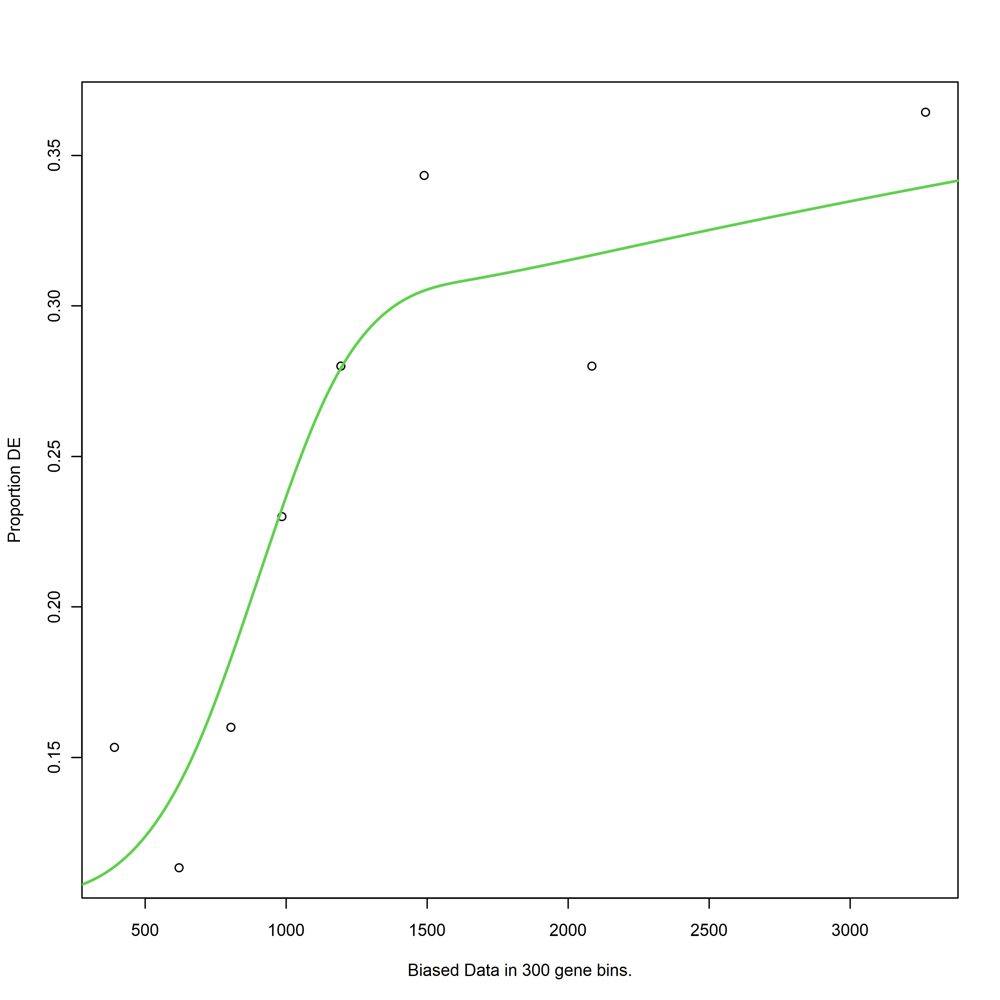

Using manually entered categories.

Calculating the p-values...



[1] "C5vsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


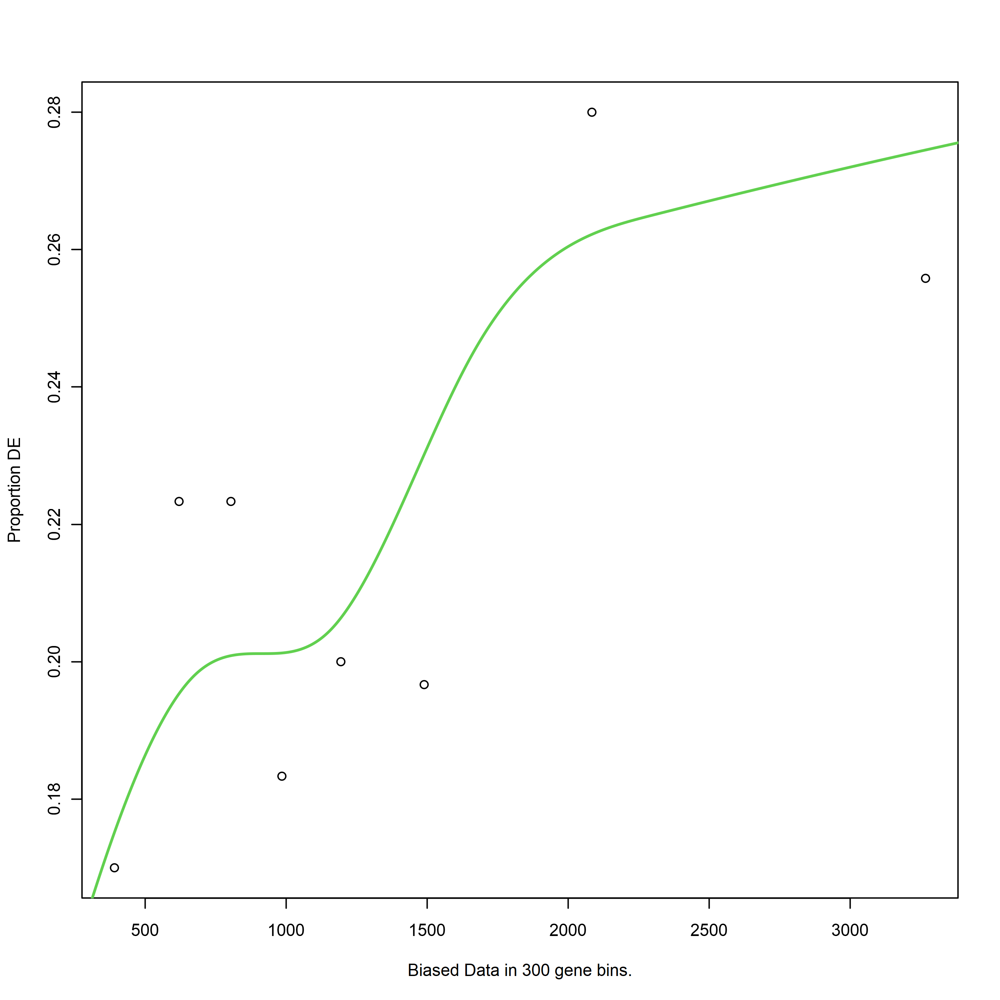

Using manually entered categories.

Calculating the p-values...



[1] "C5vsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


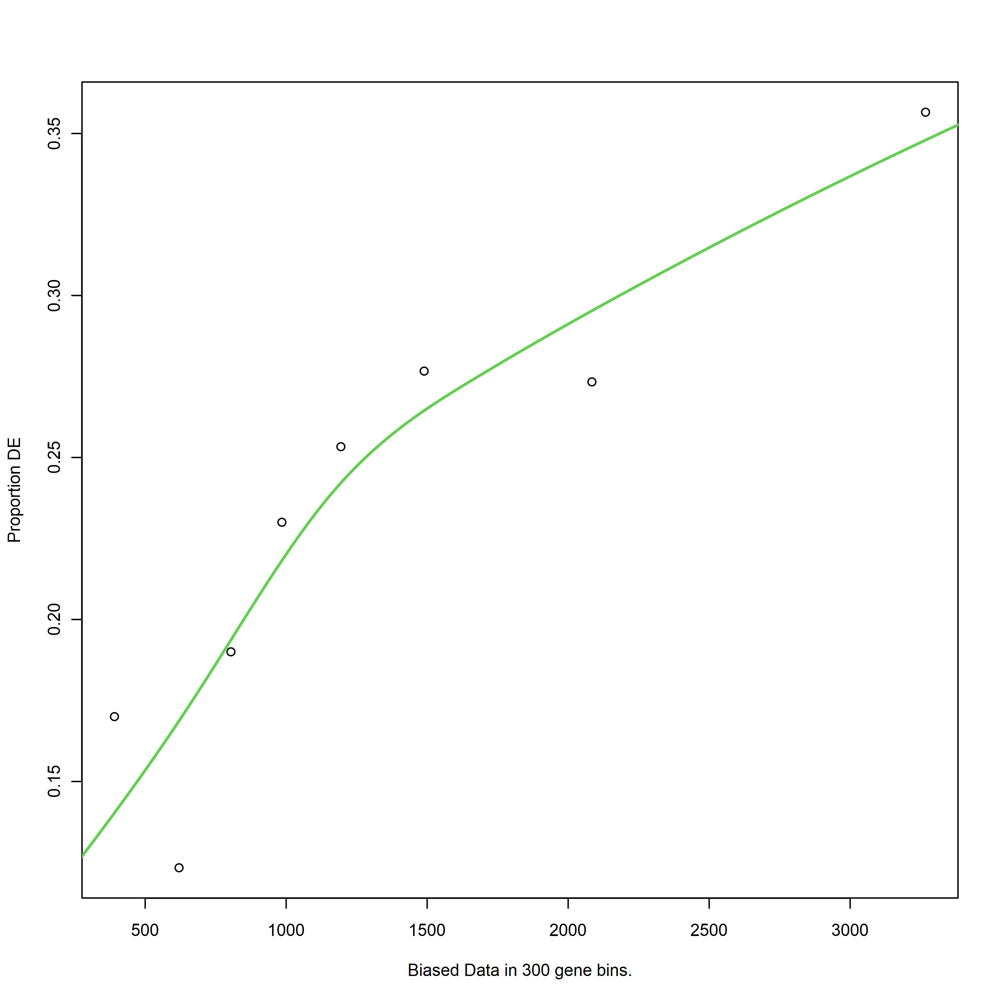

Using manually entered categories.

Calculating the p-values...



[1] "C5vsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


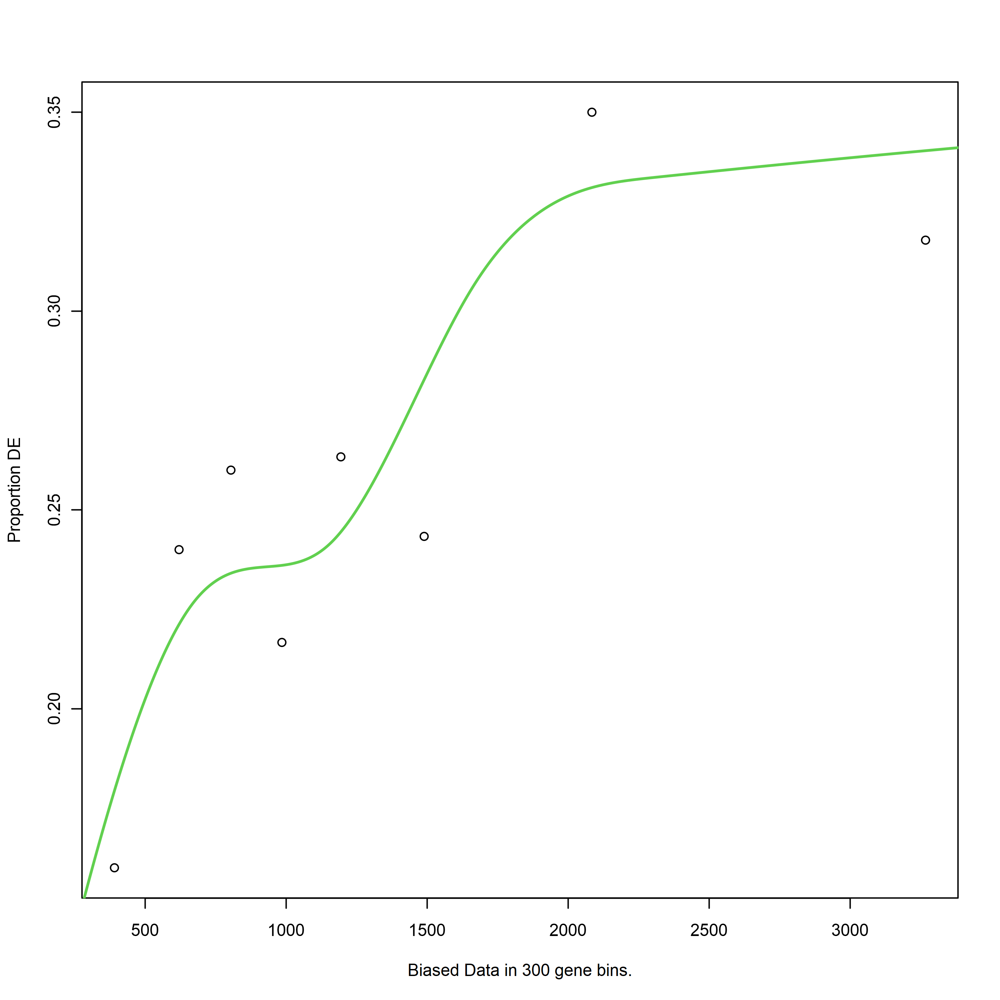

Using manually entered categories.

Calculating the p-values...



[1] "C5vsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


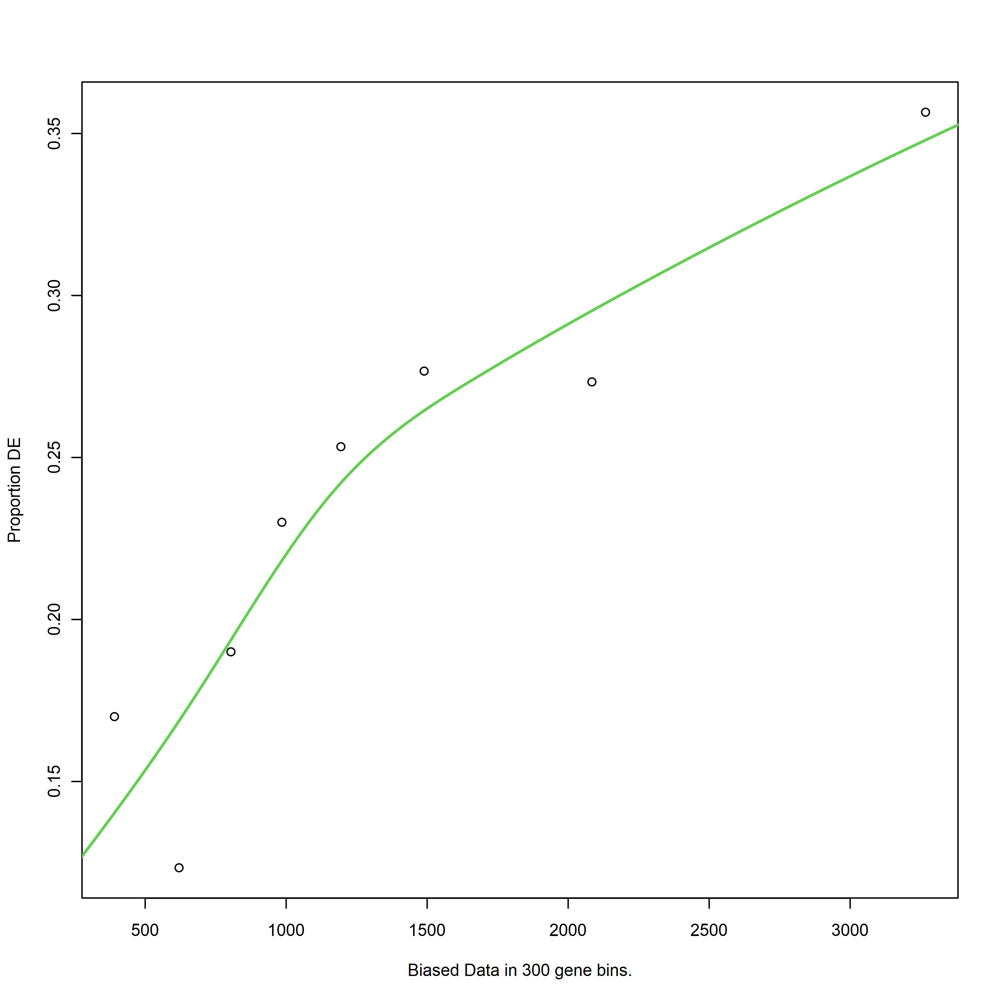

Using manually entered categories.

Calculating the p-values...



[1] "C5vsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


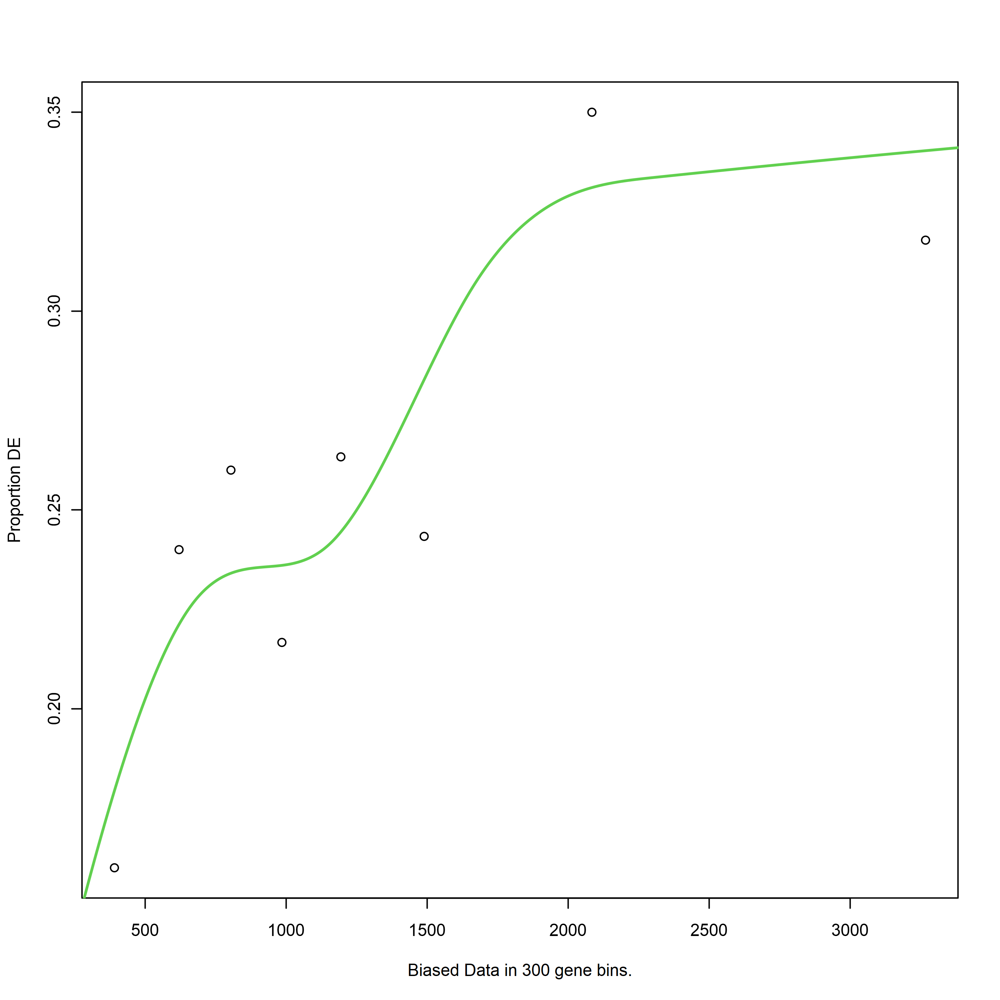

Using manually entered categories.

Calculating the p-values...



[1] "C5vsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


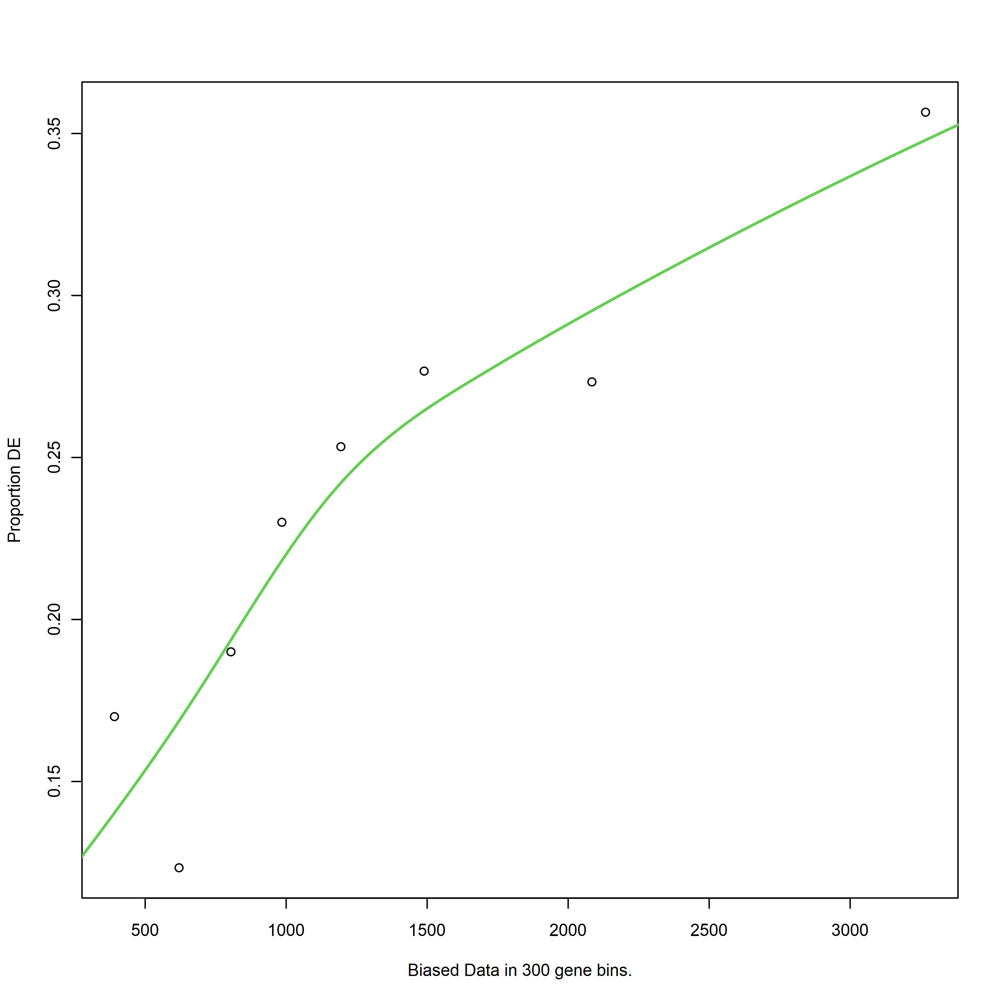

Using manually entered categories.

Calculating the p-values...



[1] "C5vsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


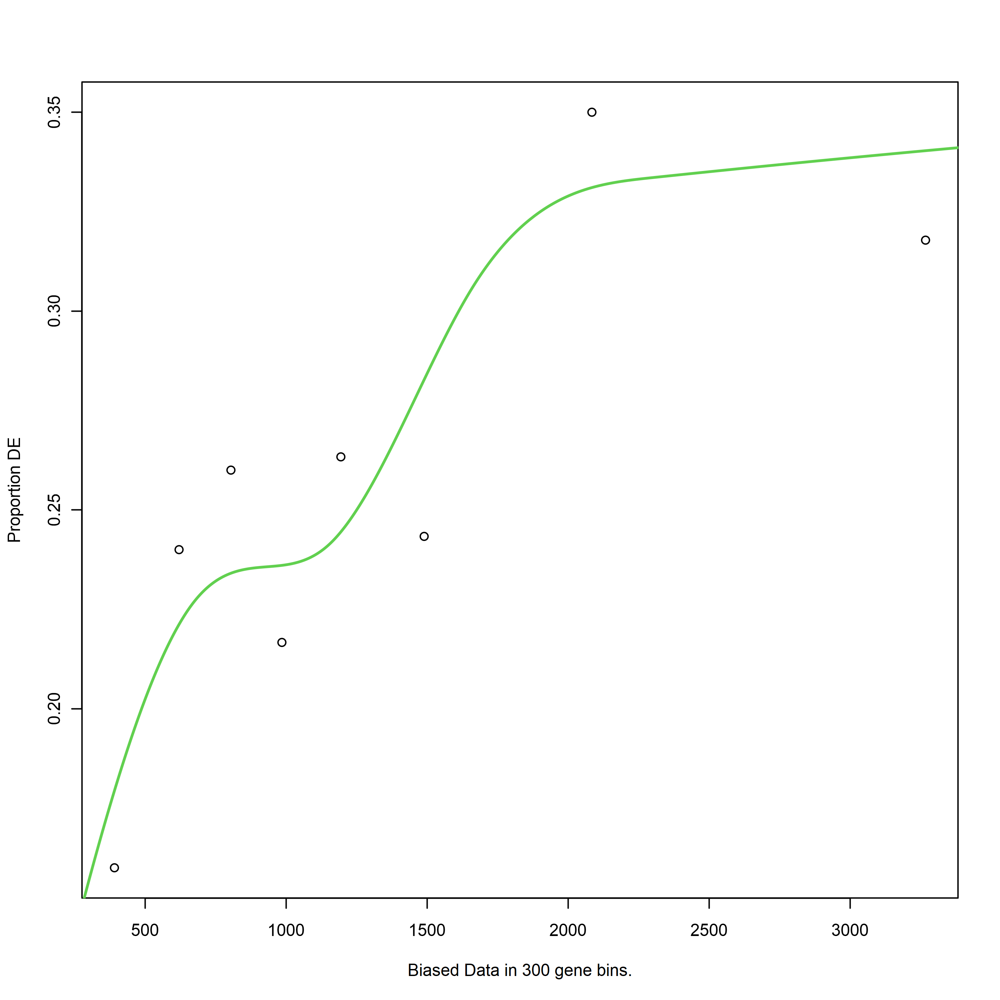

Using manually entered categories.

Calculating the p-values...



[1] "C3vsC2_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


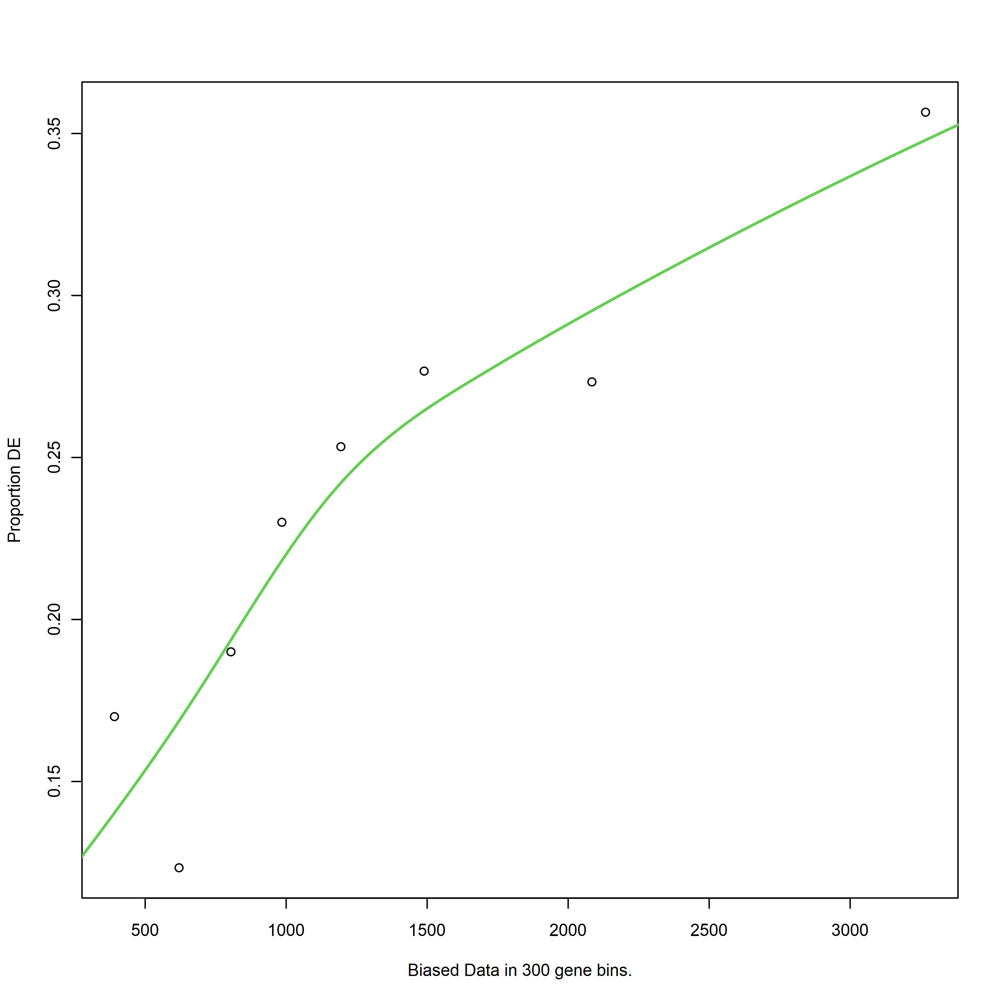

Using manually entered categories.

Calculating the p-values...



[1] "C3vsC2_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


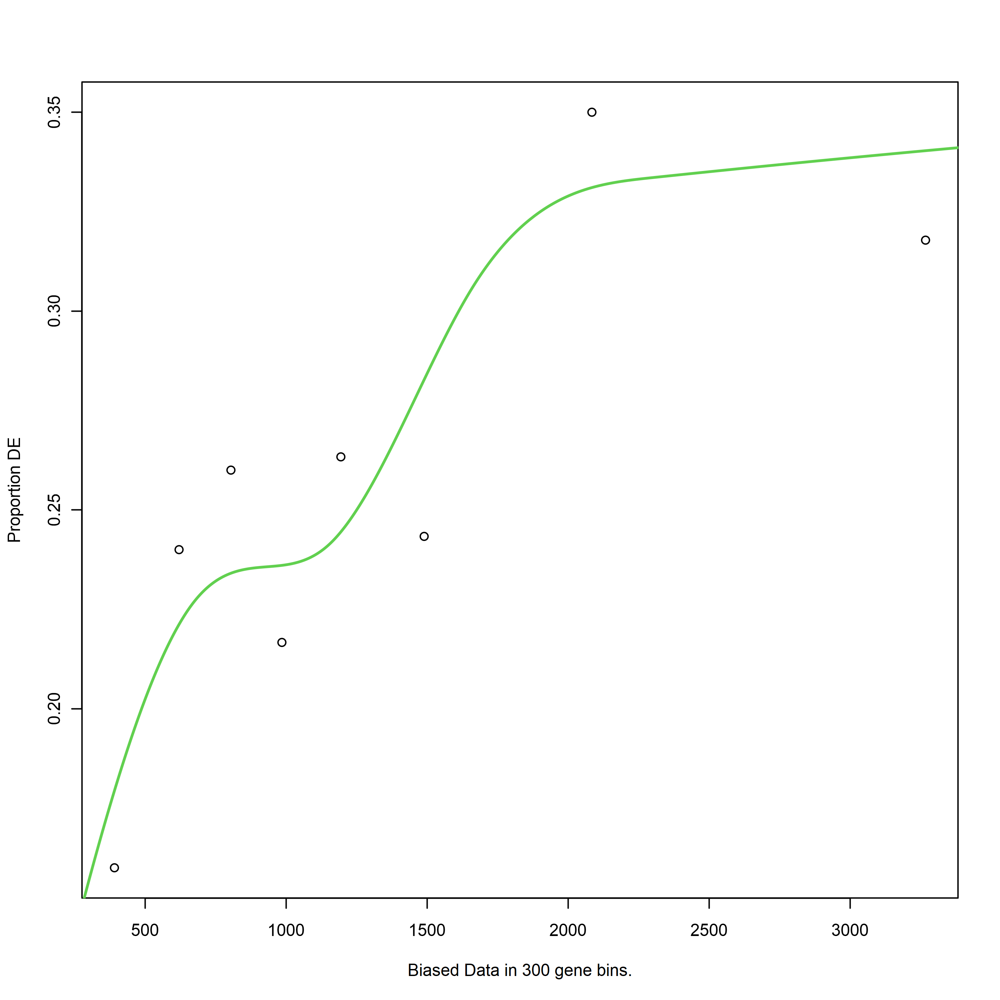

Using manually entered categories.

Calculating the p-values...



[1] "C3vsC2_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


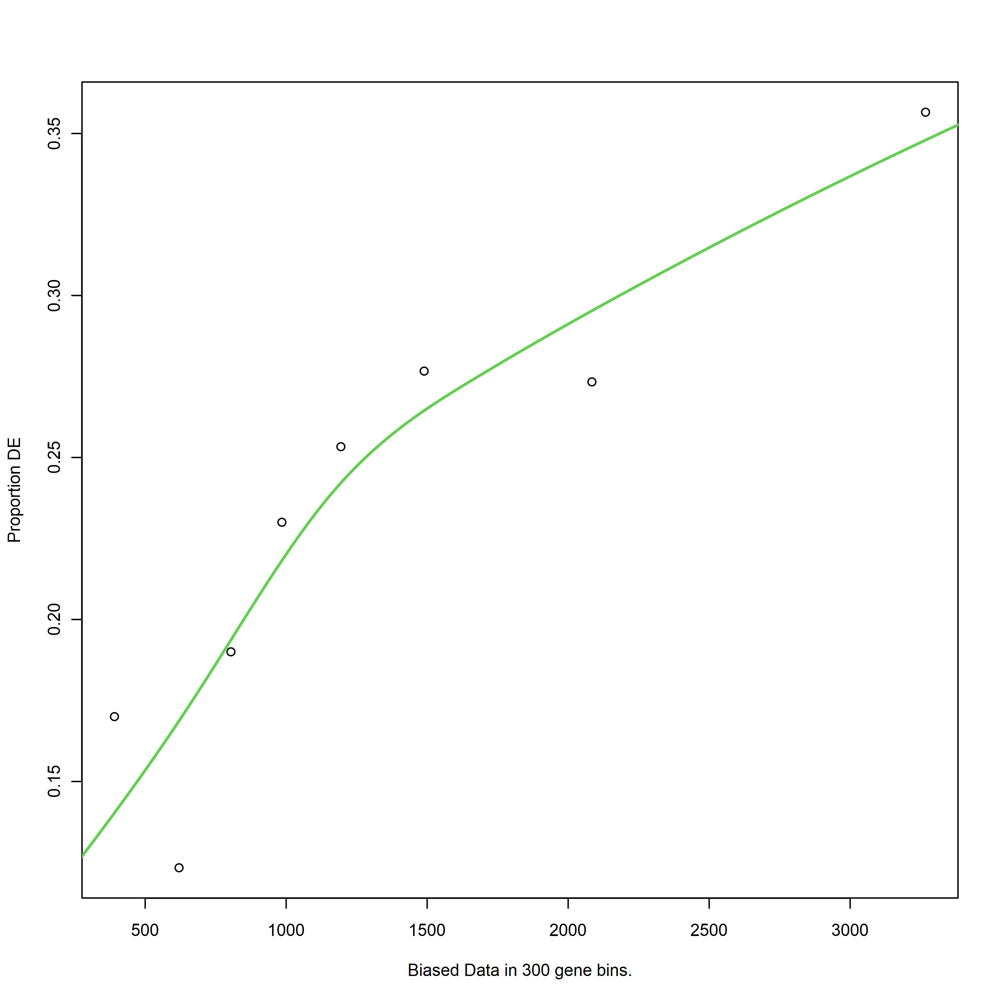

Using manually entered categories.

Calculating the p-values...



[1] "C3vsC2_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


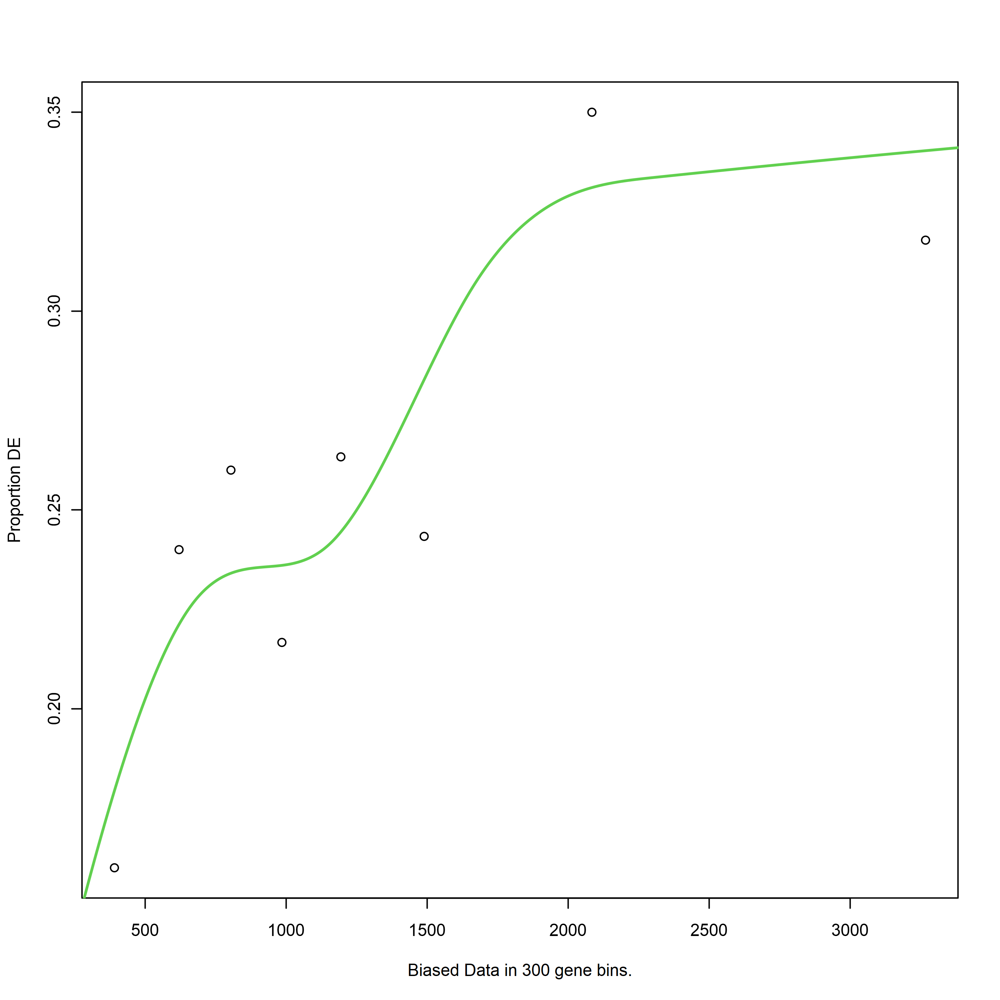

Using manually entered categories.

Calculating the p-values...



[1] "C3vsC2_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


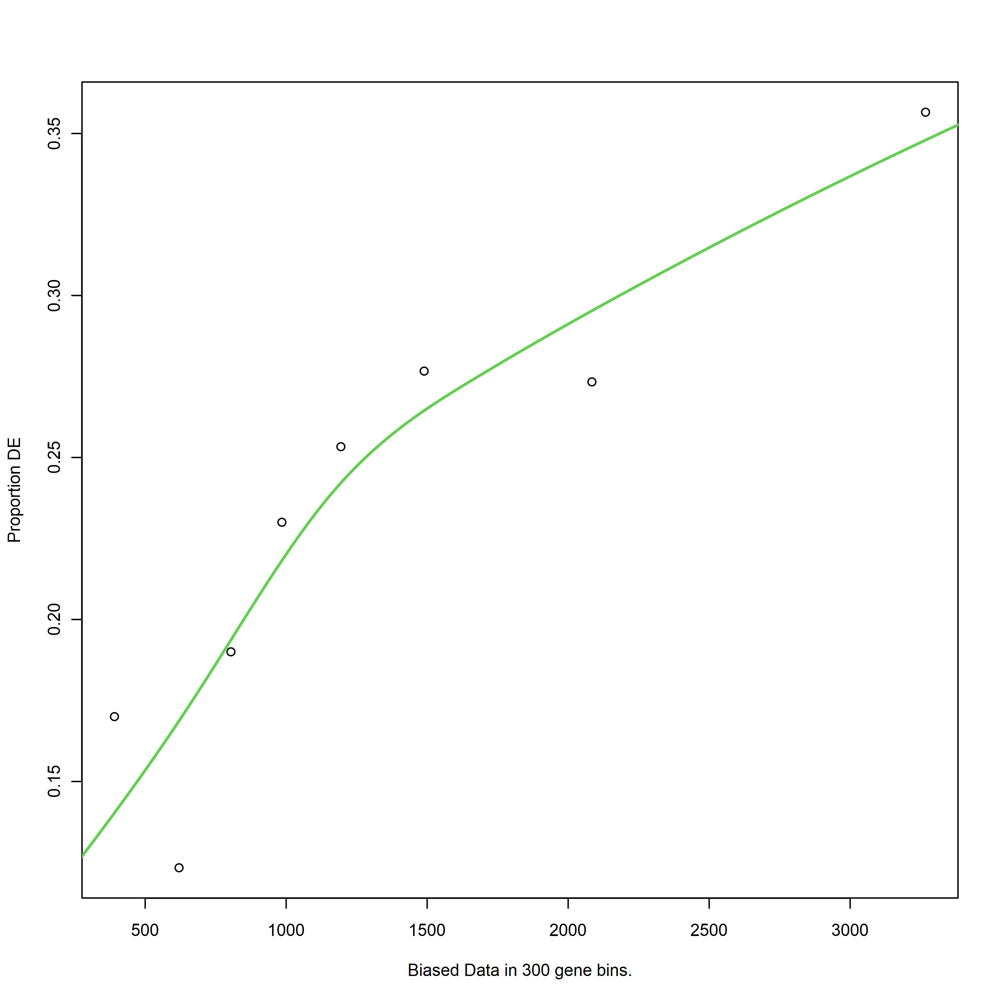

Using manually entered categories.

Calculating the p-values...



[1] "C3vsC2_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


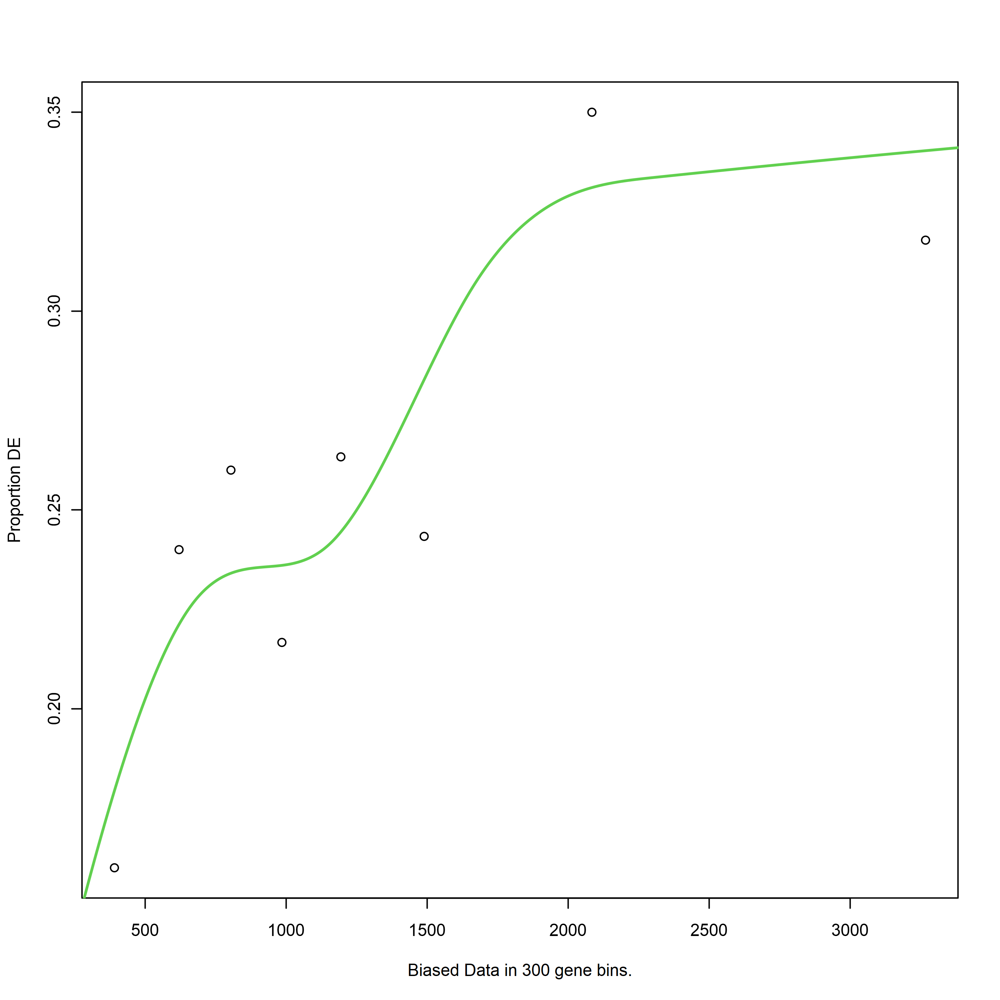

Using manually entered categories.

Calculating the p-values...



[1] "C3vsC2_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


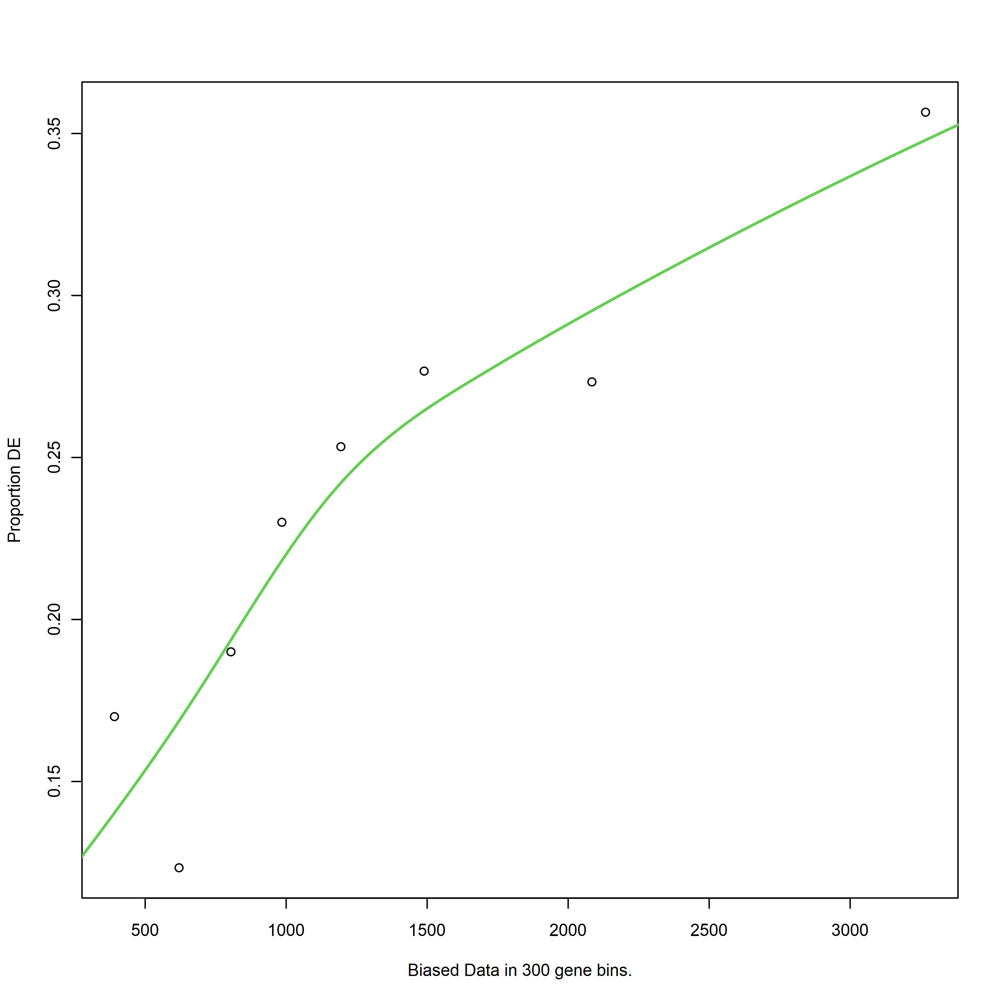

Using manually entered categories.

Calculating the p-values...



[1] "C3vsC2_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


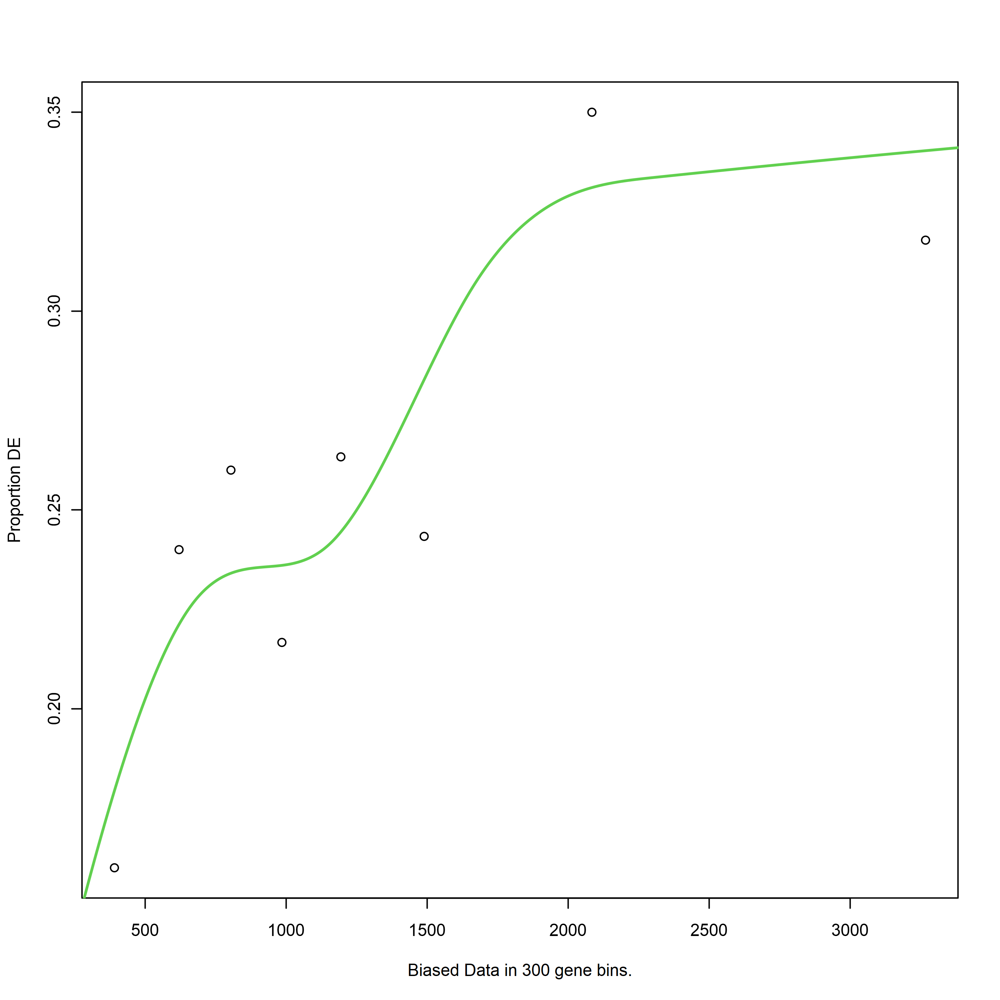

Using manually entered categories.

Calculating the p-values...



[1] "C4vsC3_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


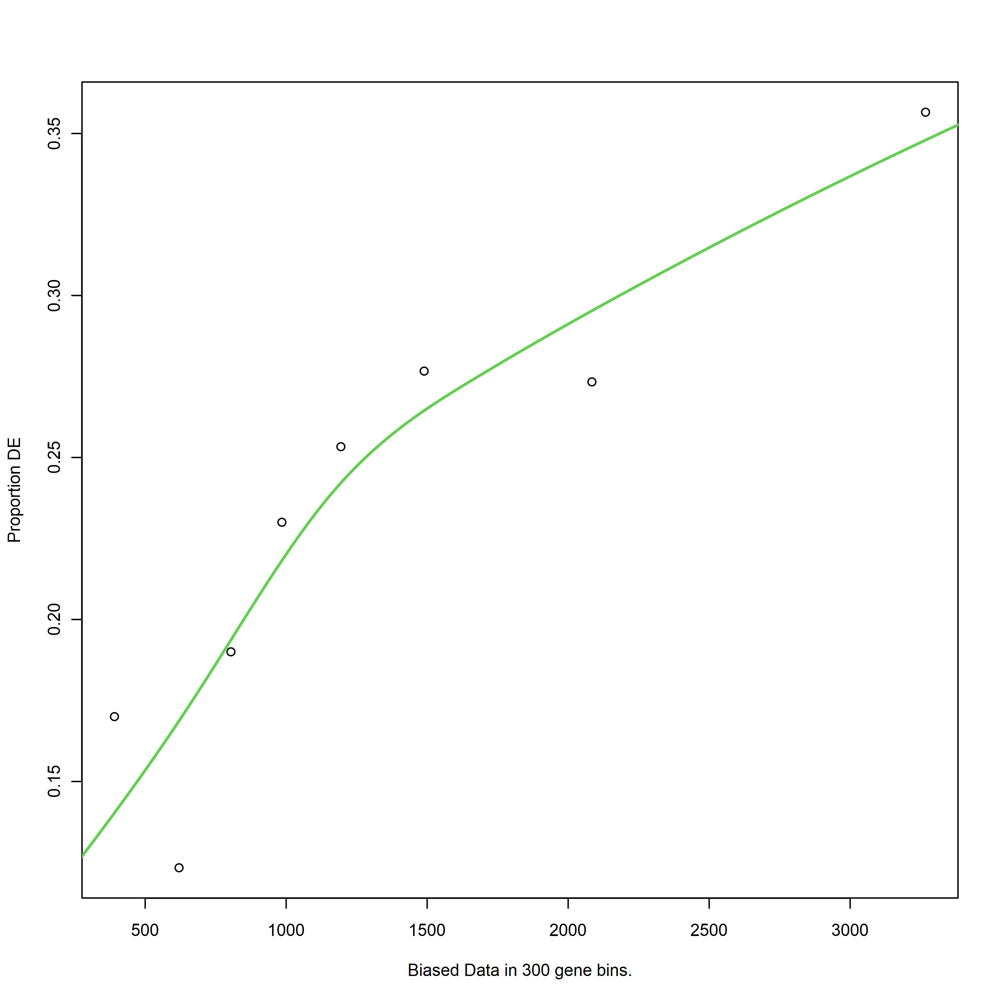

Using manually entered categories.

Calculating the p-values...



[1] "C4vsC3_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


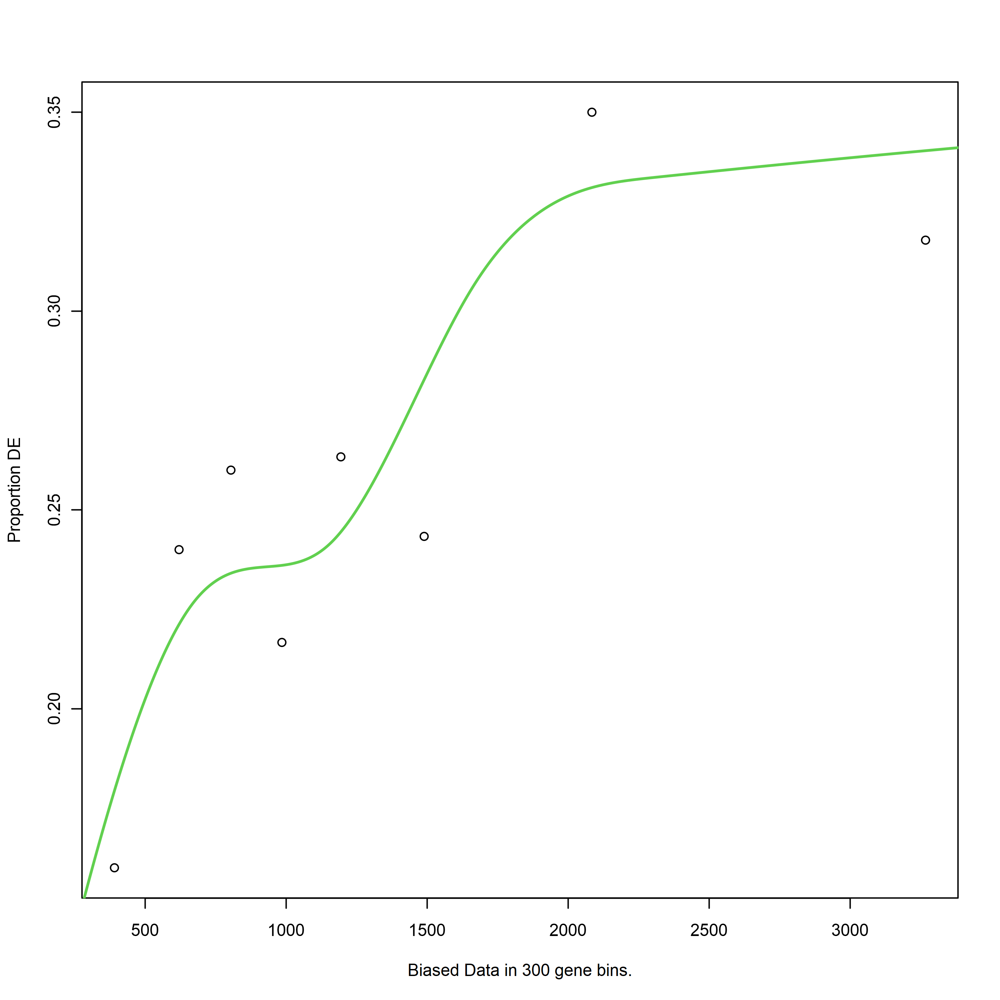

Using manually entered categories.

Calculating the p-values...



[1] "C4vsC3_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


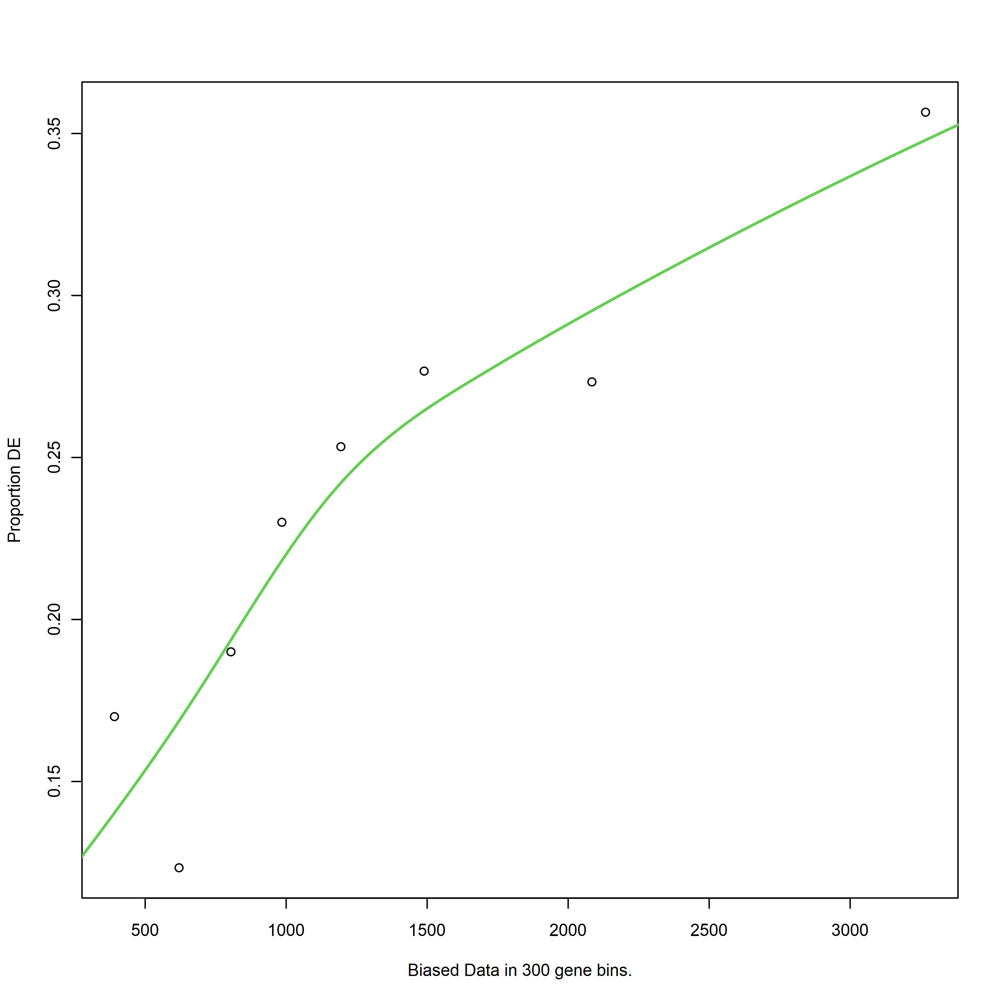

Using manually entered categories.

Calculating the p-values...



[1] "C4vsC3_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


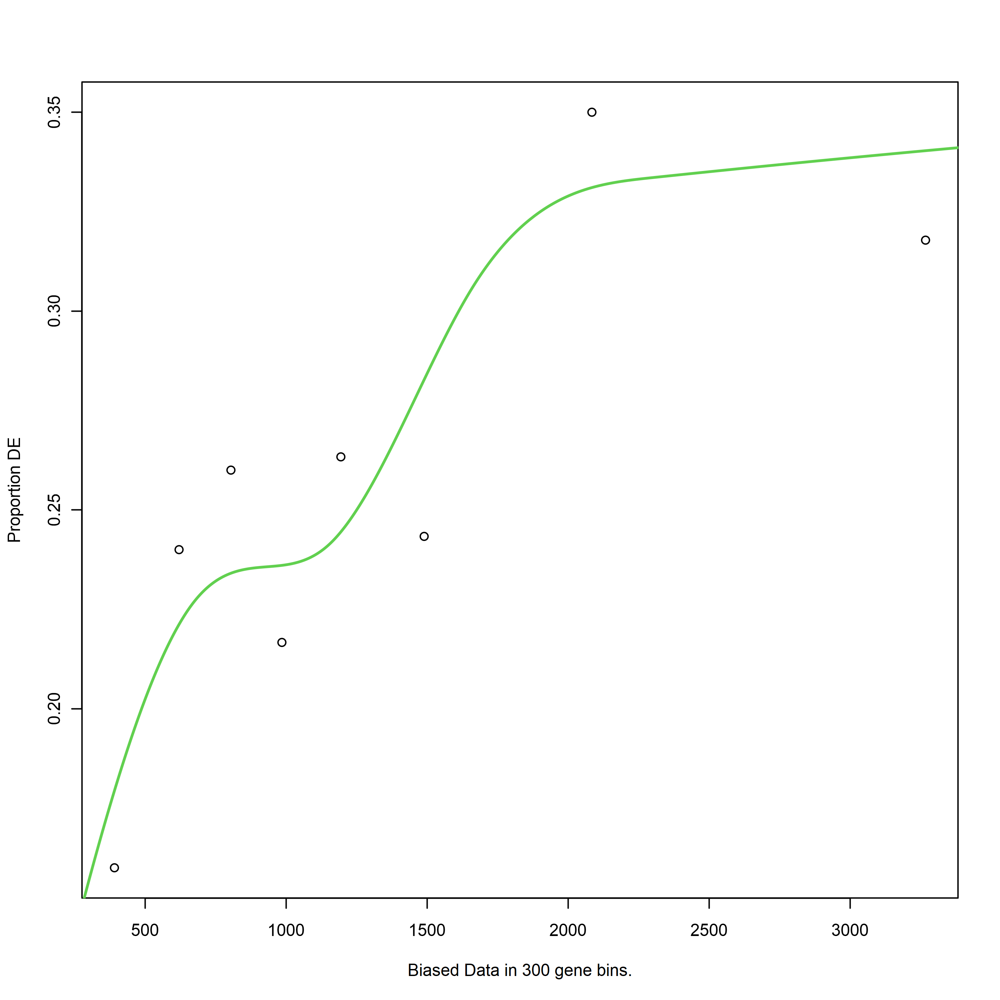

Using manually entered categories.

Calculating the p-values...



[1] "C4vsC3_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


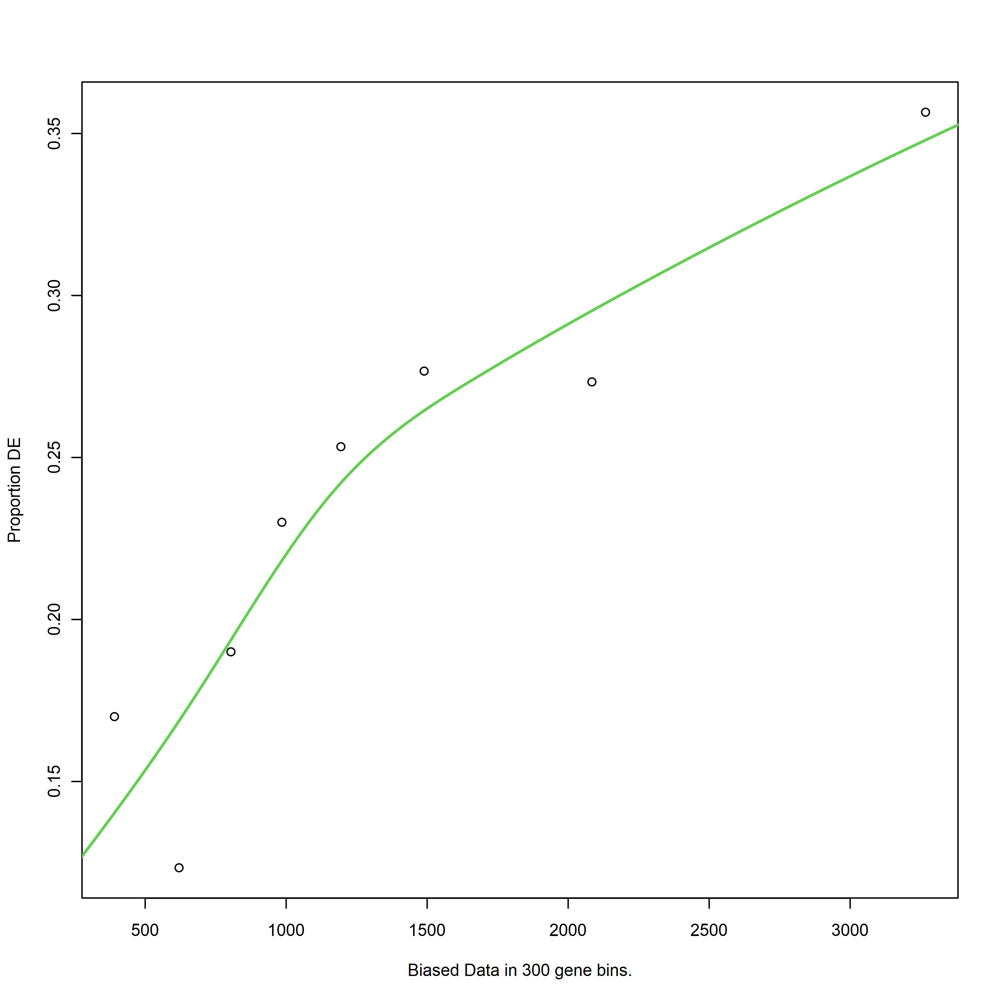

Using manually entered categories.

Calculating the p-values...



[1] "C4vsC3_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


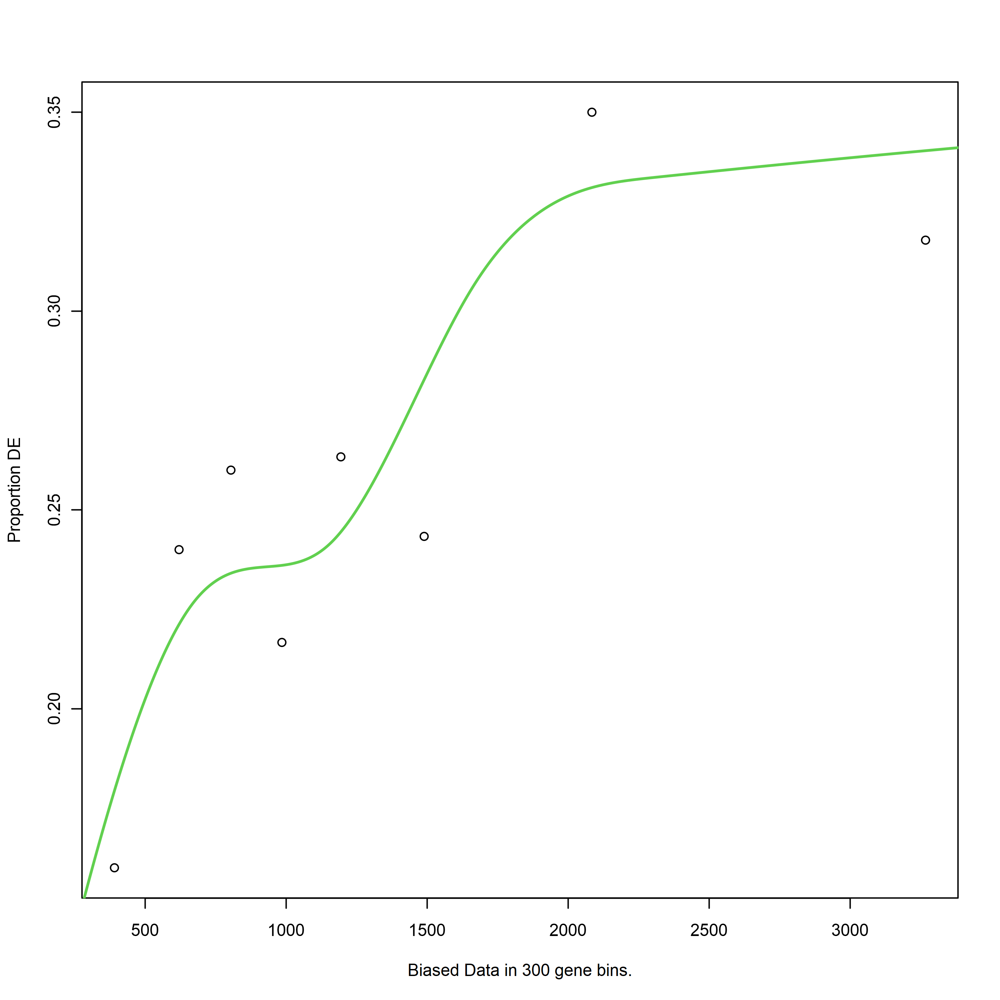

Using manually entered categories.

Calculating the p-values...



[1] "C4vsC3_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


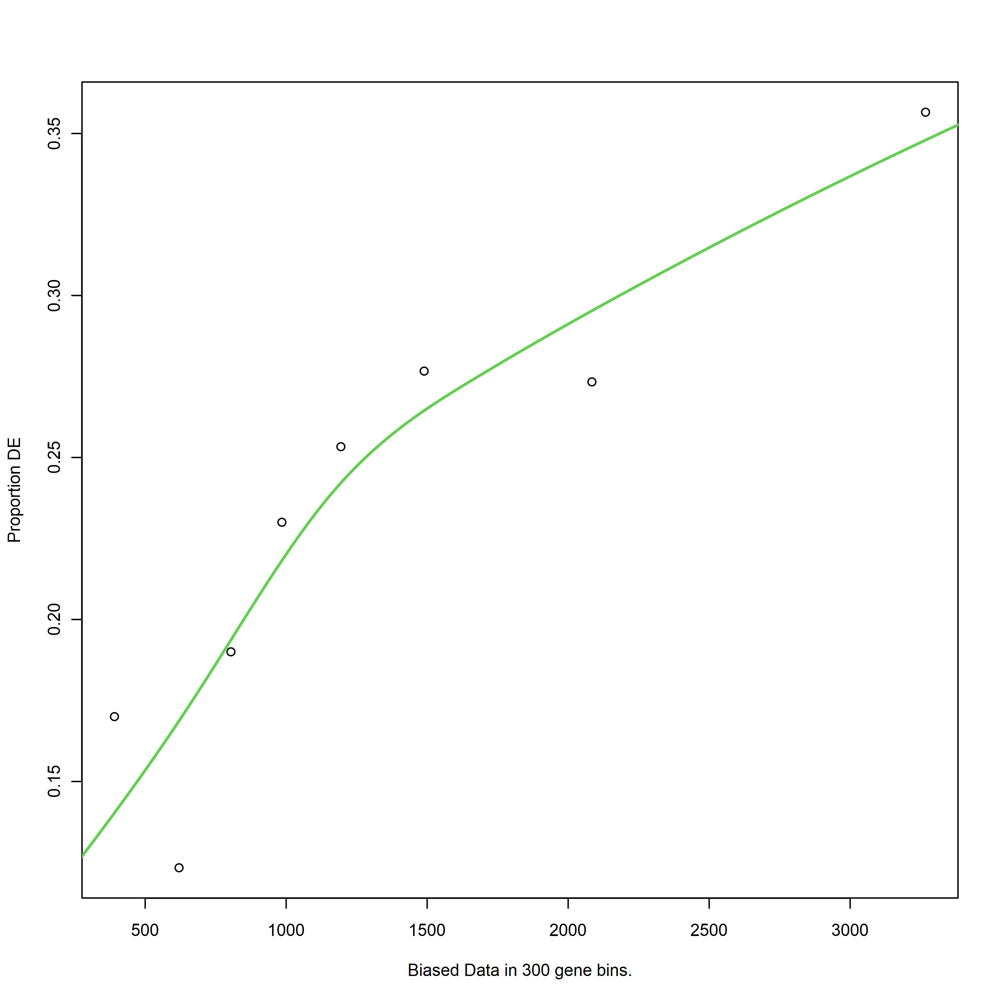

Using manually entered categories.

Calculating the p-values...



[1] "C4vsC3_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


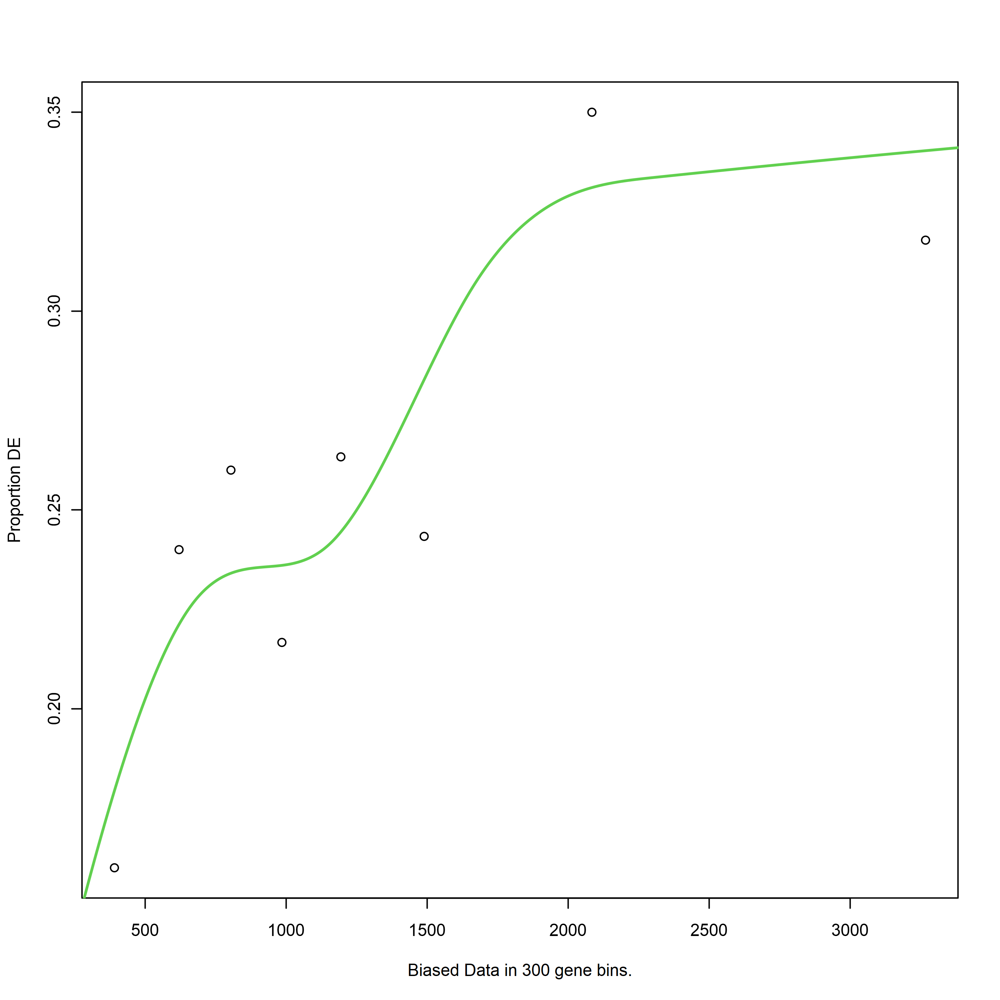

Using manually entered categories.

Calculating the p-values...



[1] "C5vsC4_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


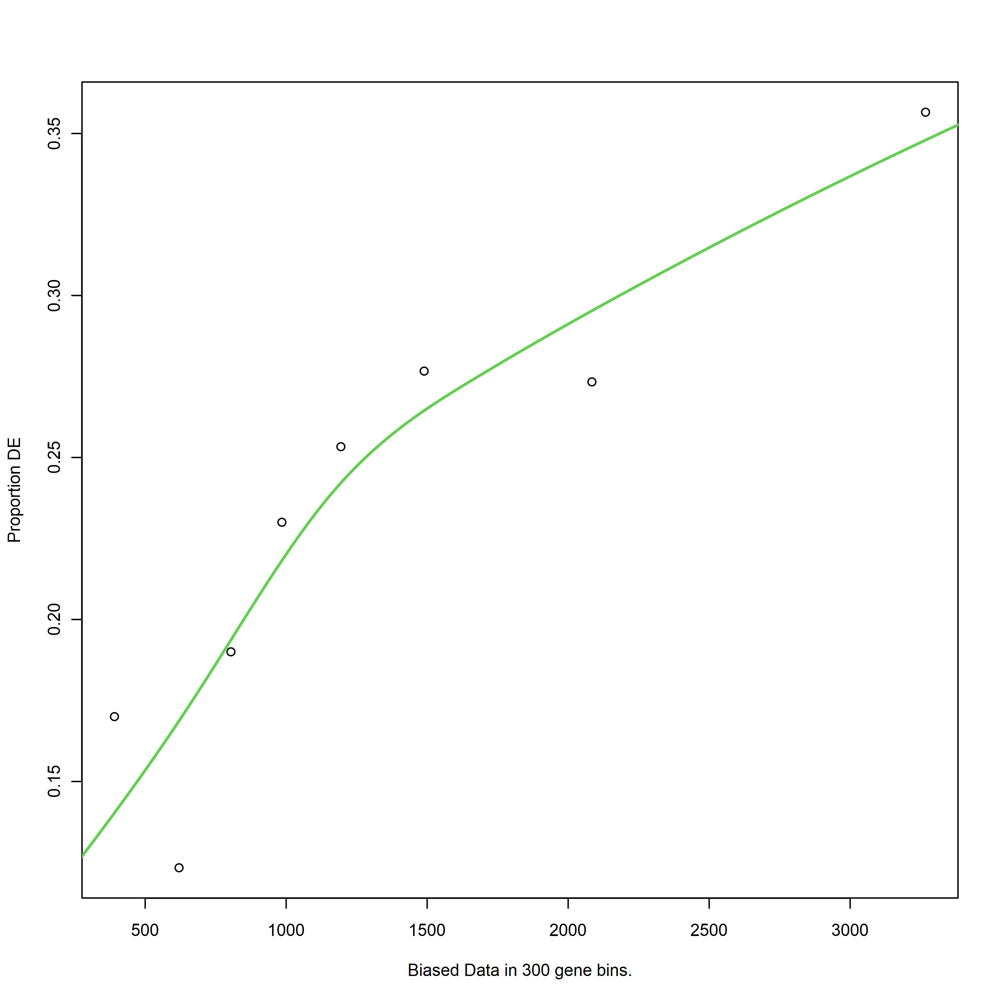

Using manually entered categories.

Calculating the p-values...



[1] "C5vsC4_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


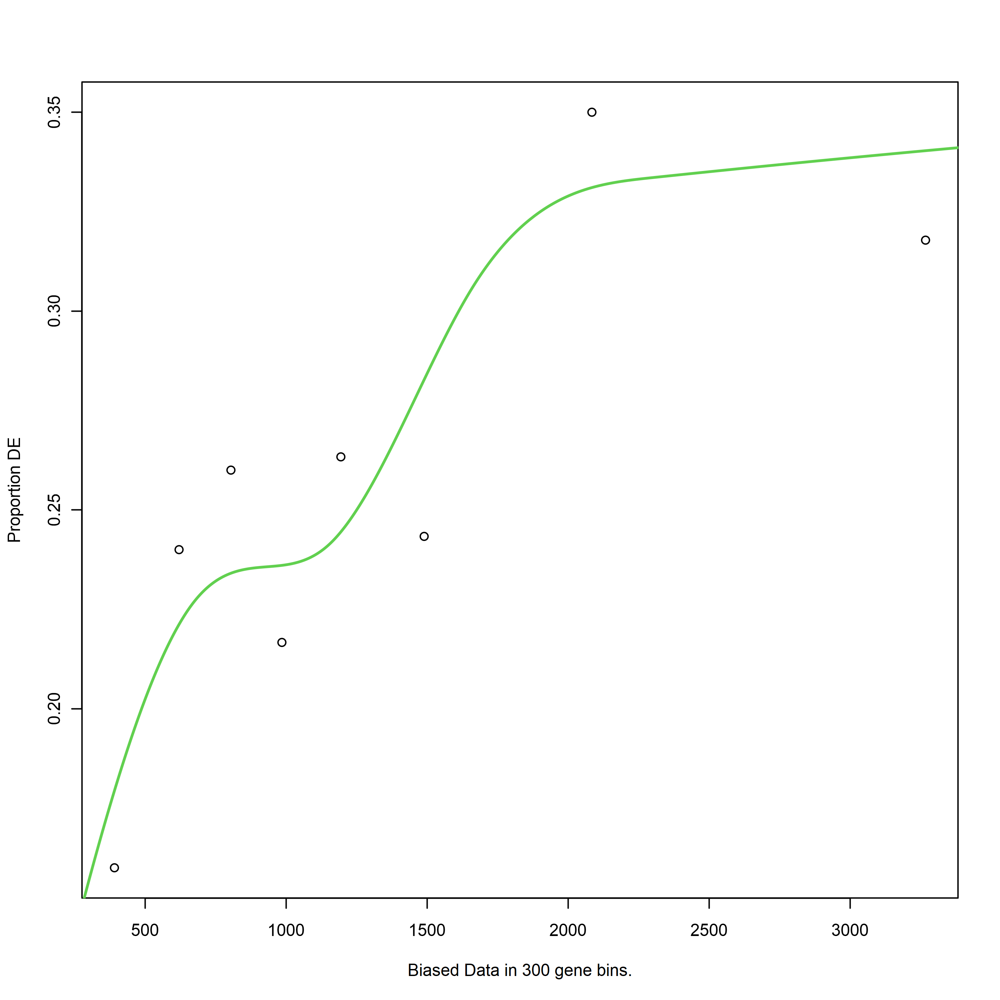

Using manually entered categories.

Calculating the p-values...



[1] "C5vsC4_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


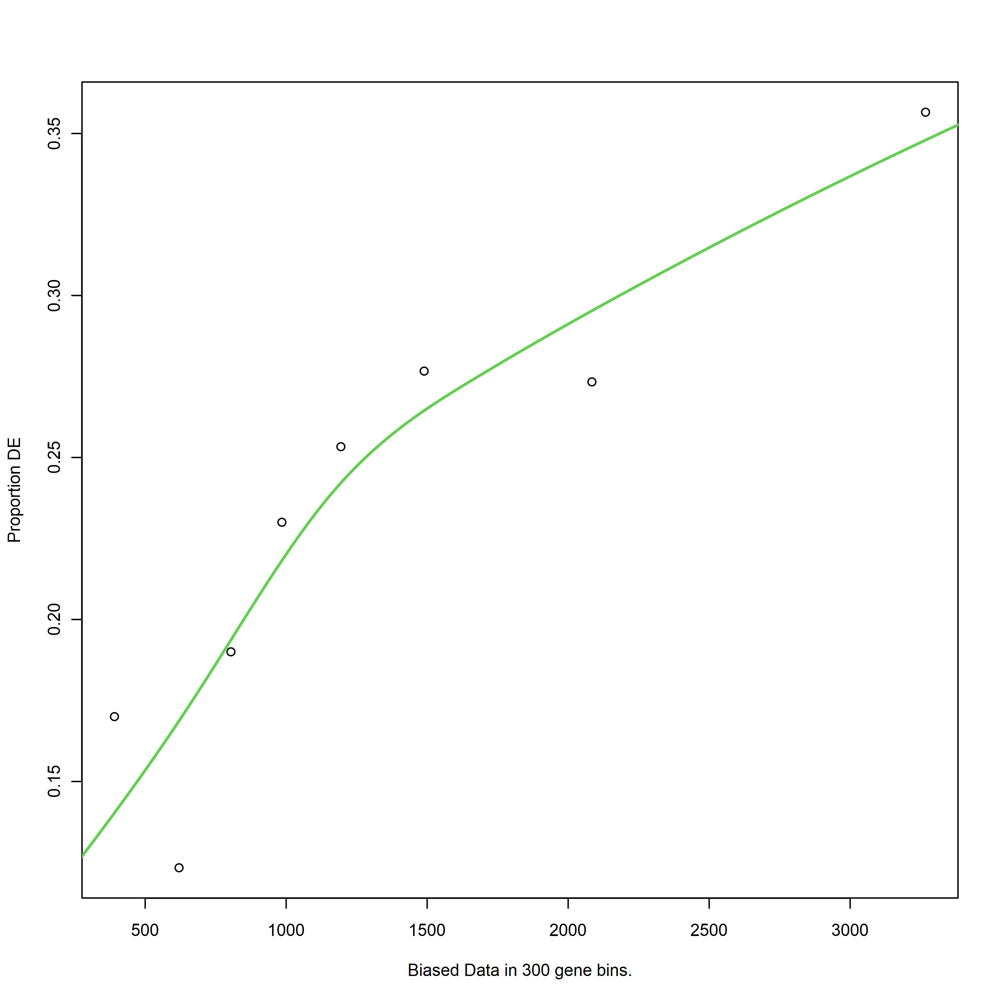

Using manually entered categories.

Calculating the p-values...



[1] "C5vsC4_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


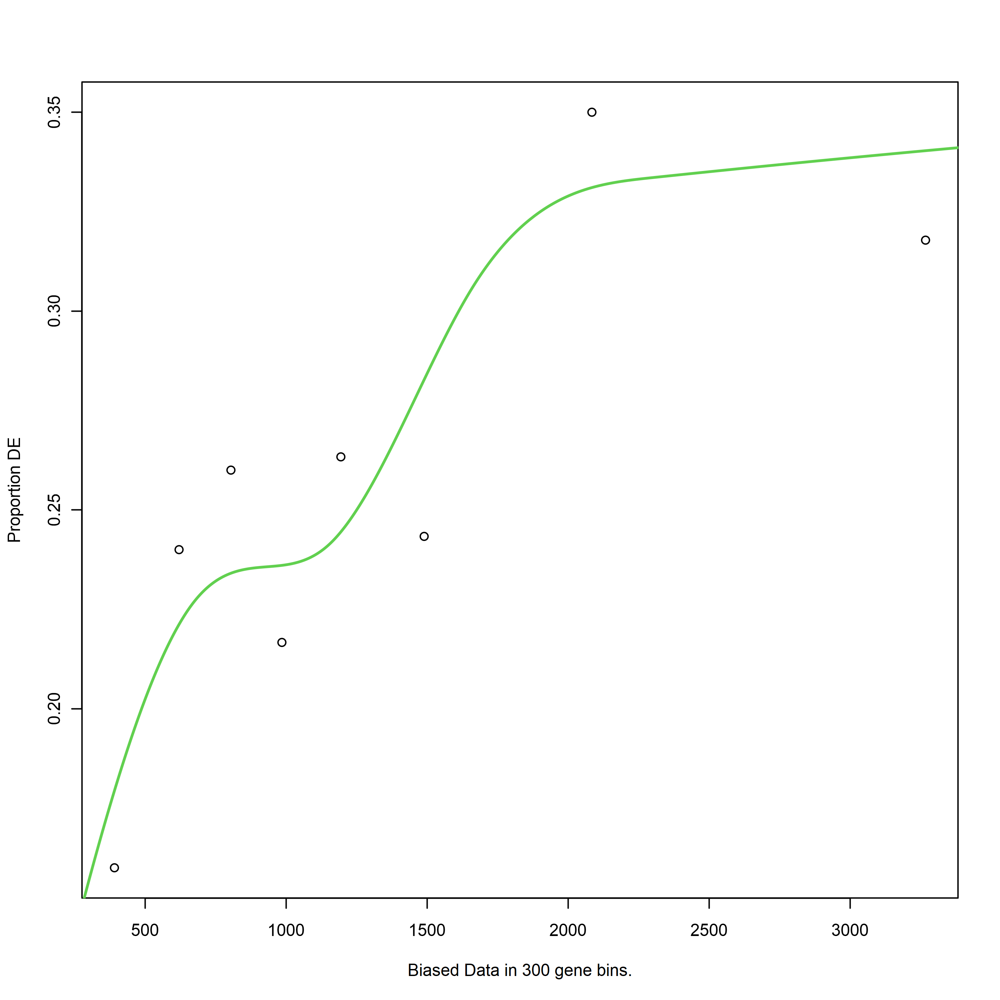

Using manually entered categories.

Calculating the p-values...



[1] "C5vsC4_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


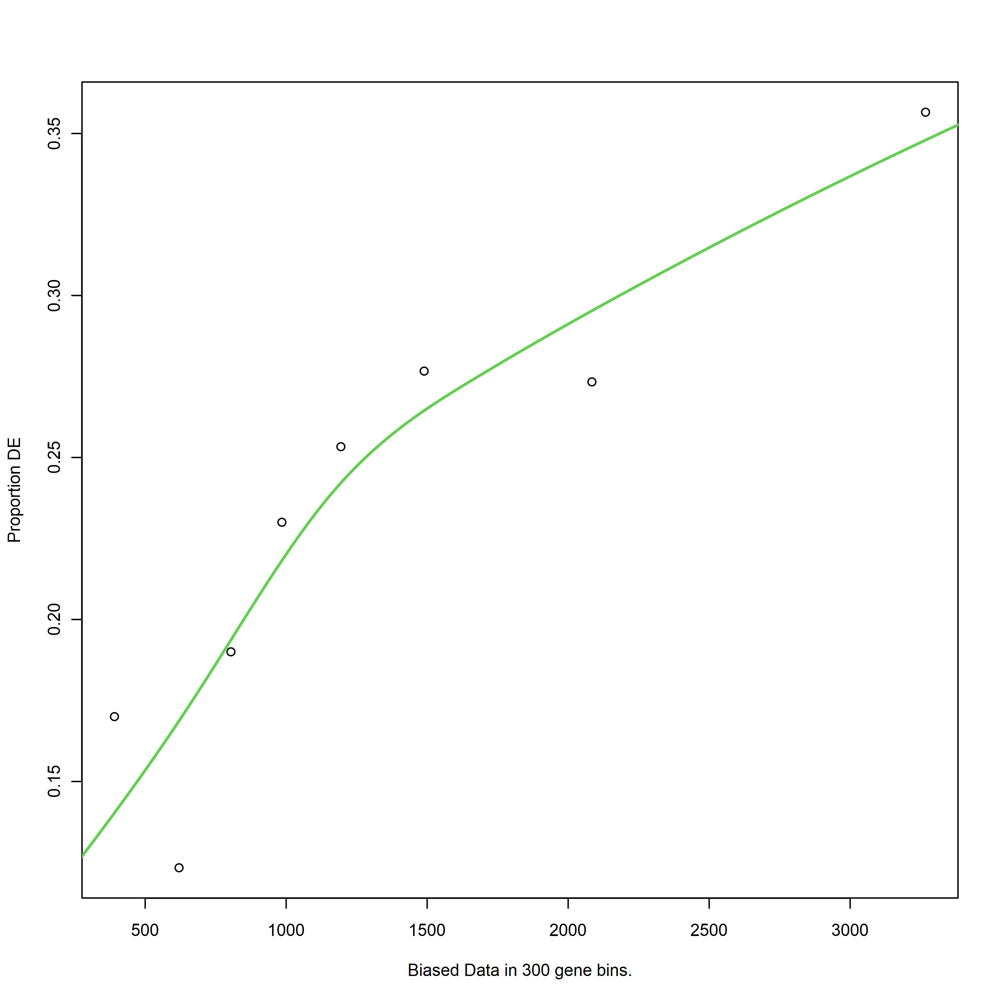

Using manually entered categories.

Calculating the p-values...



[1] "C5vsC4_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


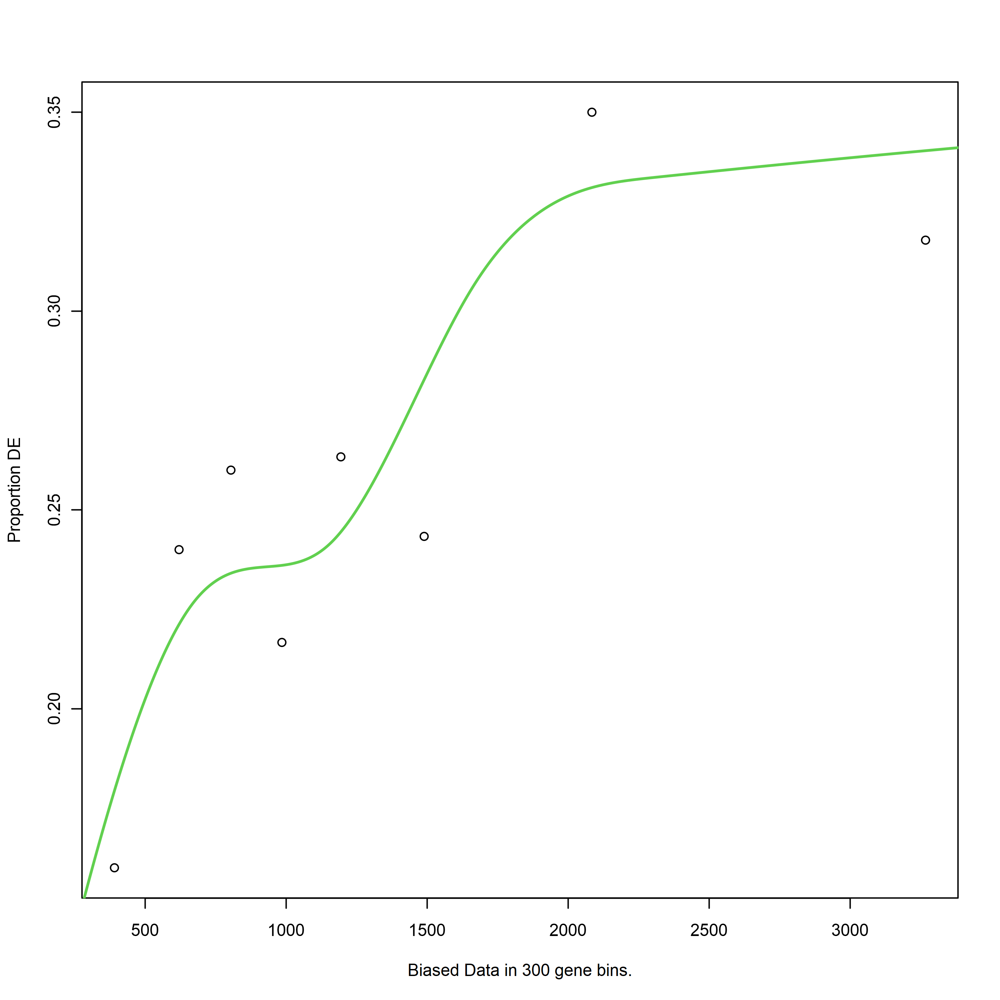

Using manually entered categories.

Calculating the p-values...



[1] "C5vsC4_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


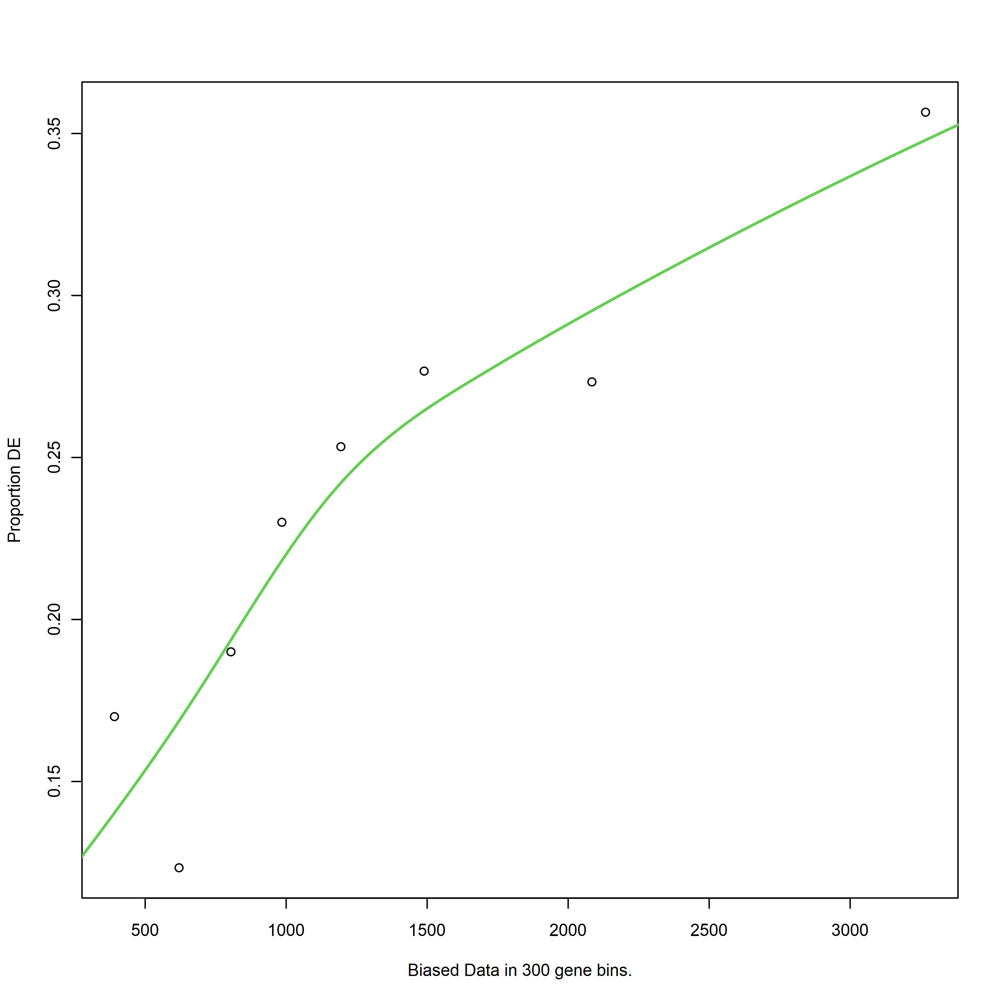

Using manually entered categories.

Calculating the p-values...



[1] "C5vsC4_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


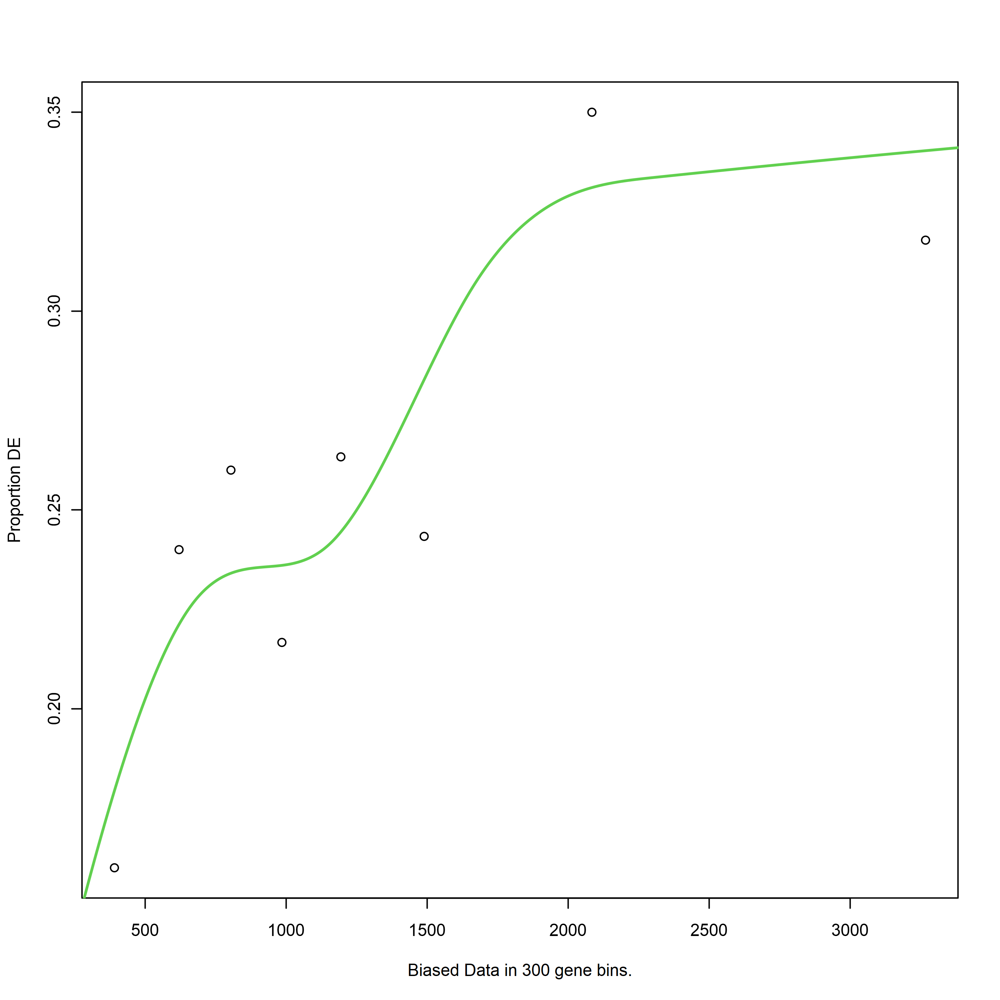

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


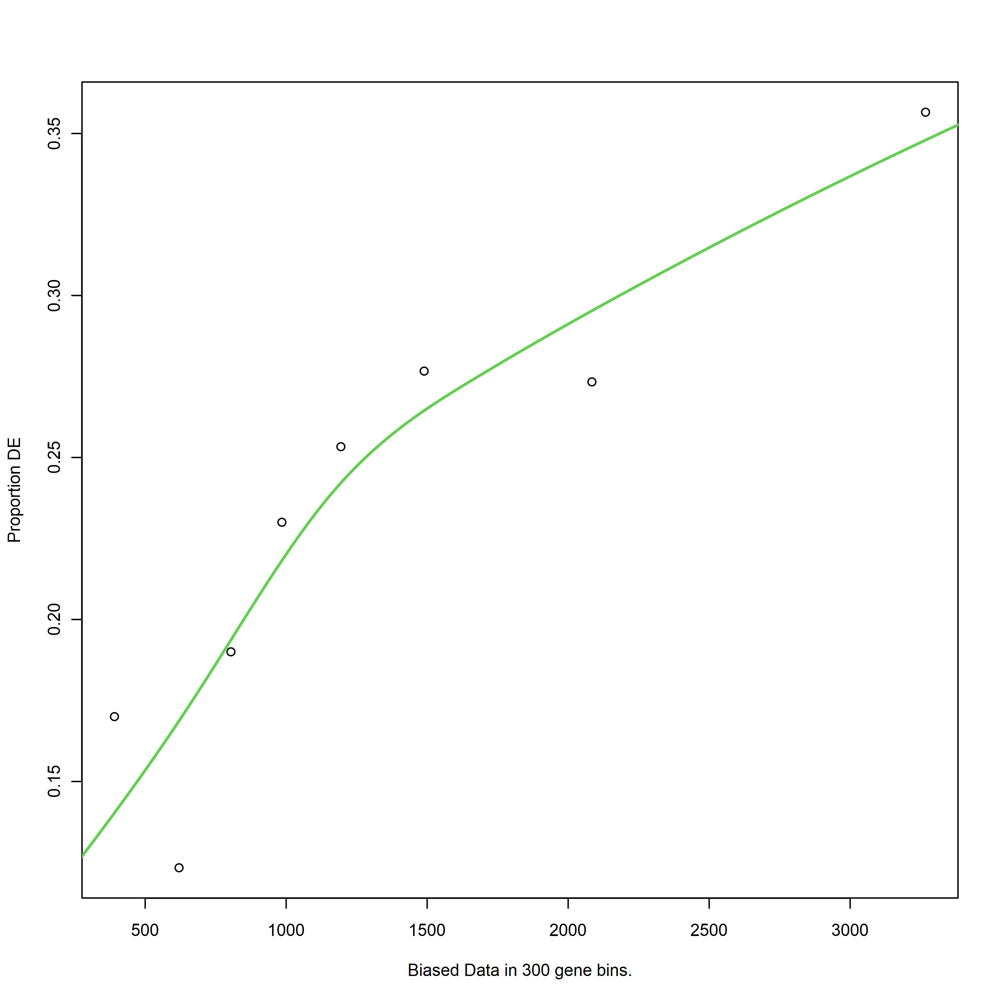

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


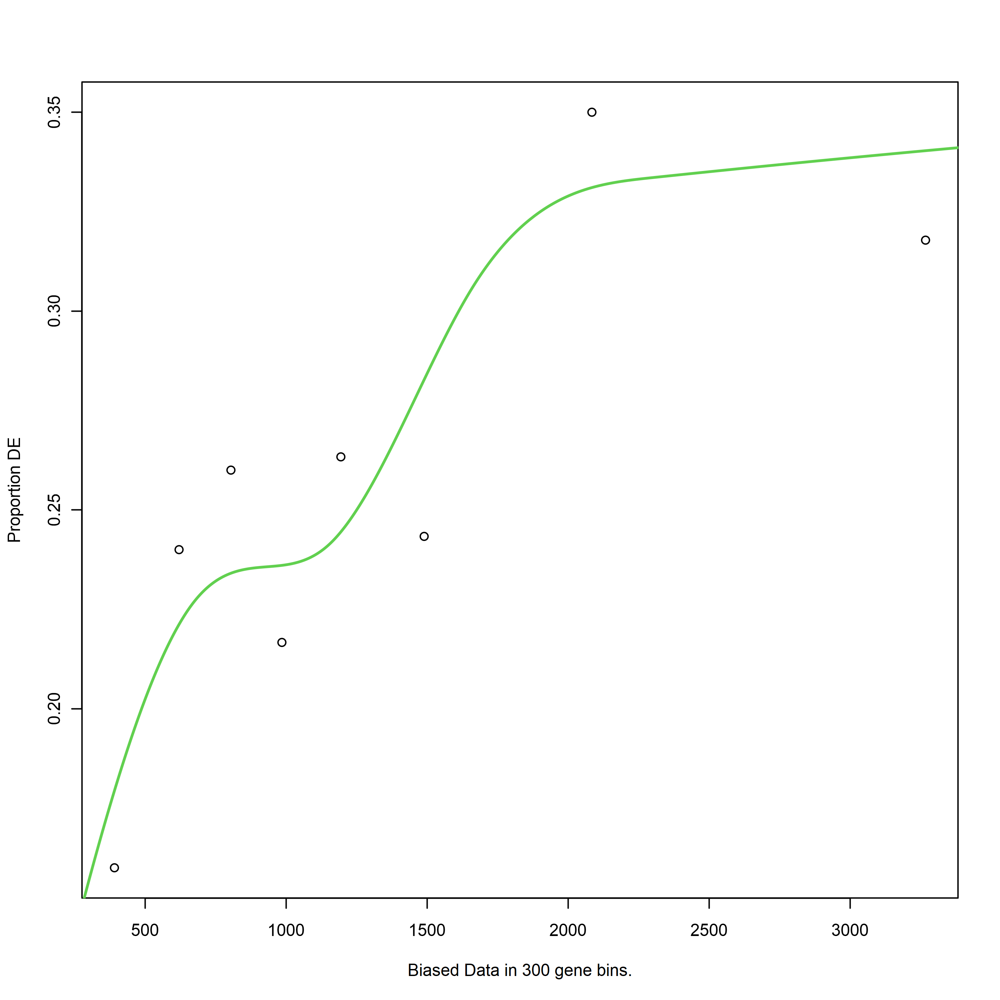

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


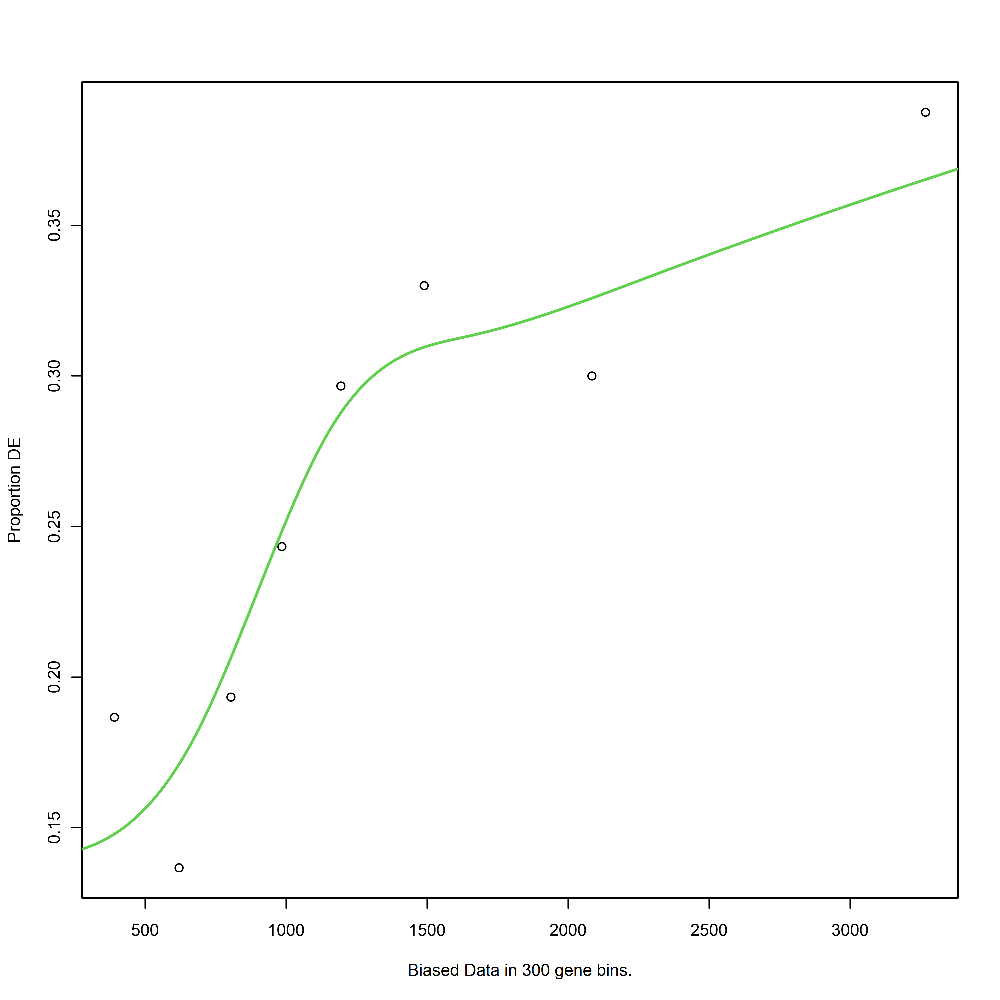

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


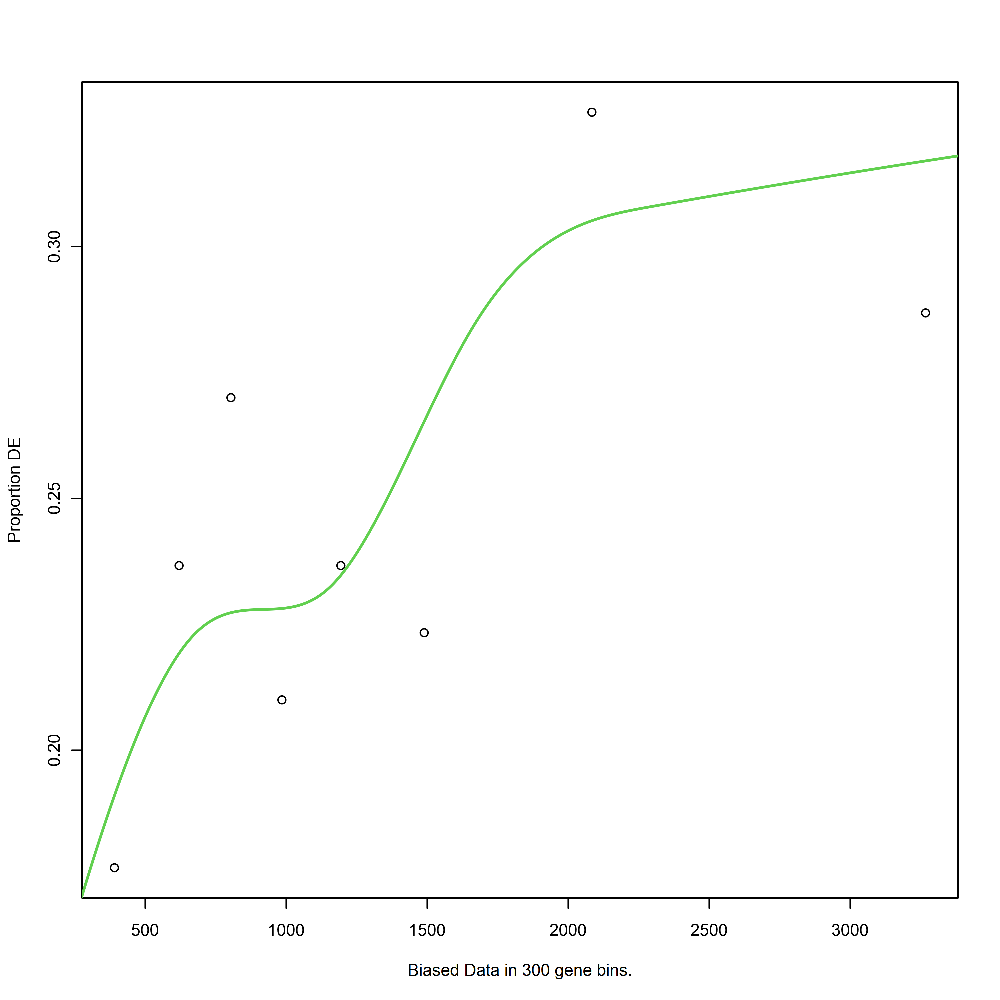

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


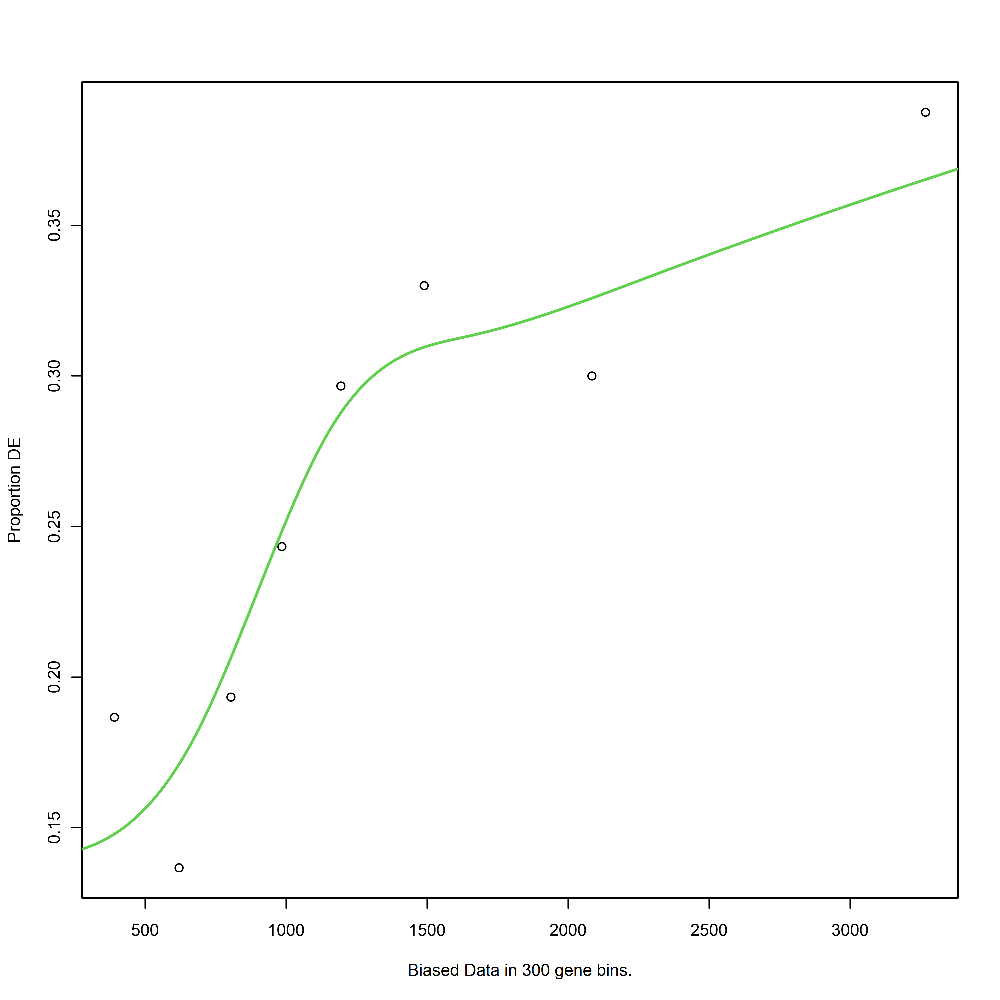

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


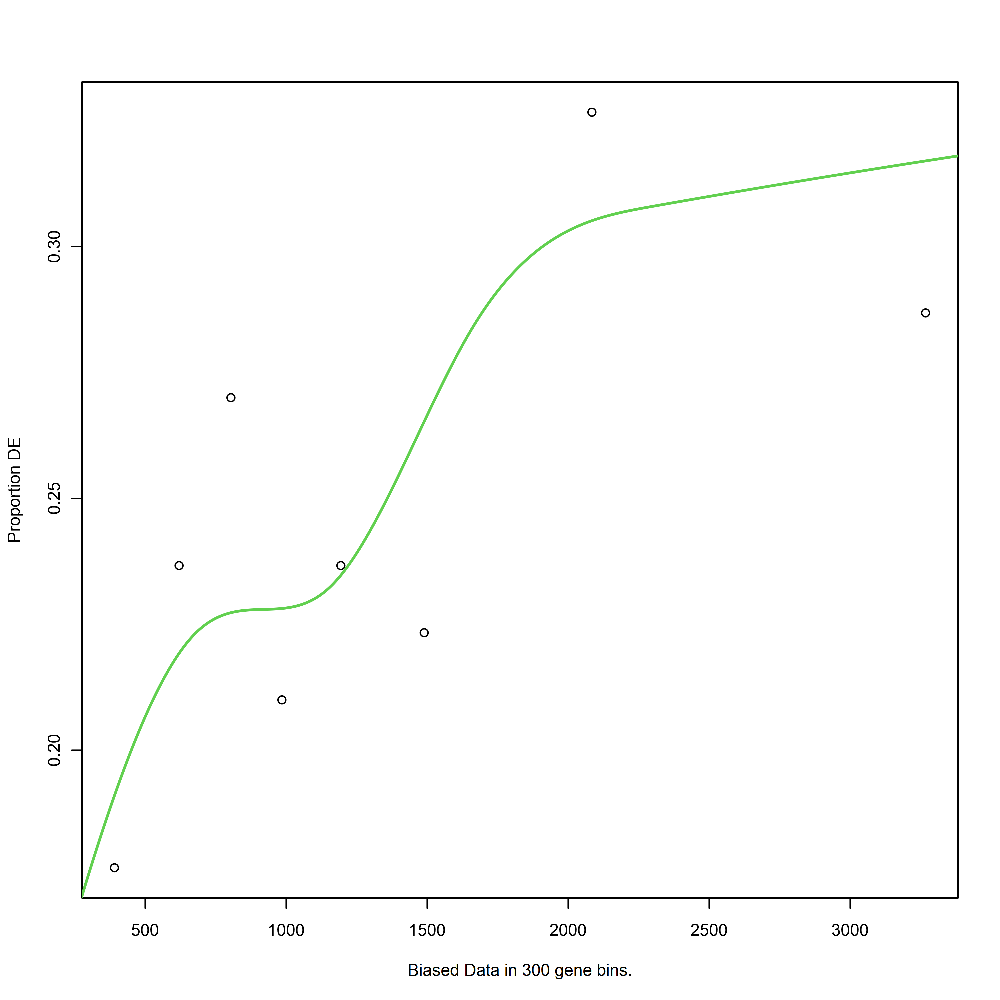

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC1_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


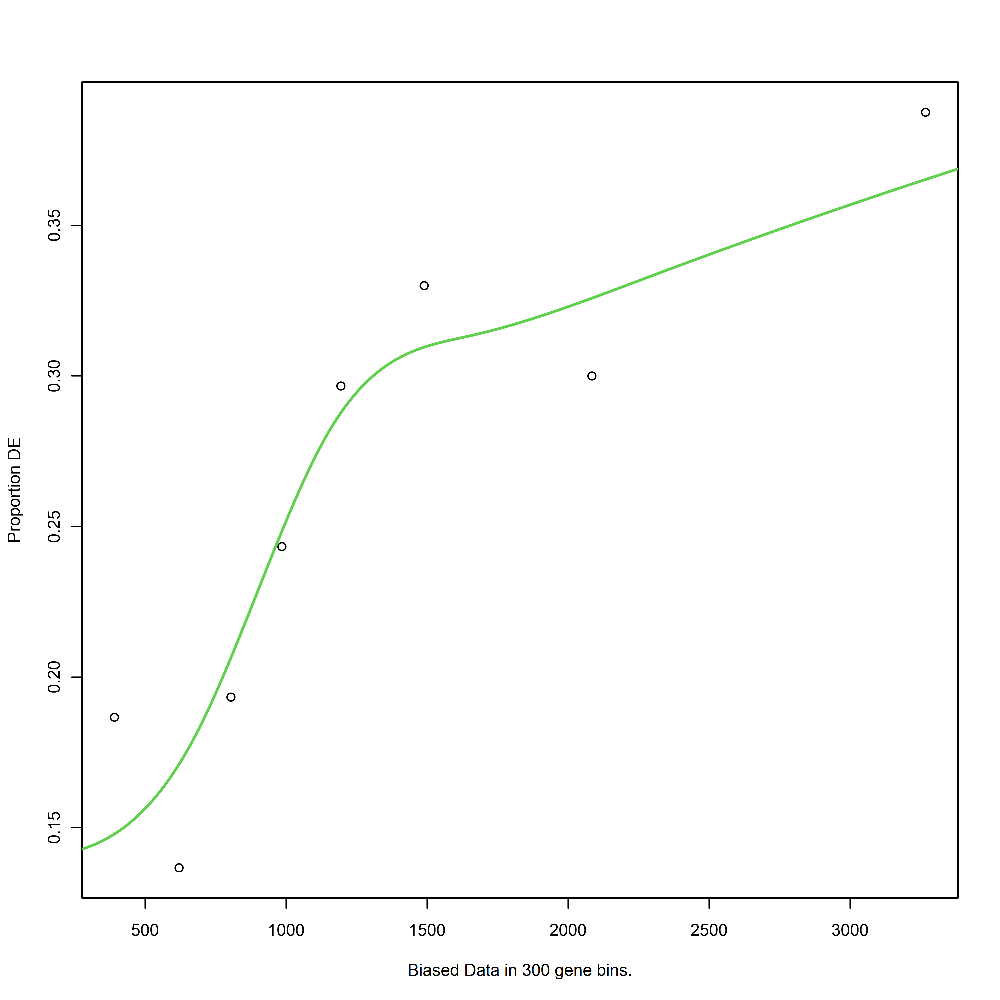

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


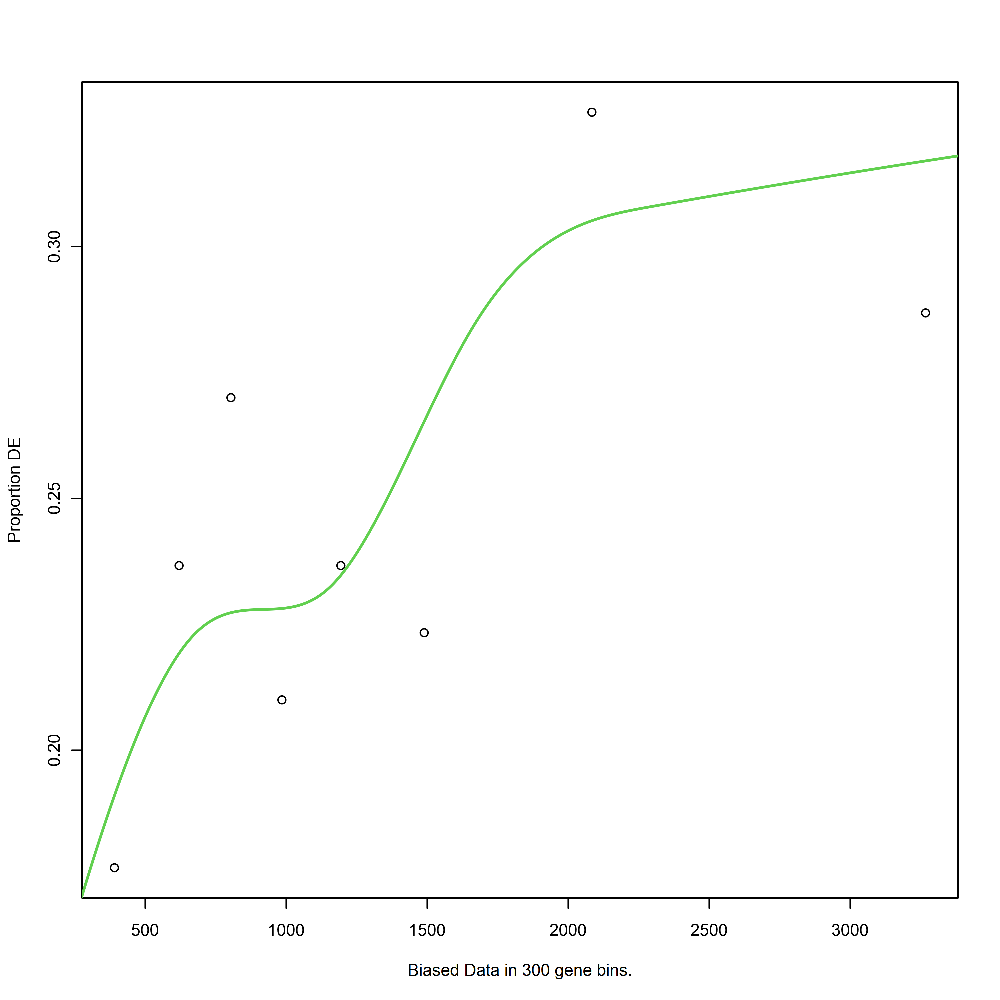

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC2_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


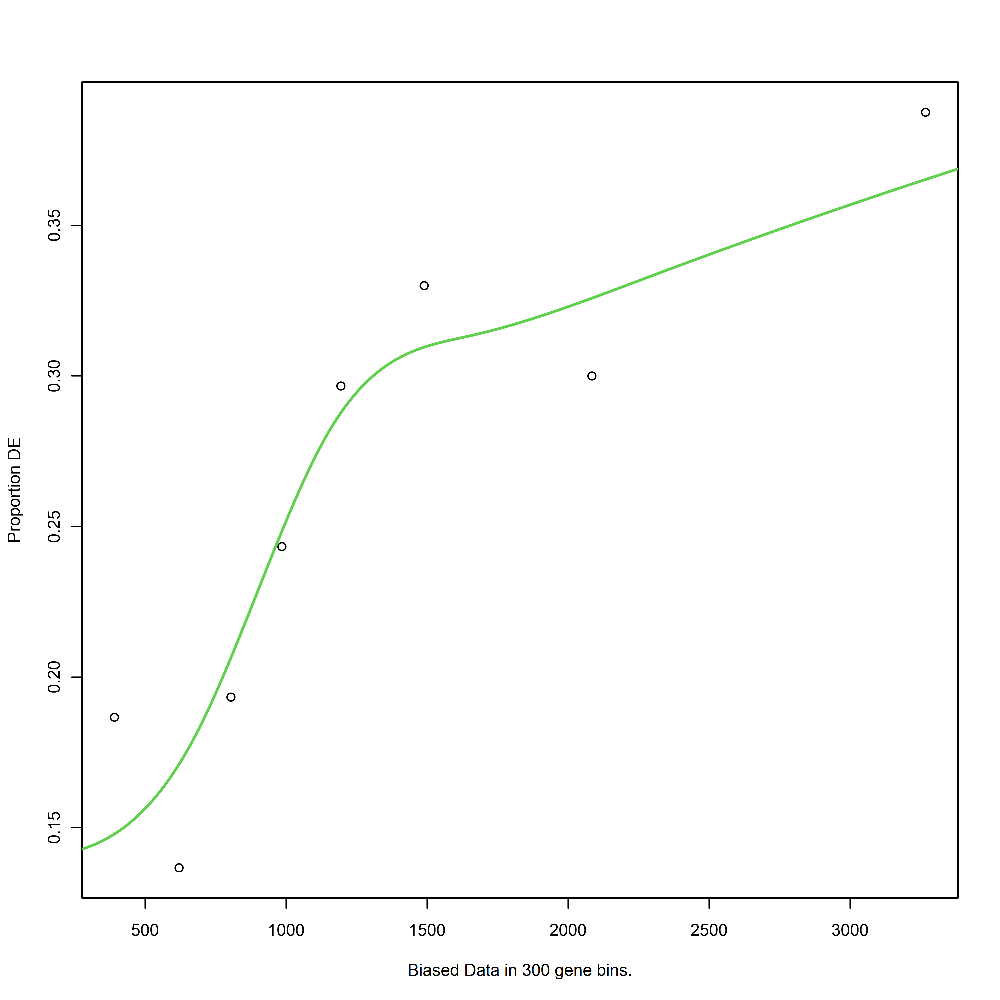

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC2_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


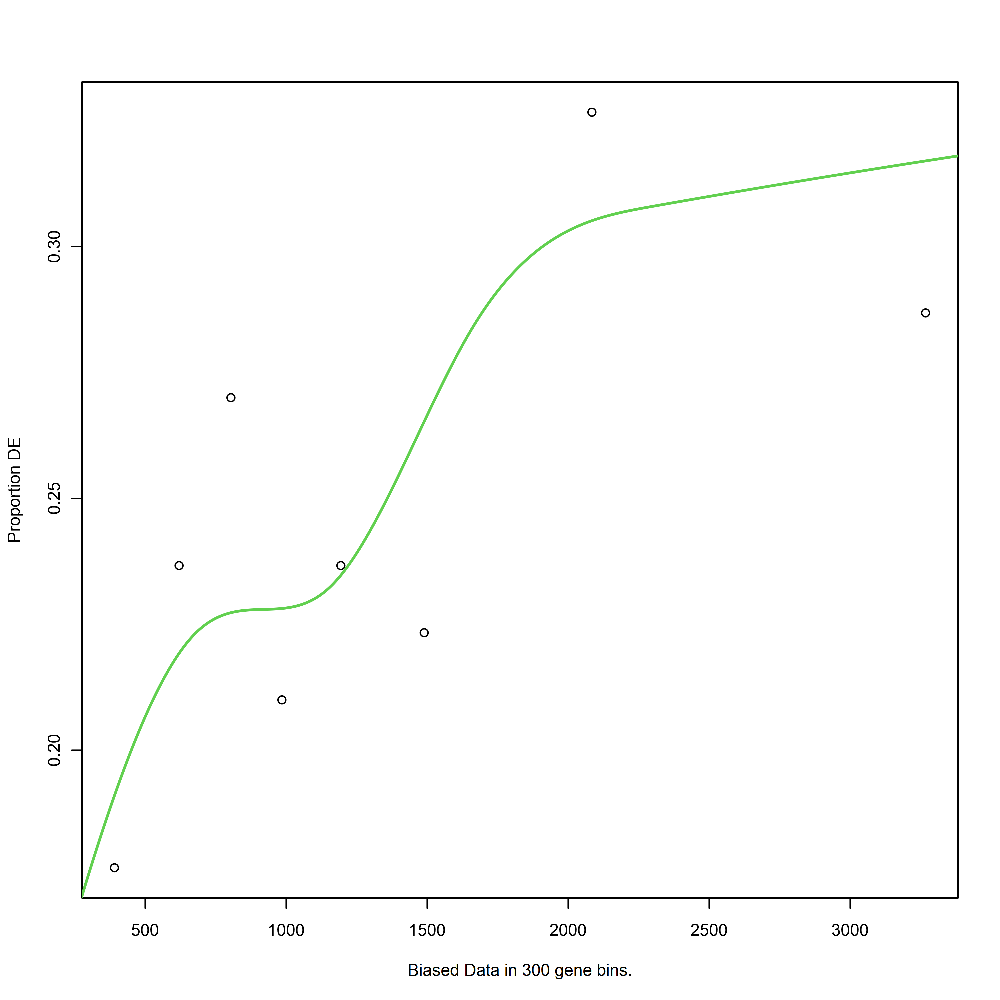

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC2_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


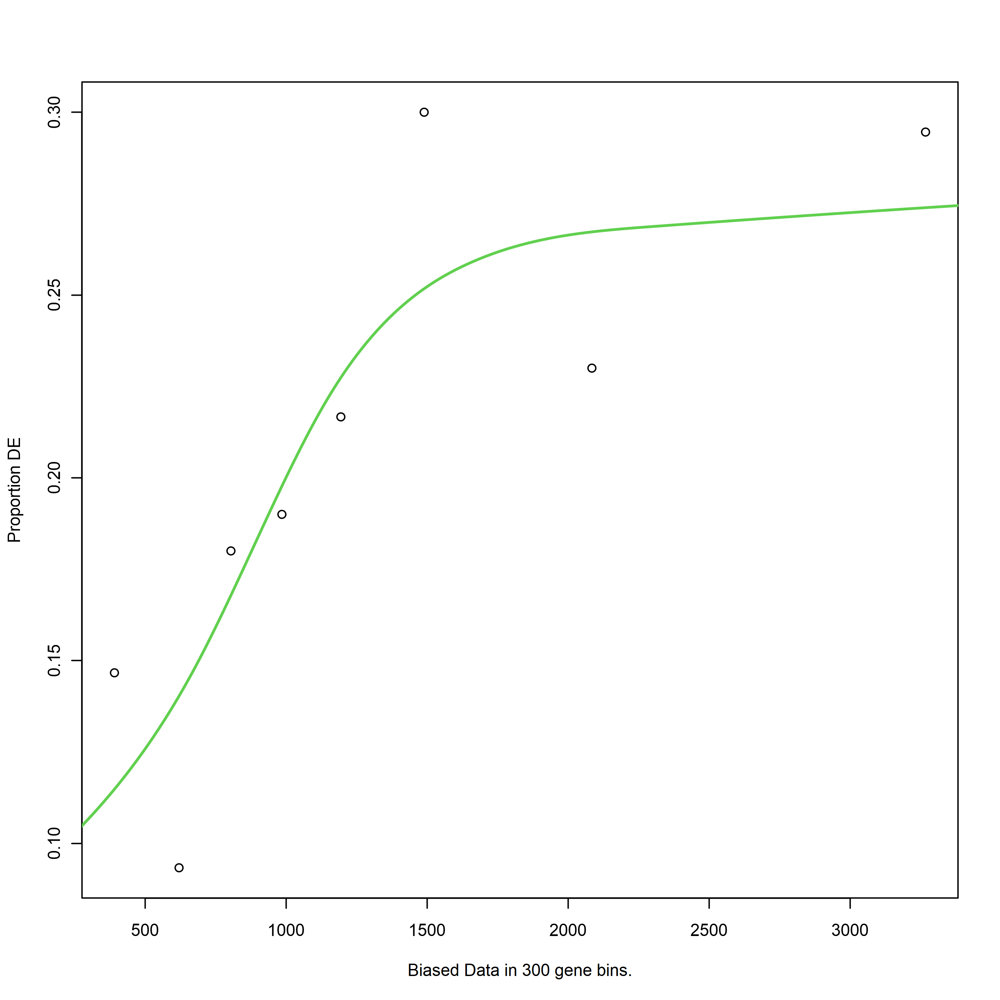

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC2_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


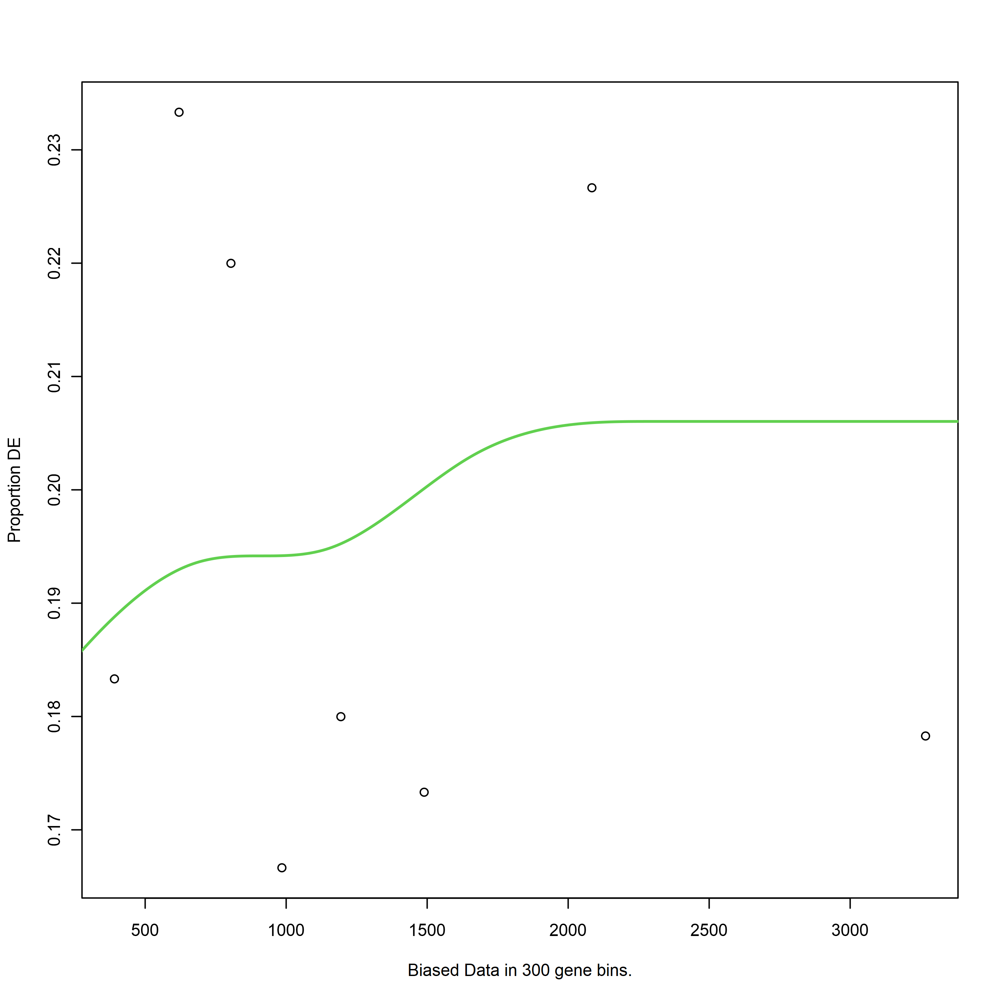

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC2_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


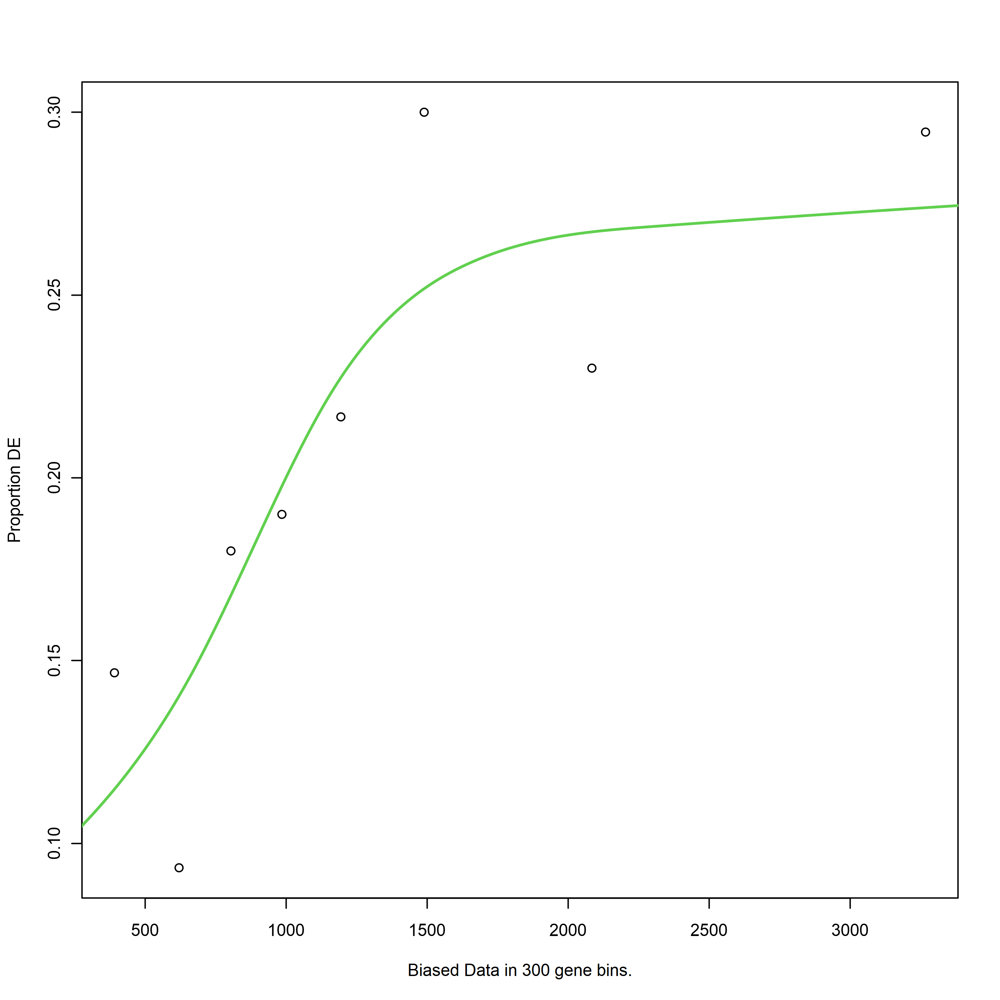

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC2_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


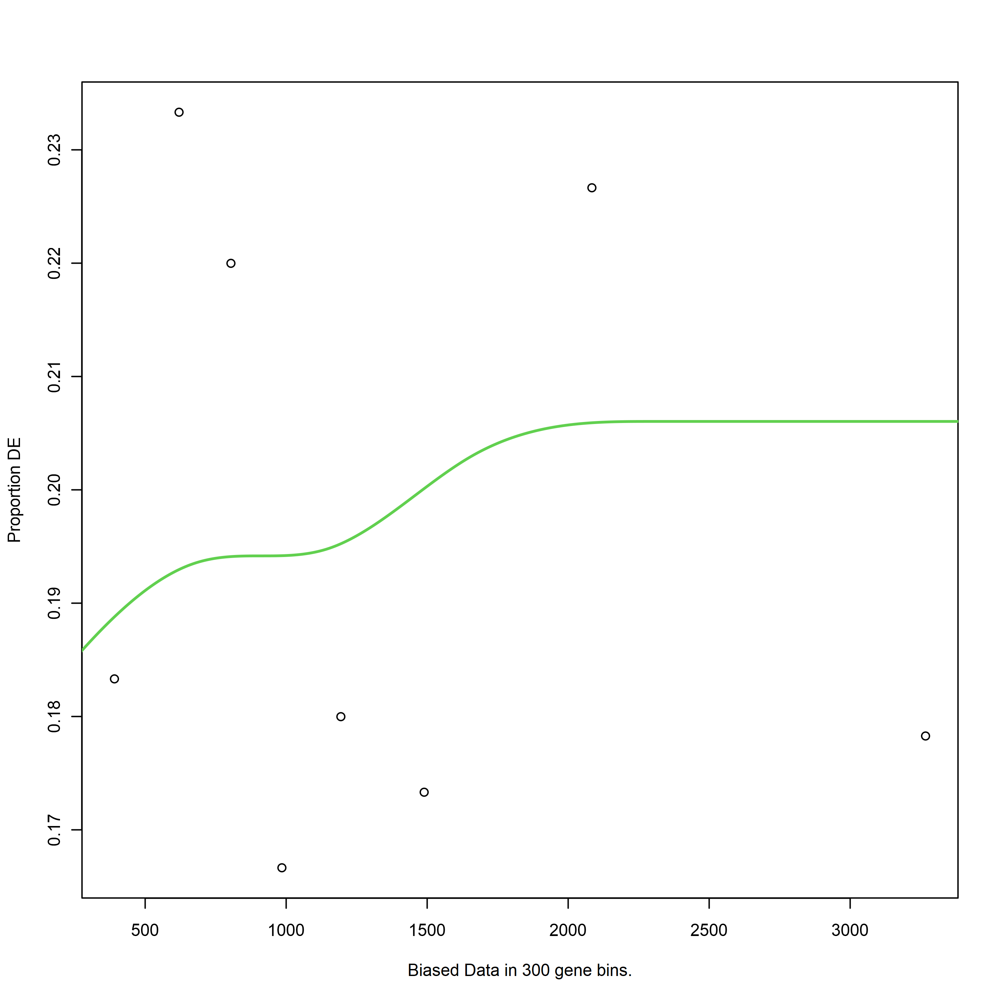

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC2_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


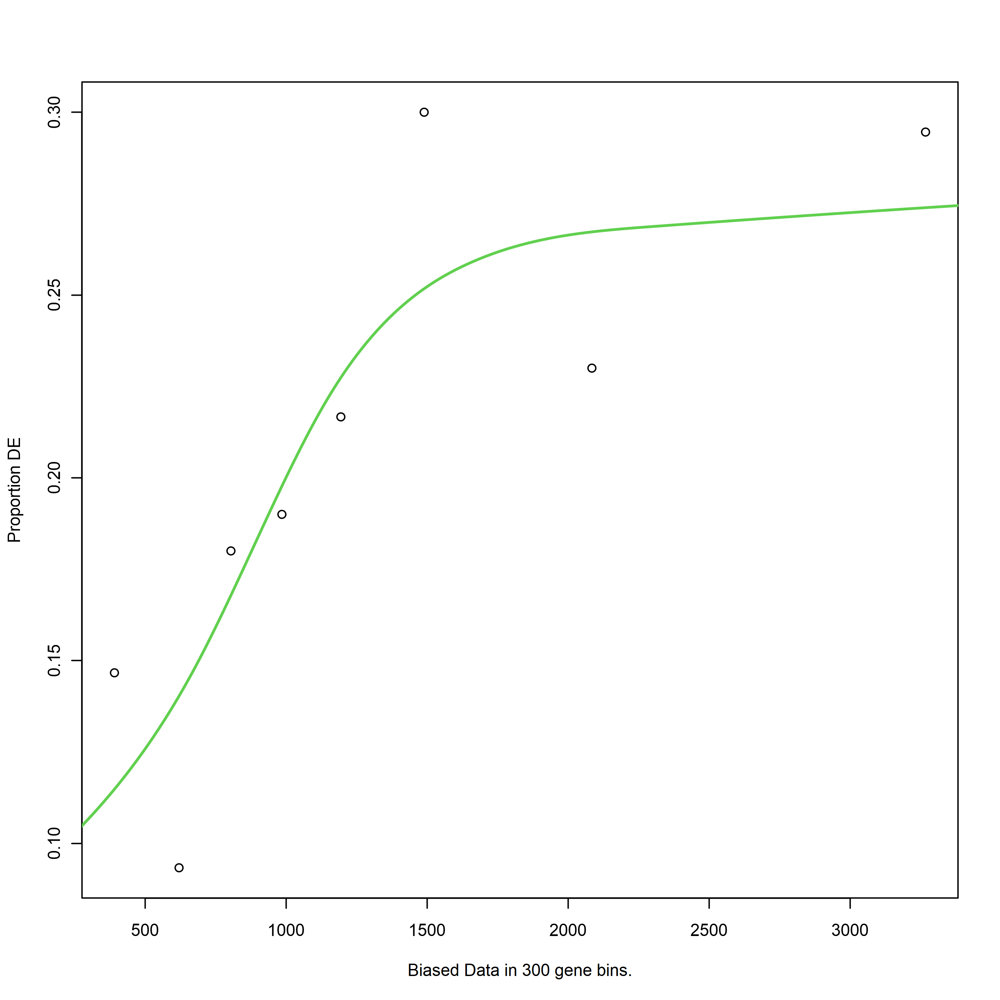

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC2_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


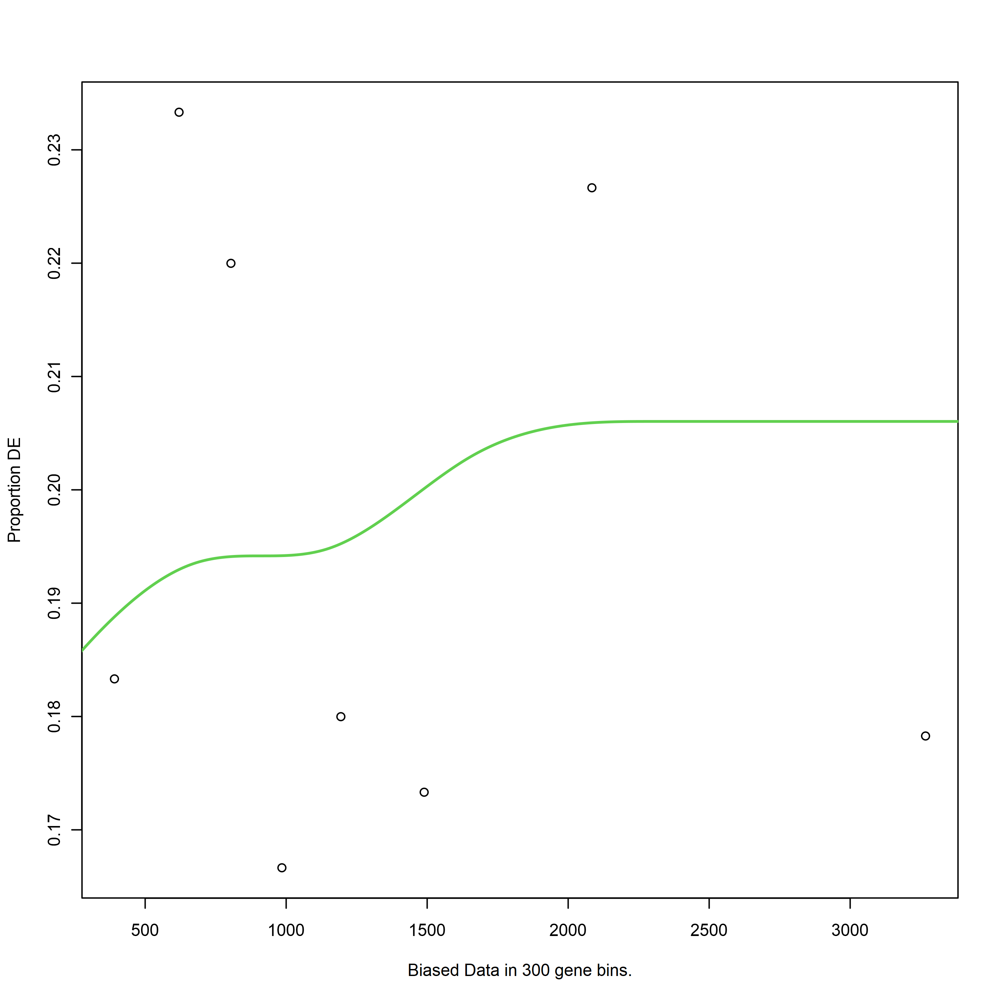

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC3_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


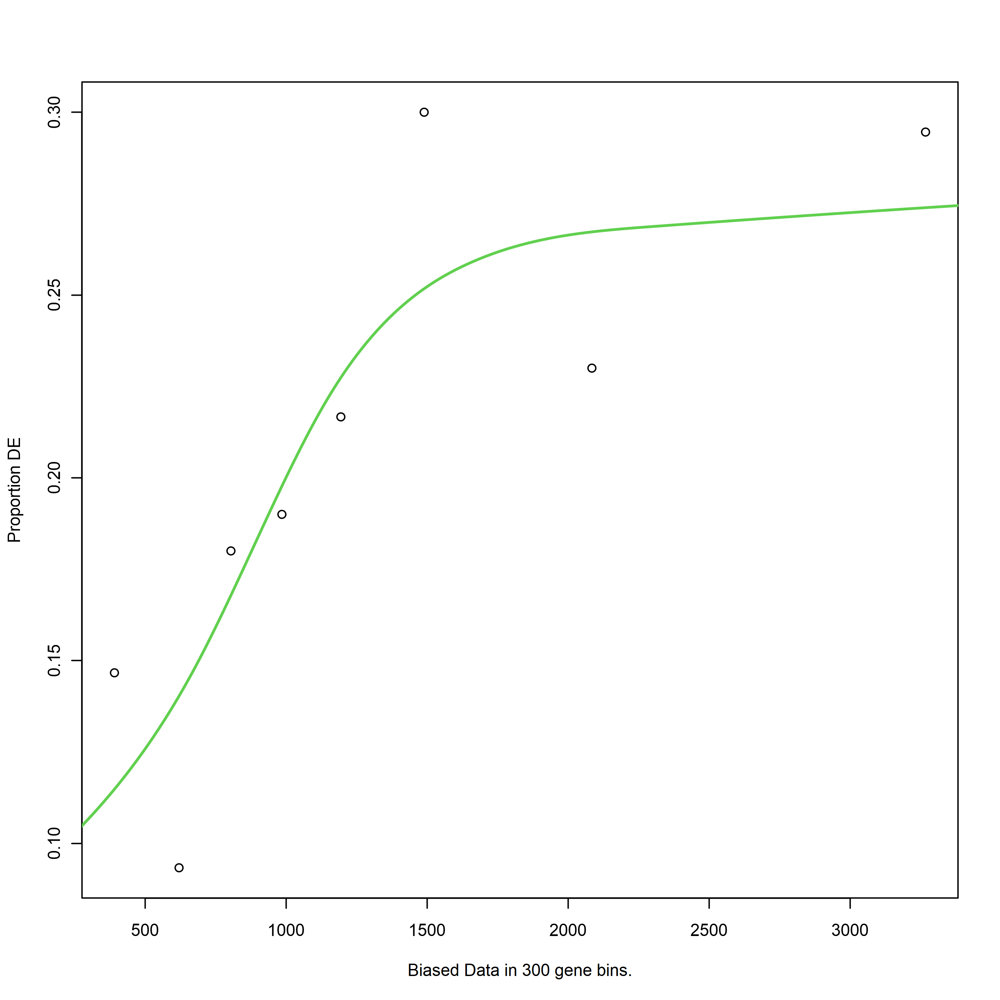

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC3_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


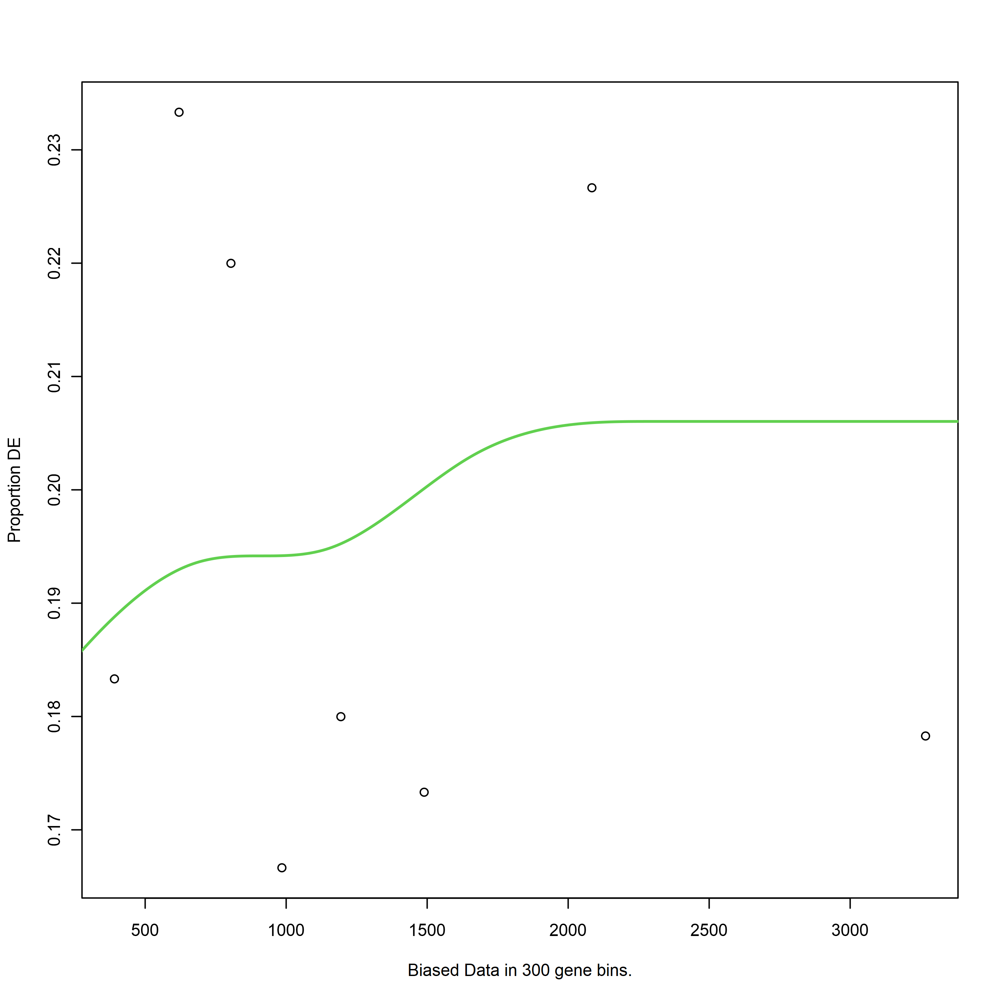

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC3_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


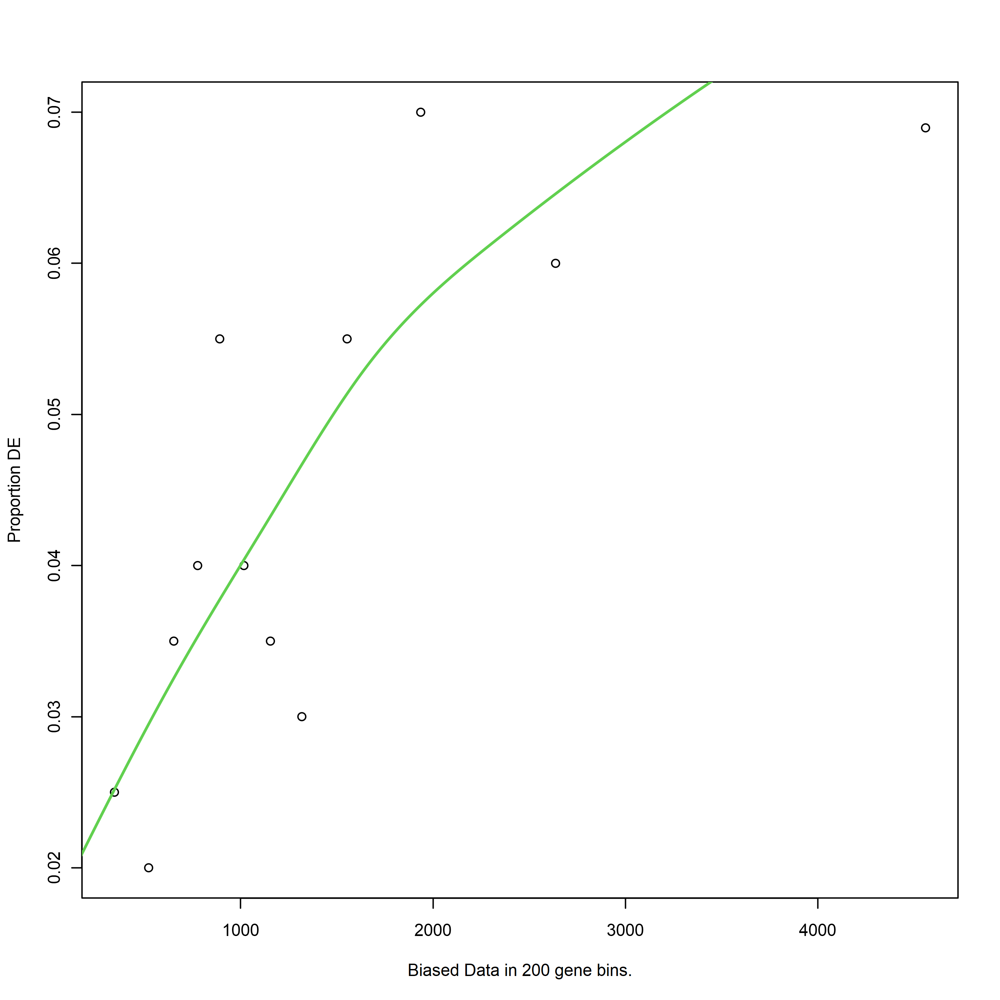

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC3_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


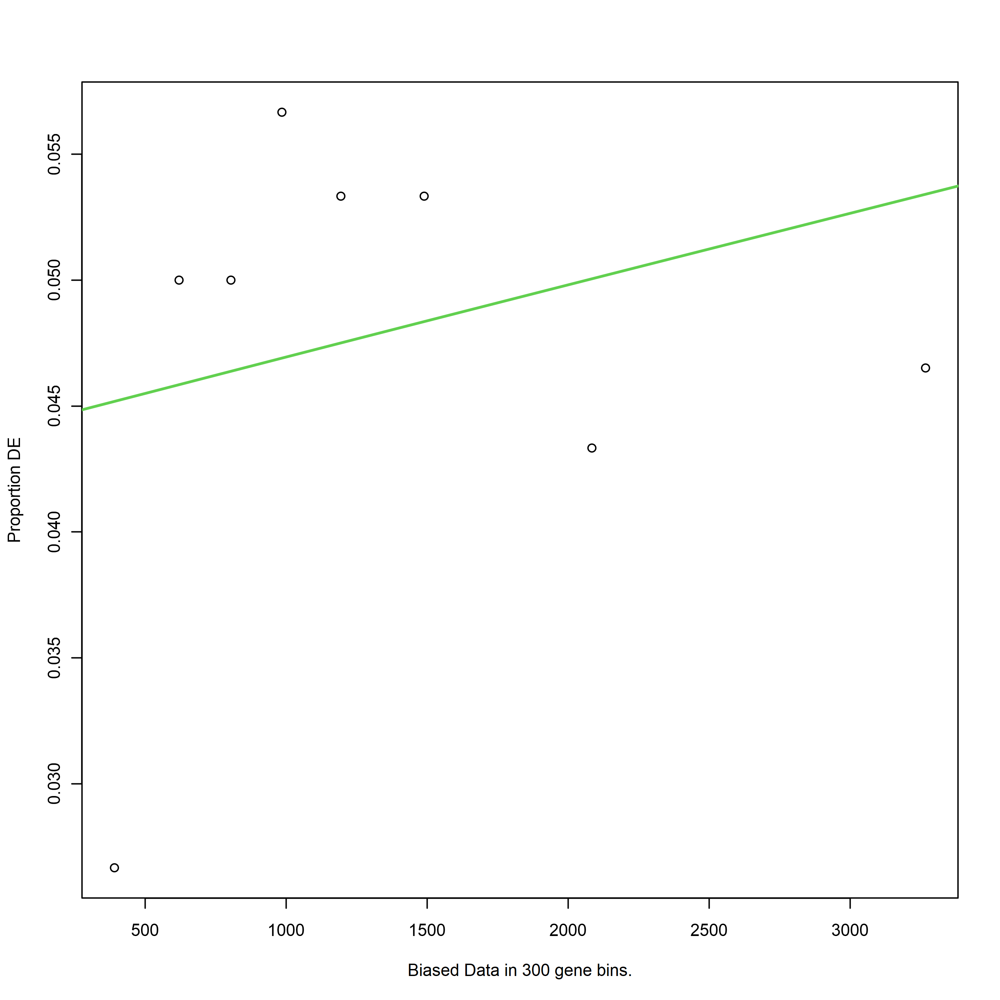

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC3_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


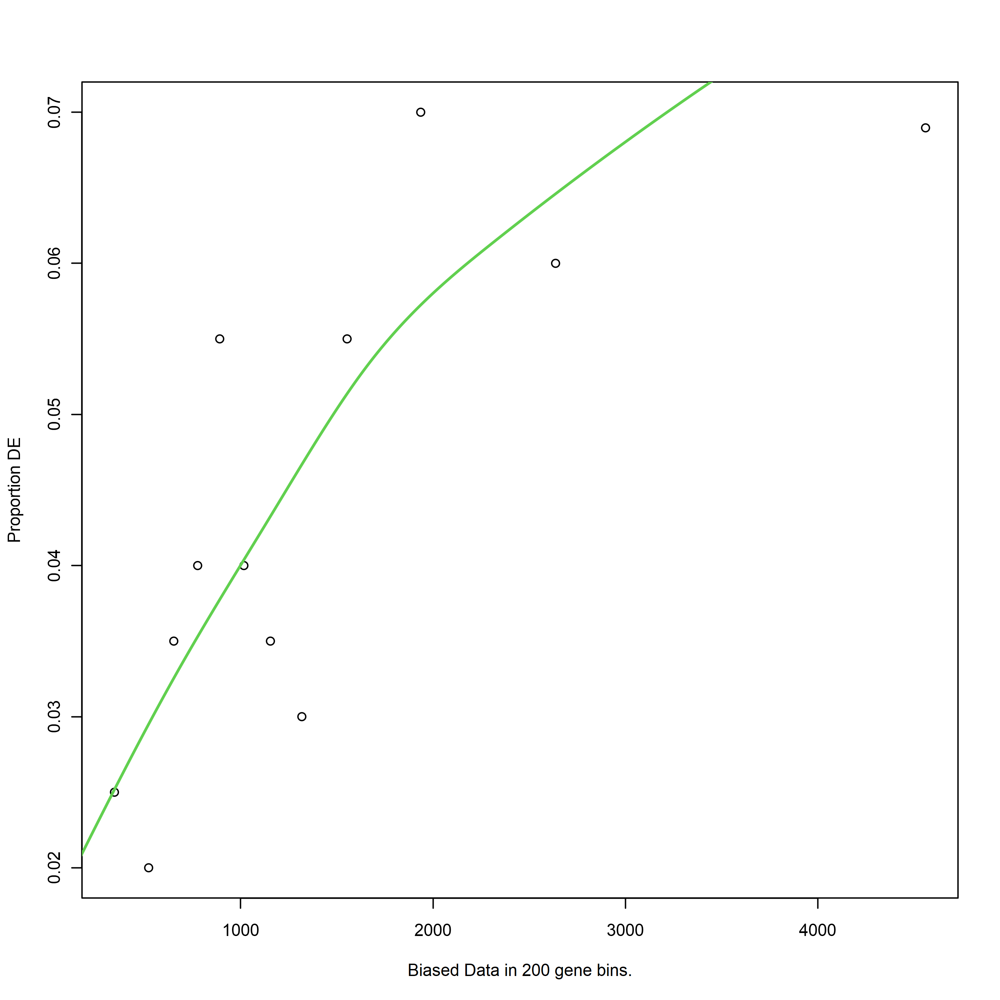

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC3_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


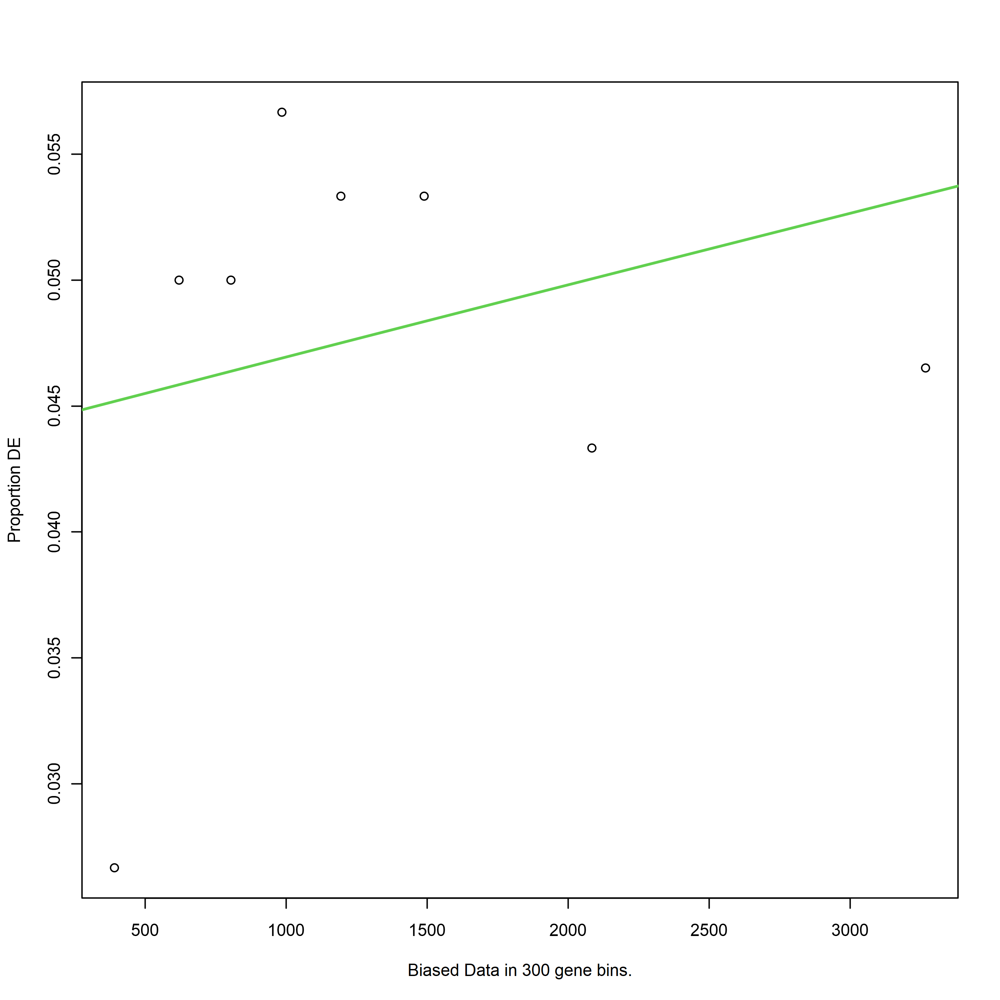

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC3_prot"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


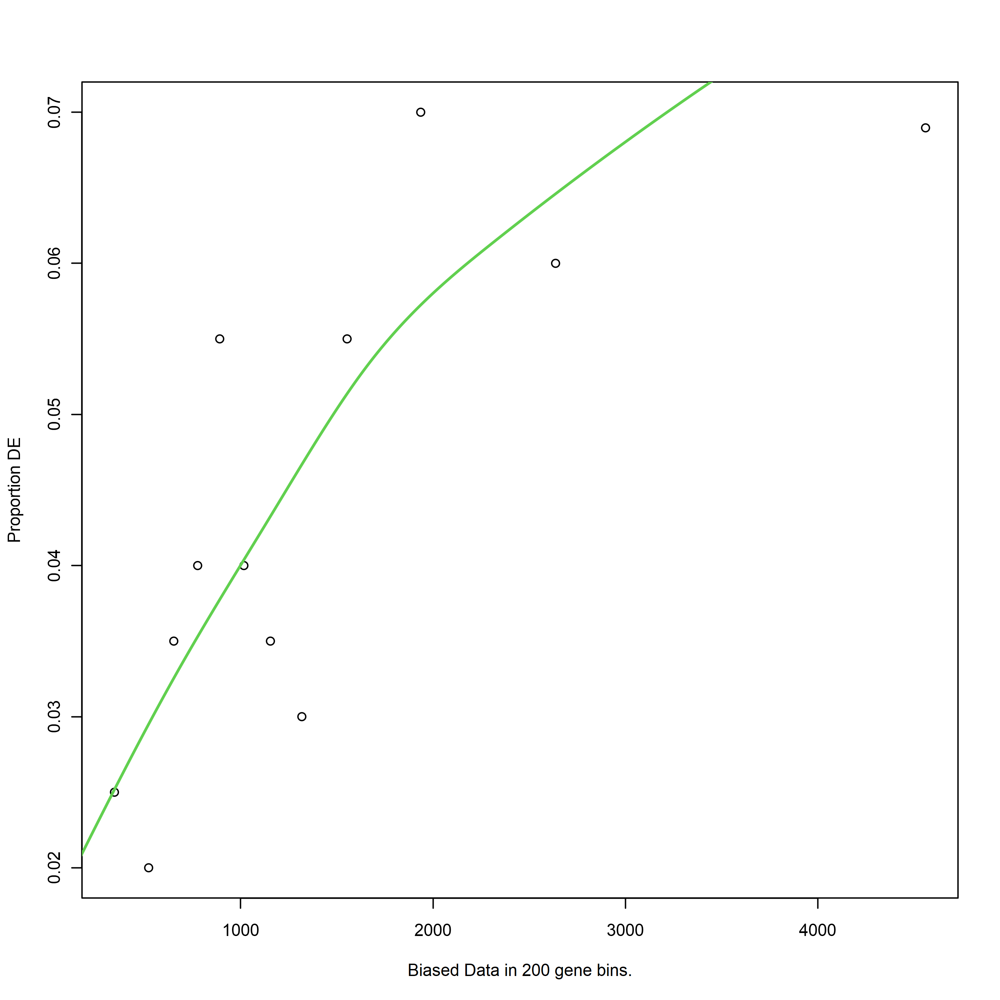

Using manually entered categories.

Calculating the p-values...



[1] "LATEvsC3_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


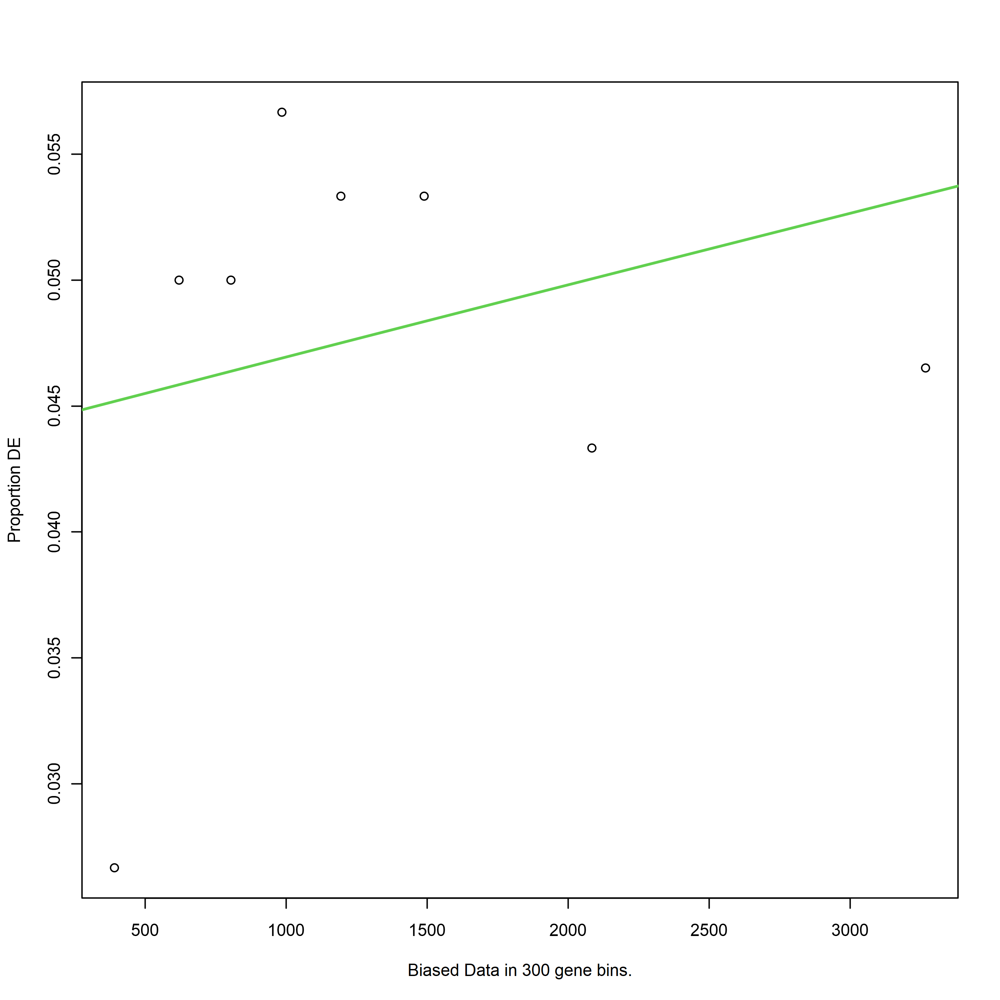

Using manually entered categories.

Calculating the p-values...



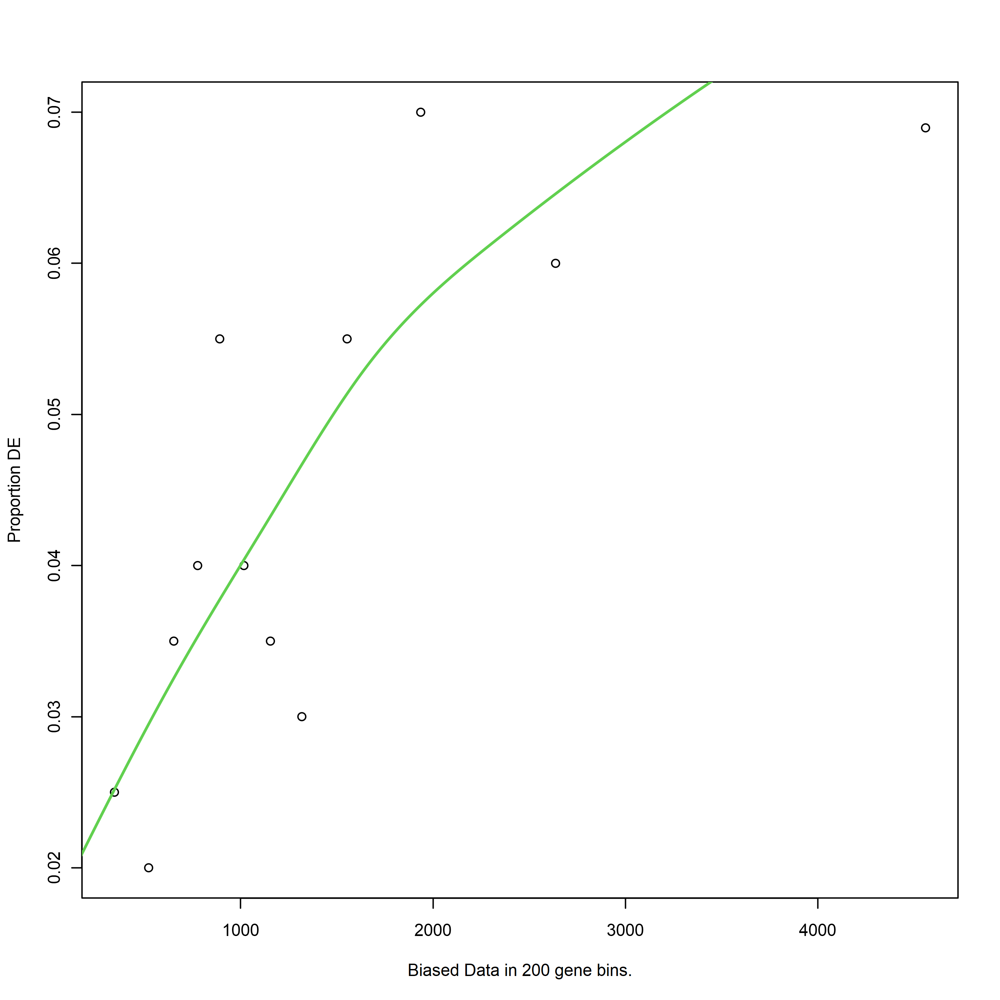

[1] "A2vsA1_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



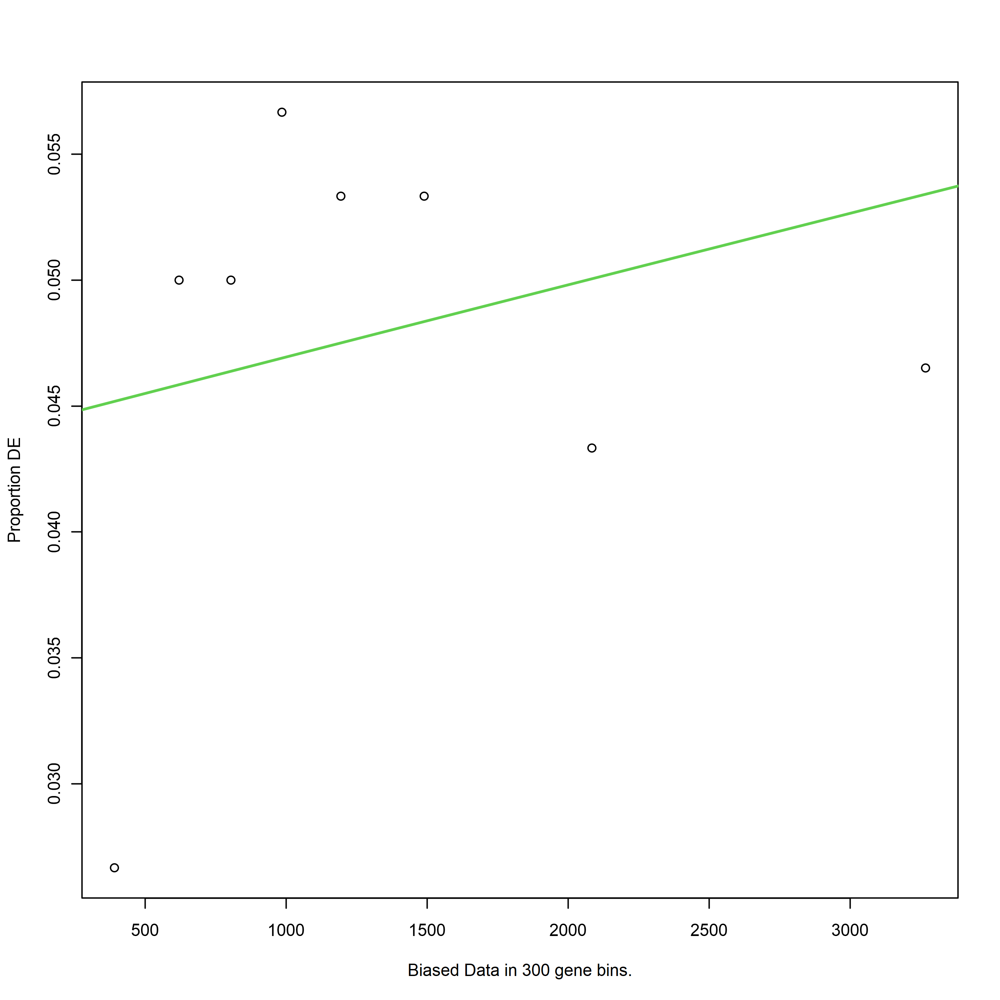

[1] "A2vsA1_prot"
[1] "up"


Using manually entered categories.

Calculating the p-values...



[1] "A2vsA1_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



[1] "A2vsA1_prot"
[1] "up"


Using manually entered categories.

Calculating the p-values...



[1] "A2vsA1_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



[1] "A2vsA1_prot"
[1] "up"


Using manually entered categories.

Calculating the p-values...



[1] "A2vsA1_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



[1] "A2vsA1_prot"
[1] "up"


Using manually entered categories.

Calculating the p-values...



[1] "A3vsA1_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



[1] "A3vsA1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


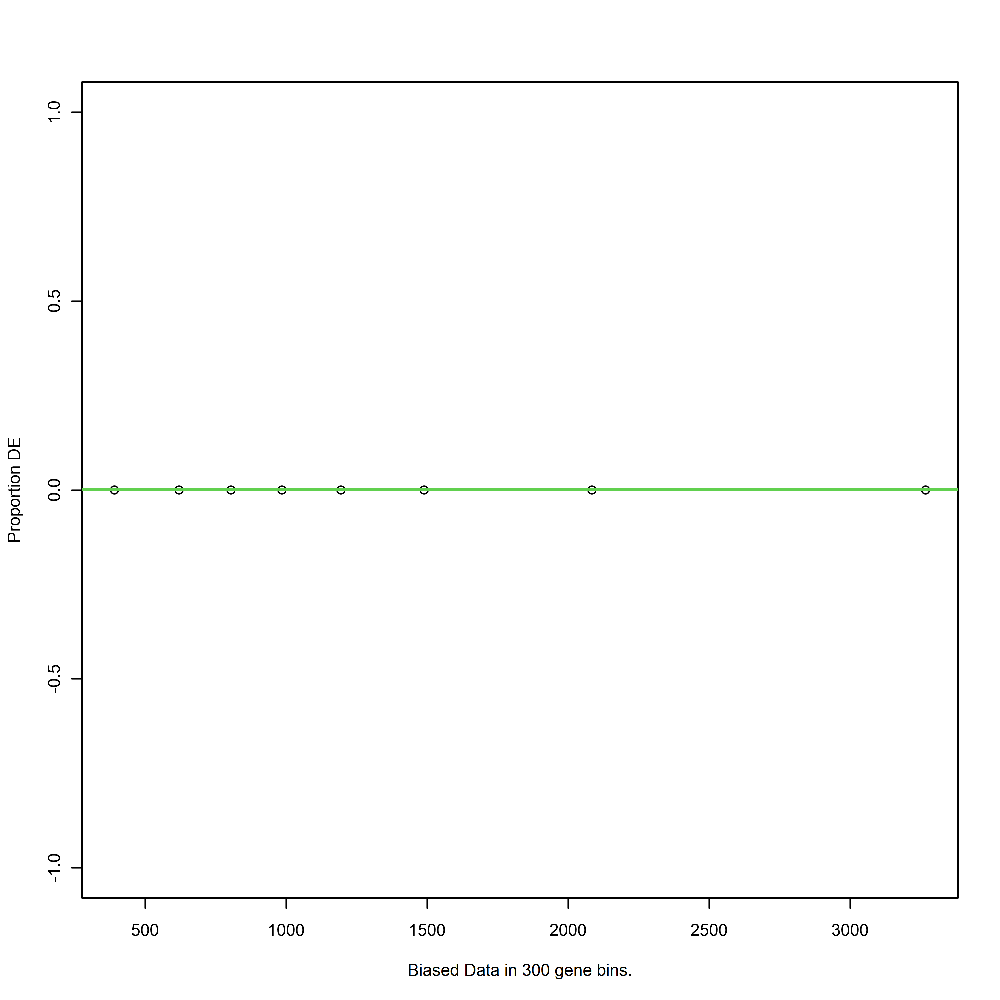

Using manually entered categories.

Calculating the p-values...



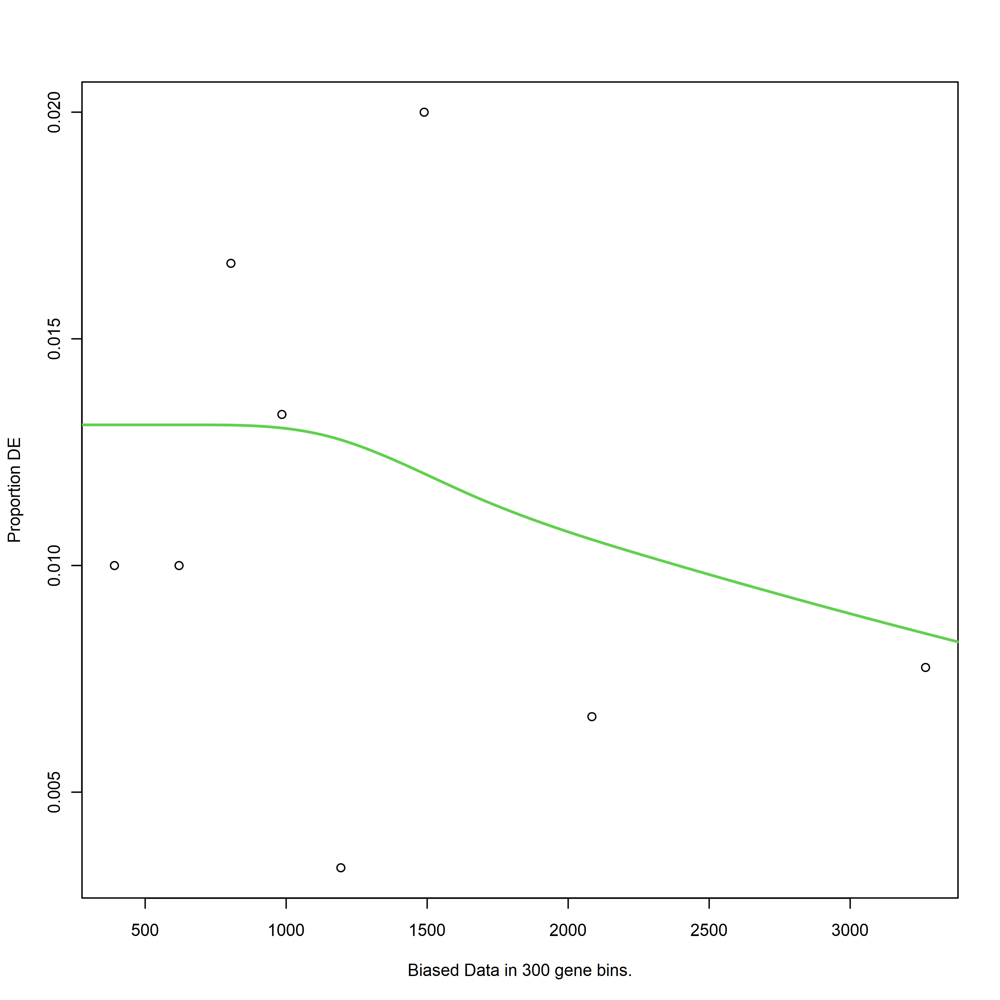

[1] "A3vsA1_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



[1] "A3vsA1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


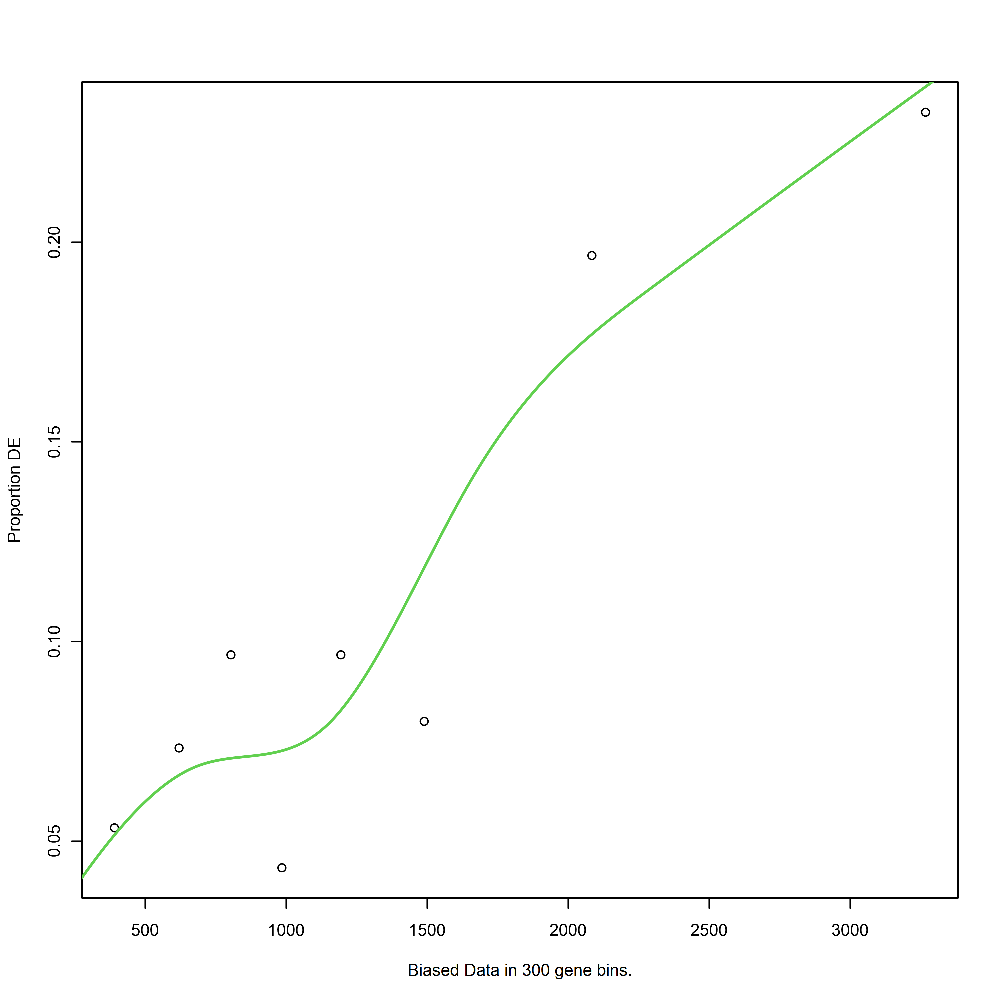

Using manually entered categories.

Calculating the p-values...



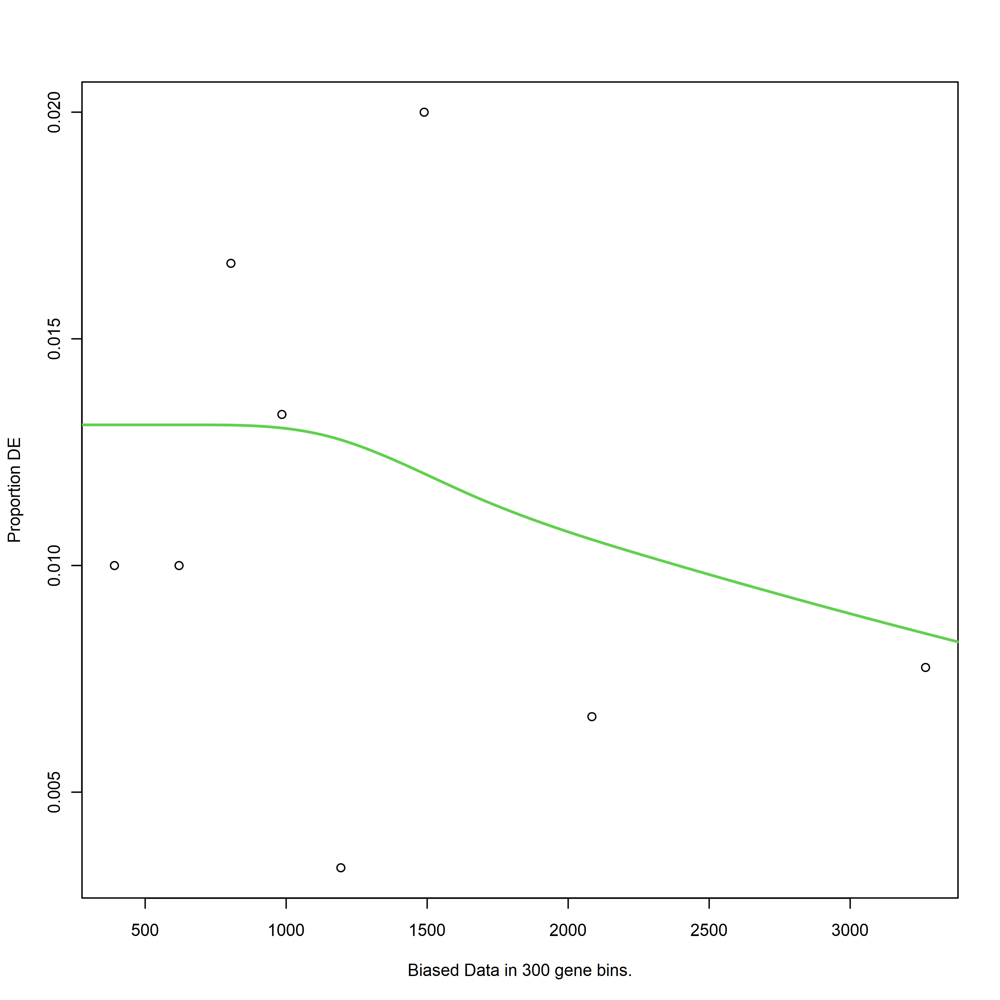

[1] "A3vsA1_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



[1] "A3vsA1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


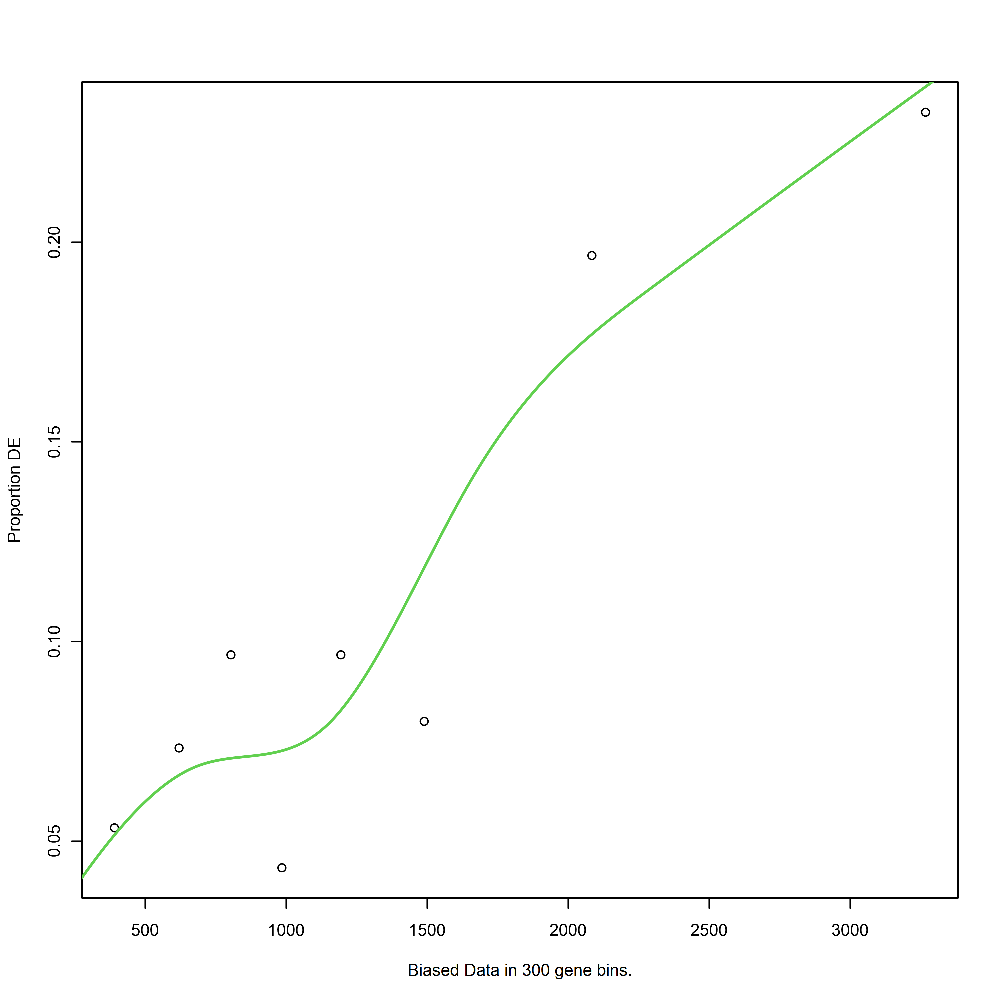

Using manually entered categories.

Calculating the p-values...



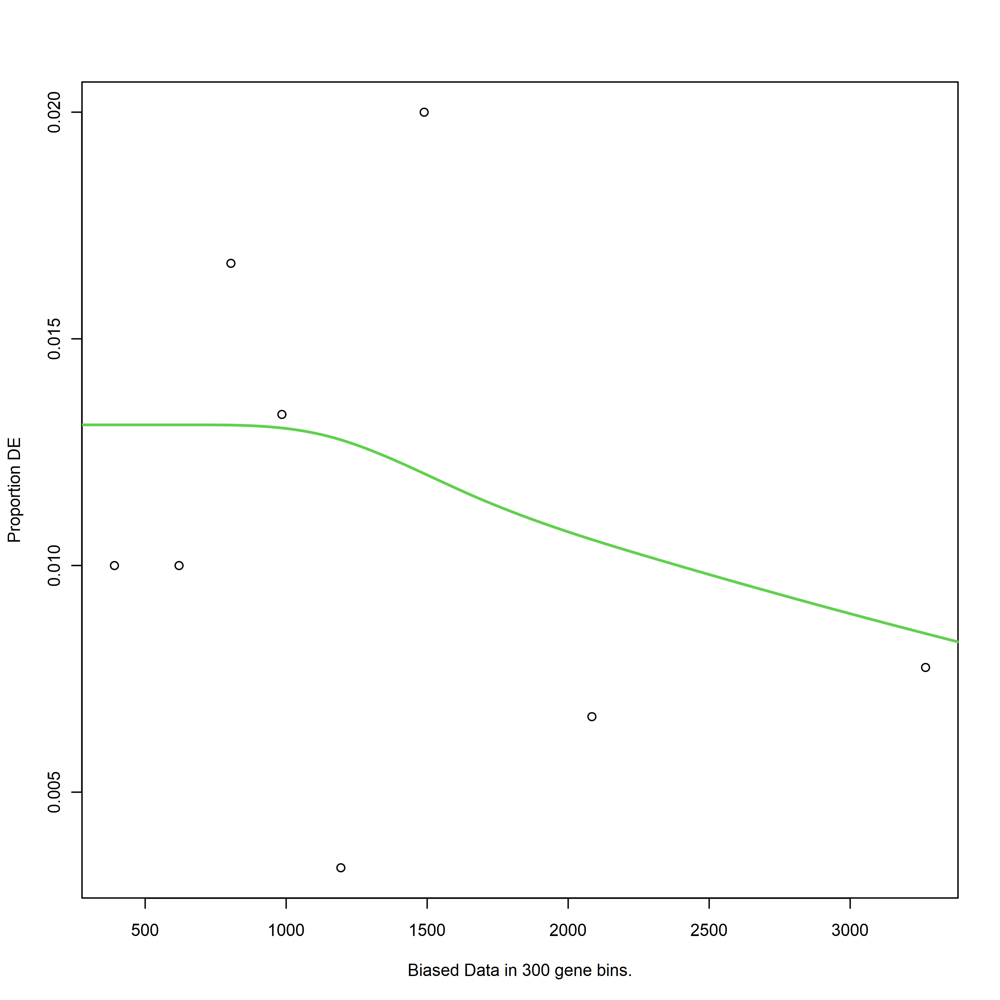

[1] "A3vsA1_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



[1] "A3vsA1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


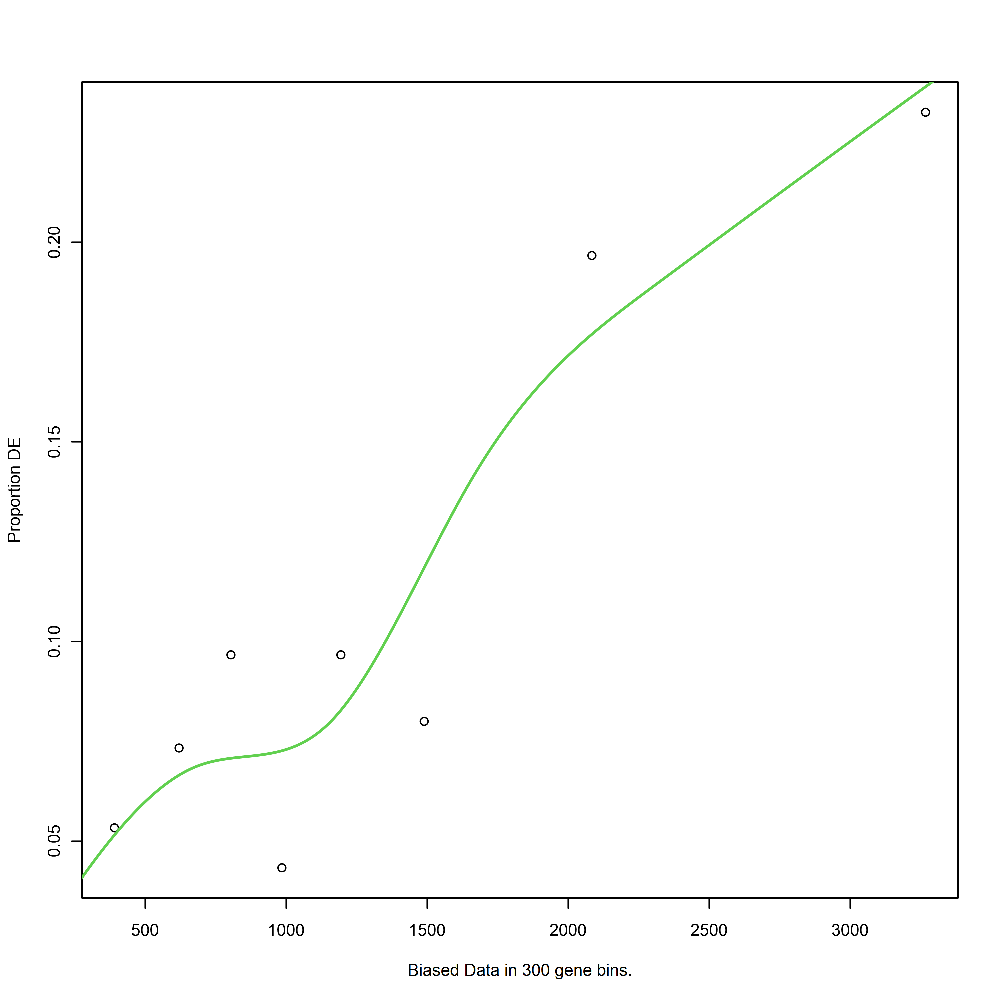

Using manually entered categories.

Calculating the p-values...



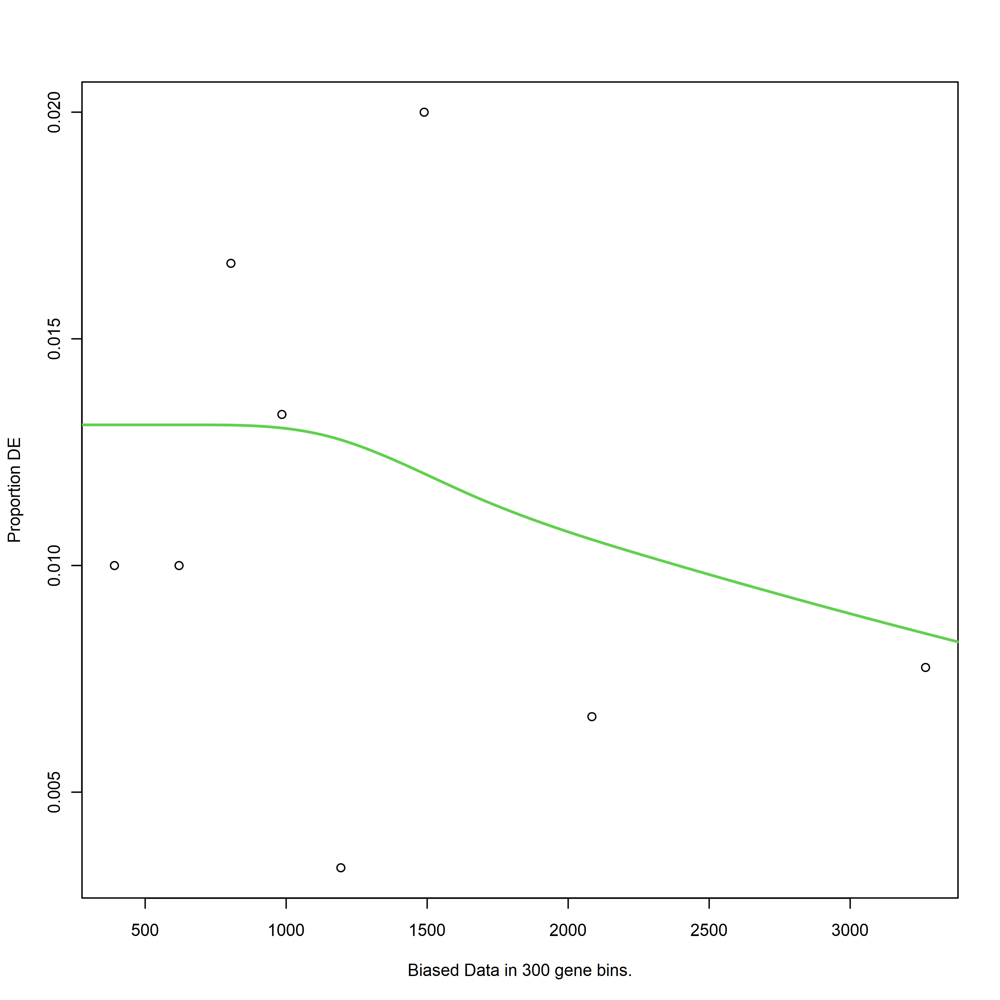

[1] "A5vsA1_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



[1] "A5vsA1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


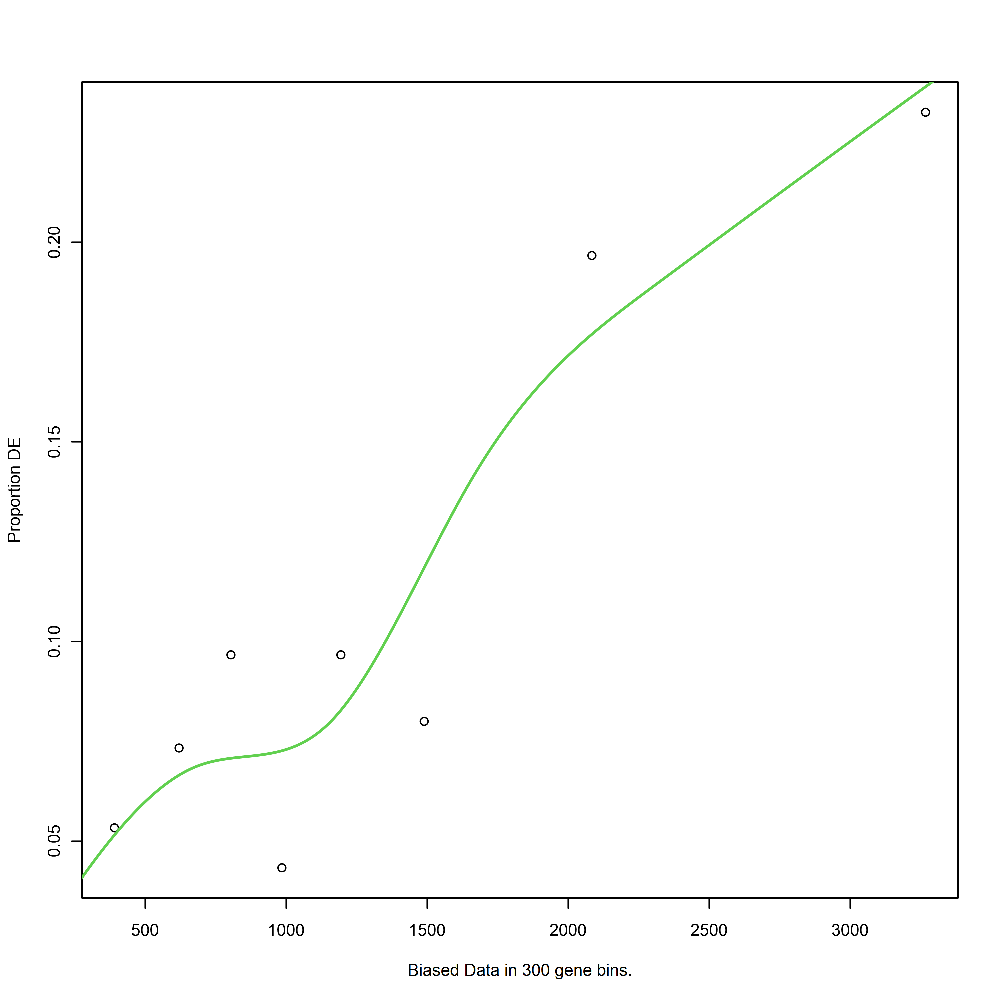

Using manually entered categories.

Calculating the p-values...



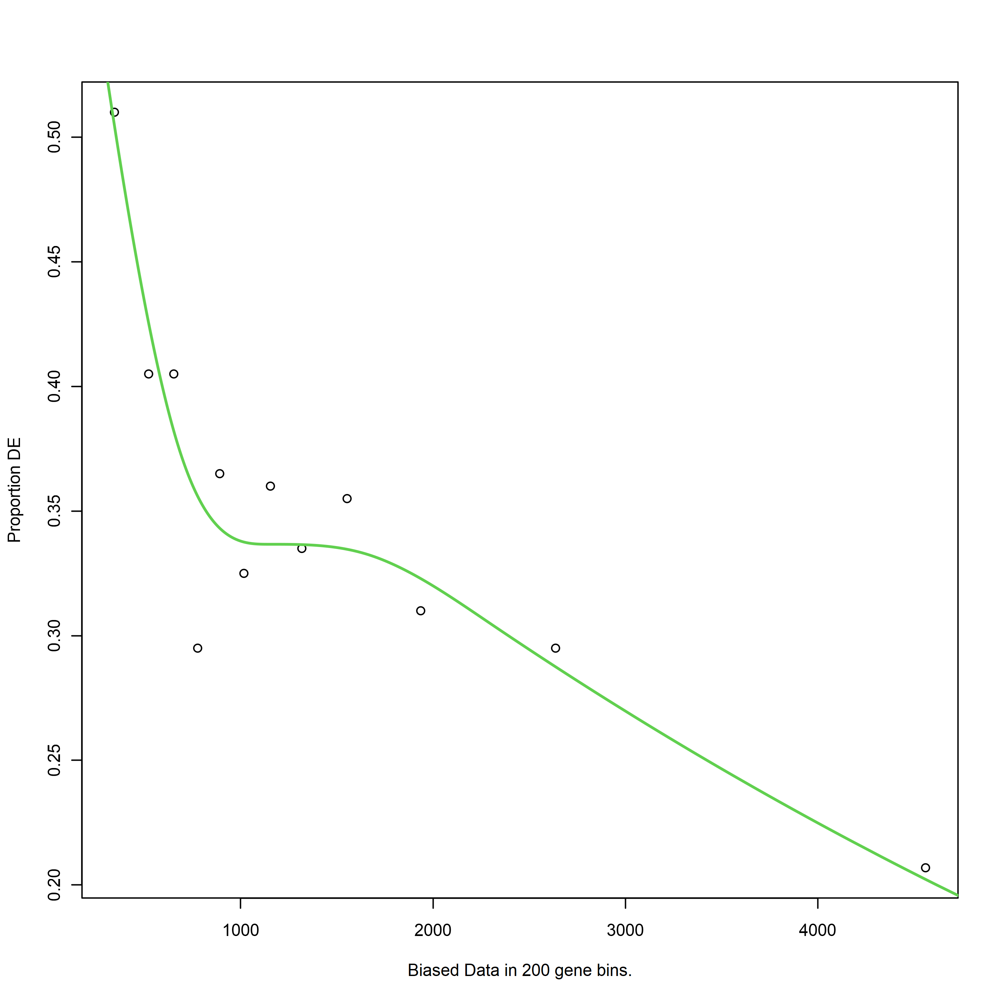

[1] "A5vsA1_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



[1] "A5vsA1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


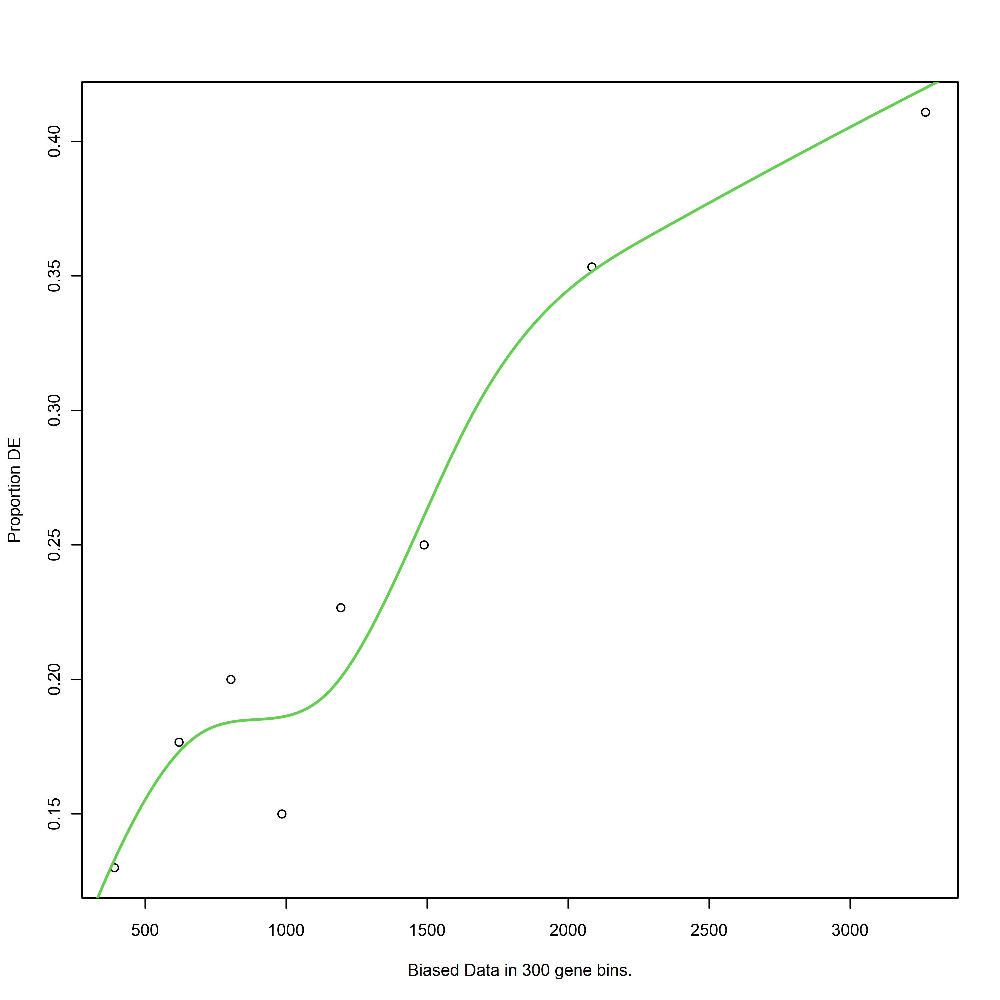

Using manually entered categories.

Calculating the p-values...



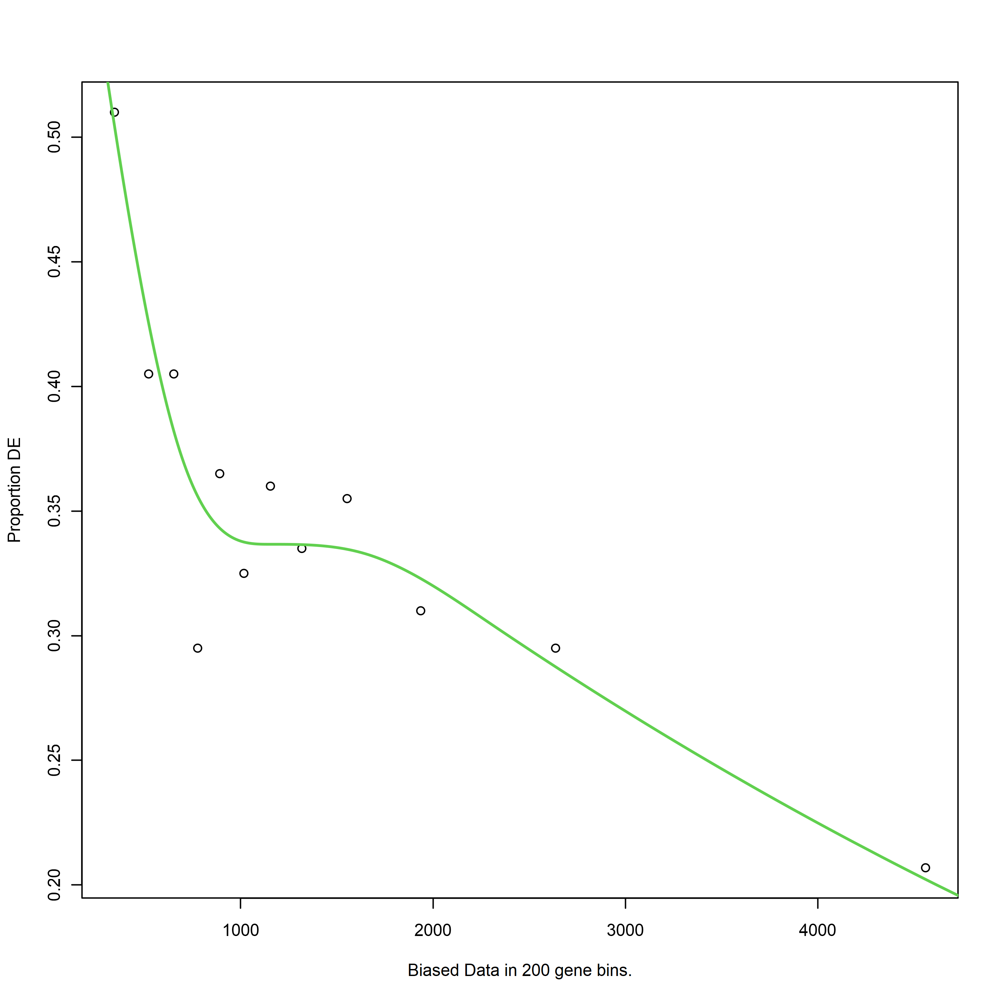

[1] "A5vsA1_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



[1] "A5vsA1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


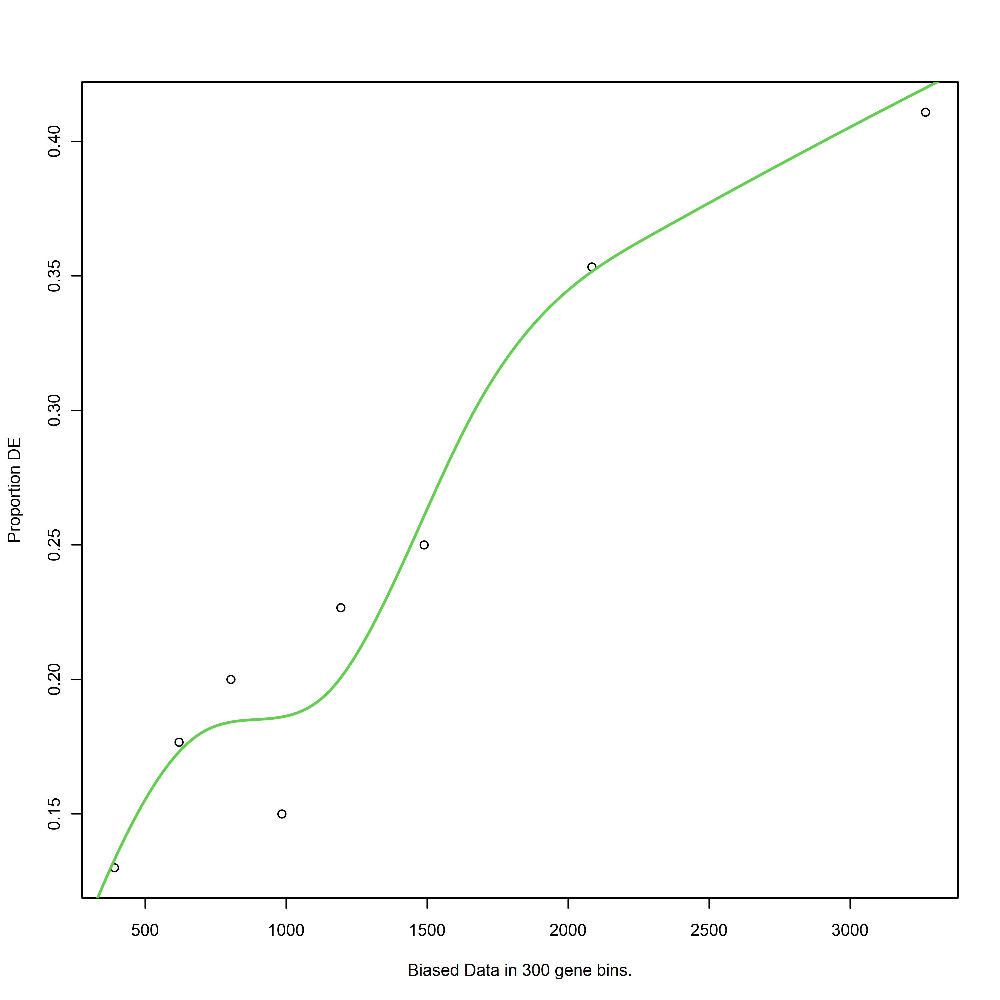

Using manually entered categories.

Calculating the p-values...



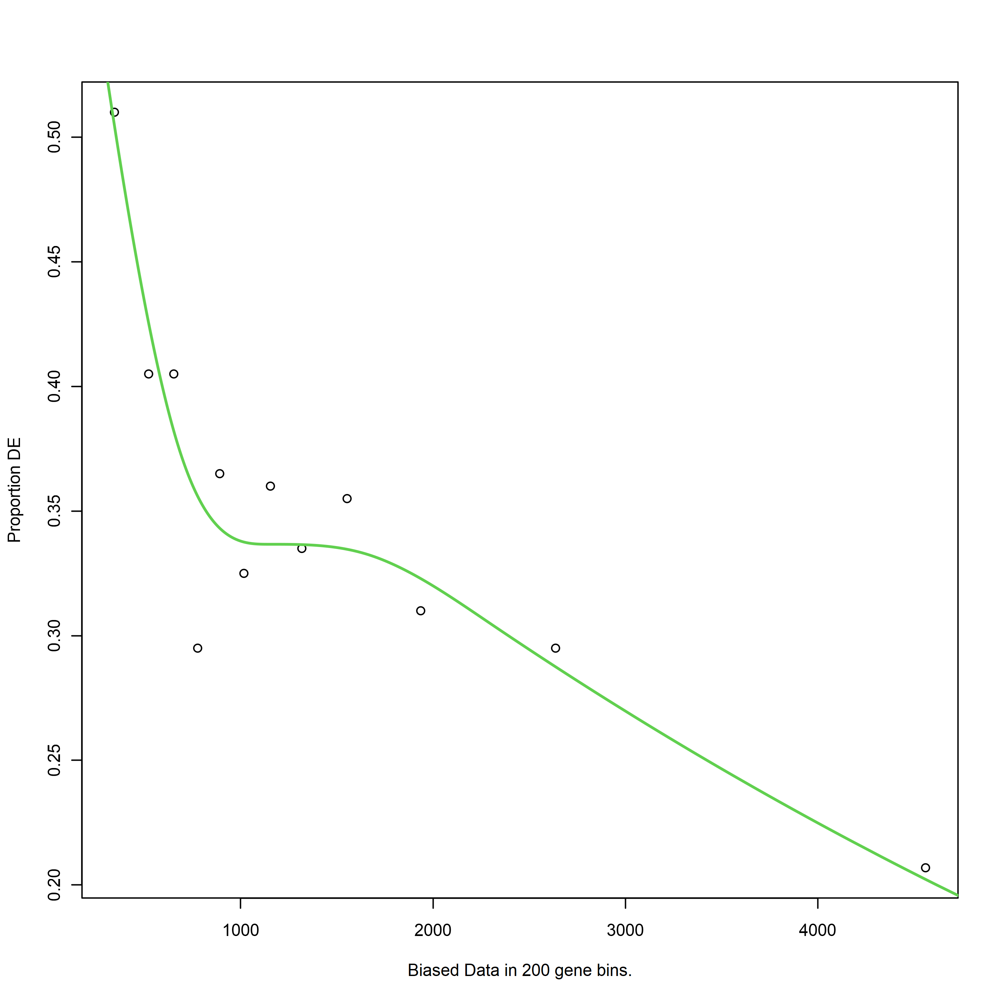

[1] "A5vsA1_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



[1] "A5vsA1_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


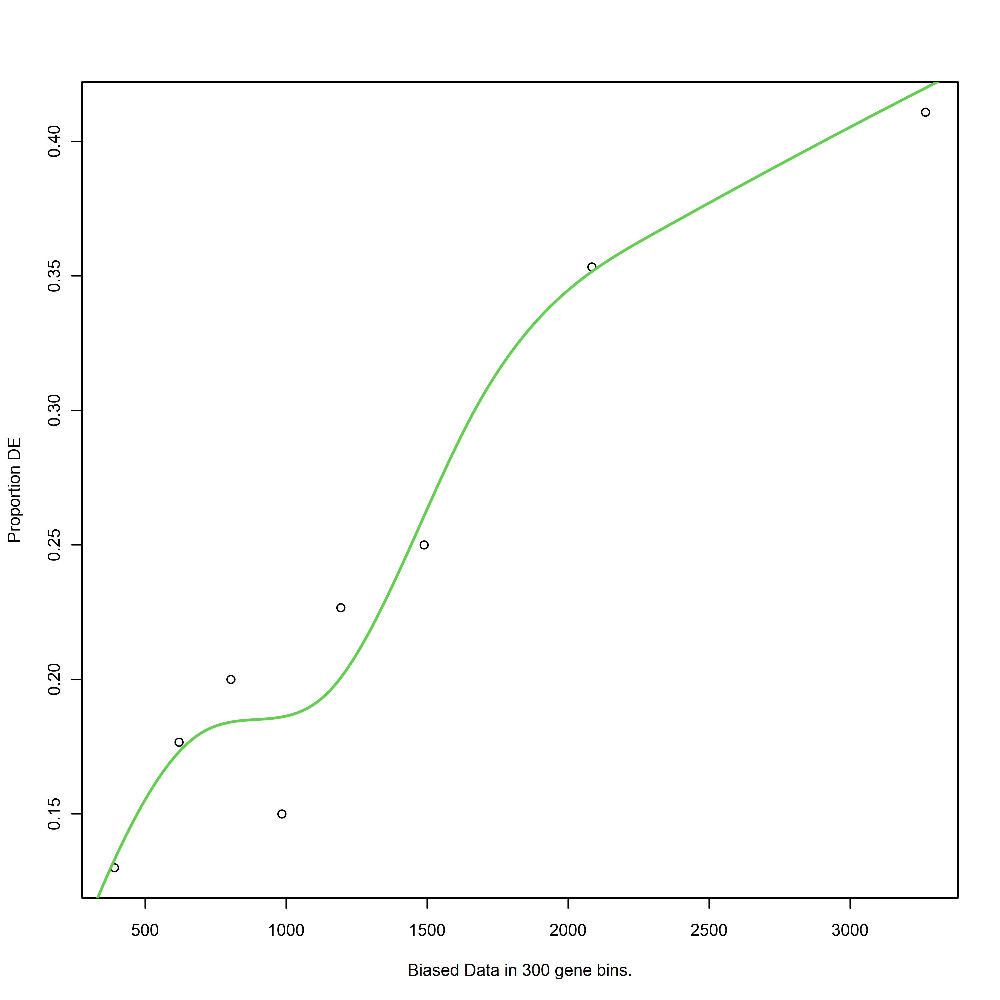

Using manually entered categories.

Calculating the p-values...



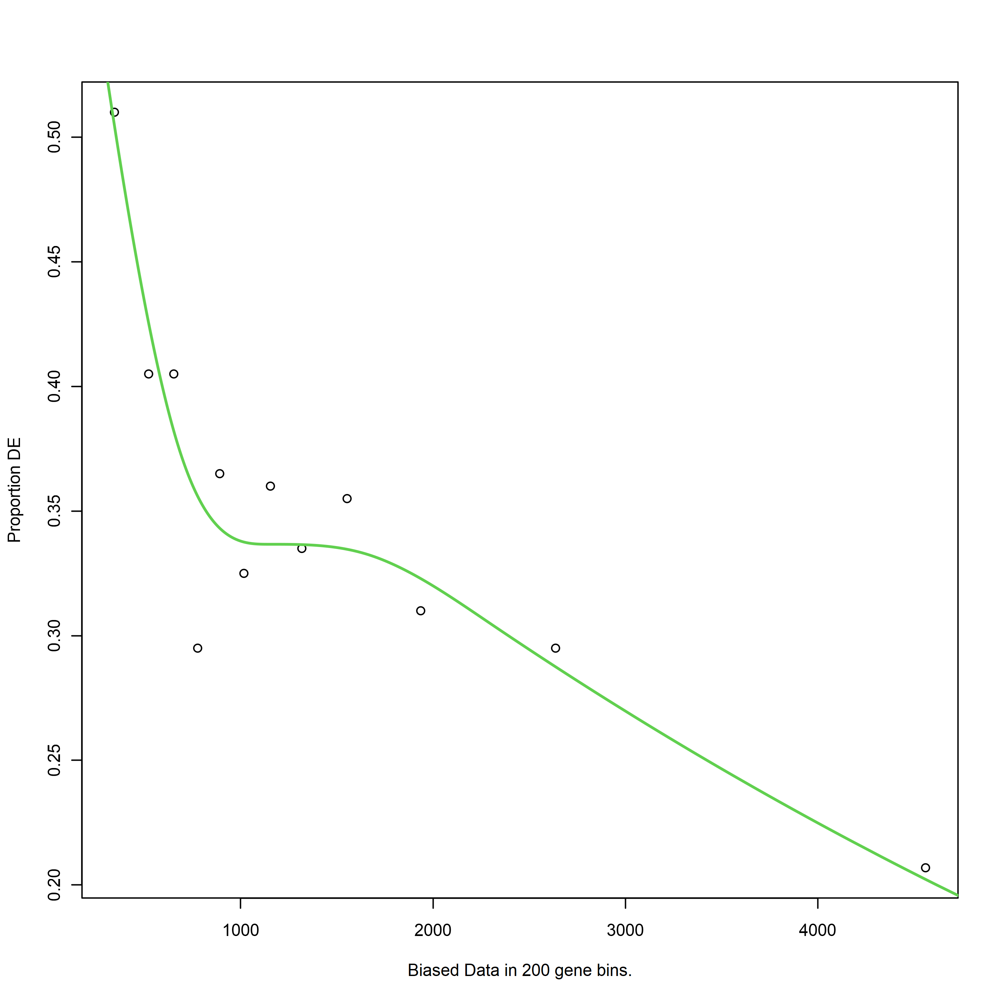

[1] "A3vsA2_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



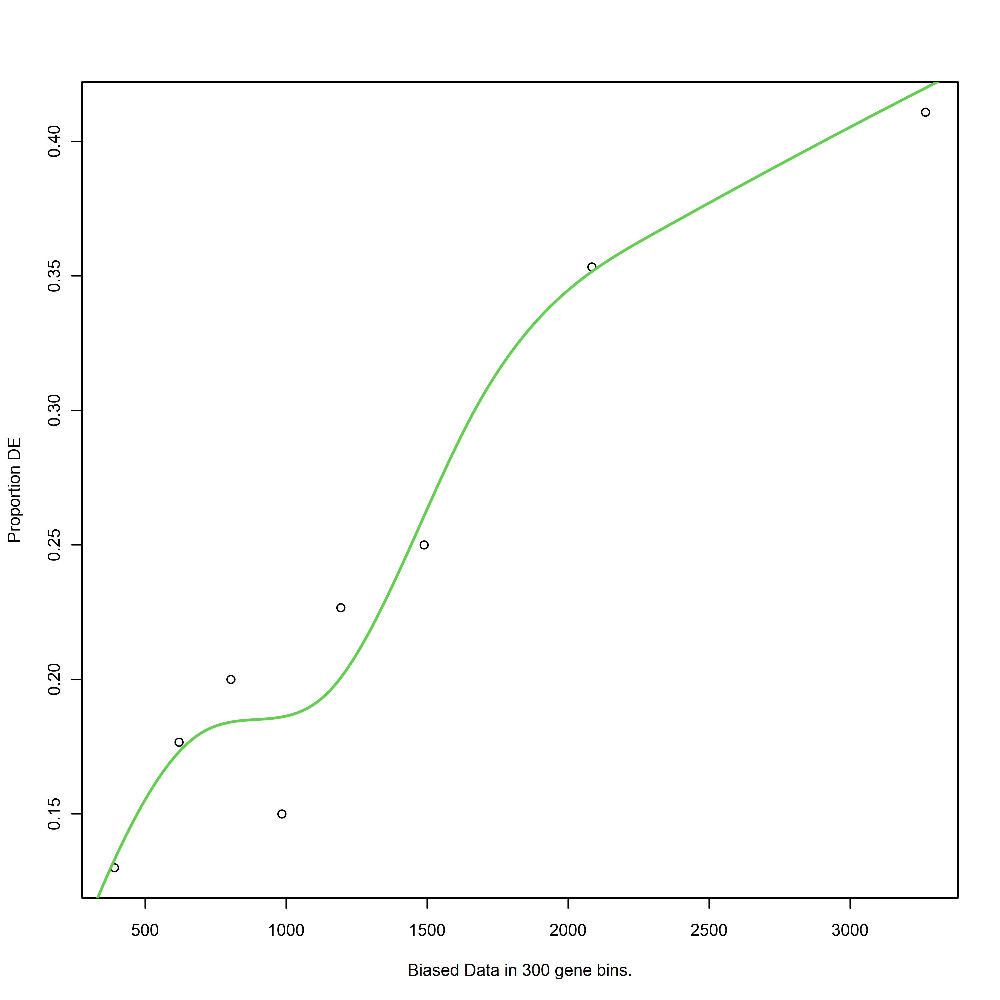

[1] "A3vsA2_prot"
[1] "up"


Using manually entered categories.

Calculating the p-values...



[1] "A3vsA2_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



[1] "A3vsA2_prot"
[1] "up"


Using manually entered categories.

Calculating the p-values...



[1] "A3vsA2_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



[1] "A3vsA2_prot"
[1] "up"


Using manually entered categories.

Calculating the p-values...



[1] "A3vsA2_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



[1] "A3vsA2_prot"
[1] "up"


Using manually entered categories.

Calculating the p-values...



[1] "A5vsA3_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



[1] "A5vsA3_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


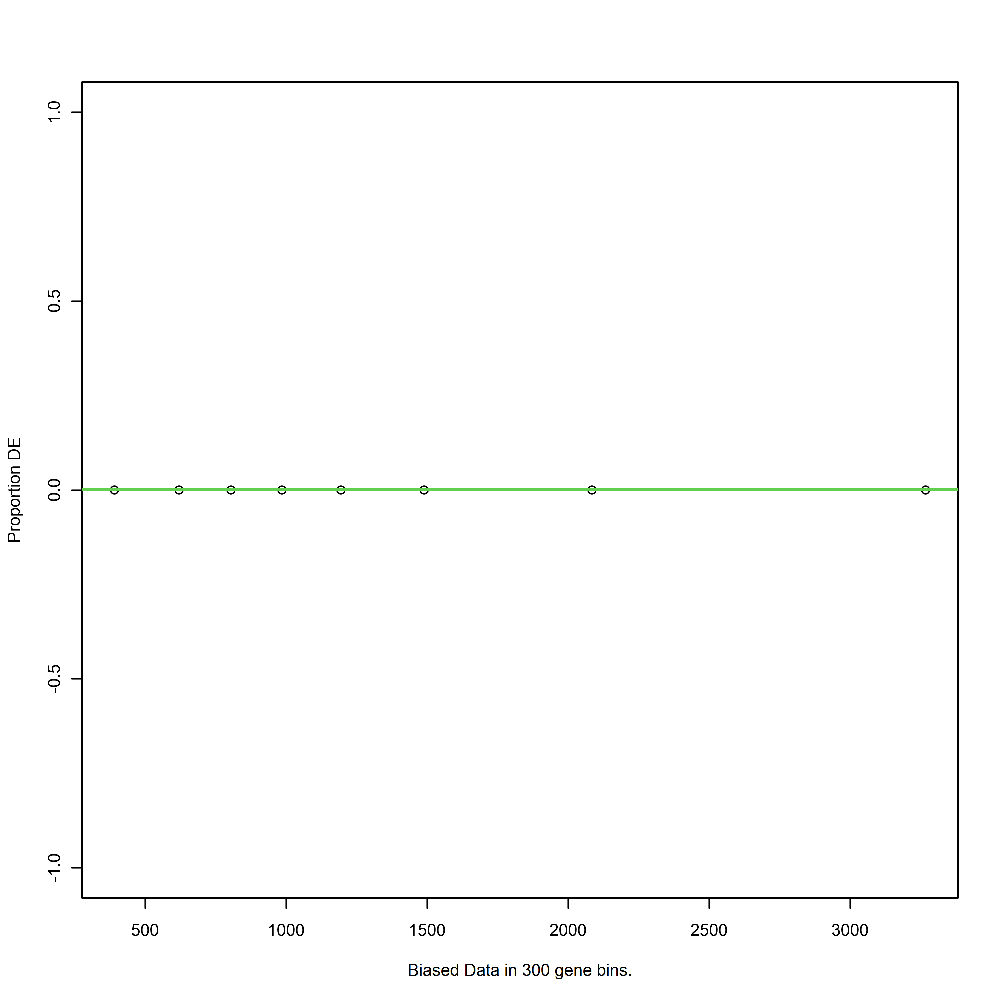

Using manually entered categories.

Calculating the p-values...



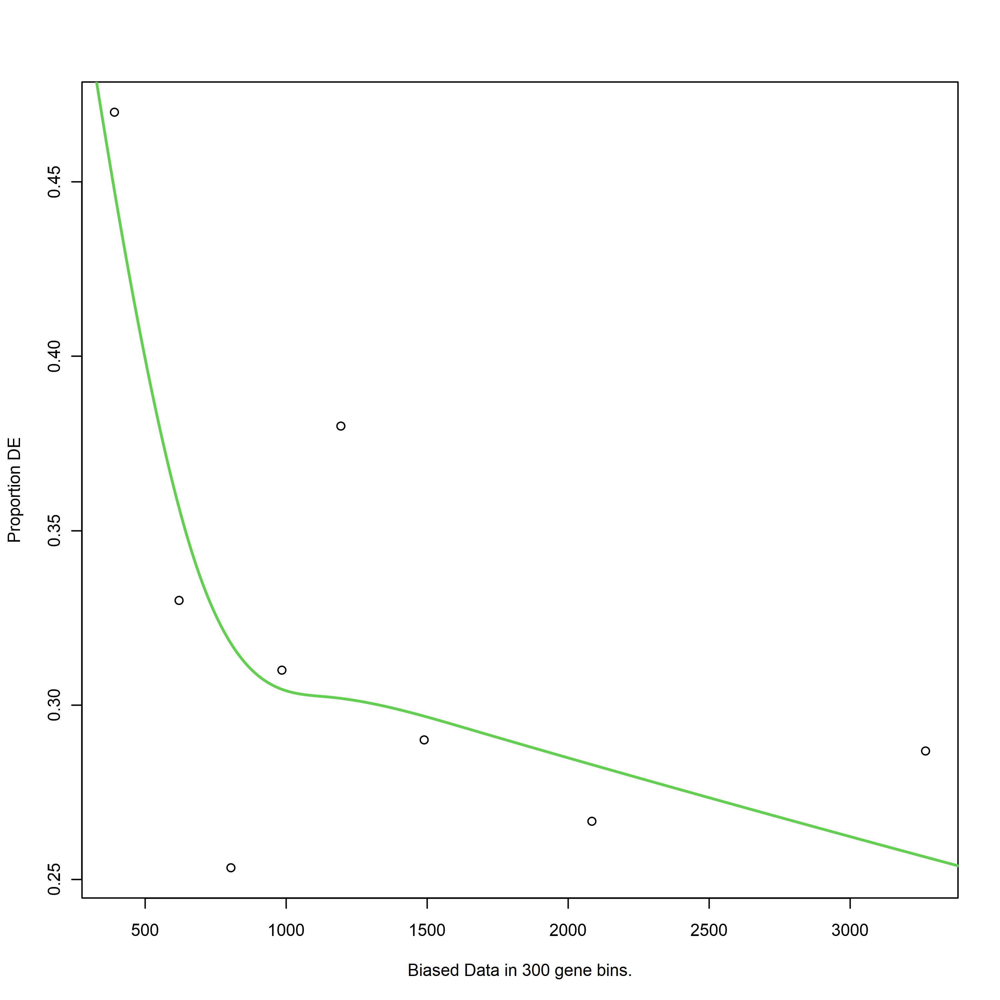

[1] "A5vsA3_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



[1] "A5vsA3_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


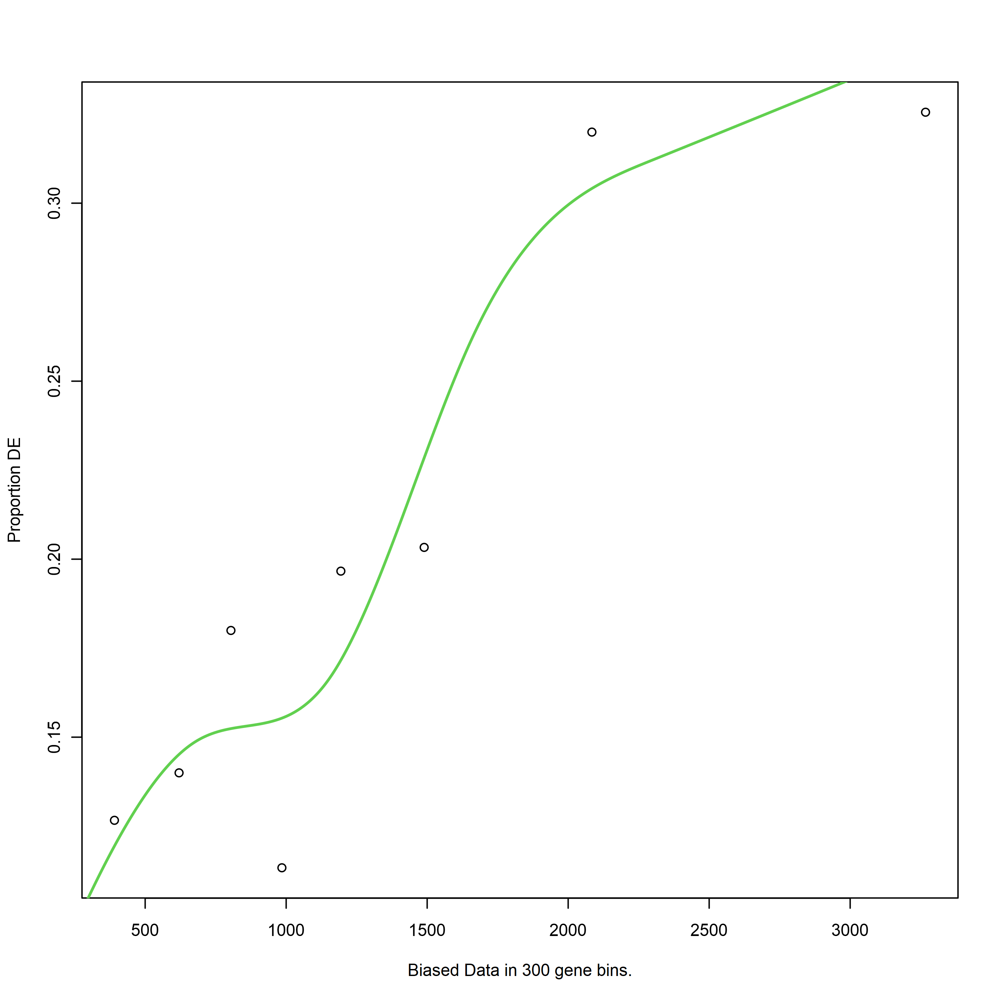

Using manually entered categories.

Calculating the p-values...



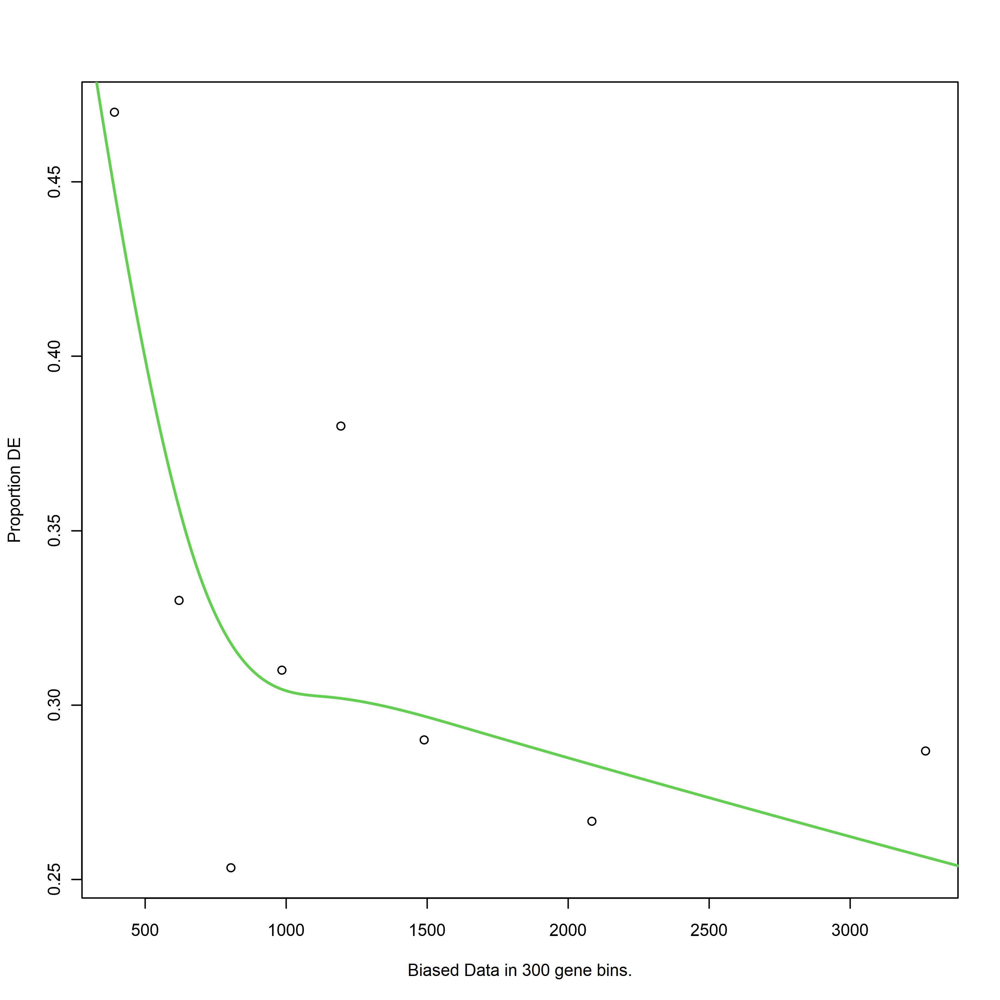

[1] "A5vsA3_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



[1] "A5vsA3_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


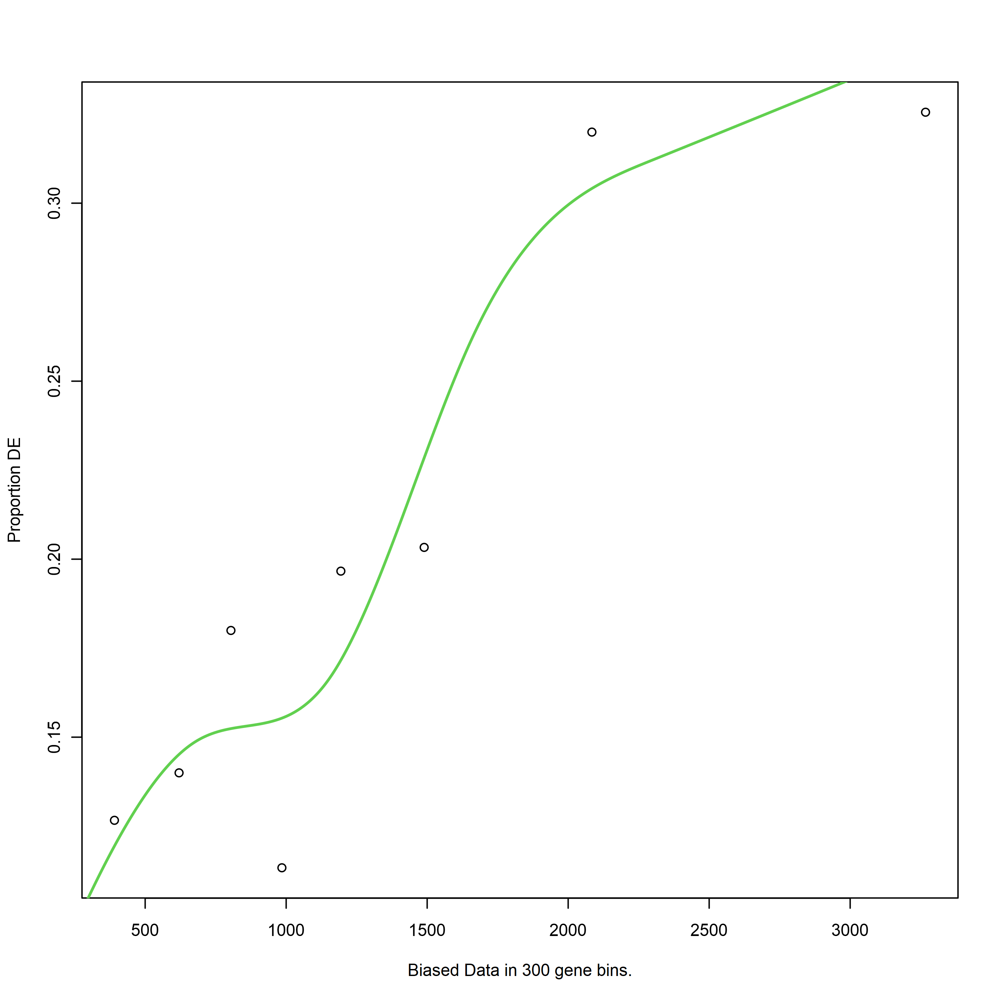

Using manually entered categories.

Calculating the p-values...



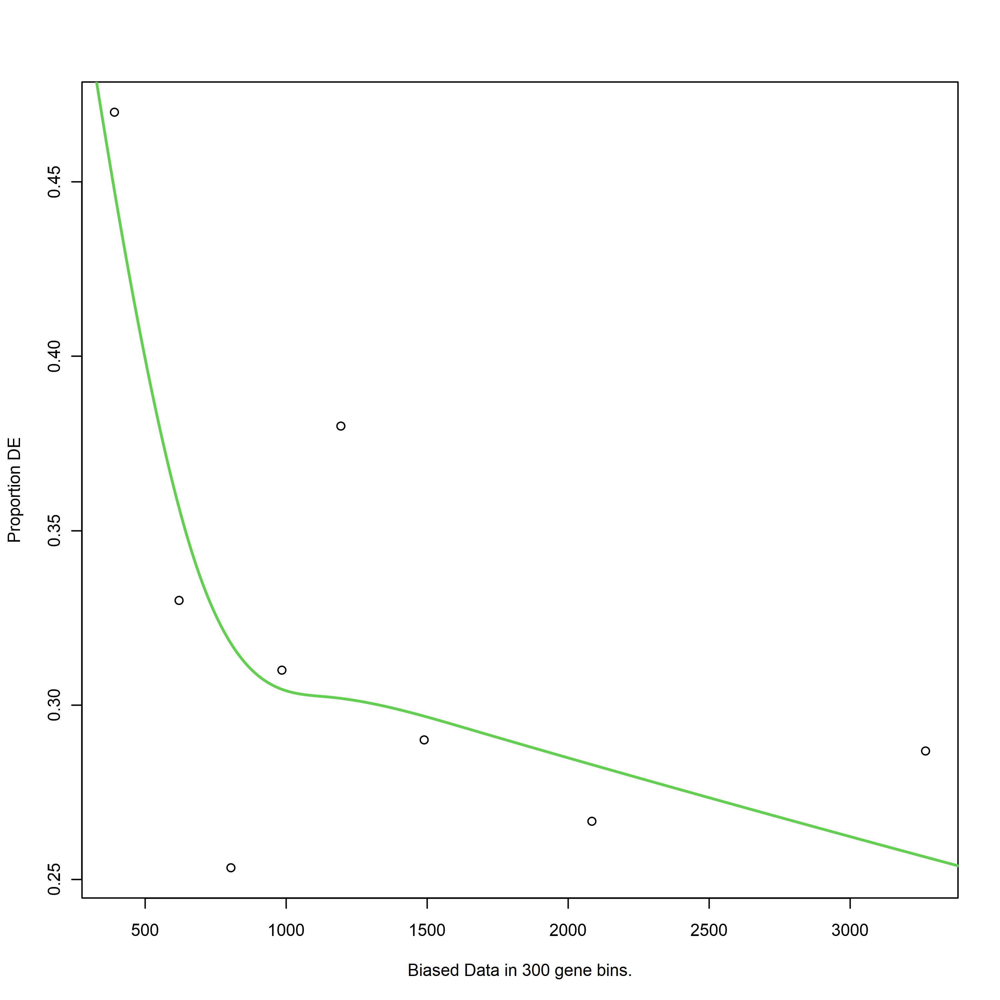

[1] "A5vsA3_prot"
[1] "down"


Using manually entered categories.

Calculating the p-values...



[1] "A5vsA3_prot"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


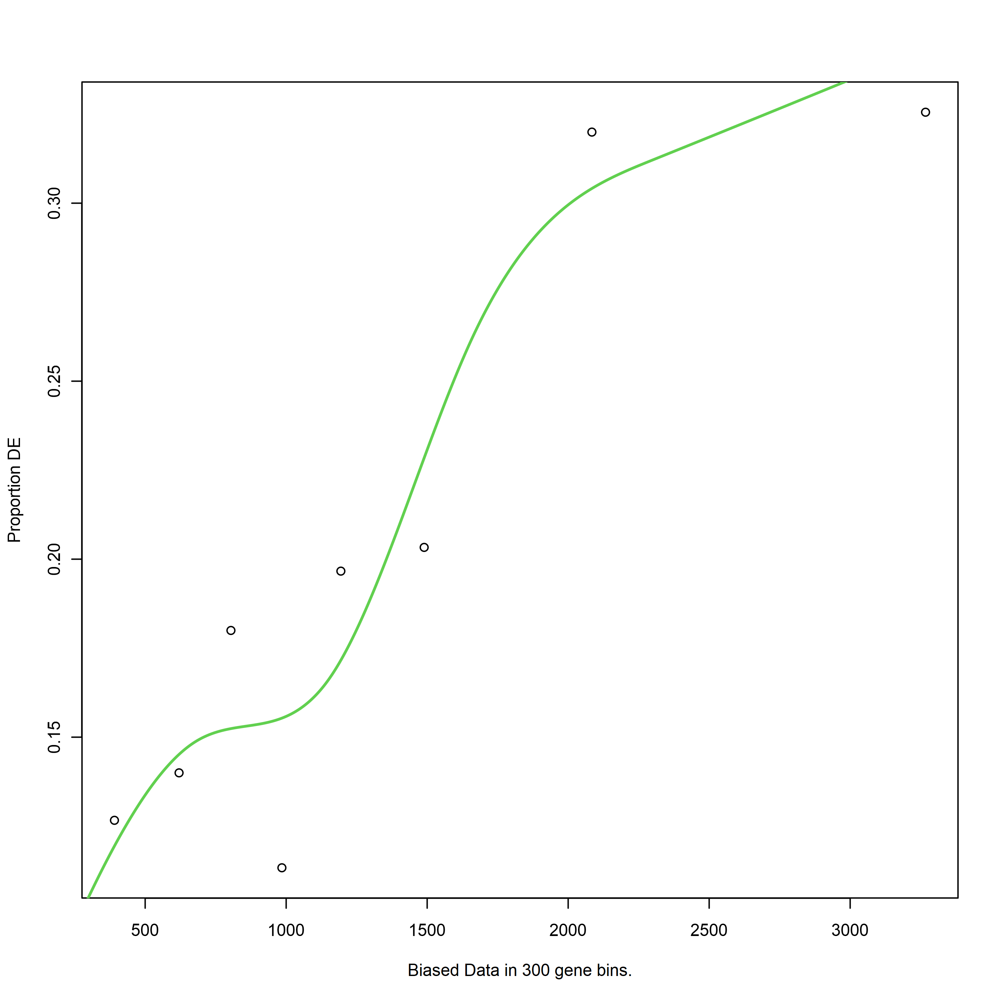

Using manually entered categories.

Calculating the p-values...



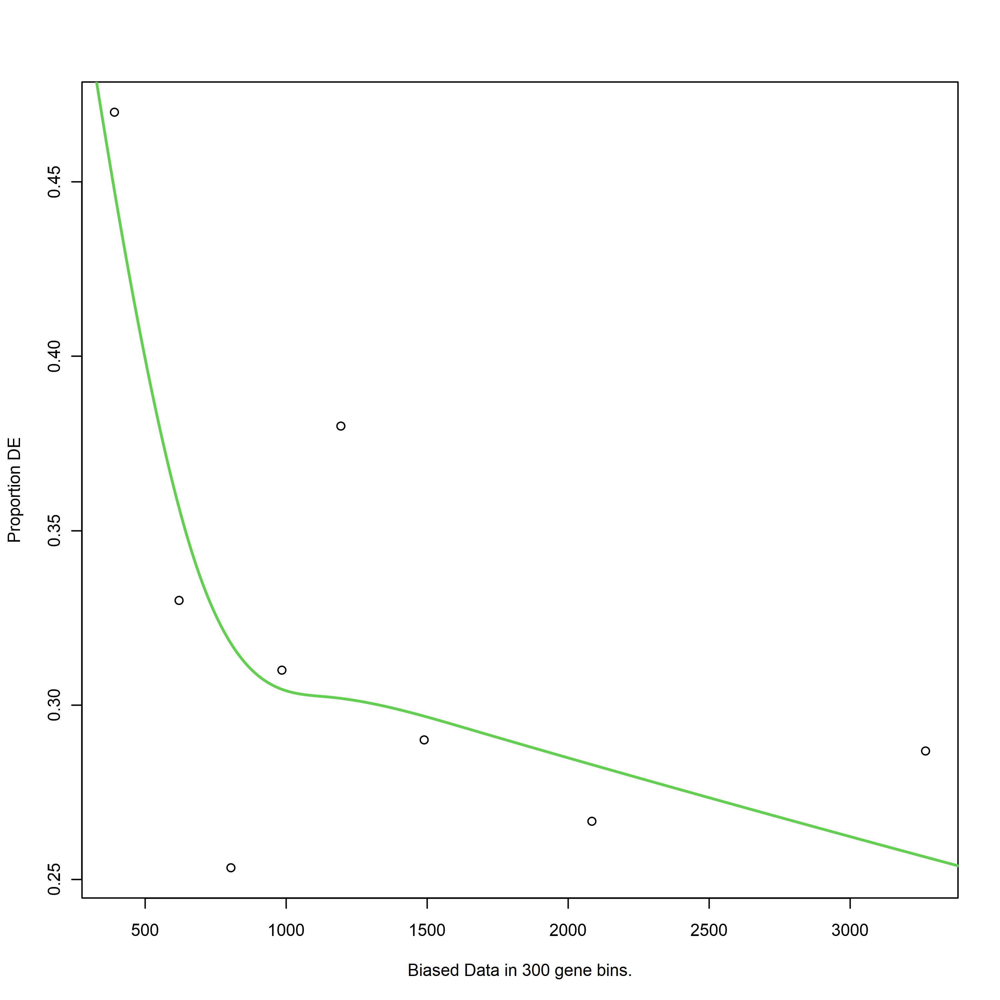

[1] "LATEvsA1_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


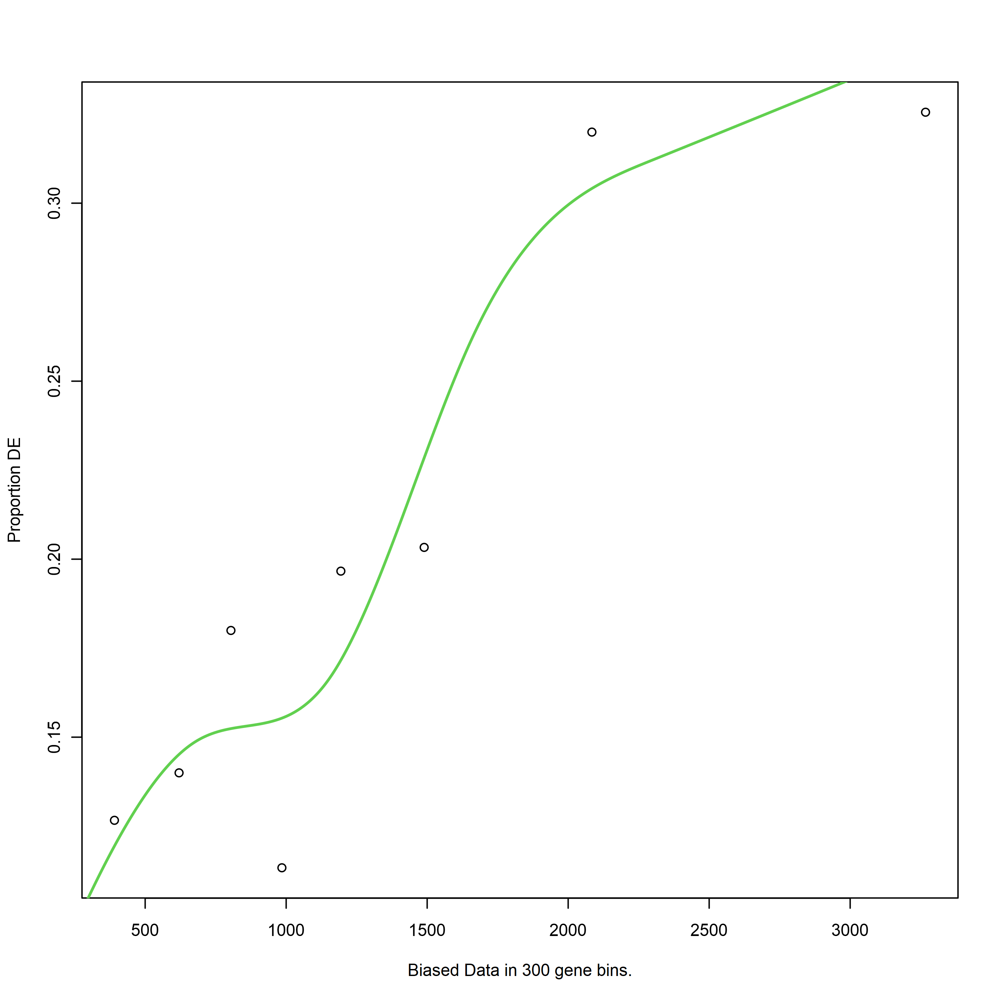

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



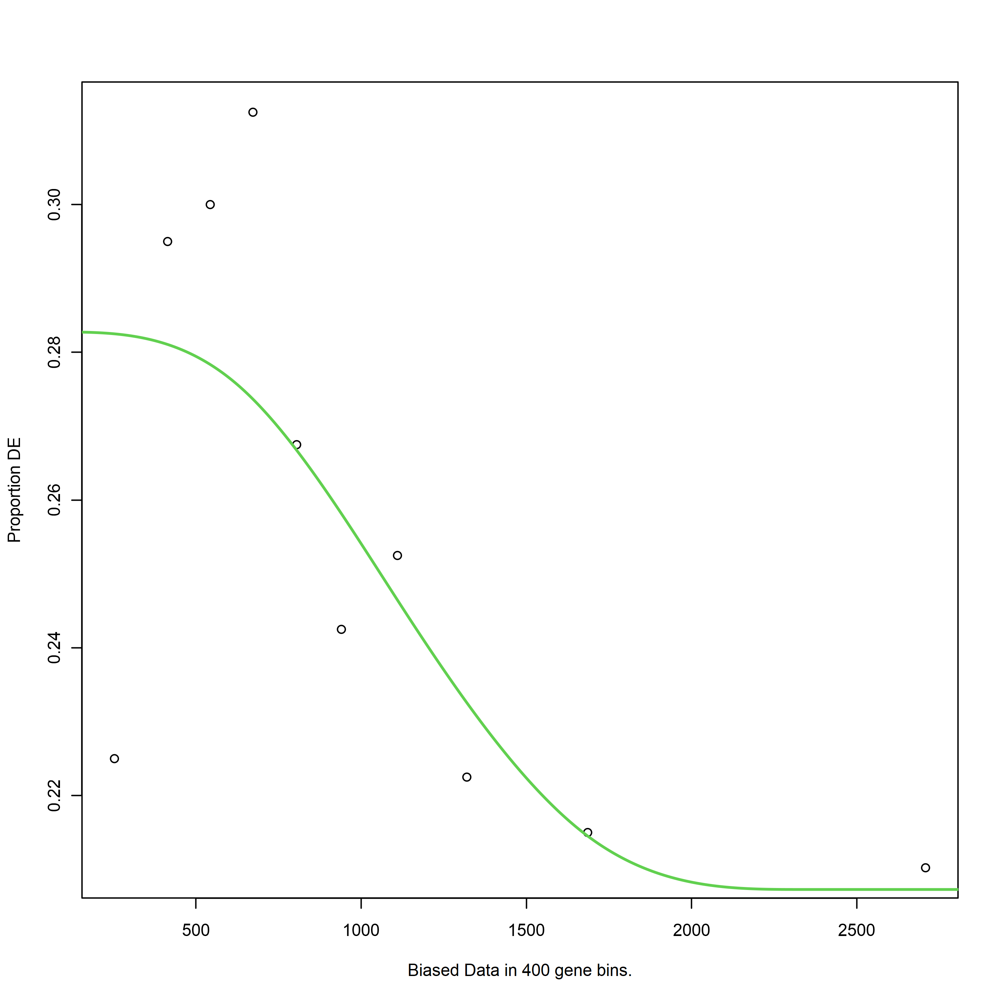

[1] "LATEvsA1_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


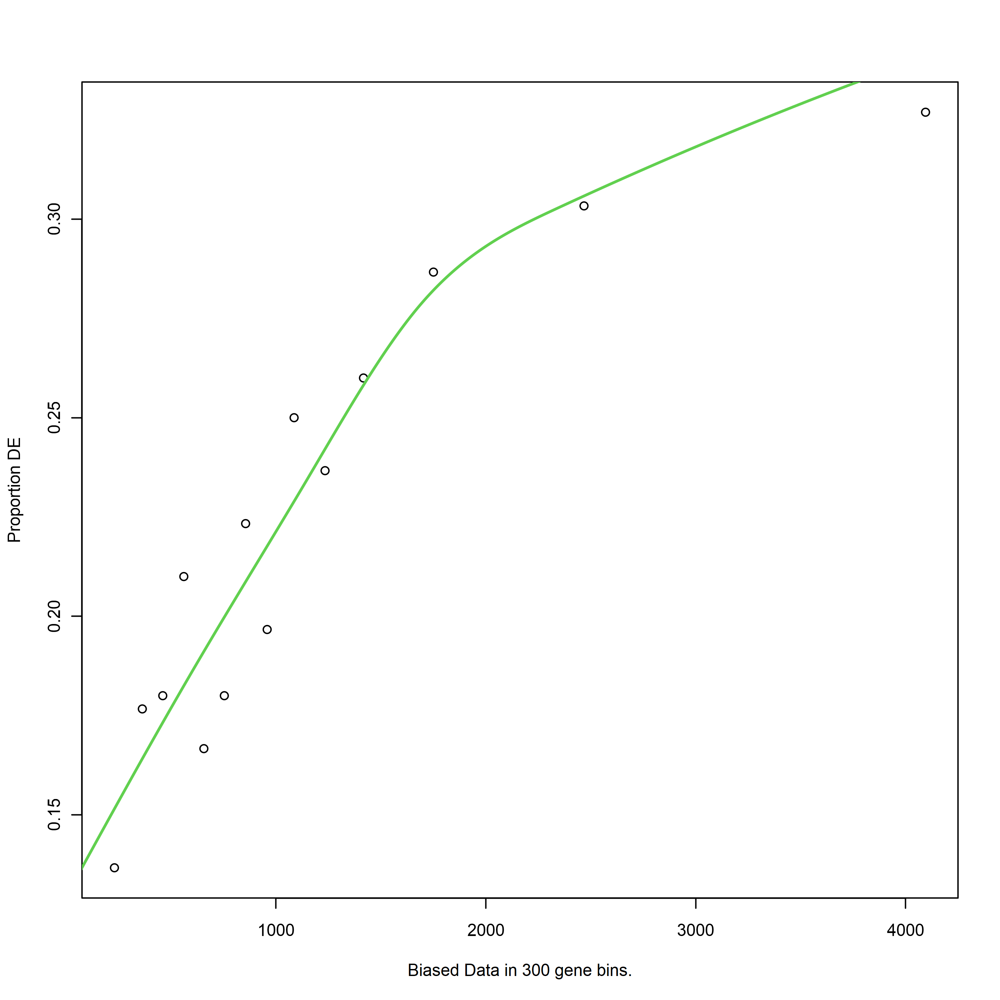

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



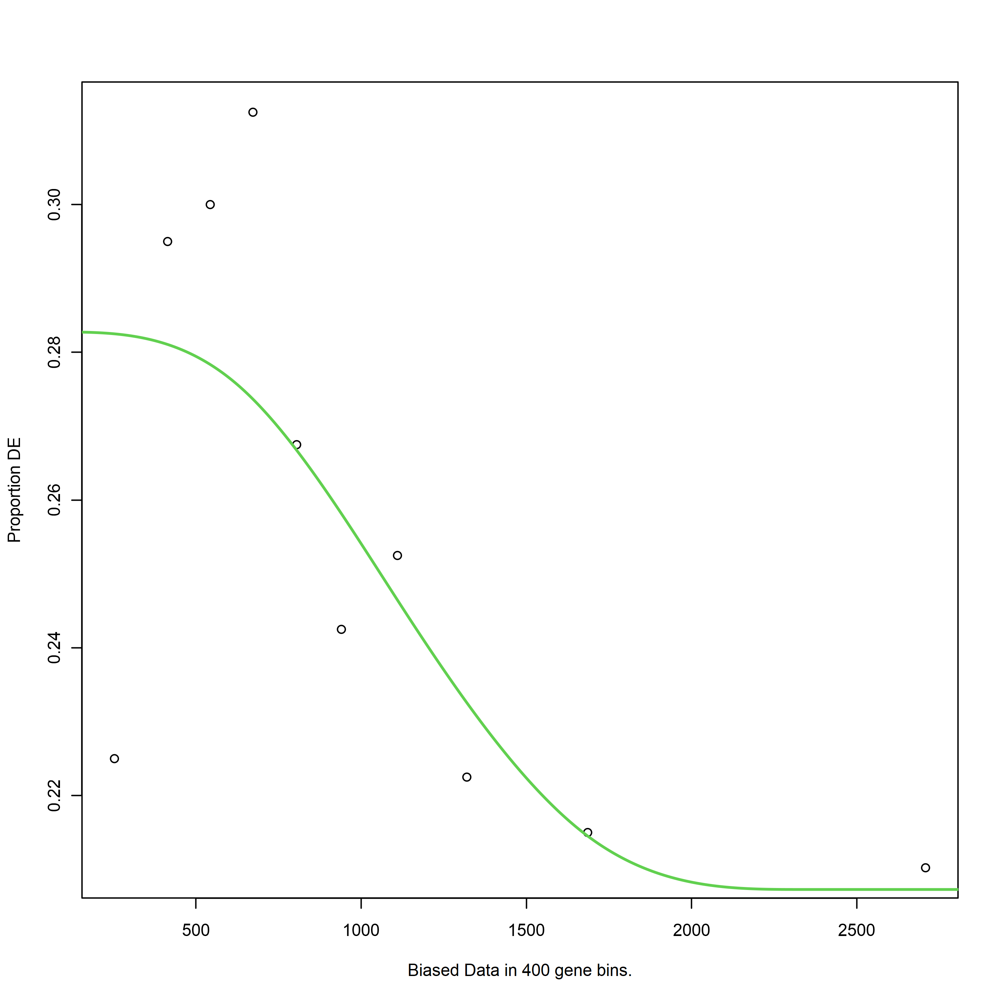

[1] "LATEvsA1_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


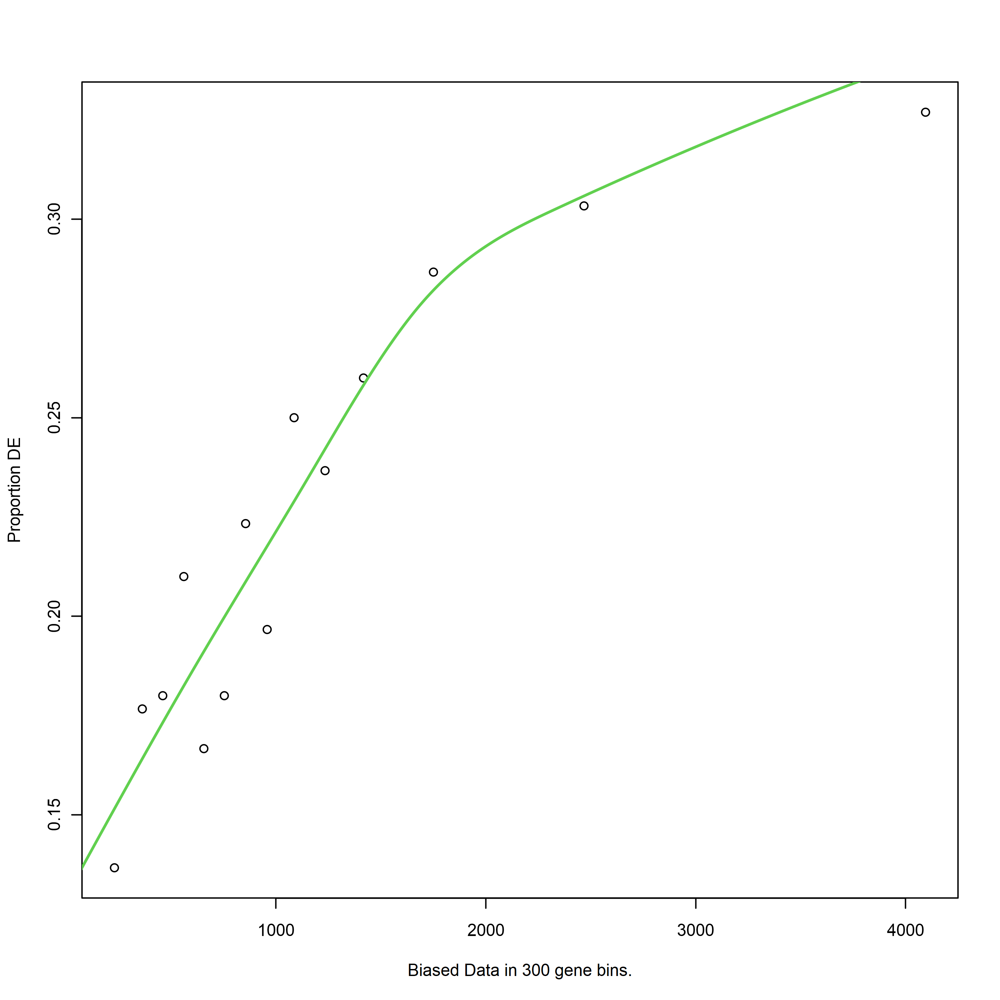

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



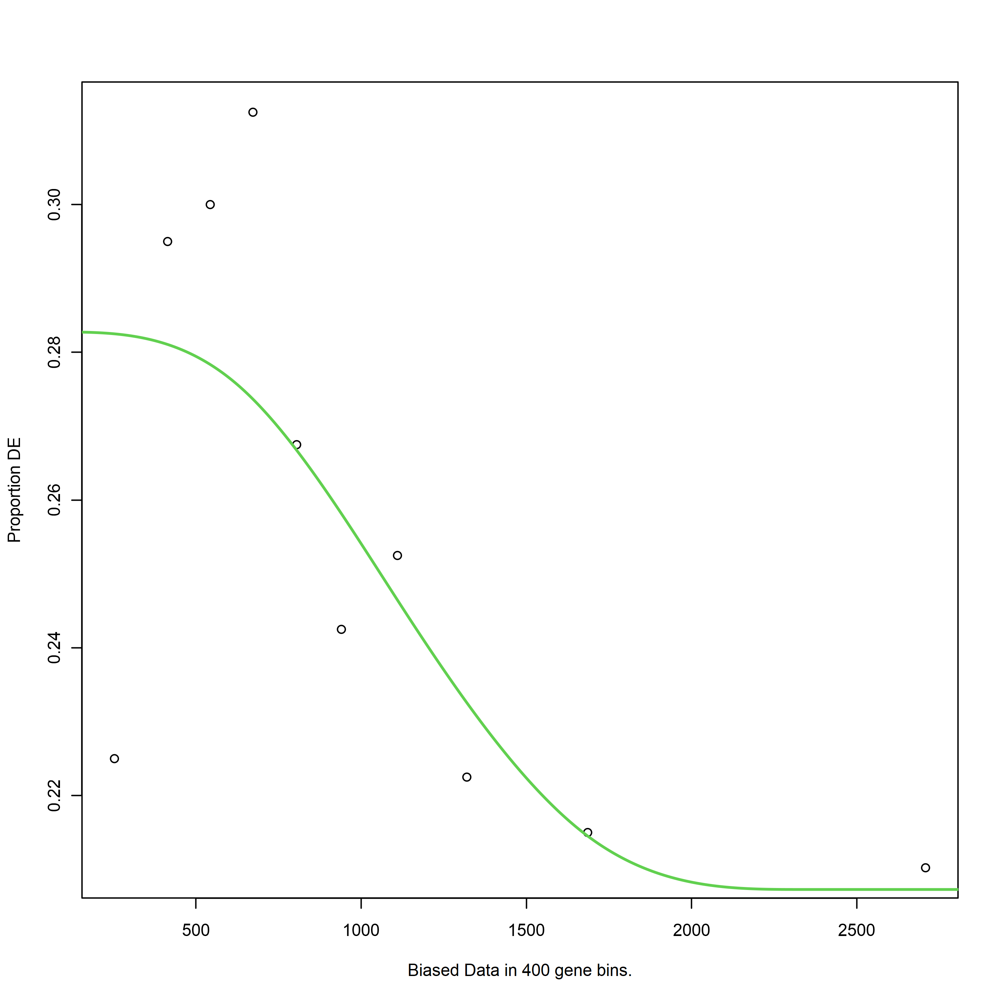

[1] "LATEvsA1_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


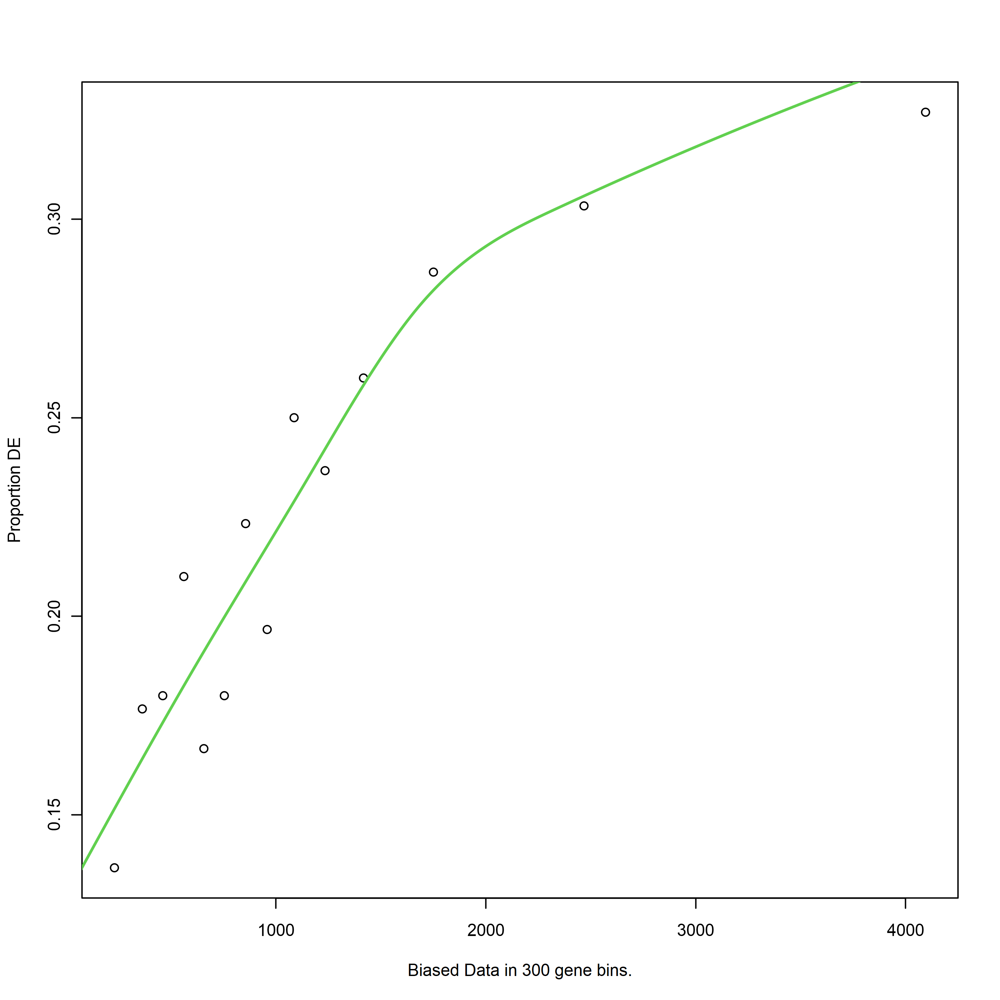

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA2_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


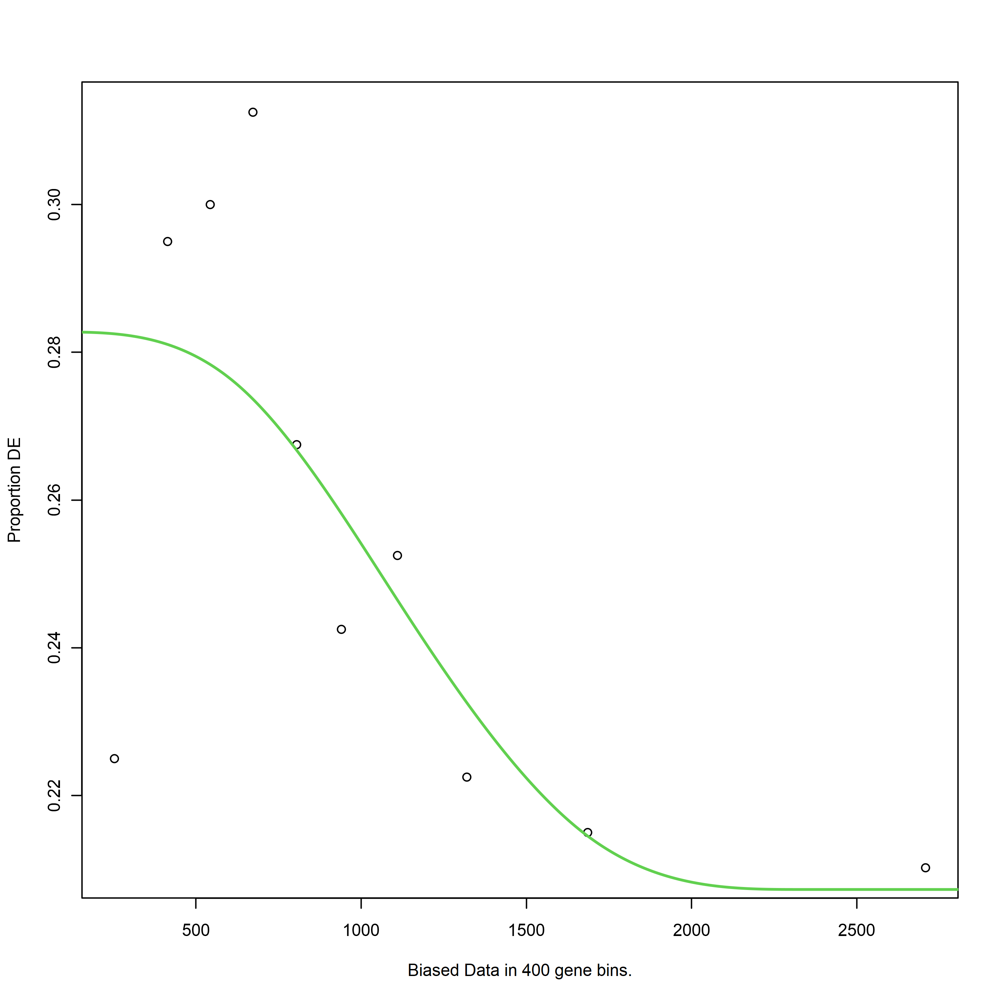

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA2_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


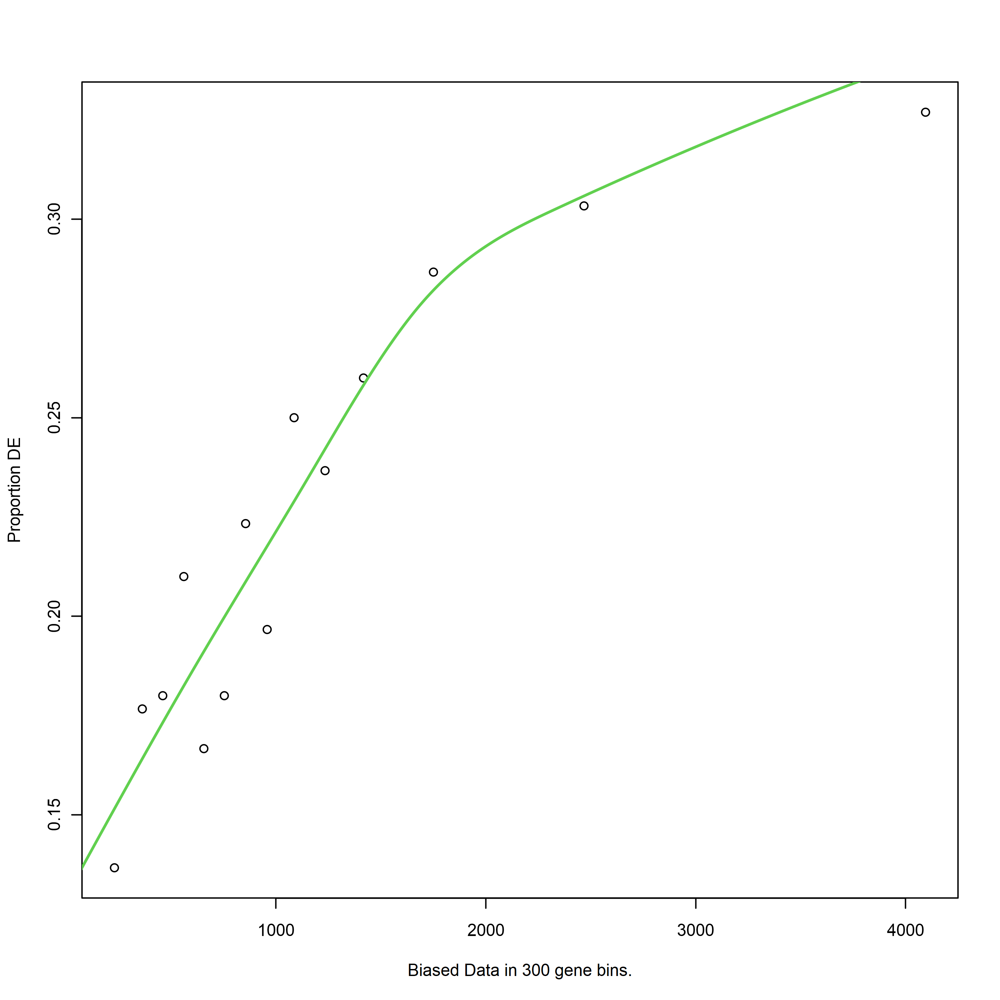

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA2_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


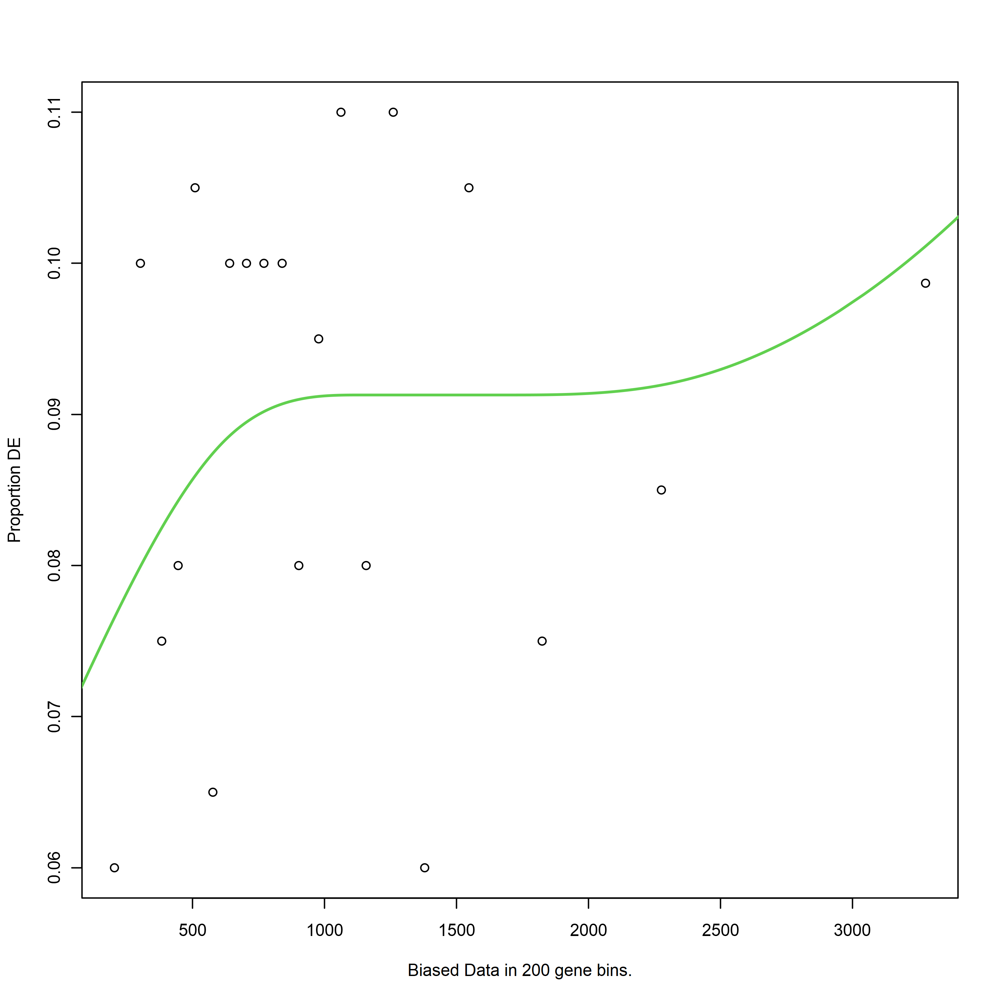

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA2_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


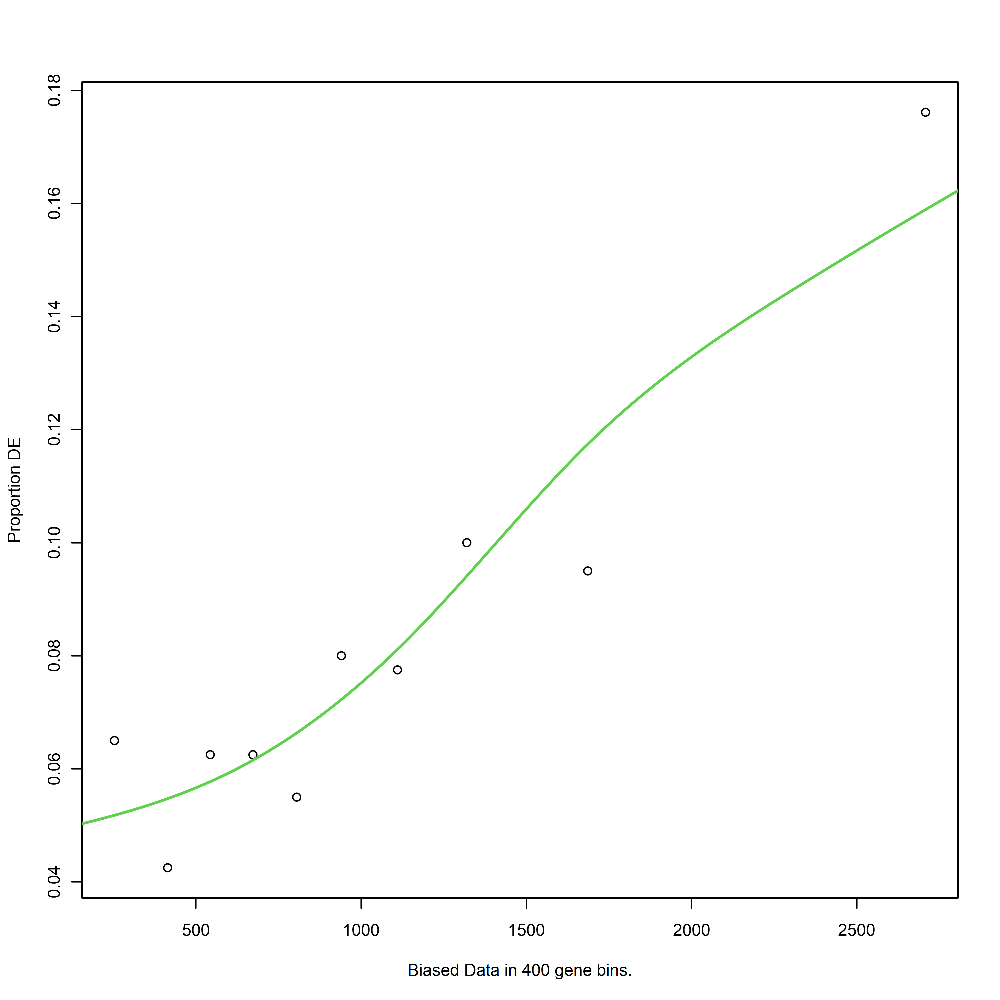

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA2_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


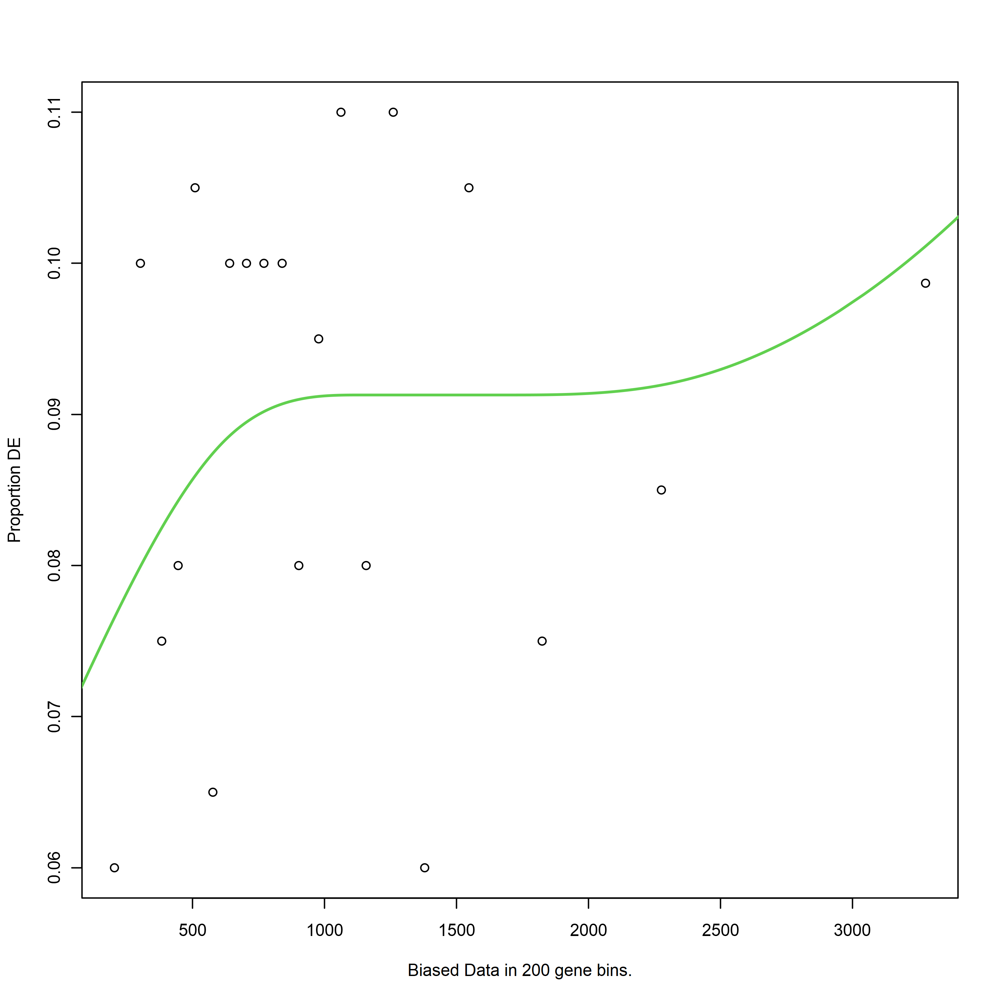

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA2_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


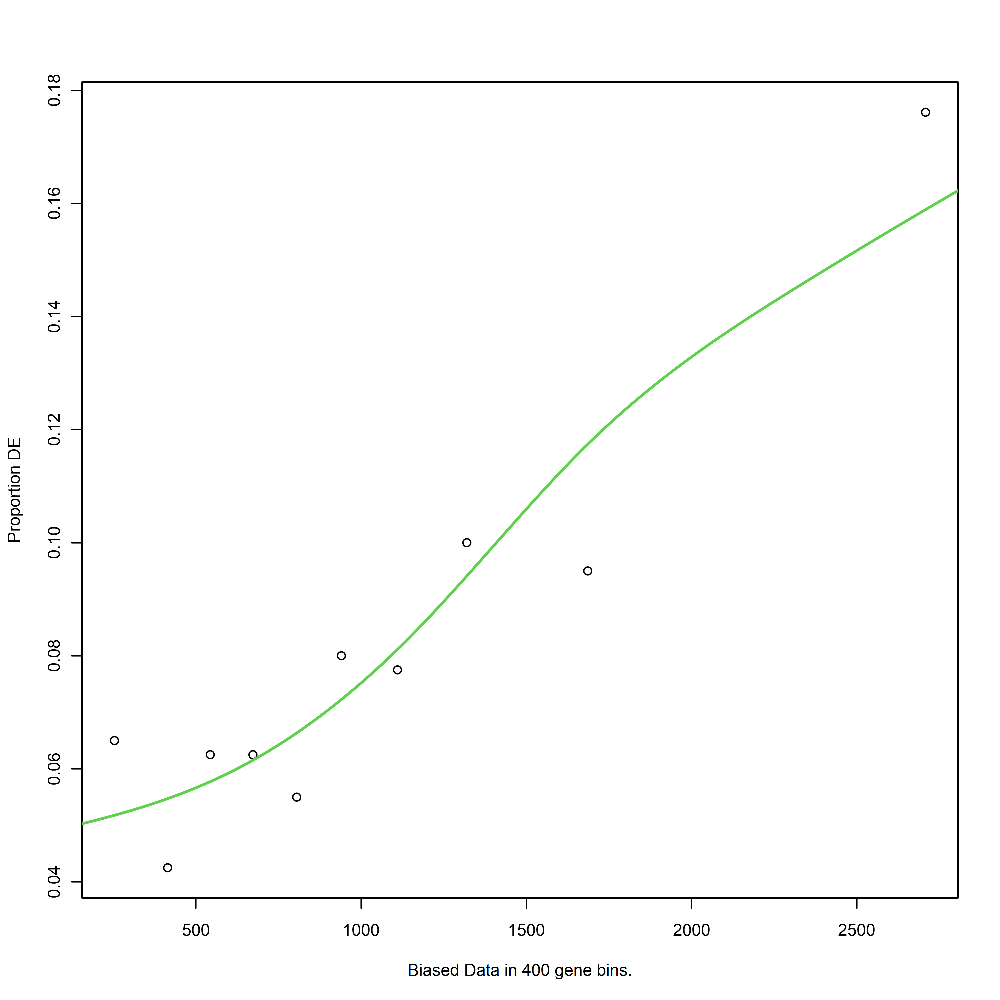

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA2_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


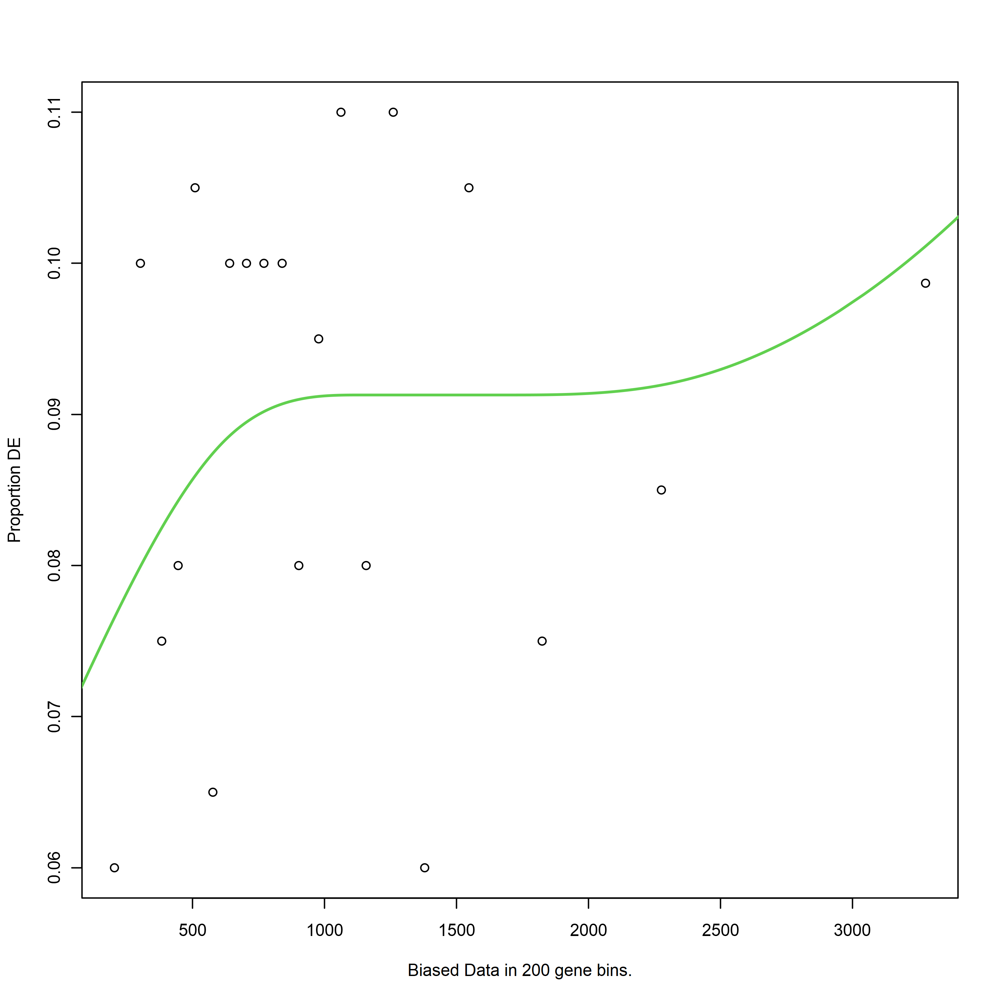

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA2_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


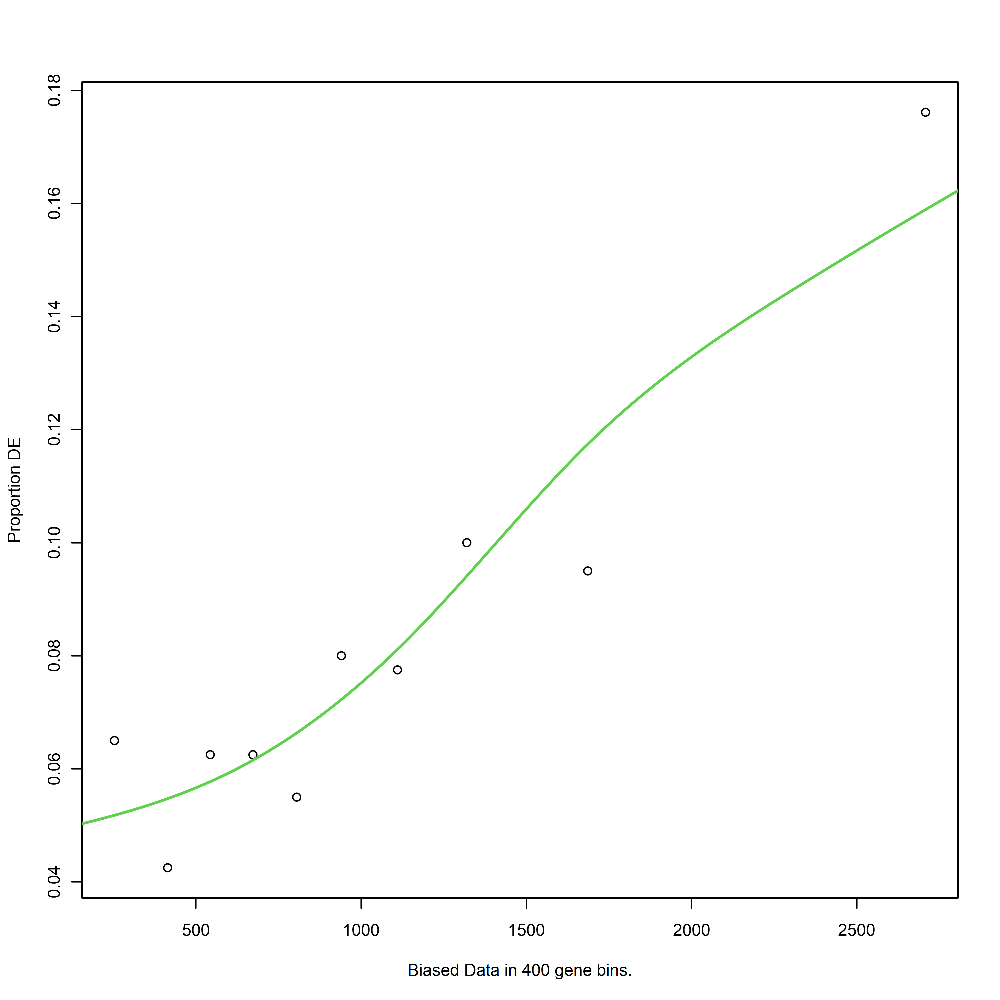

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA3_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


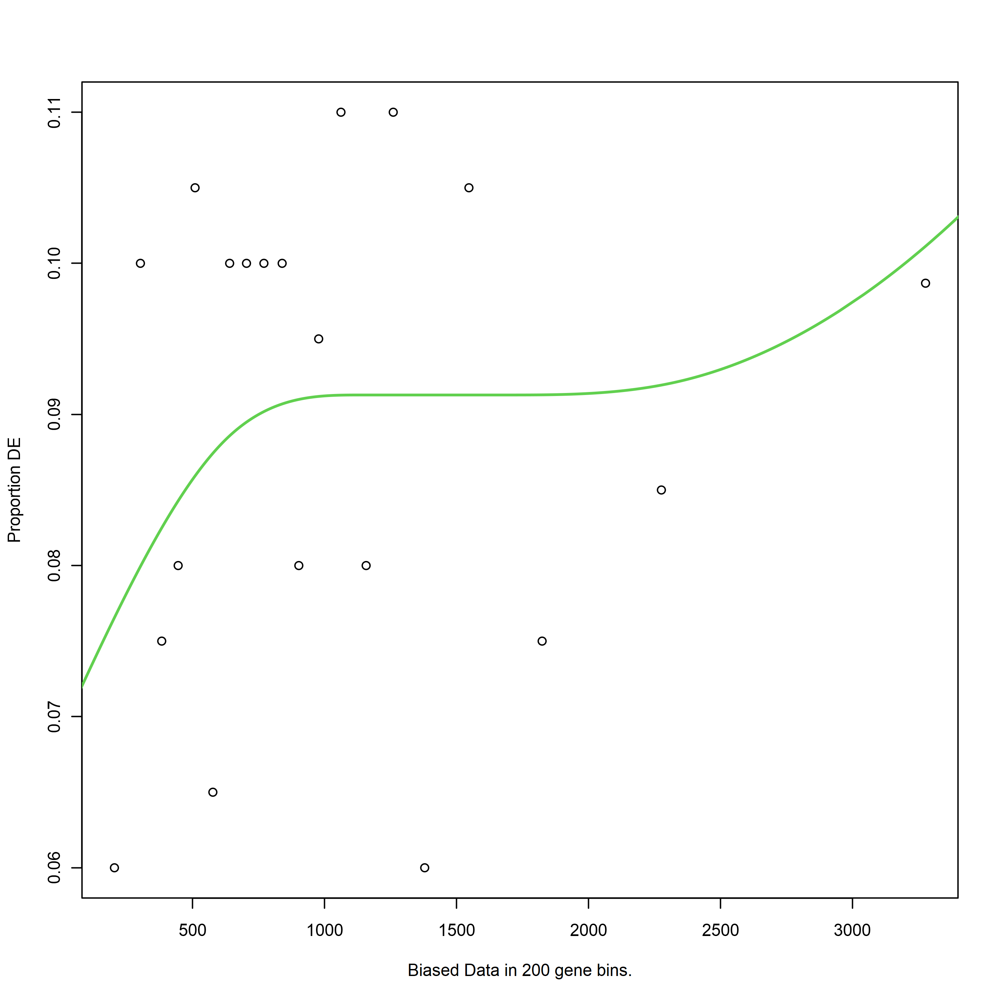

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA3_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


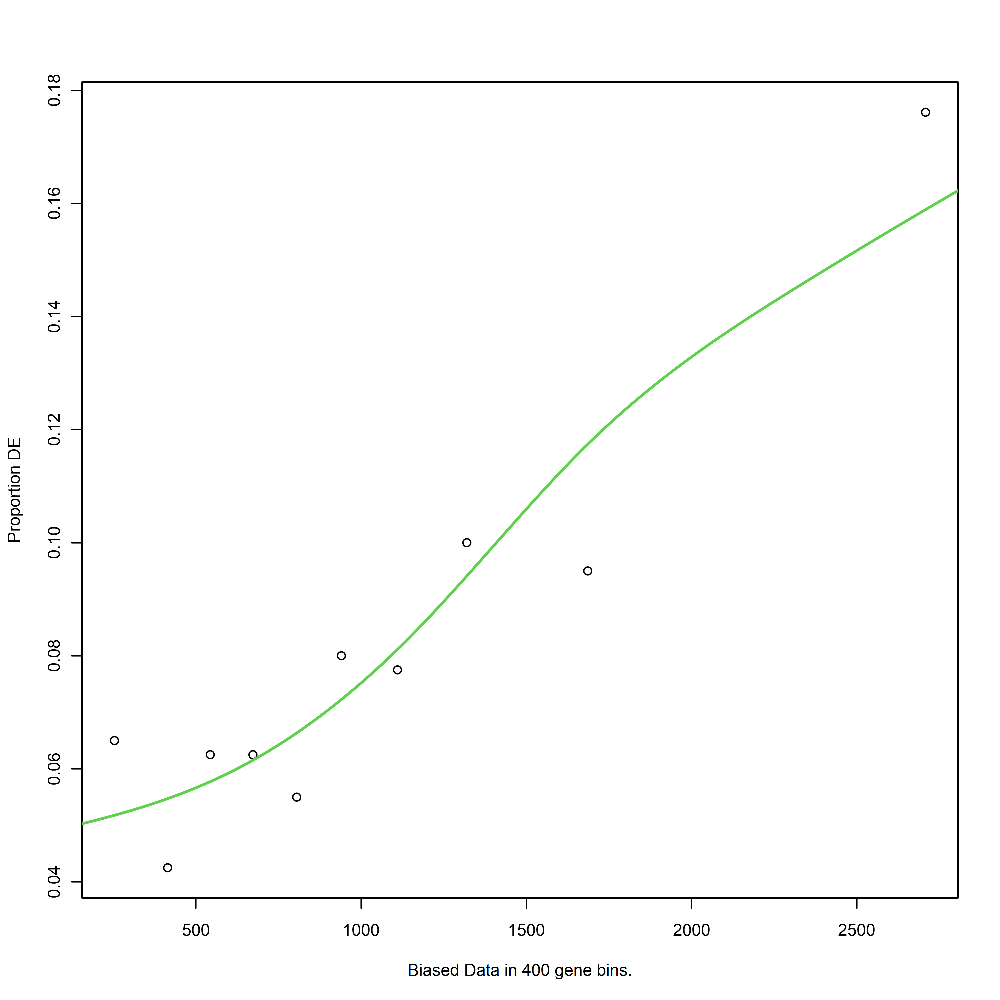

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA3_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


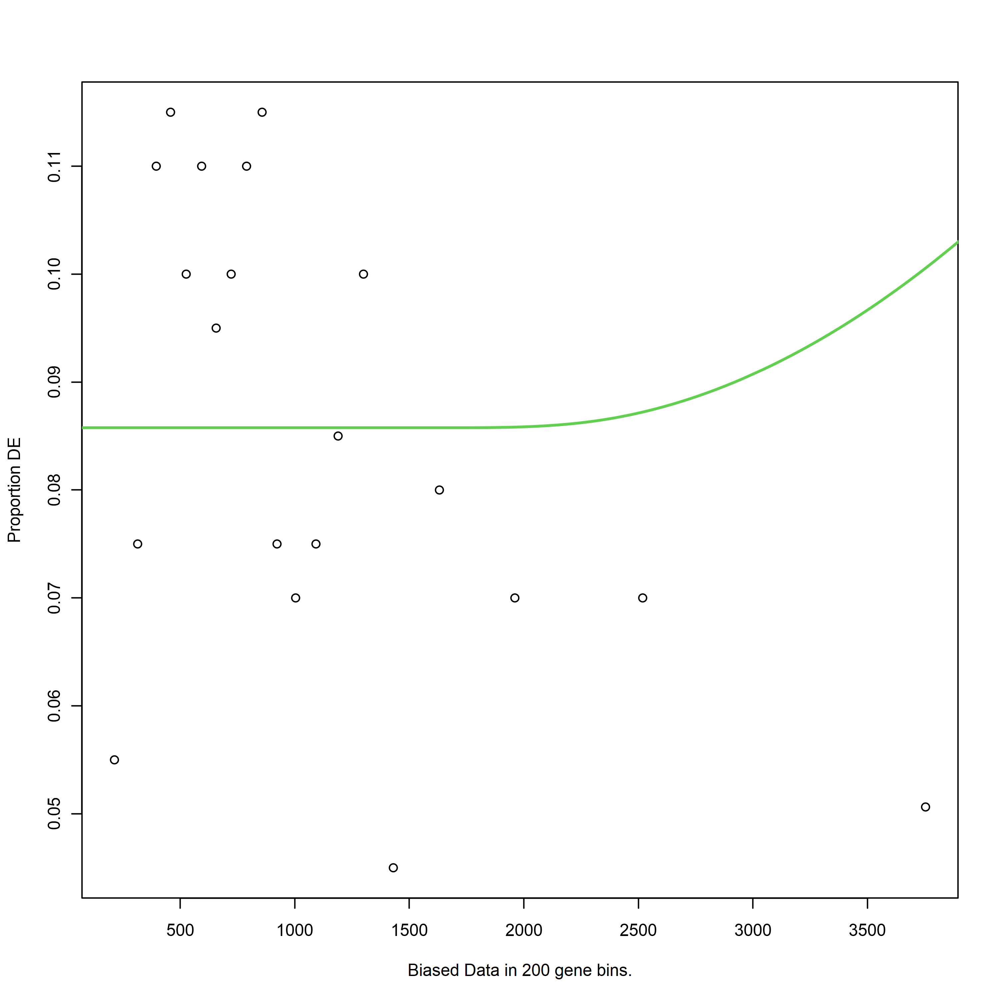

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA3_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


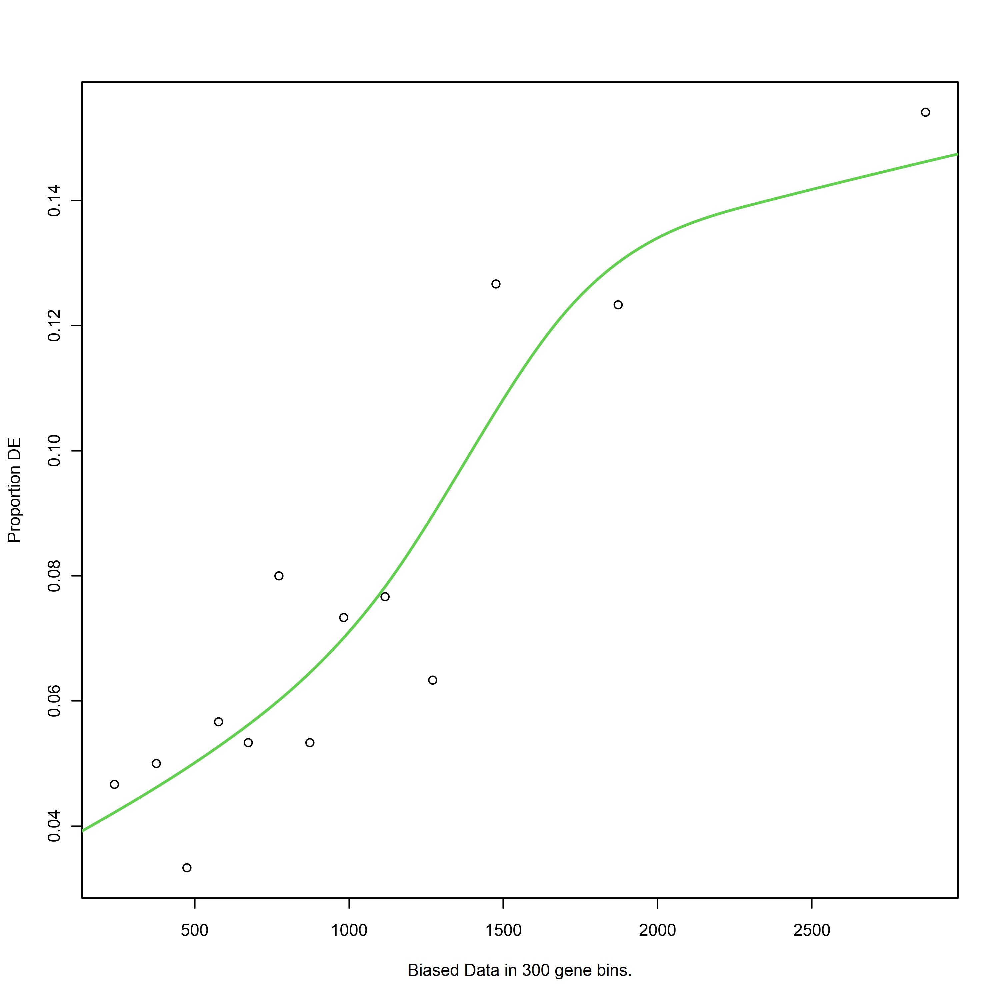

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA3_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


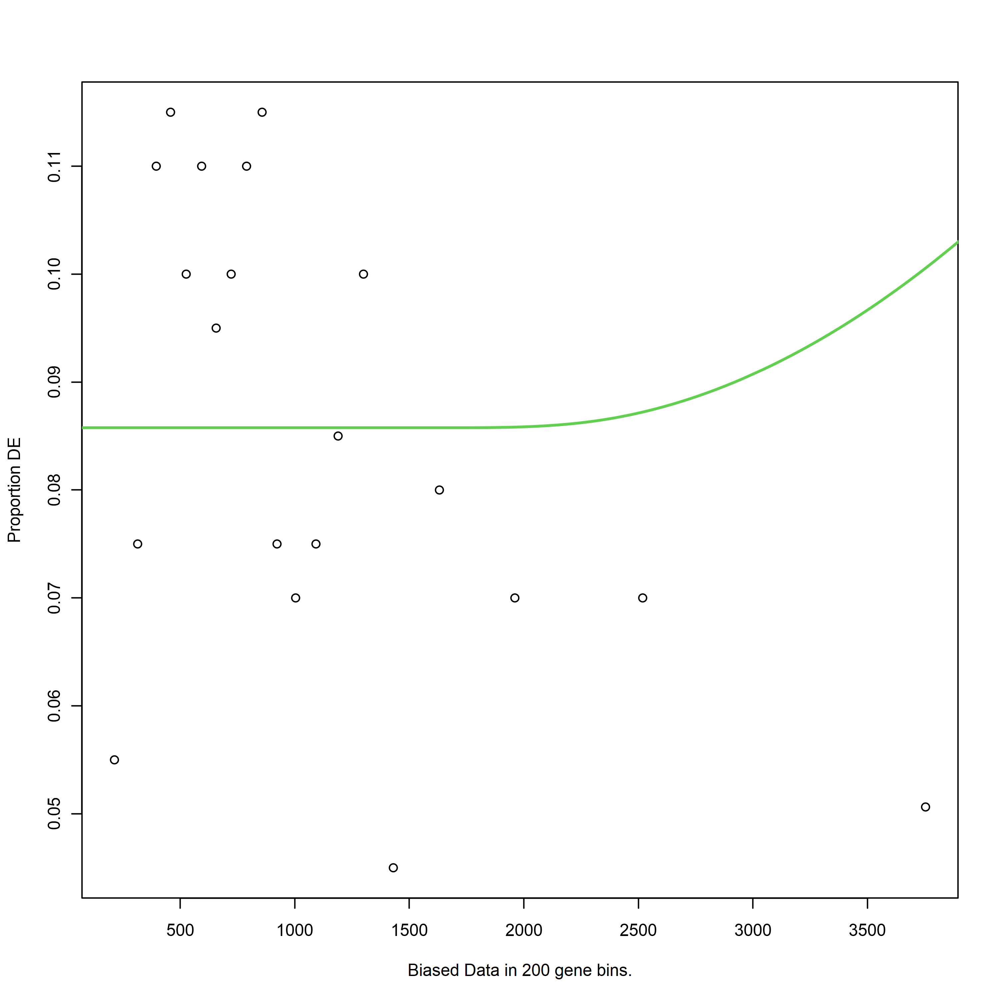

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA3_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


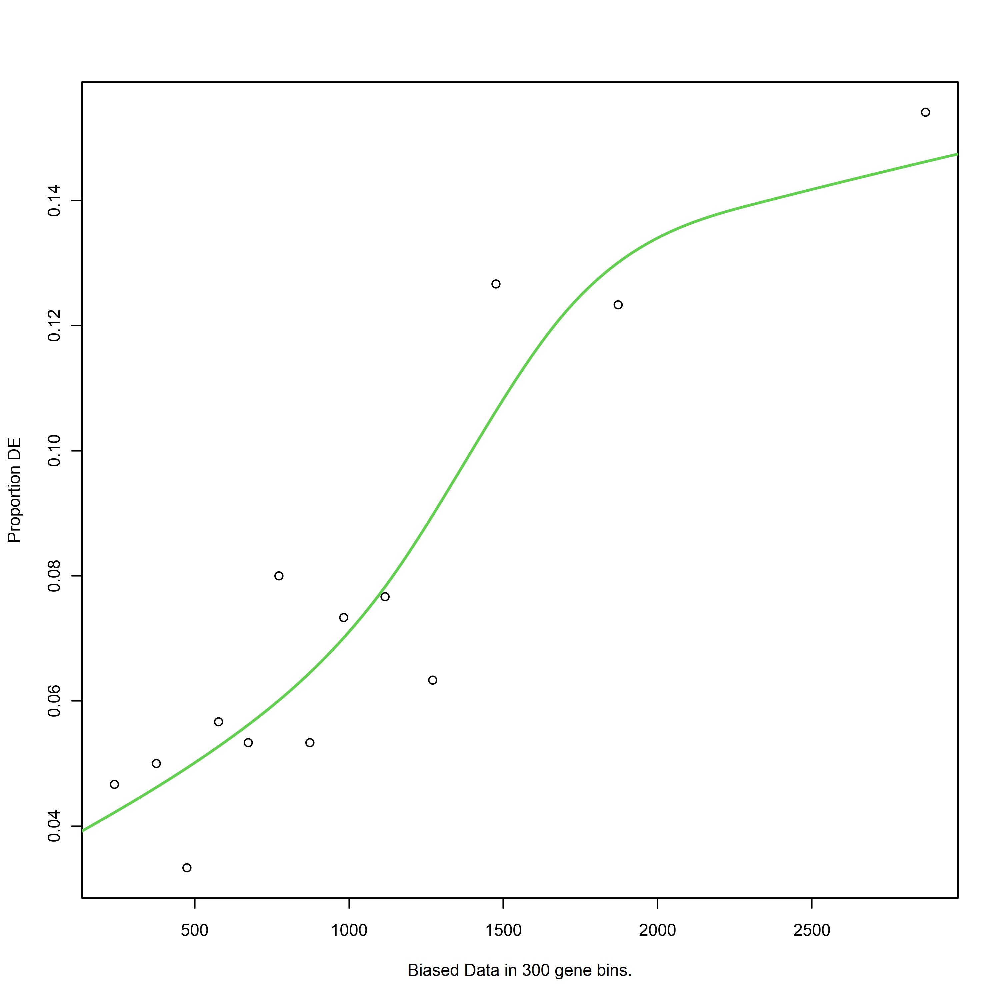

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA3_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


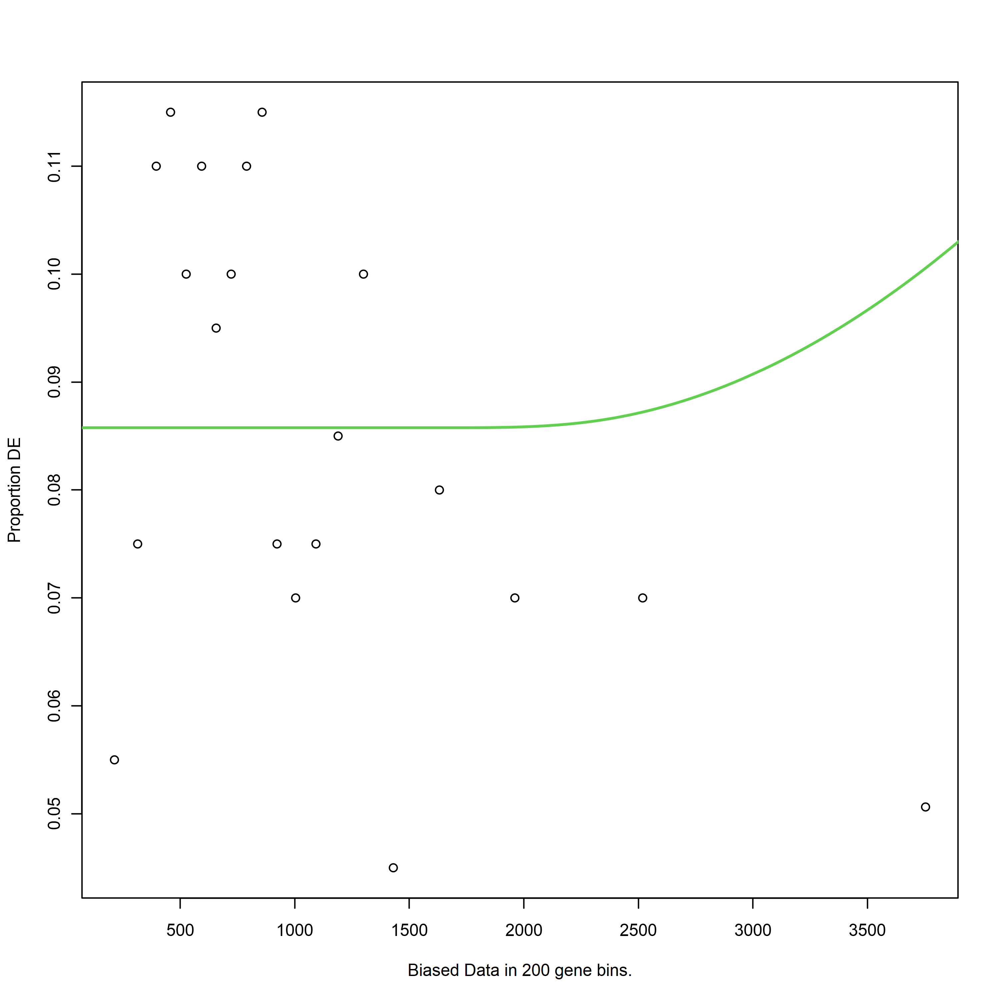

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsA3_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


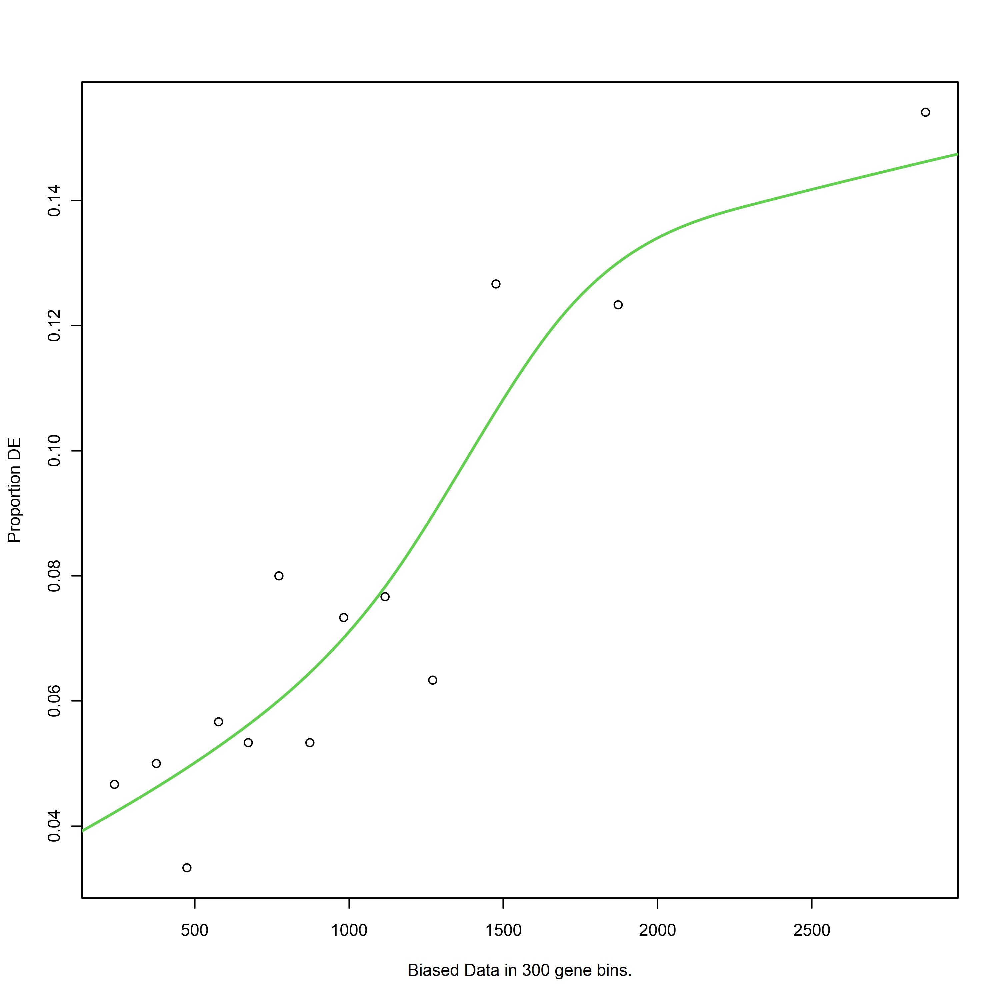

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


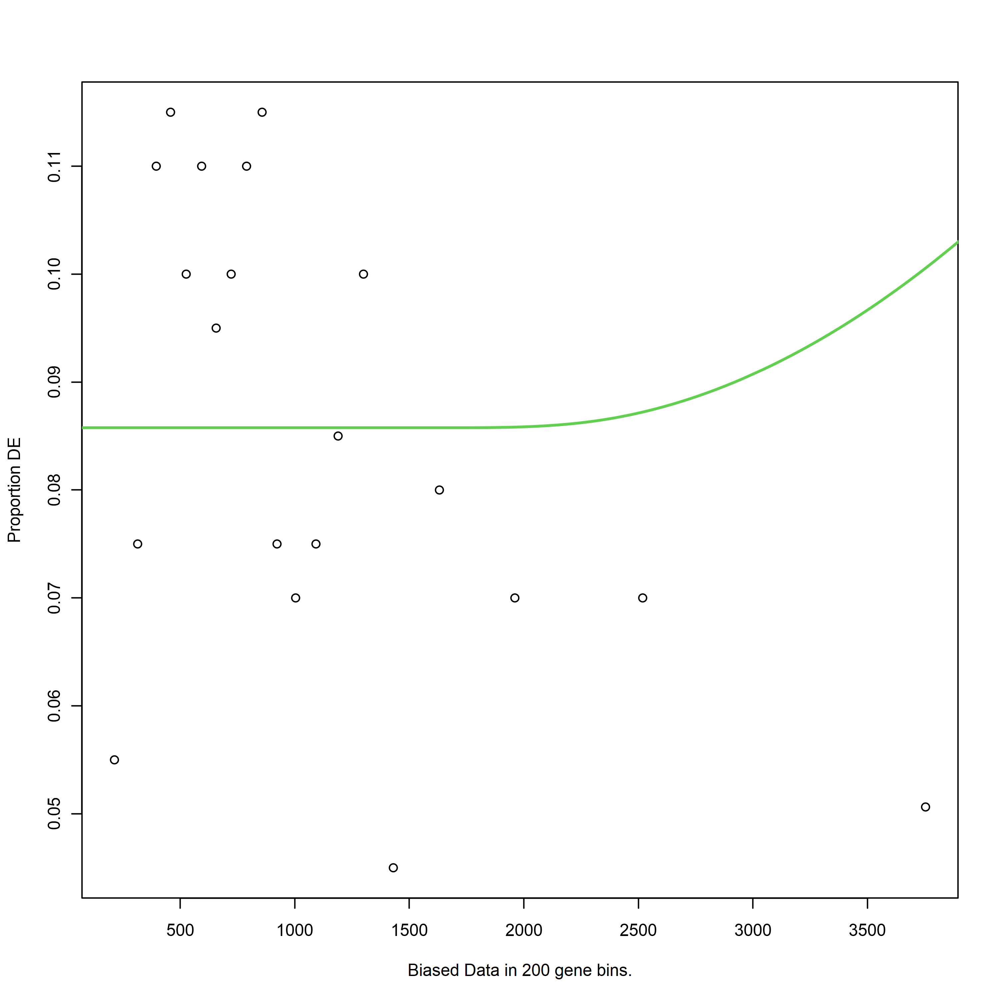

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


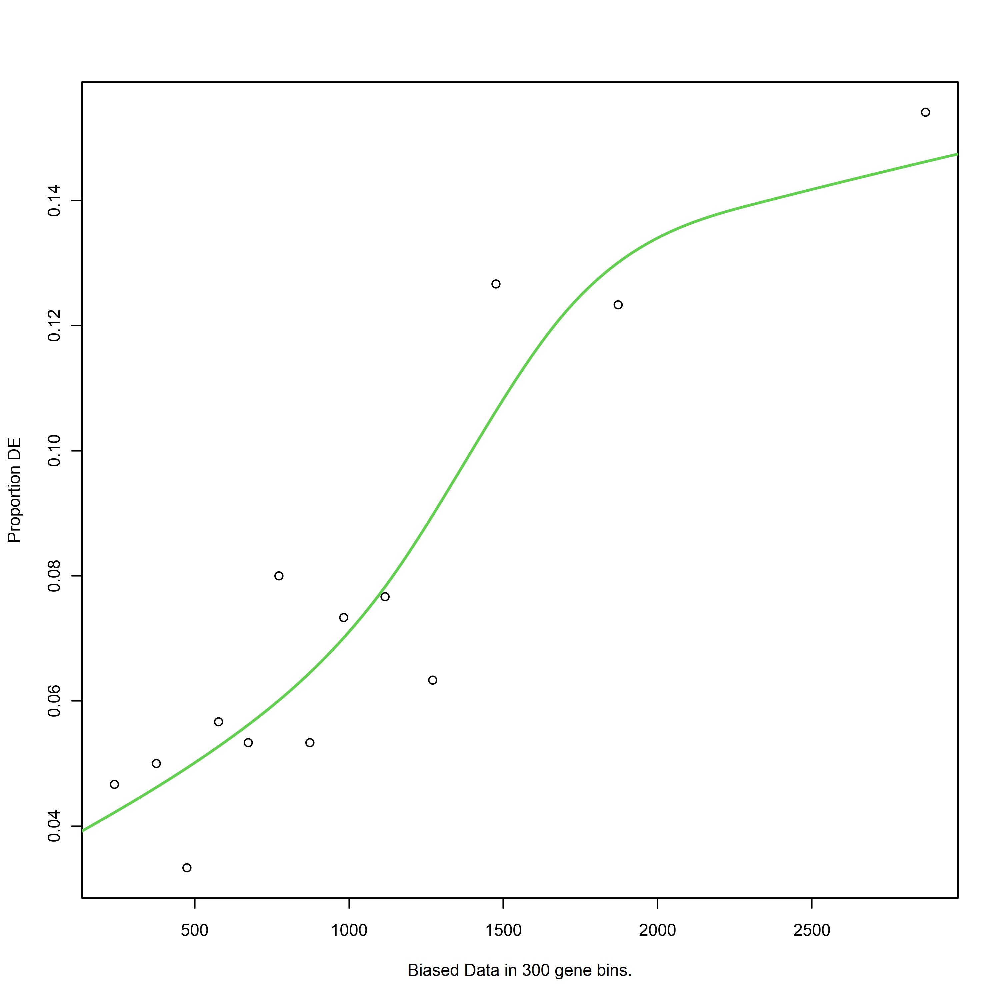

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


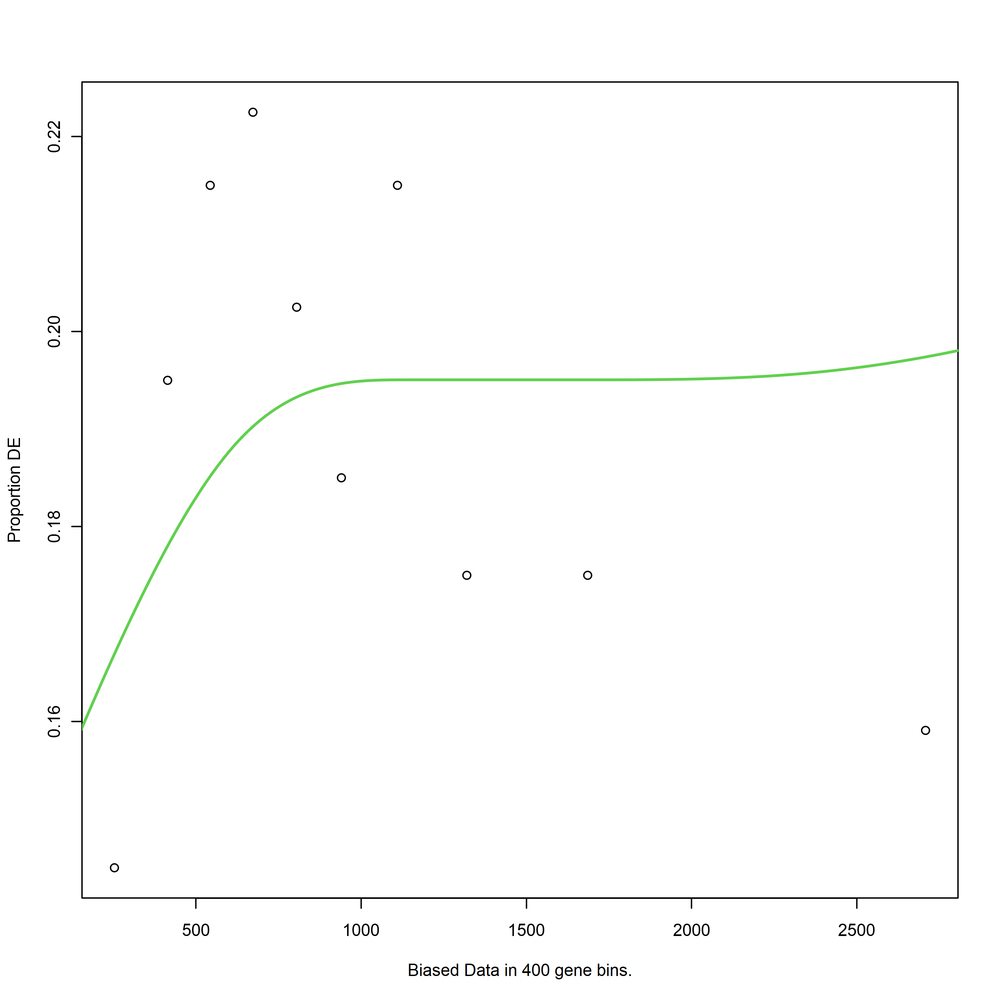

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


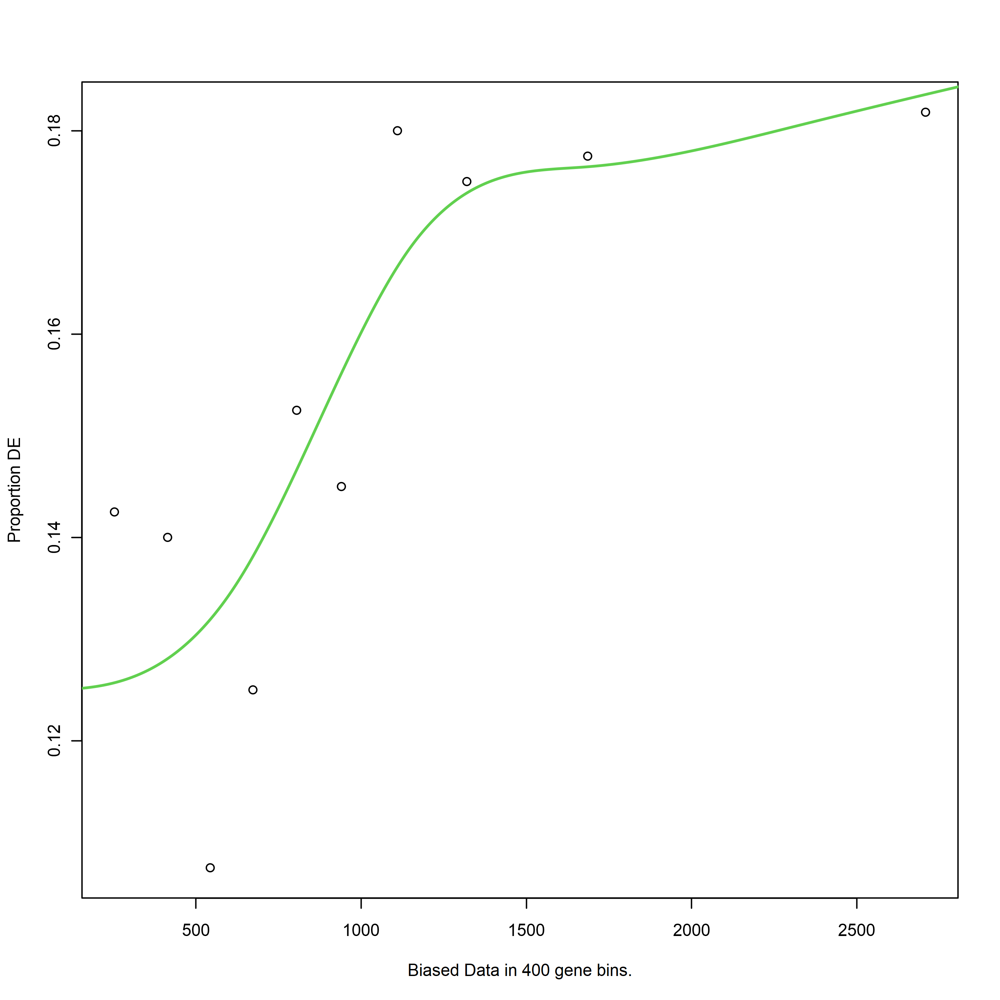

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


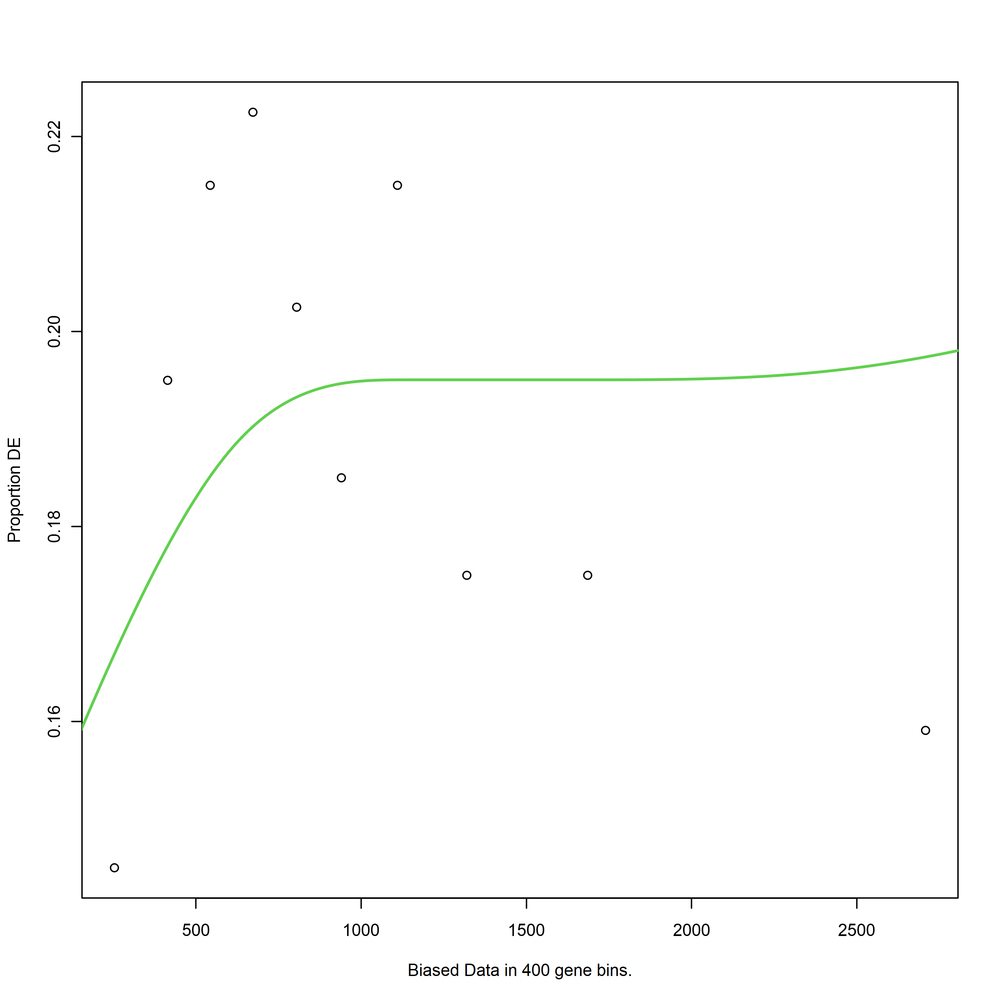

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


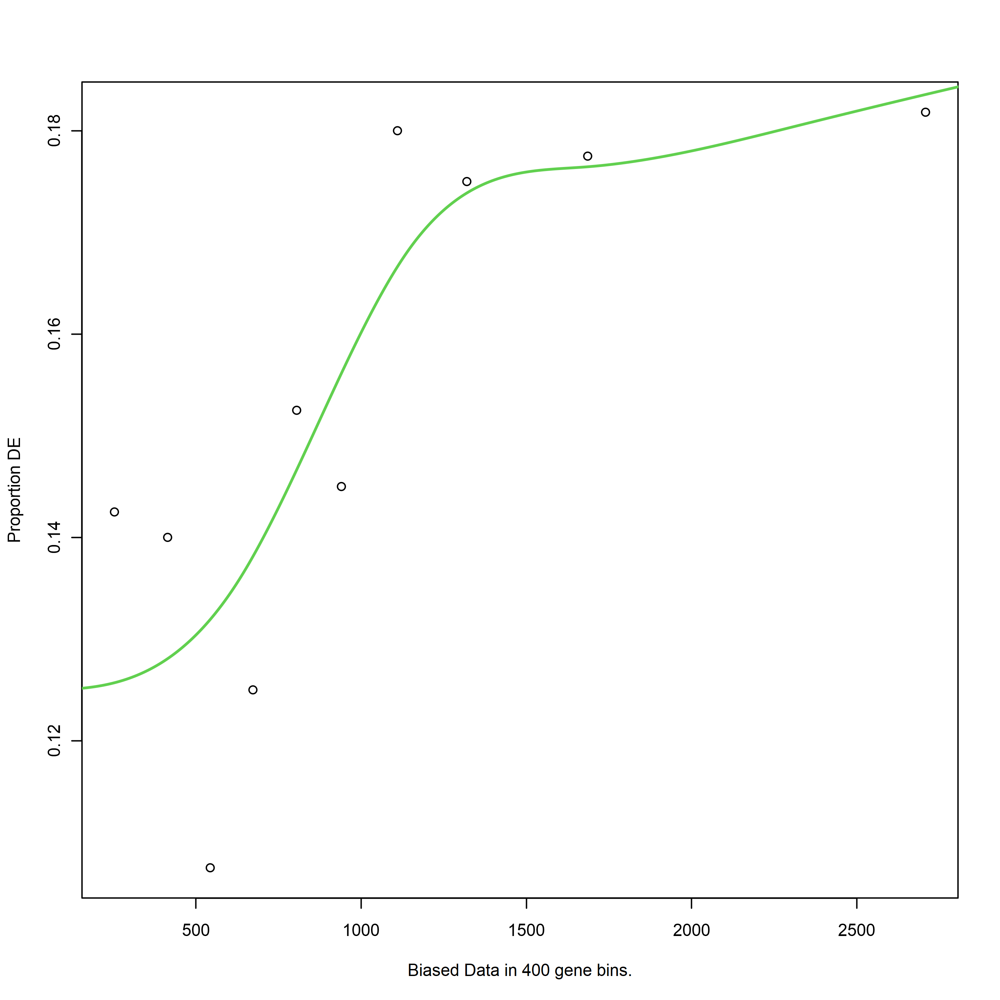

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


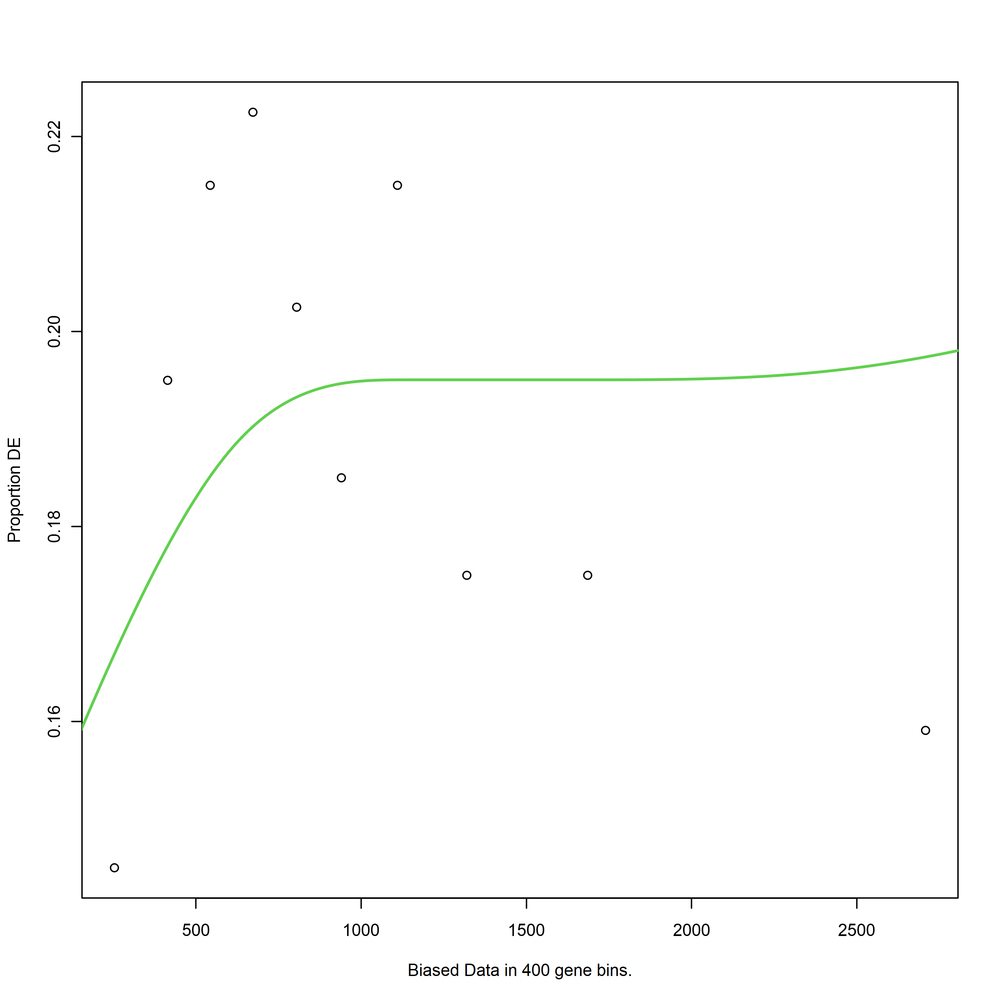

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


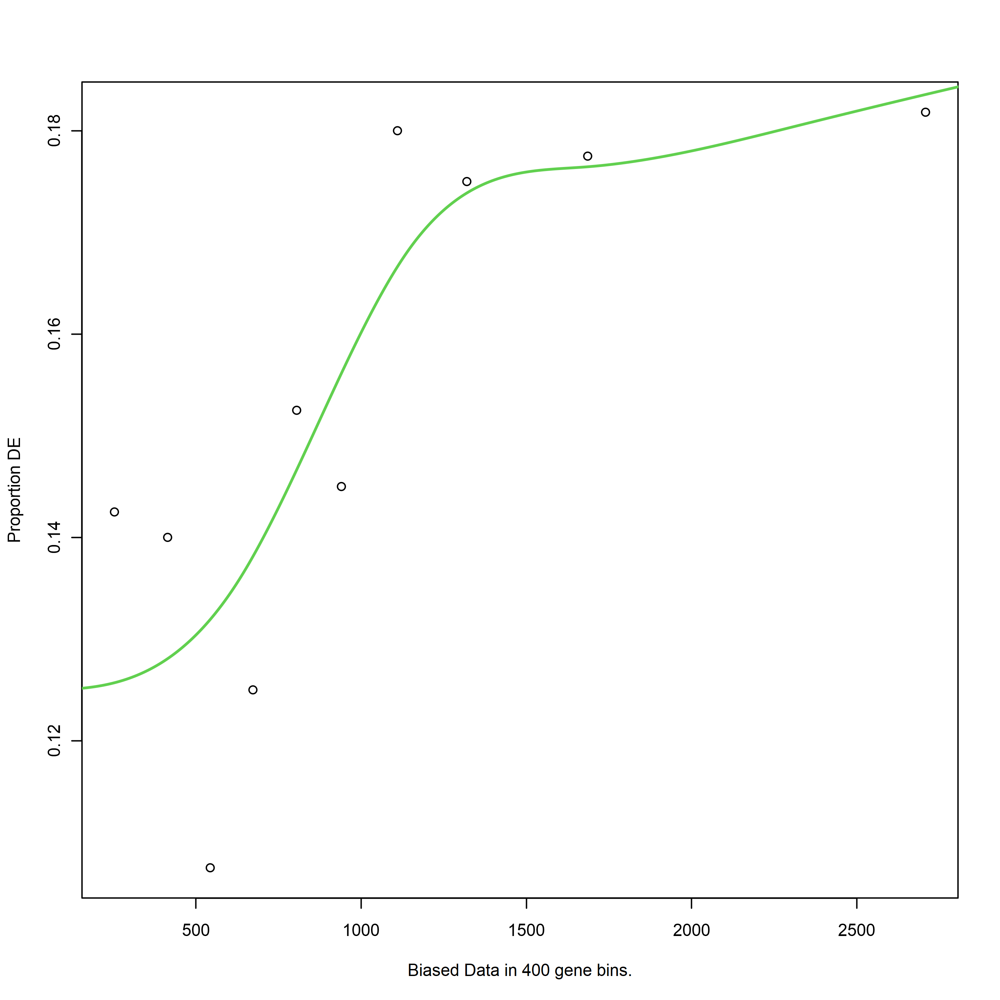

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC2_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


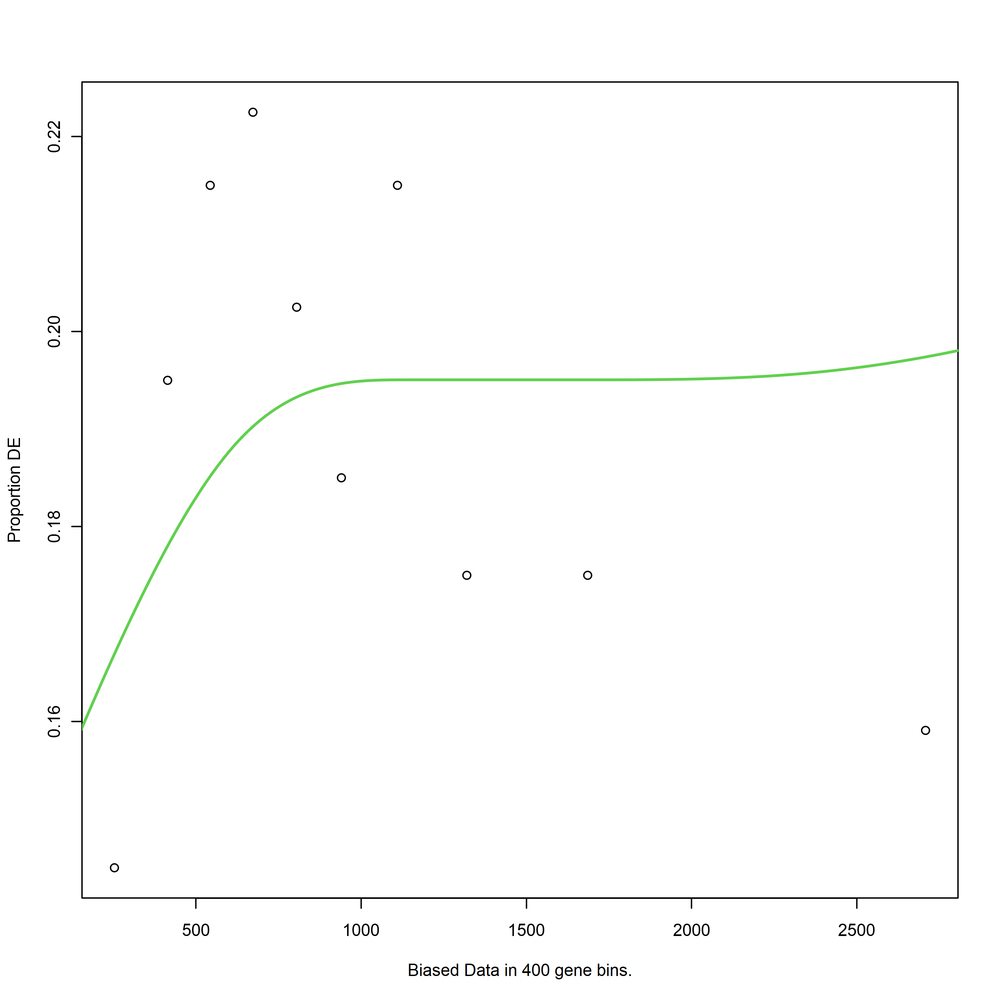

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC2_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


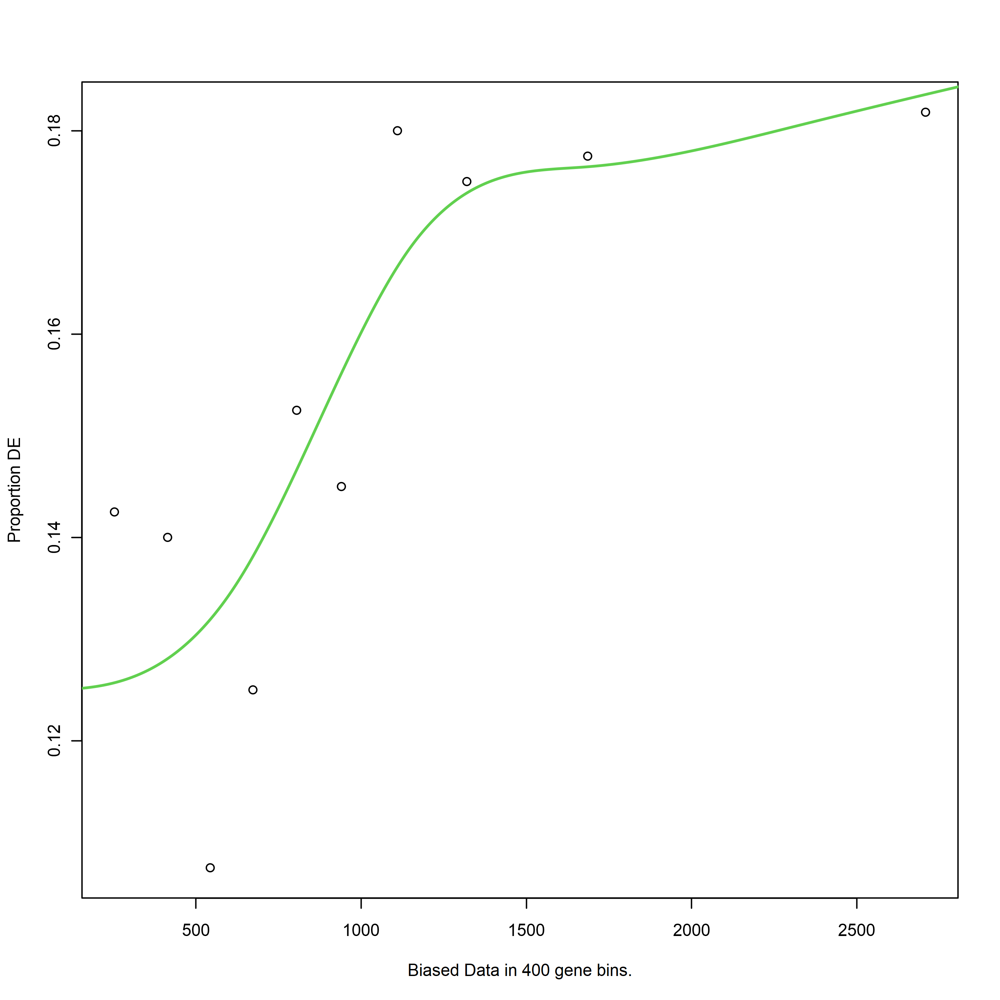

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC2_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


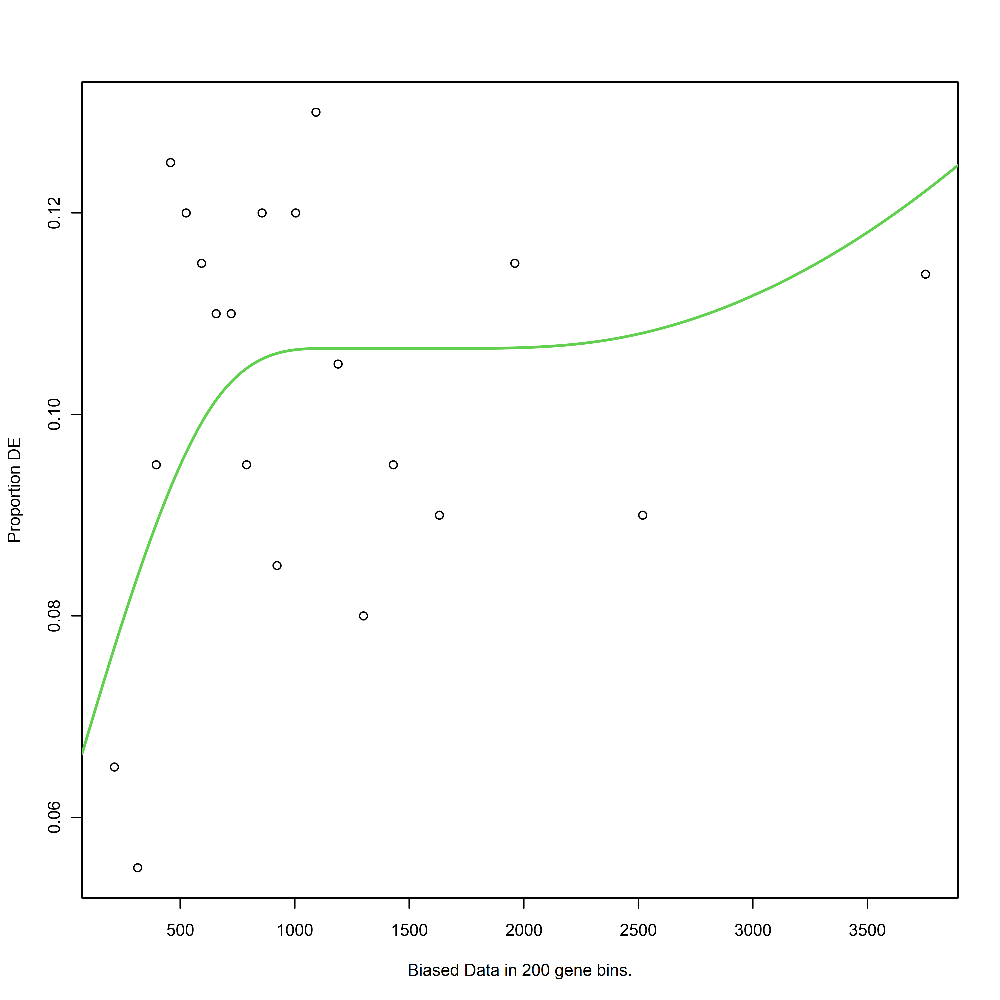

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC2_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


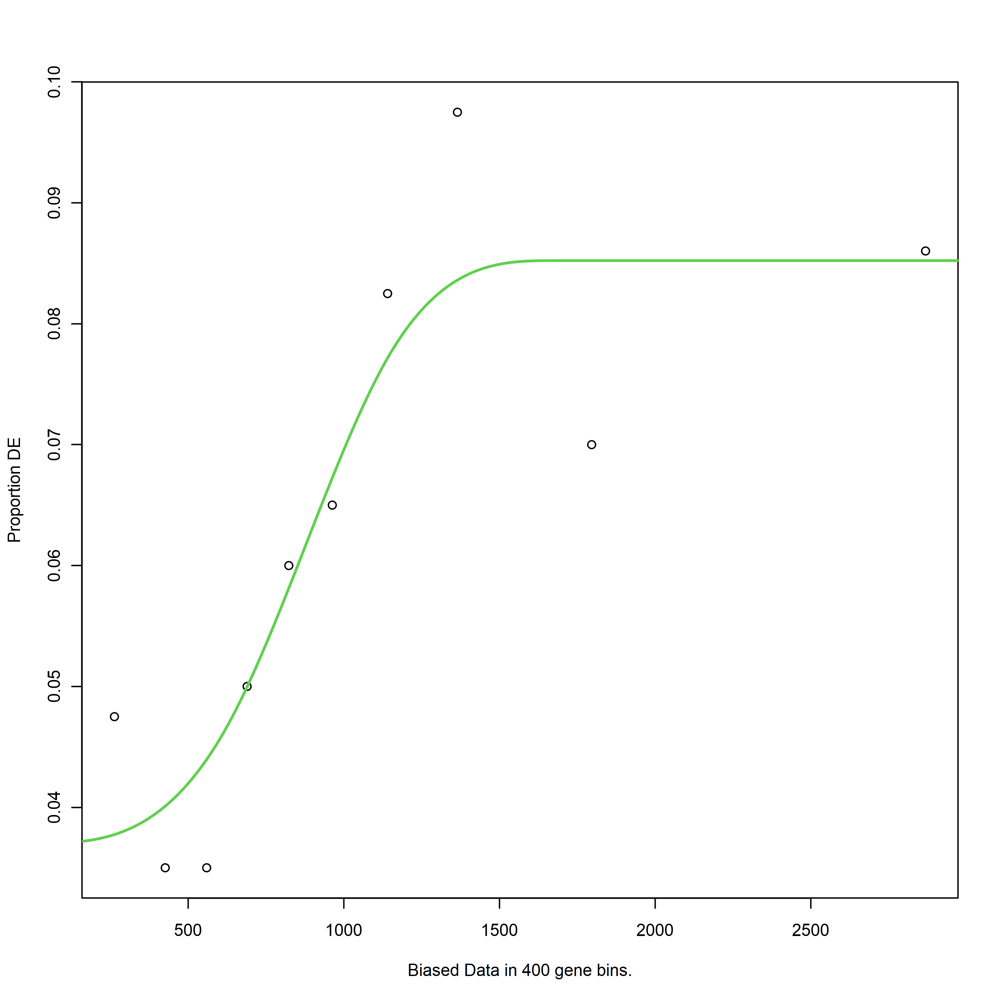

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC2_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


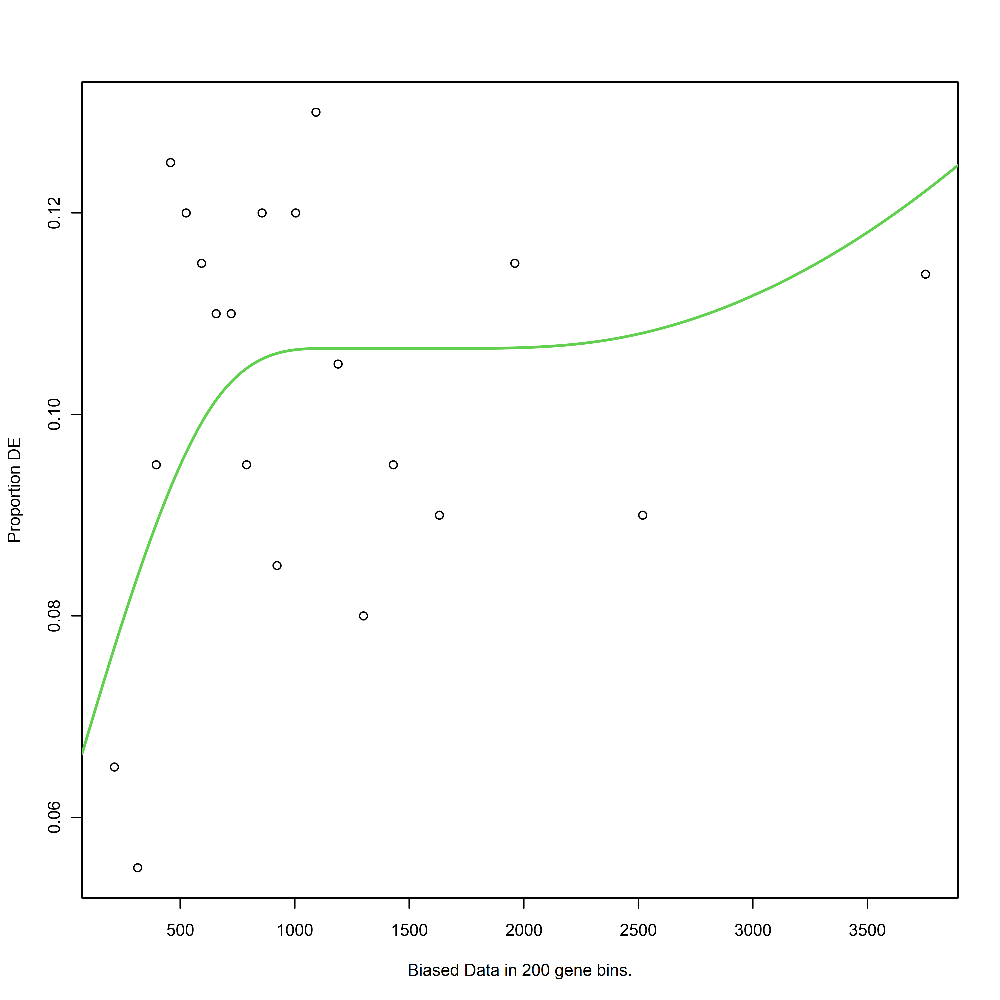

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC2_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


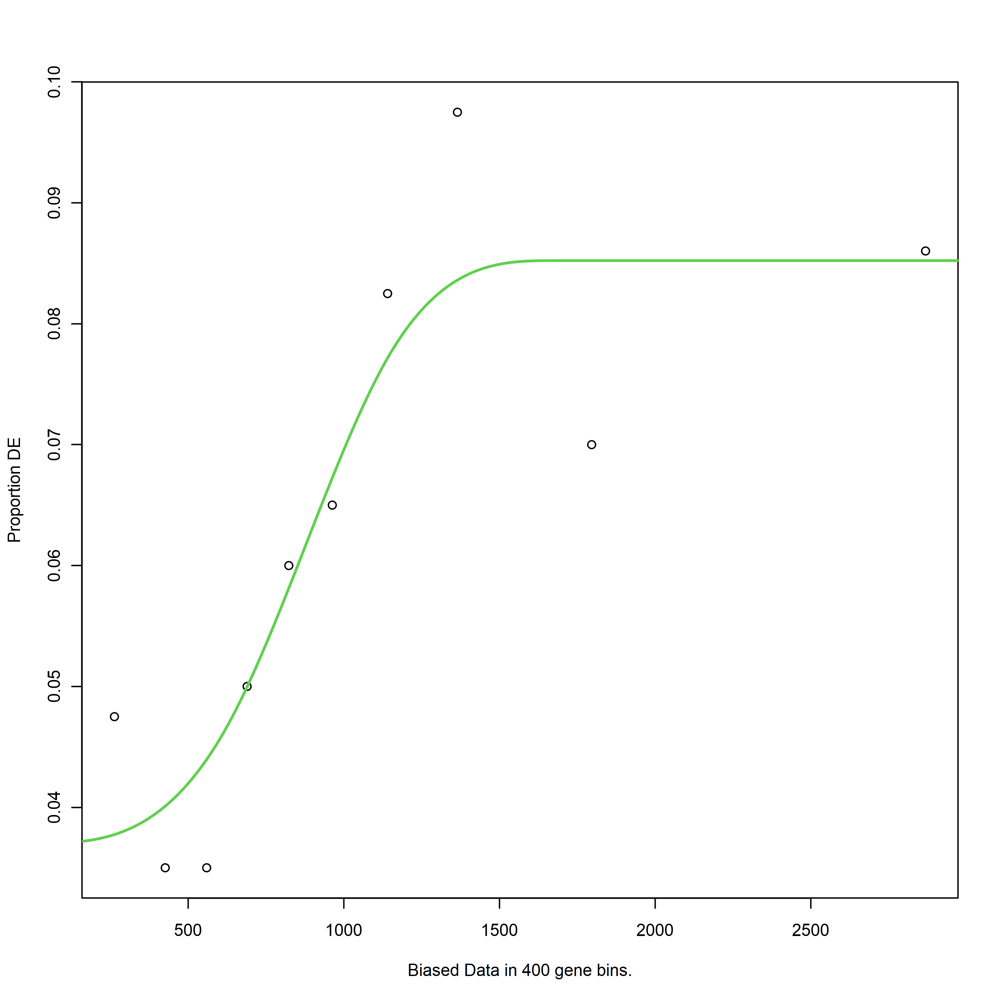

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC2_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


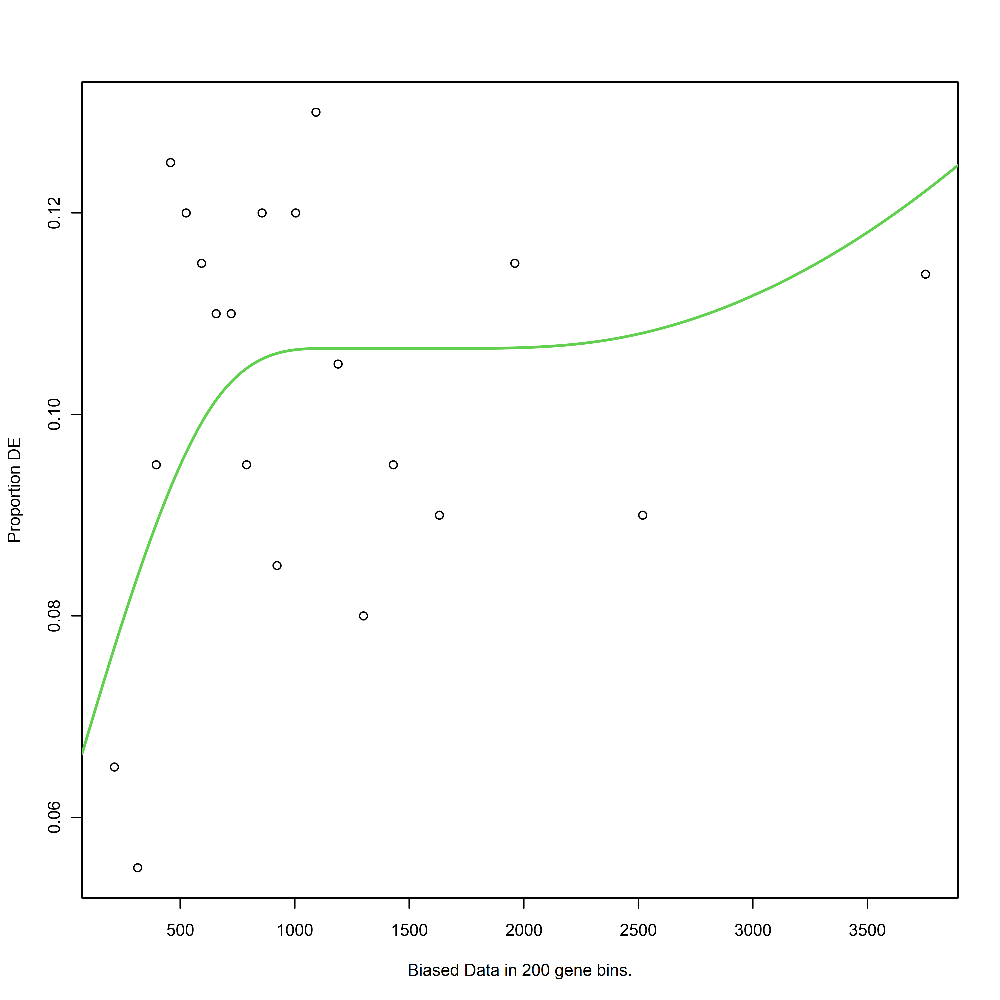

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC2_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


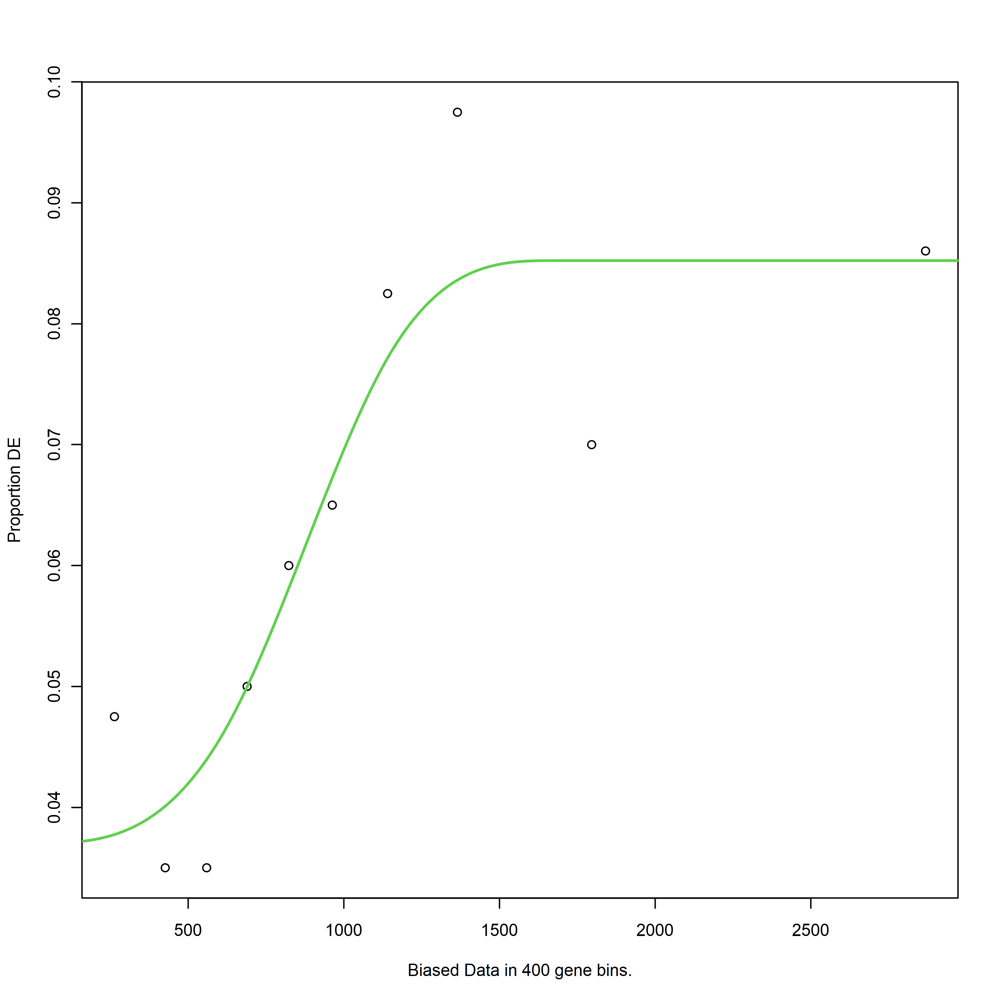

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC3_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


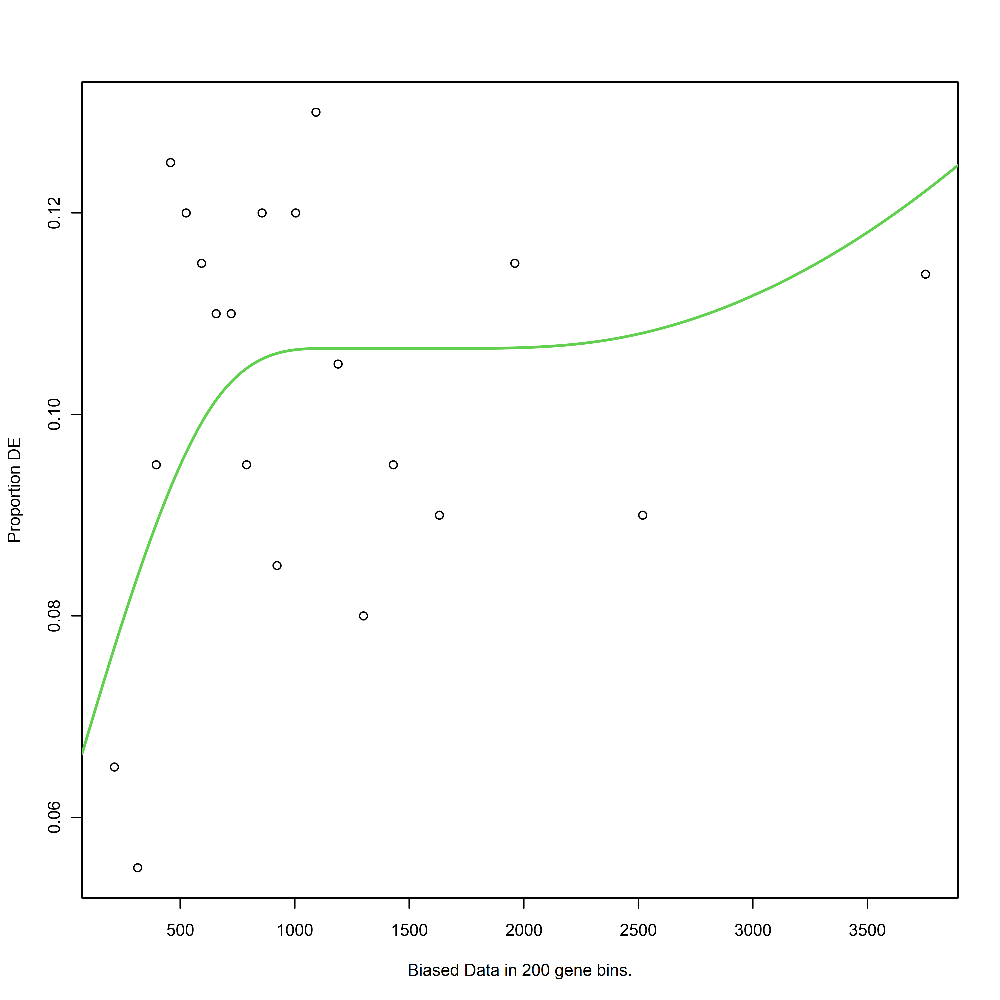

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC3_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


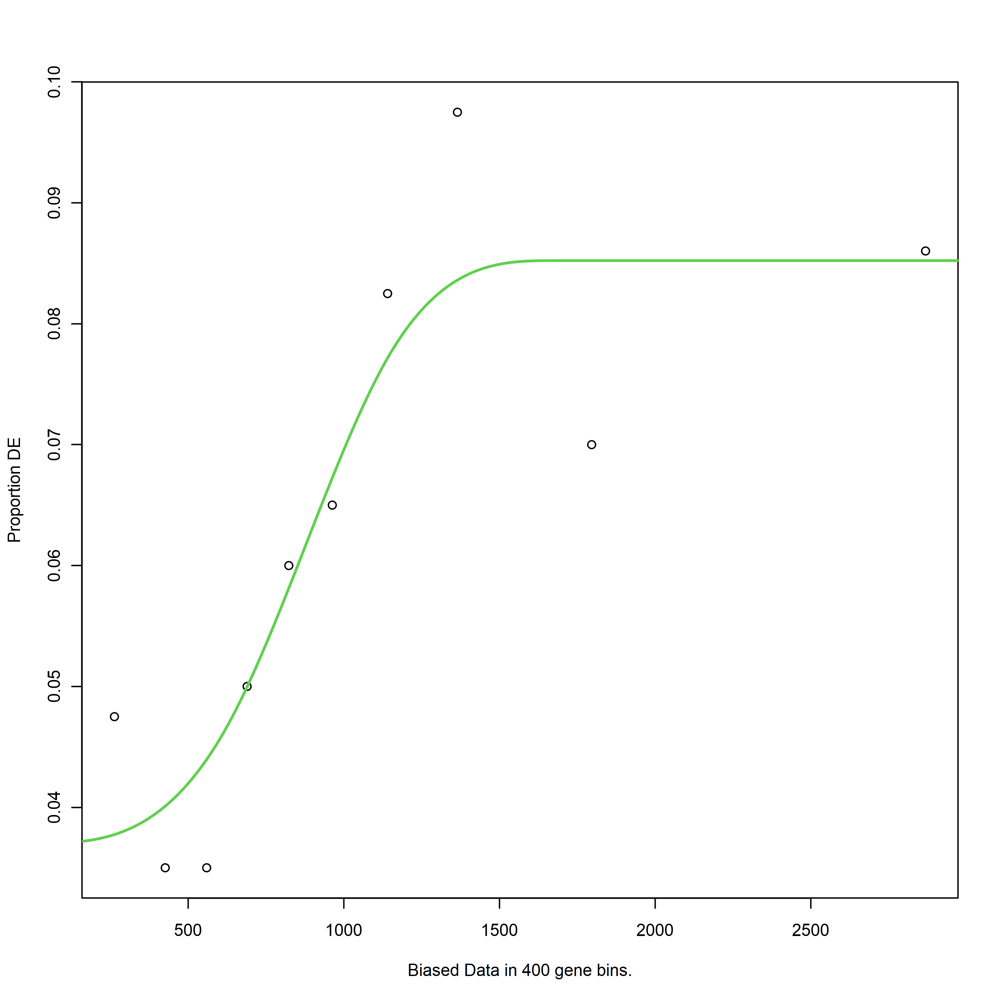

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC3_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


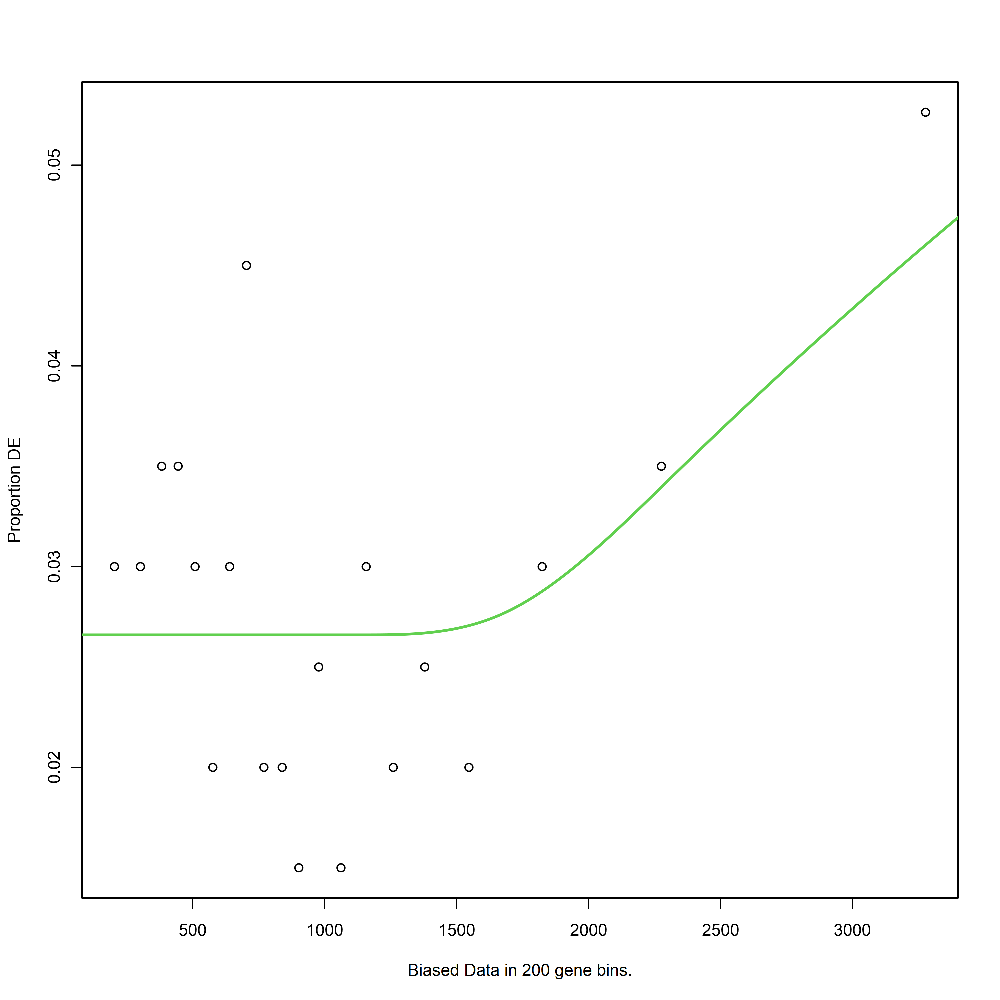

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC3_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


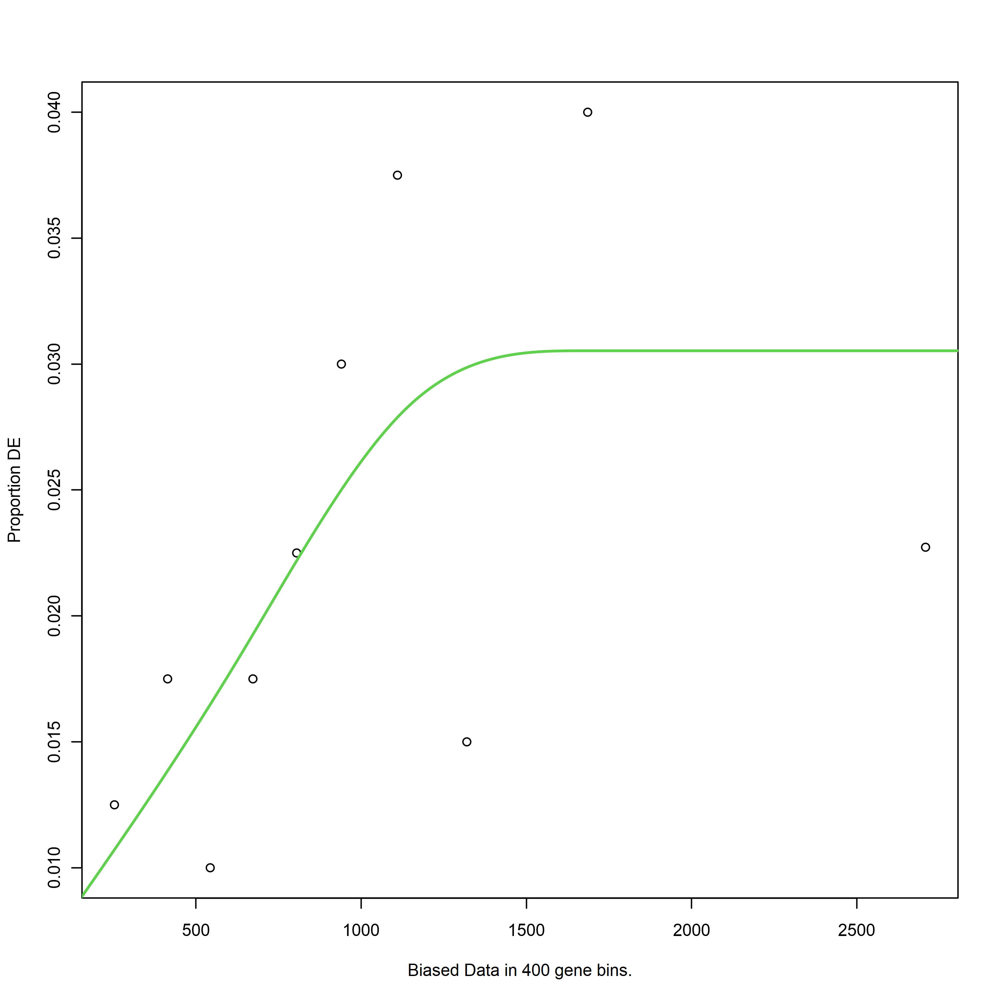

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC3_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


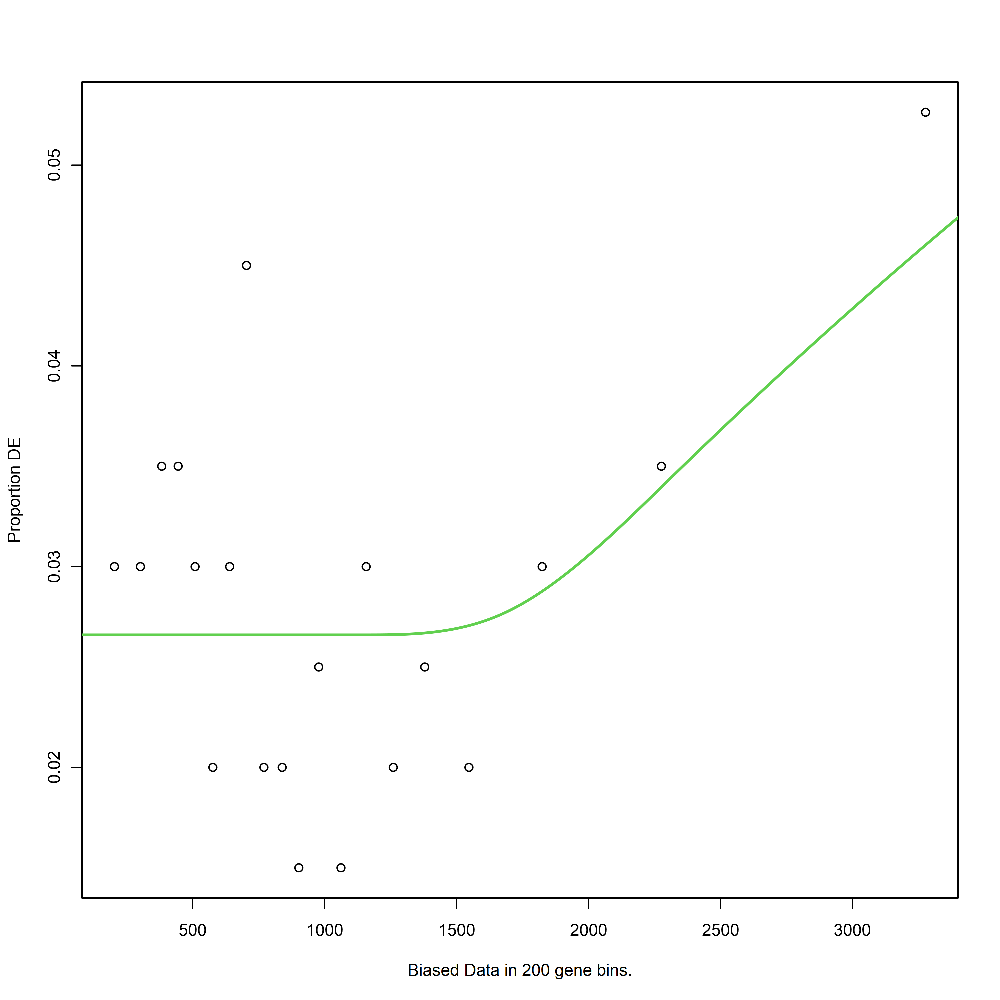

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC3_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


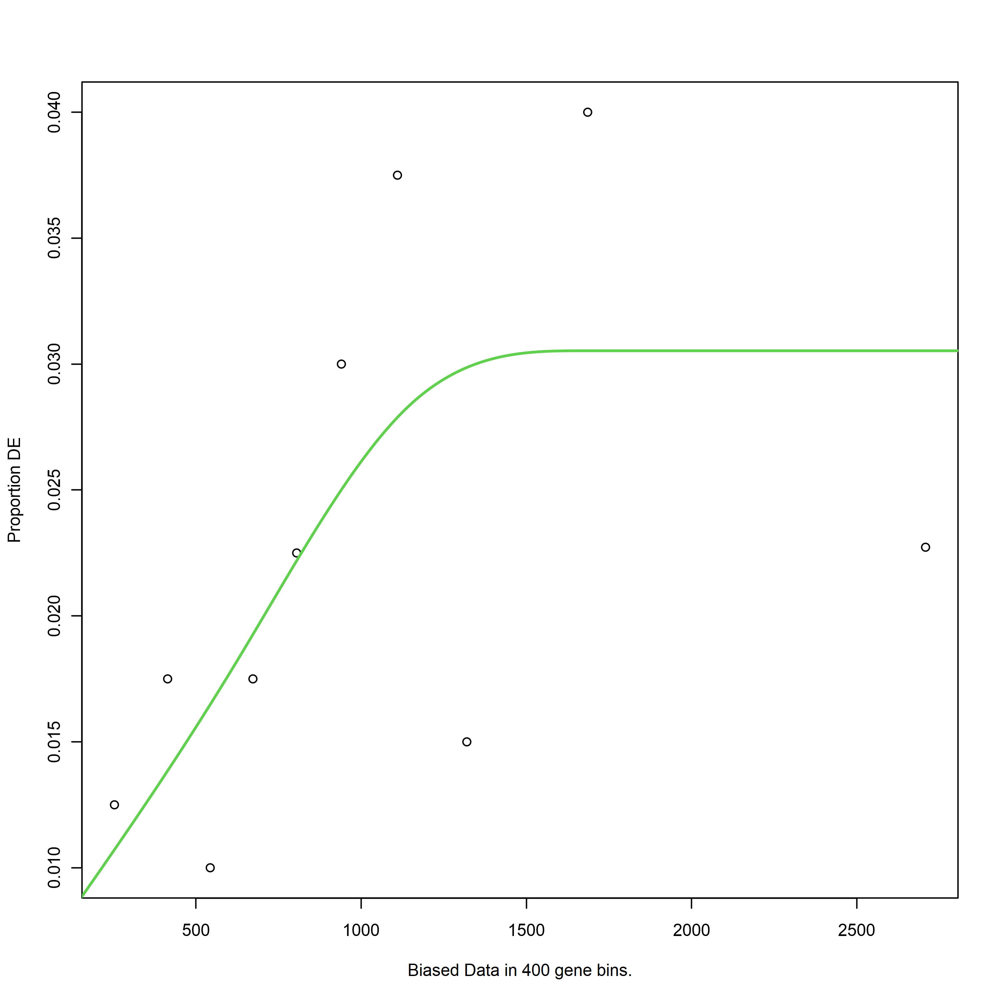

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC3_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


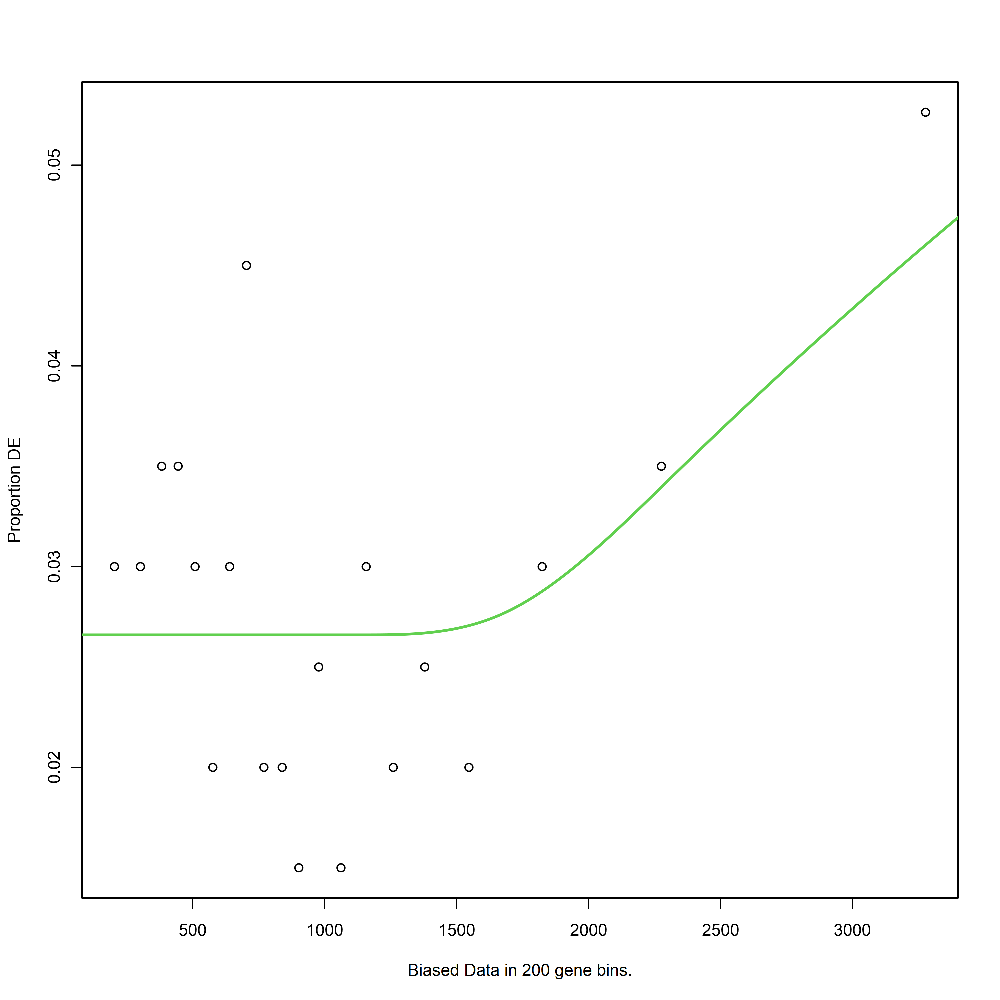

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "LATEvsC3_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


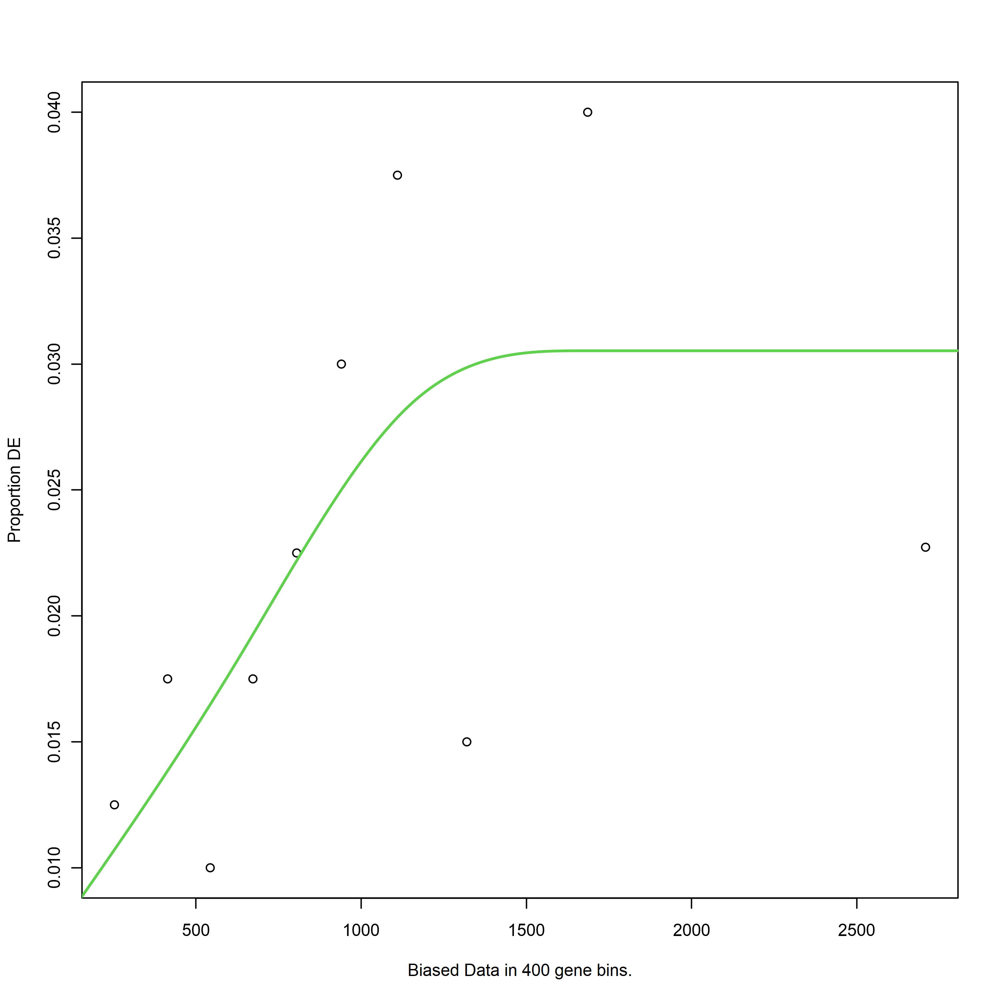

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



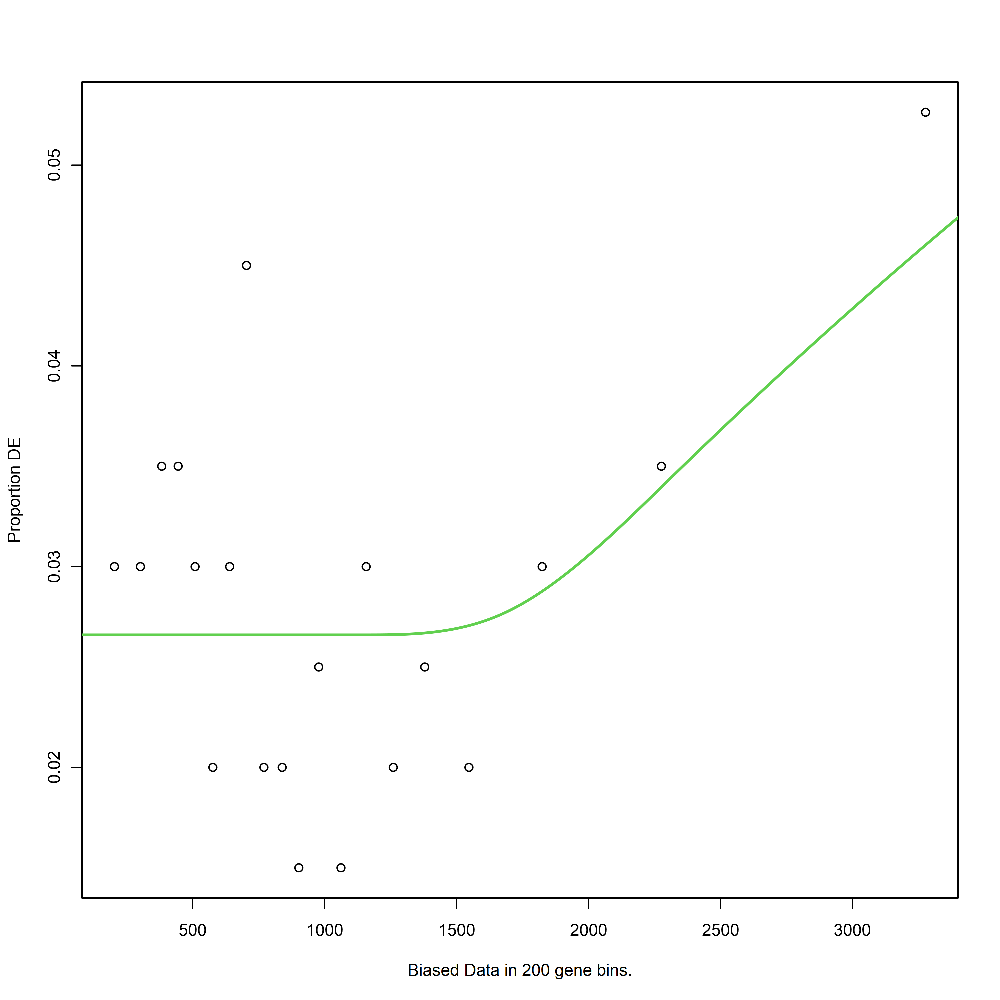

[1] "A2vsA1_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "A2vsA1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


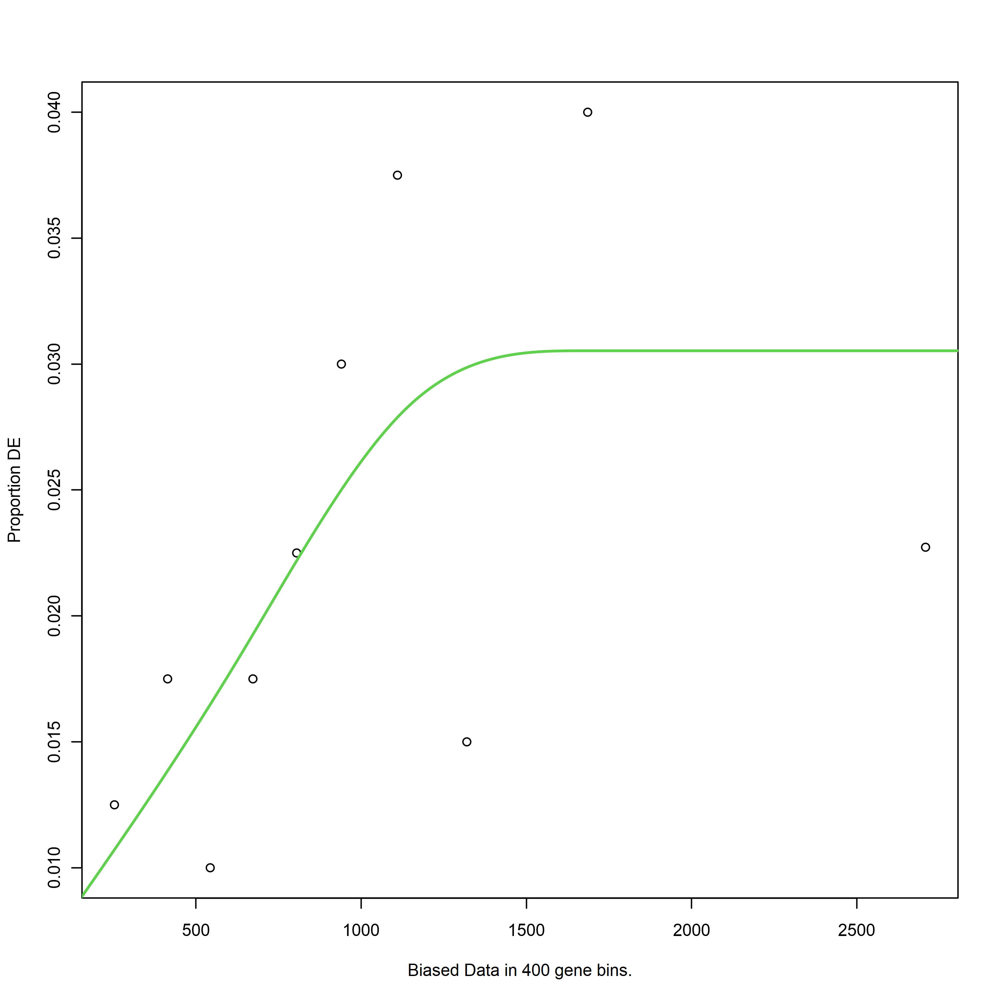

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



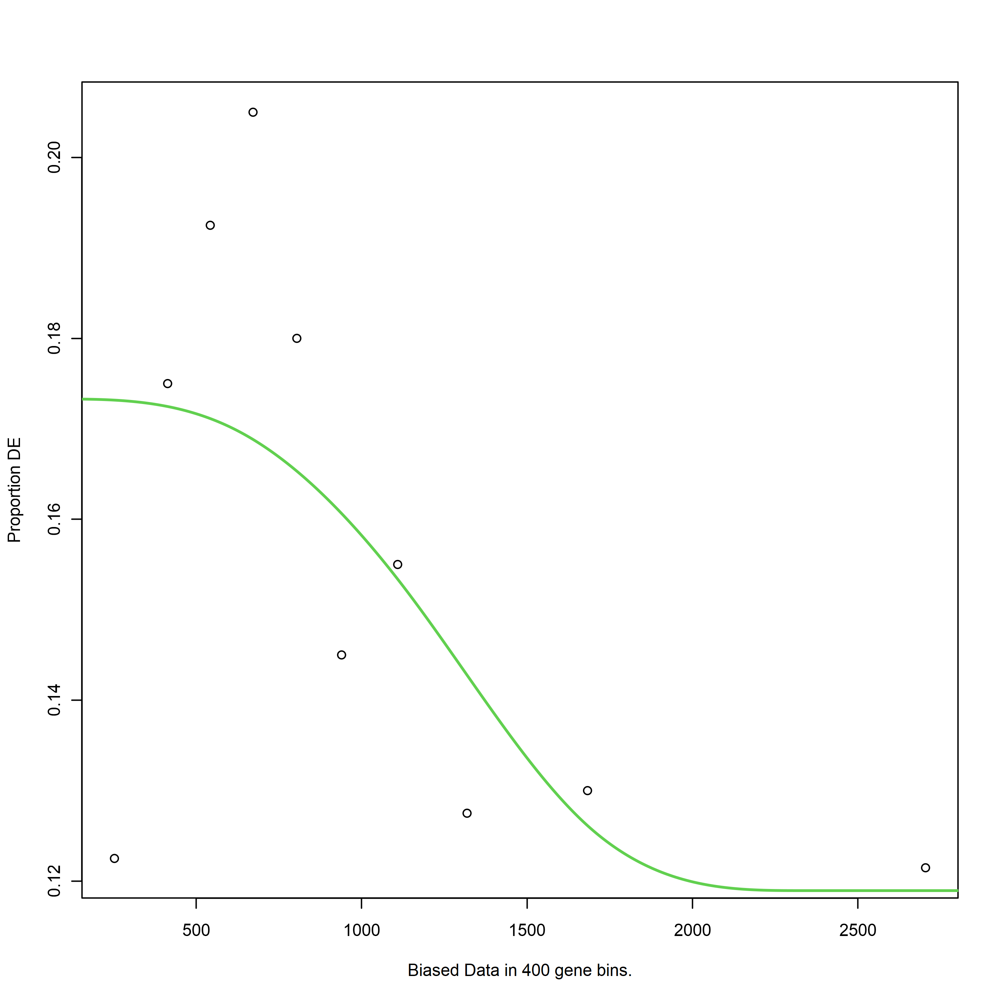

[1] "A2vsA1_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "A2vsA1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


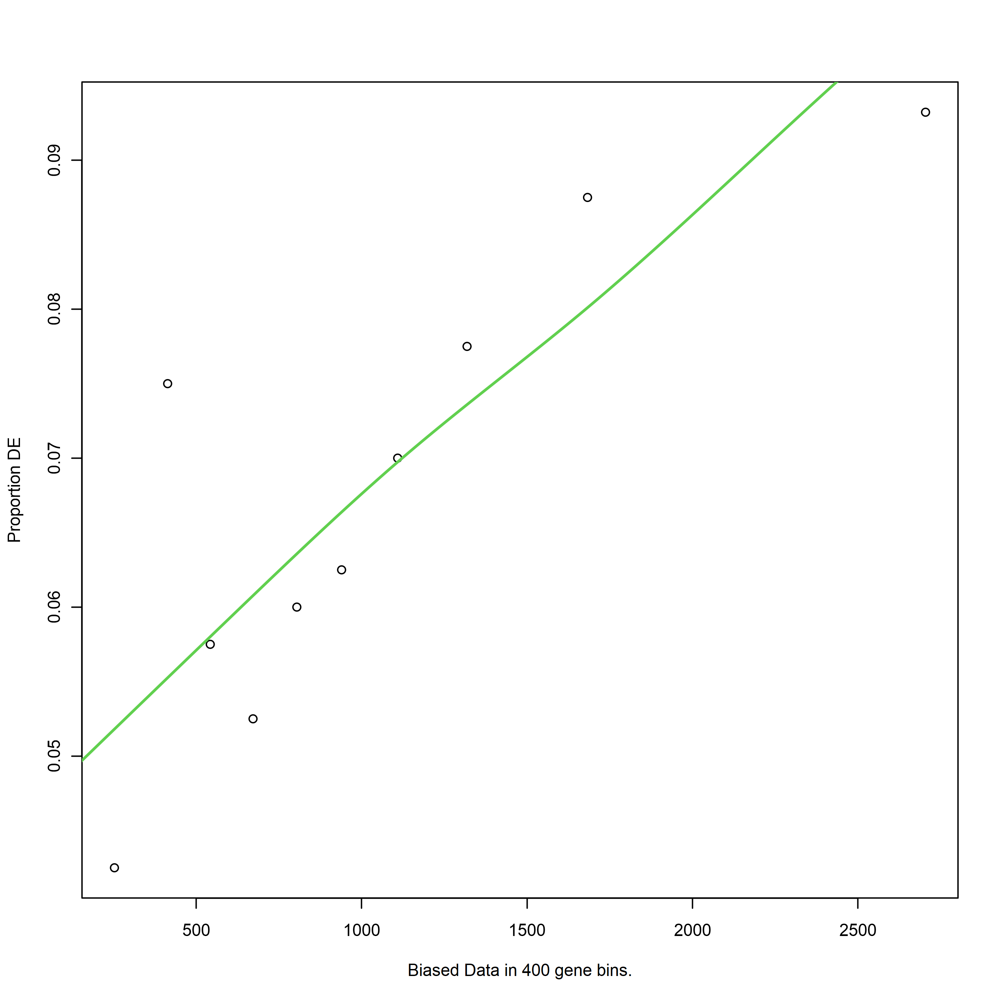

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



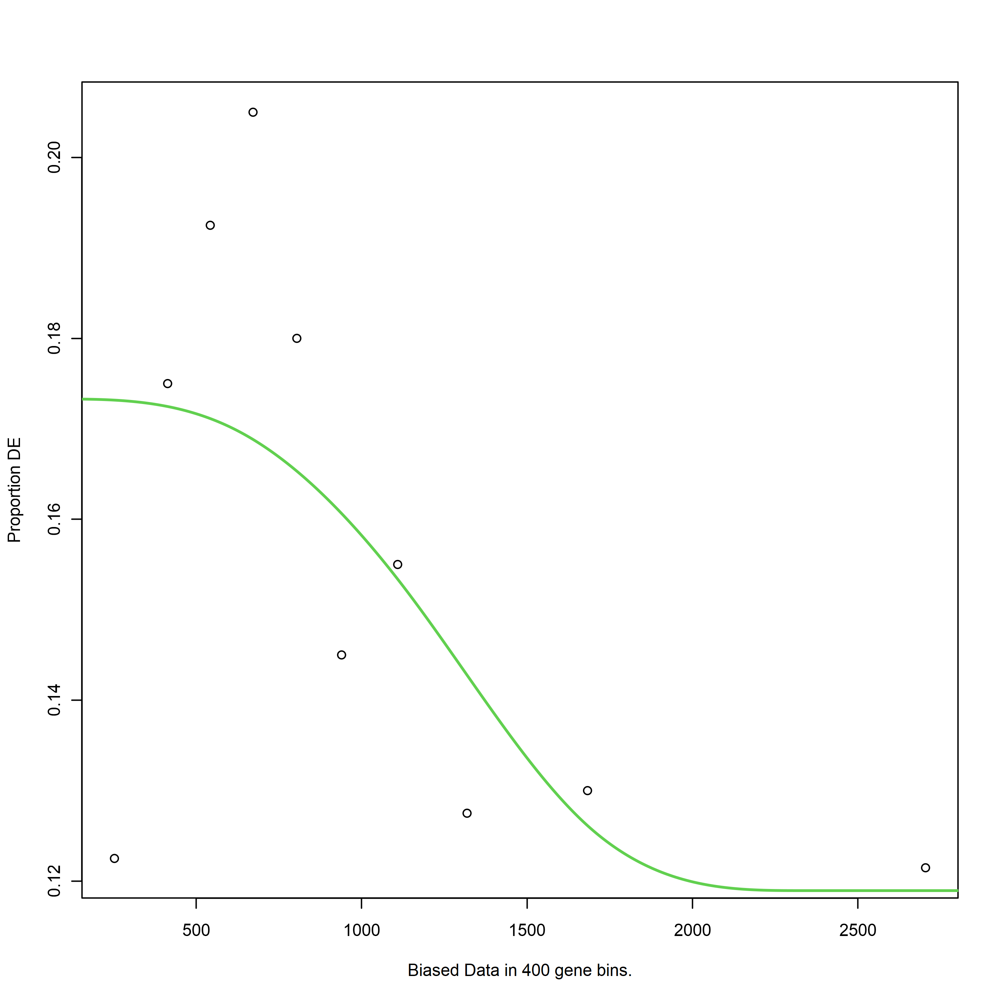

[1] "A2vsA1_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "A2vsA1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


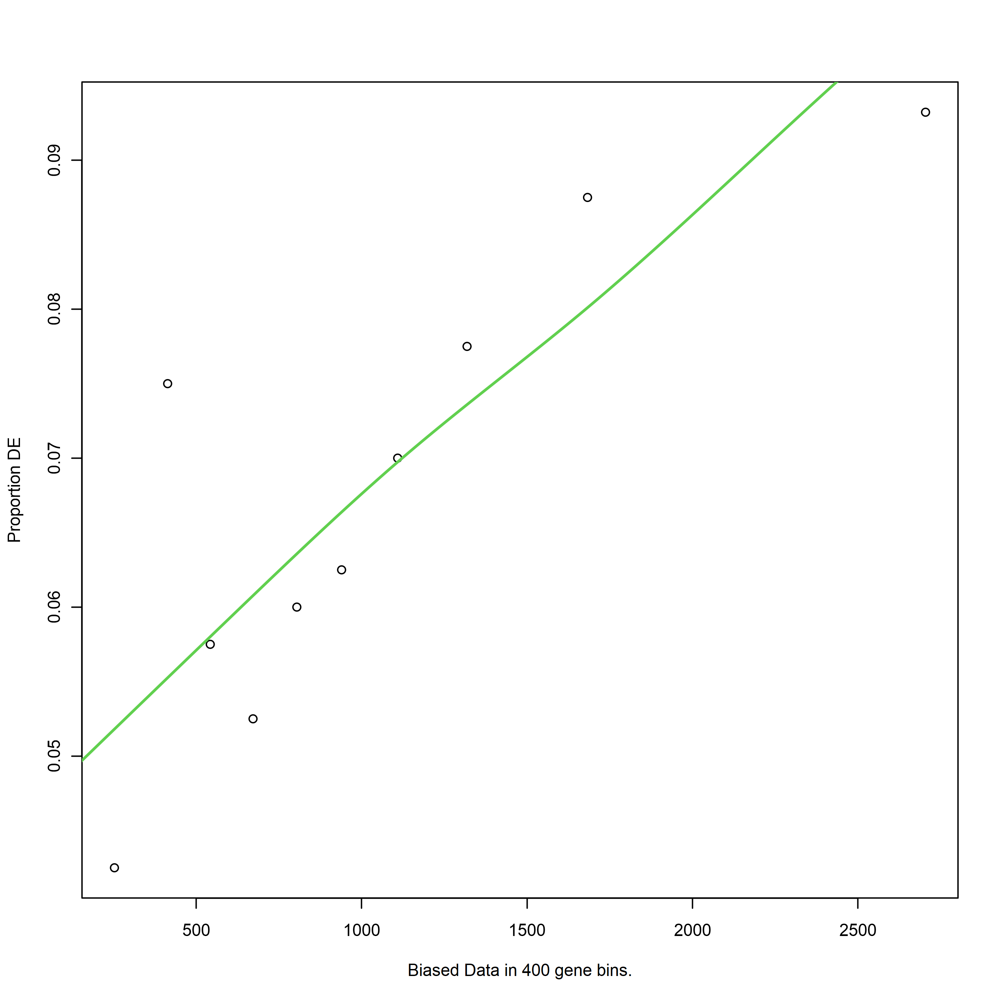

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



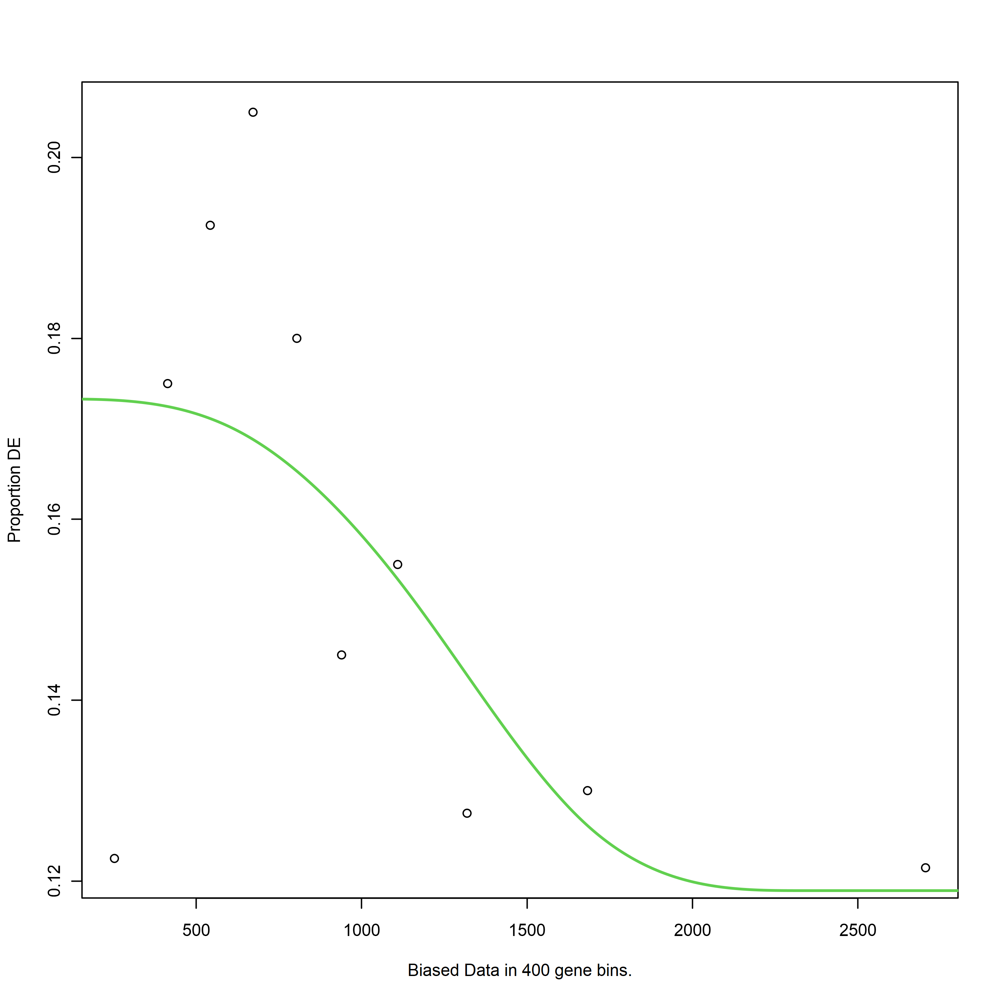

[1] "A2vsA1_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "A2vsA1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


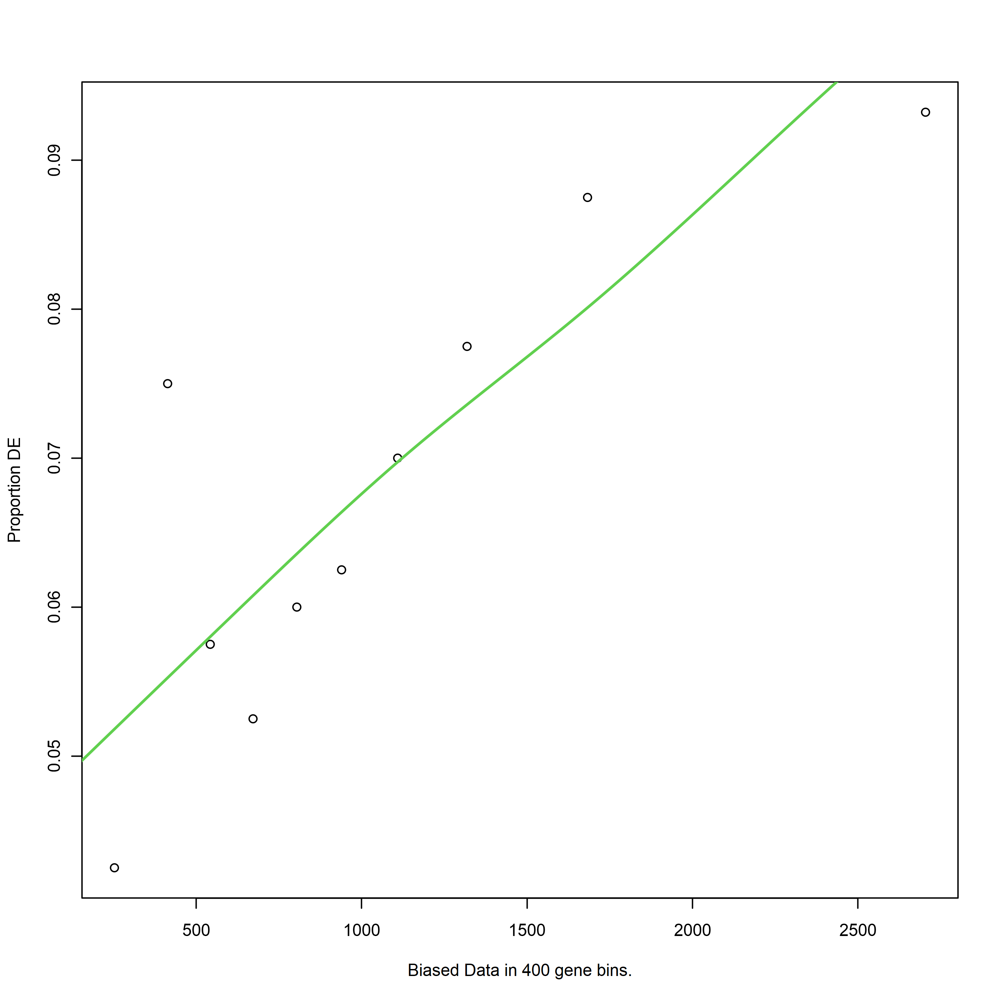

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



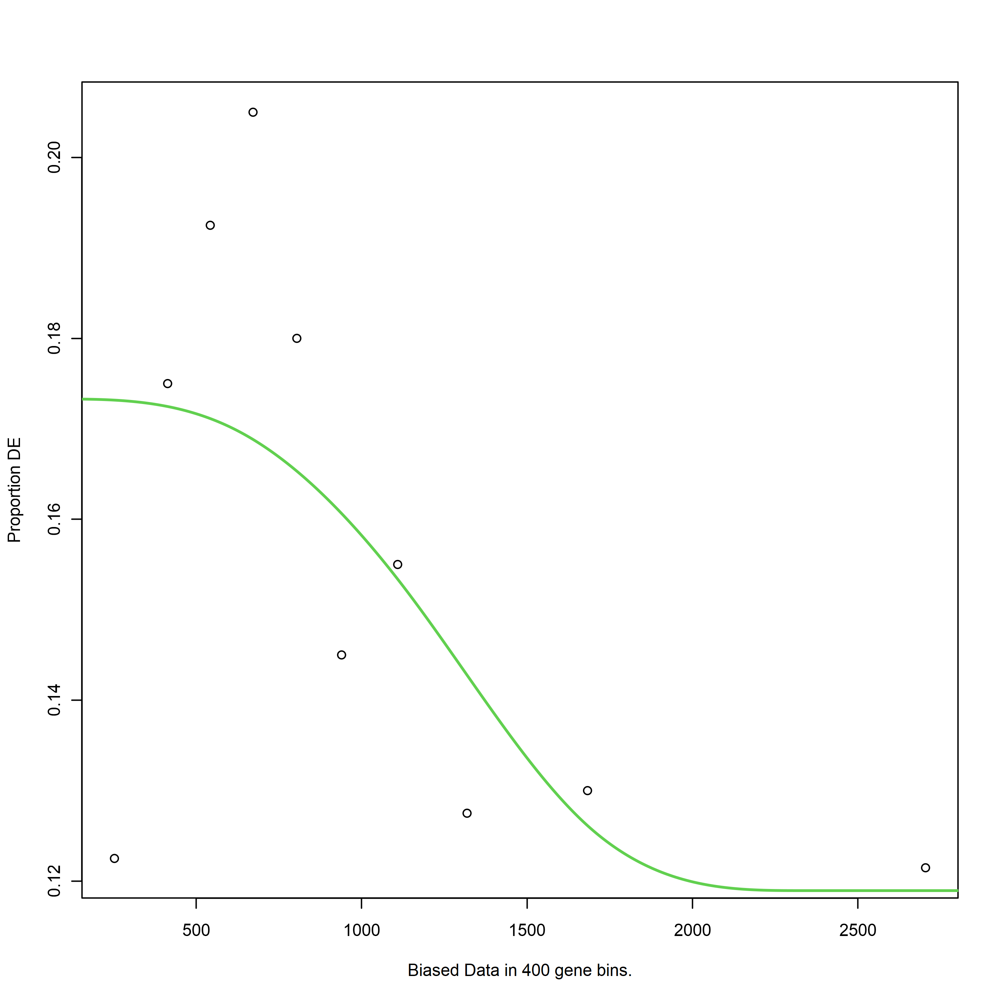

[1] "A3vsA1_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "A3vsA1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


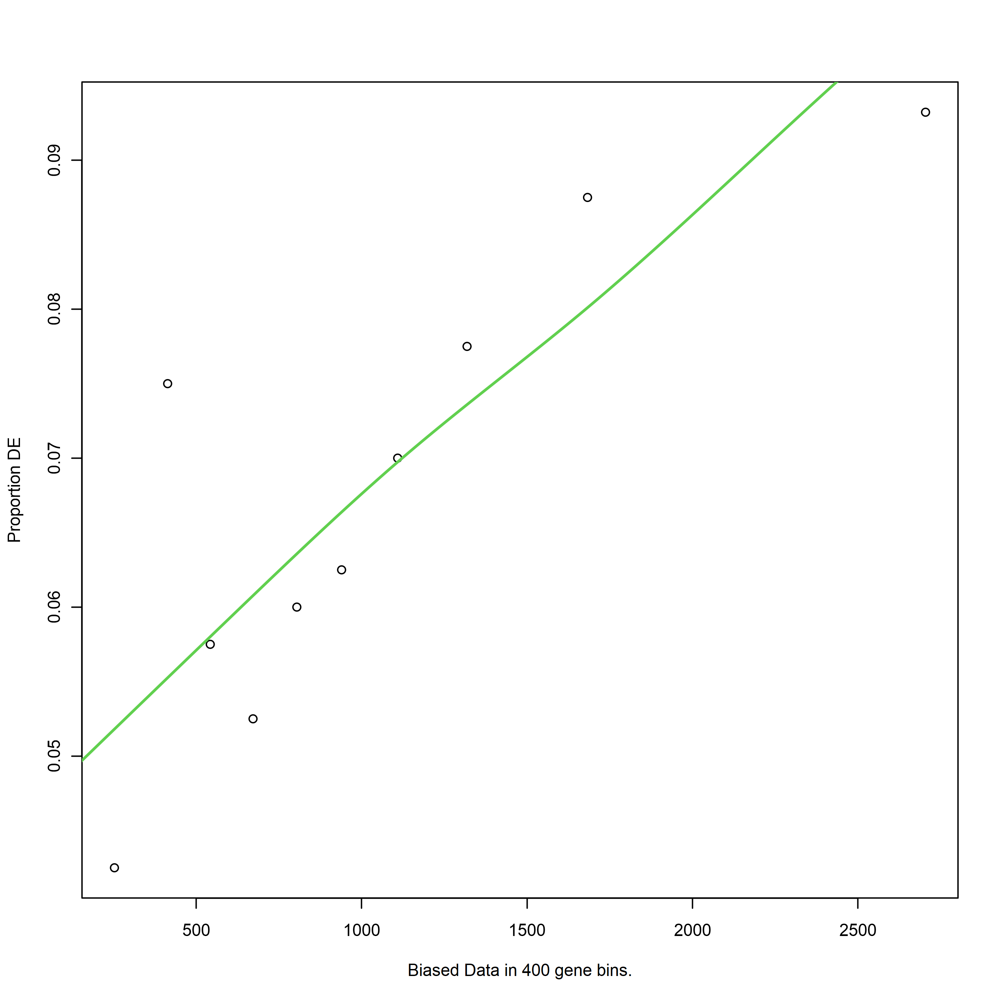

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



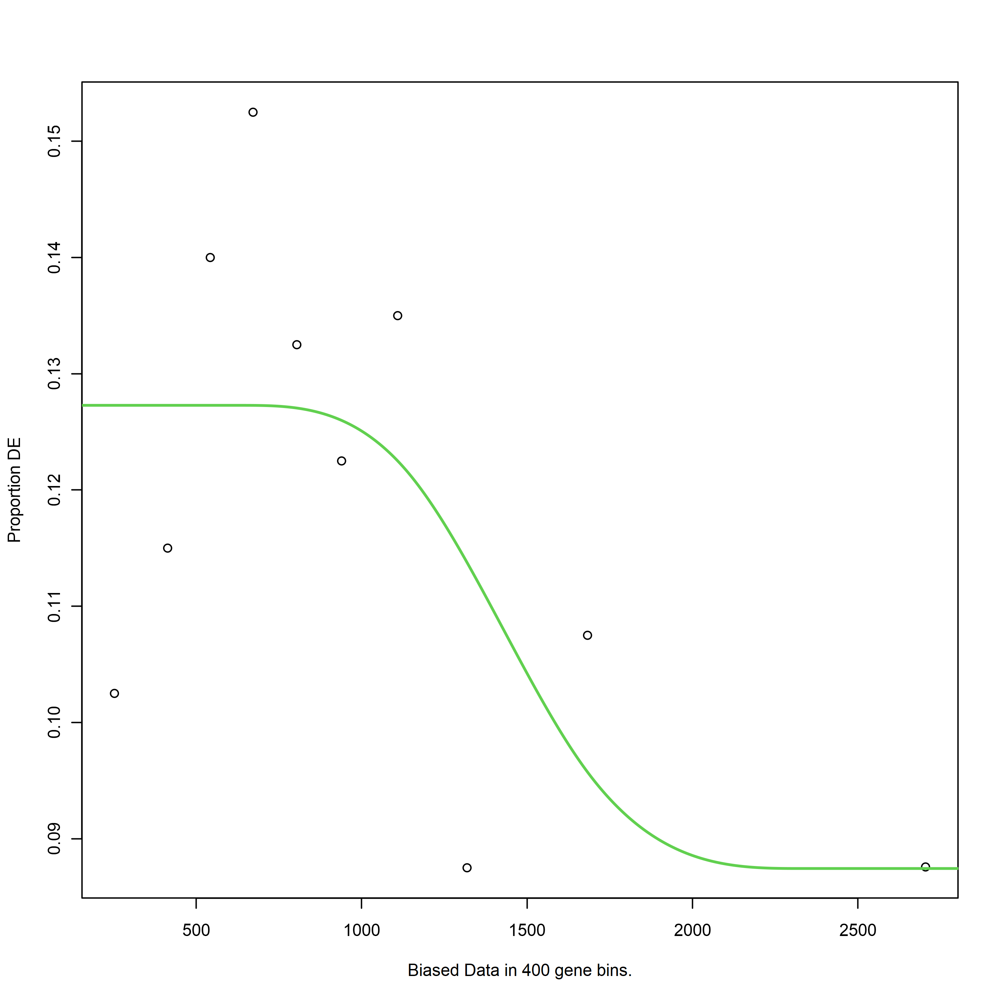

[1] "A3vsA1_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "A3vsA1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


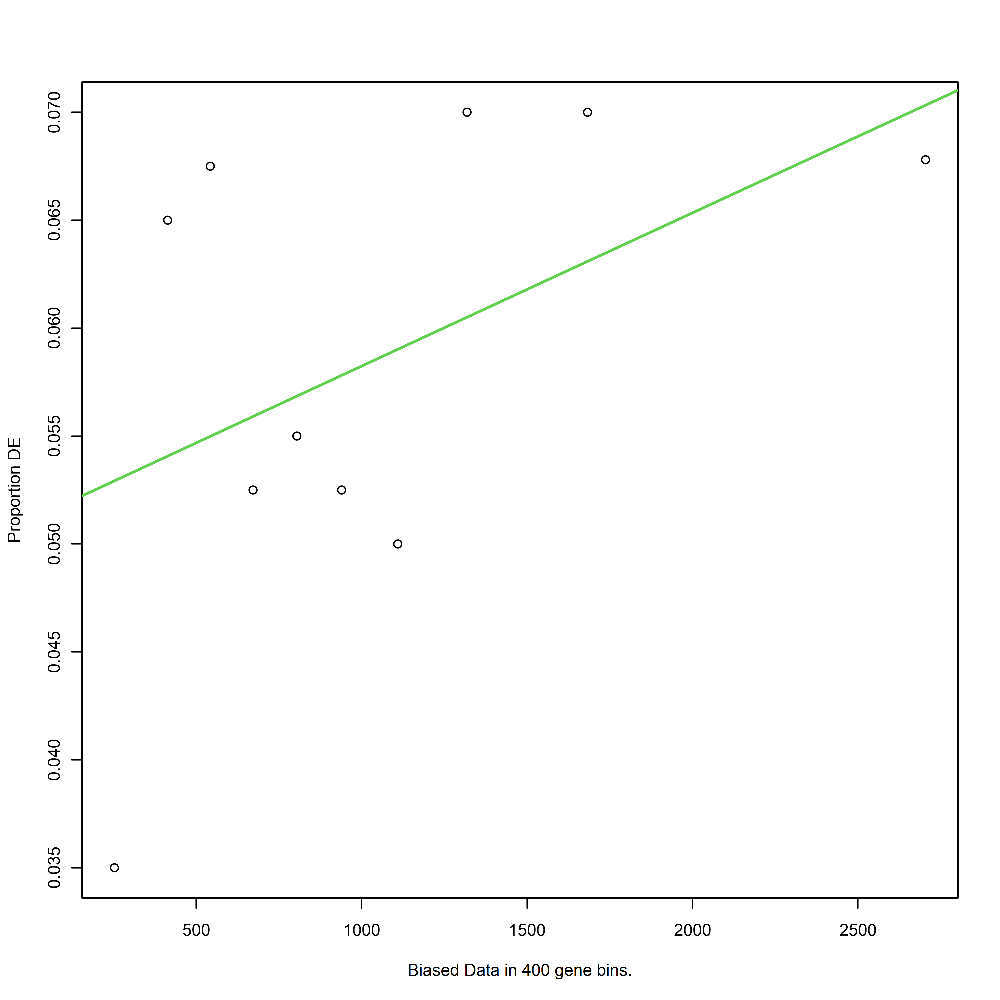

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



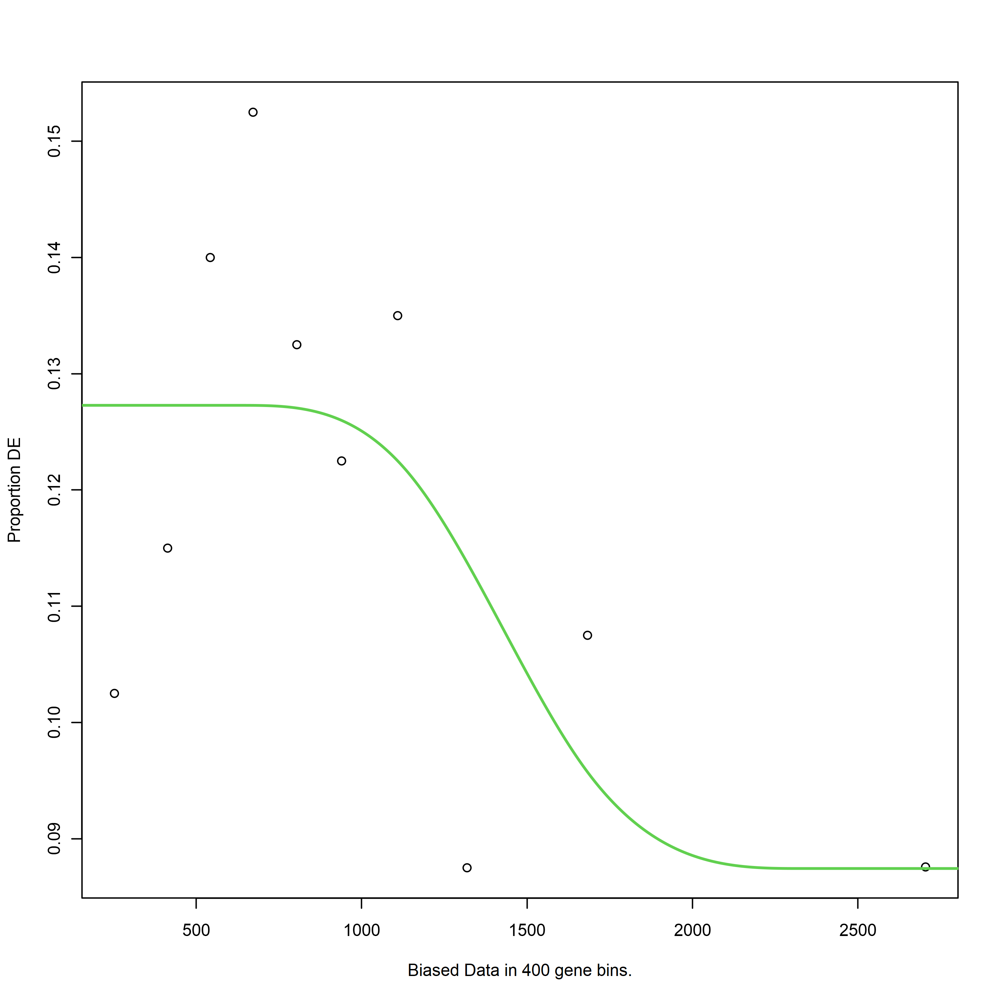

[1] "A3vsA1_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "A3vsA1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


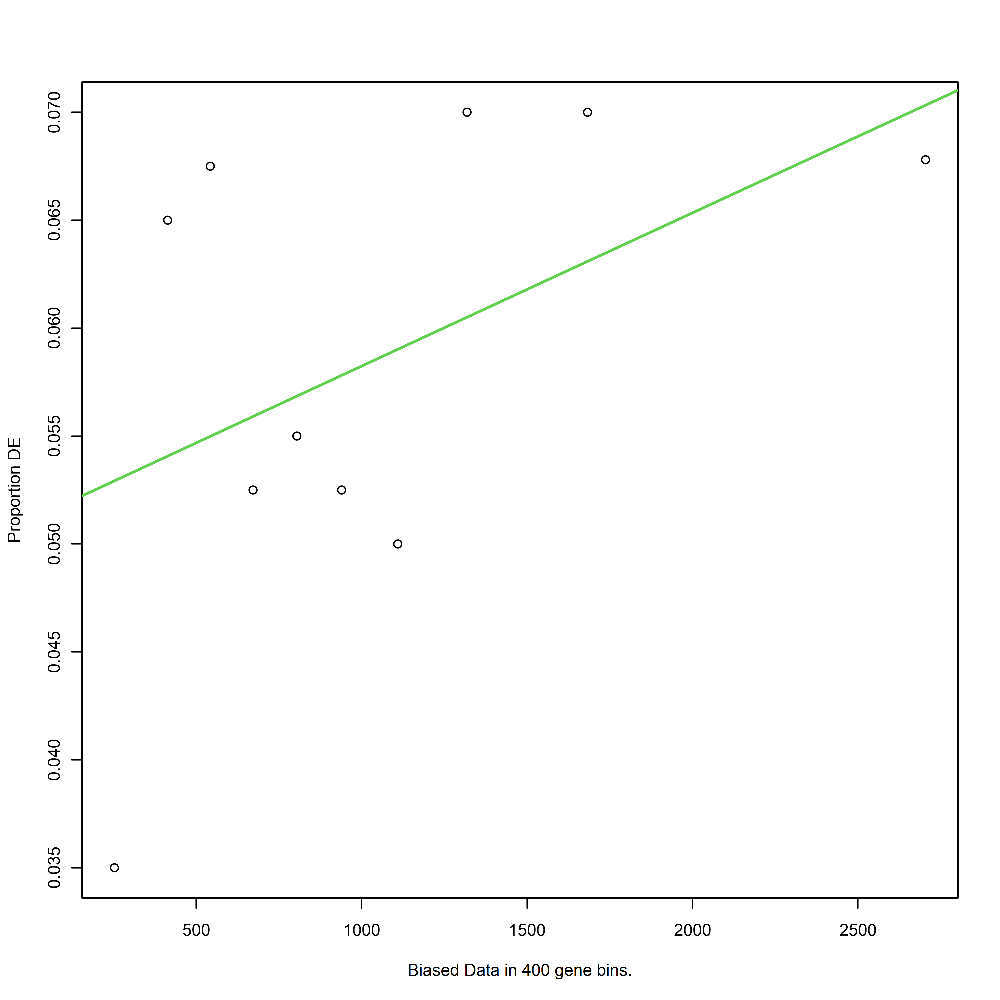

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



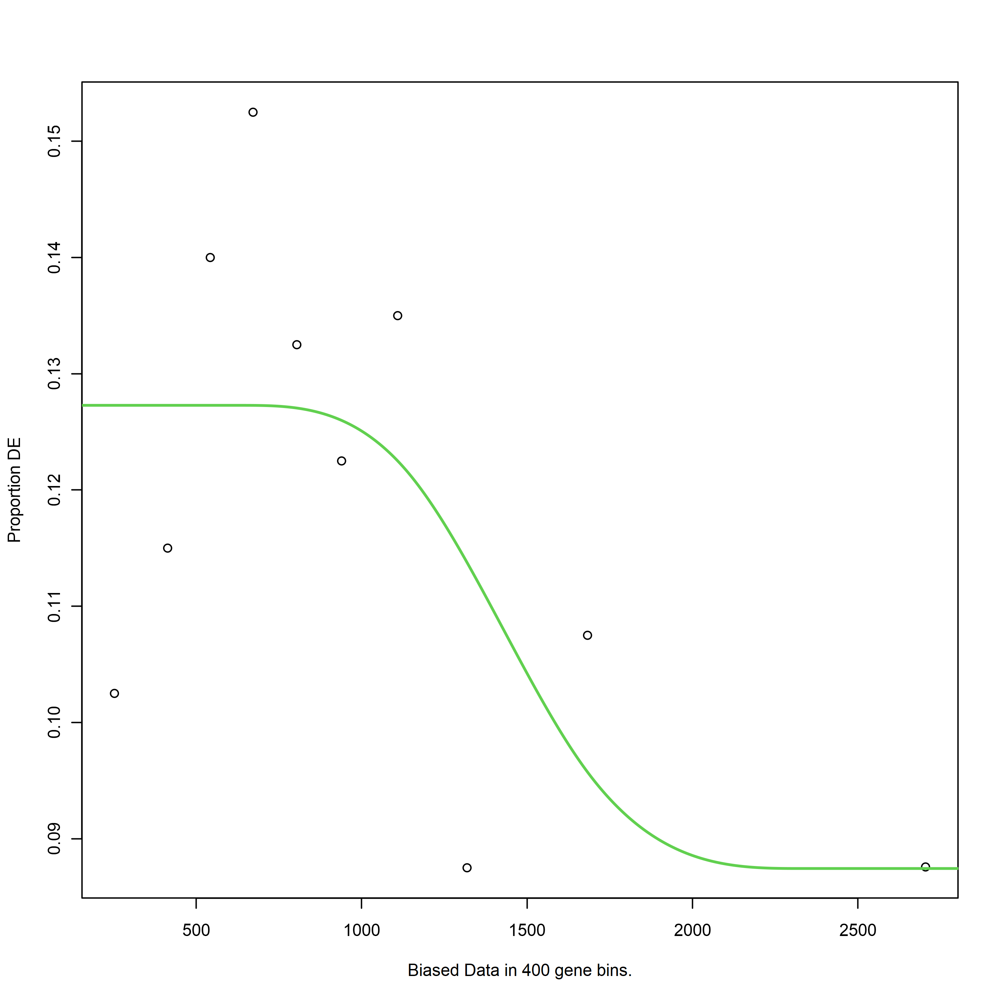

[1] "A3vsA1_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "A3vsA1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


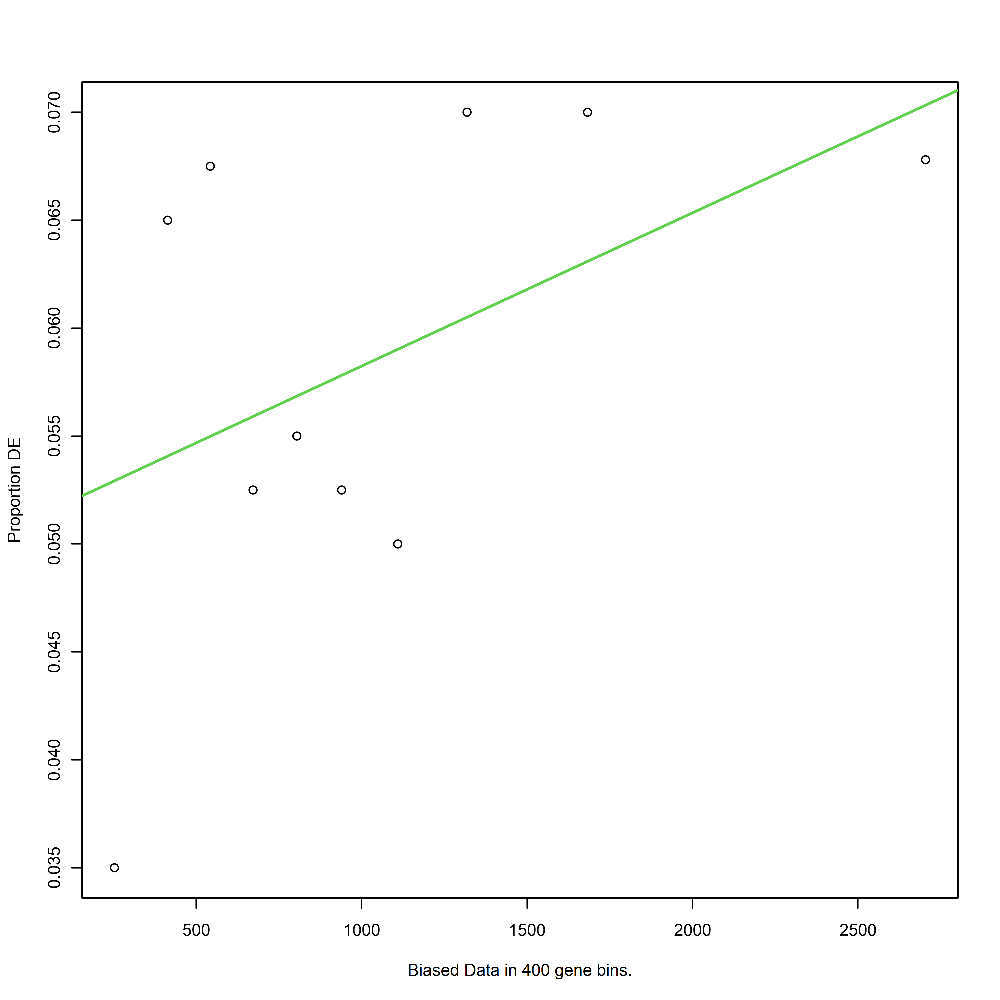

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



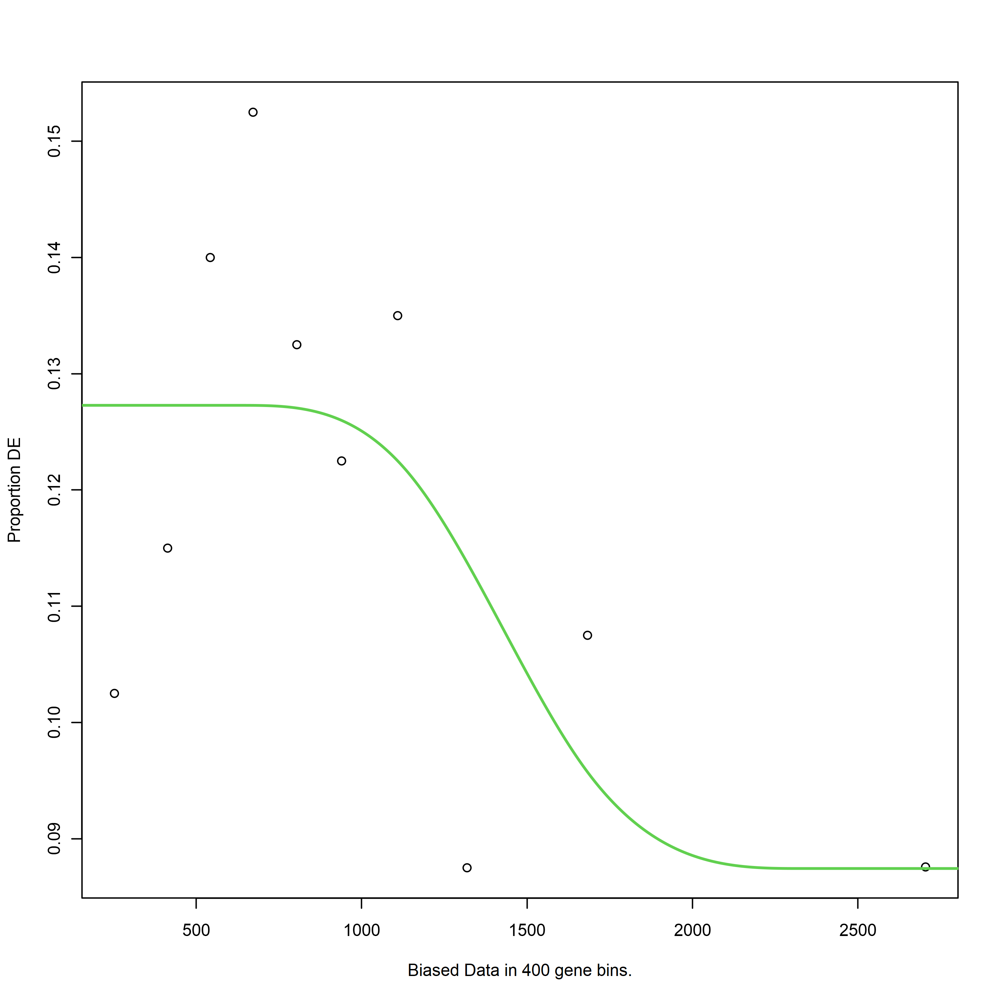

[1] "A3vsA2_rna"
[1] "down"


Using manually entered categories.

For 41 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "A3vsA2_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


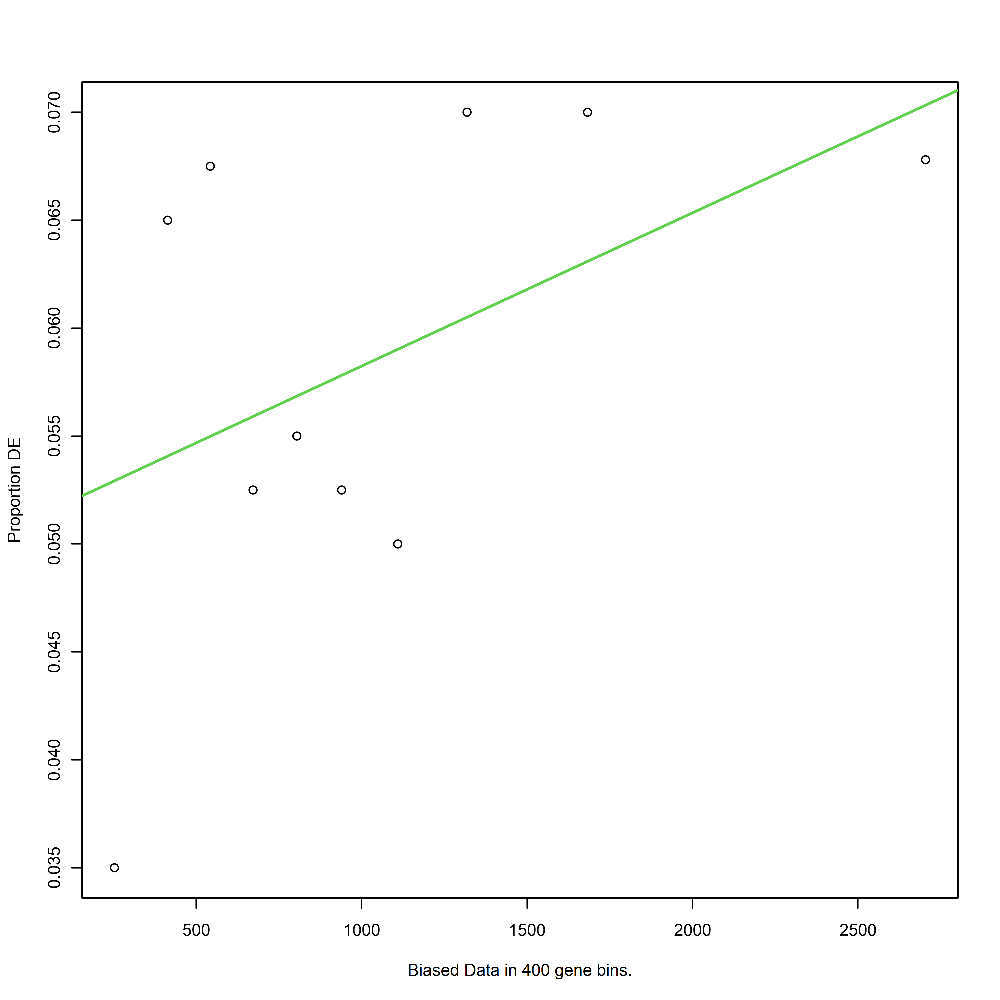

Using manually entered categories.

For 41 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



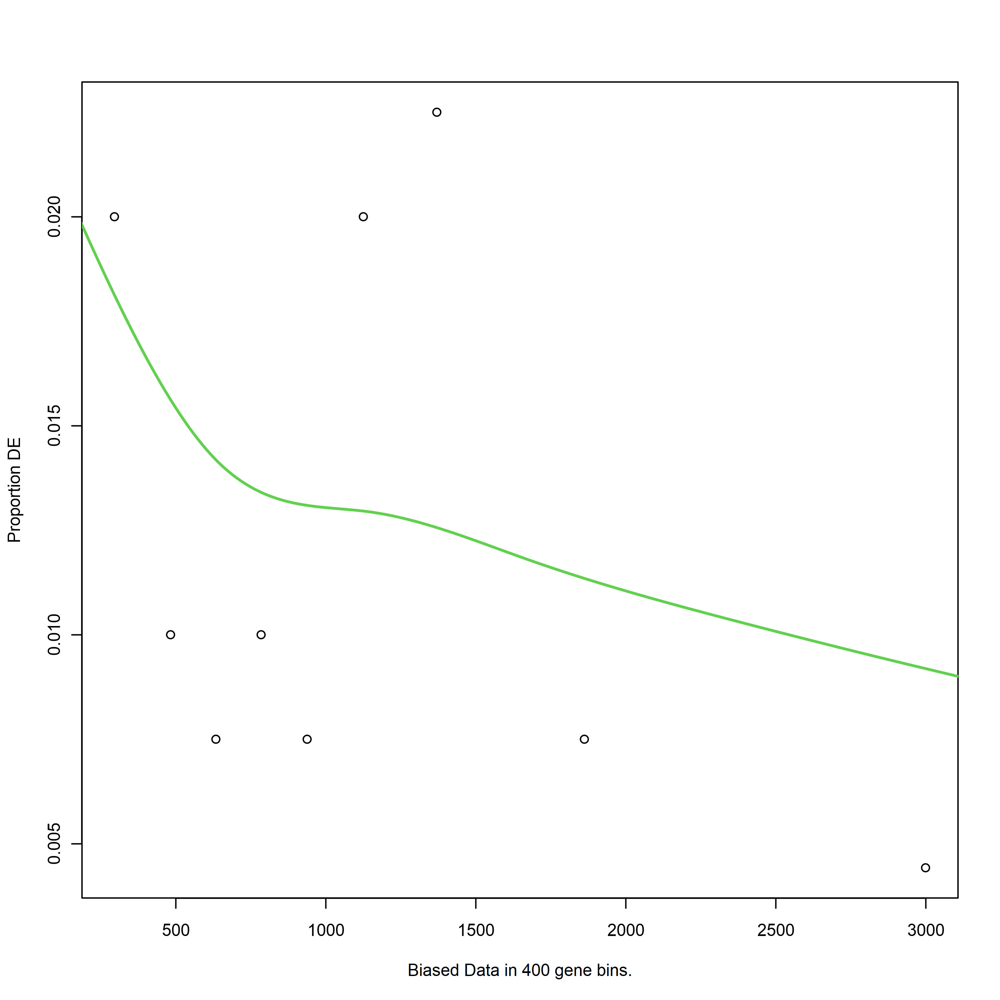

[1] "A3vsA2_rna"
[1] "down"


Using manually entered categories.

For 41 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "A3vsA2_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


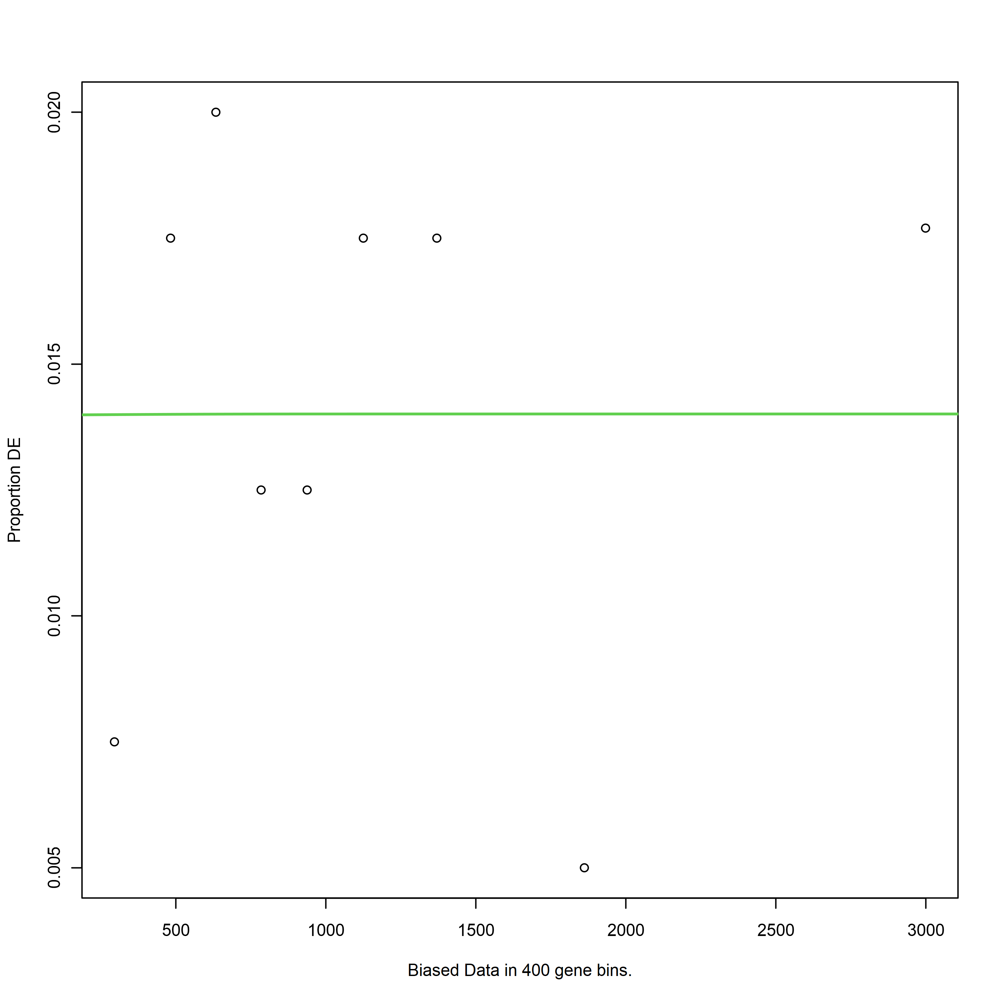

Using manually entered categories.

For 41 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



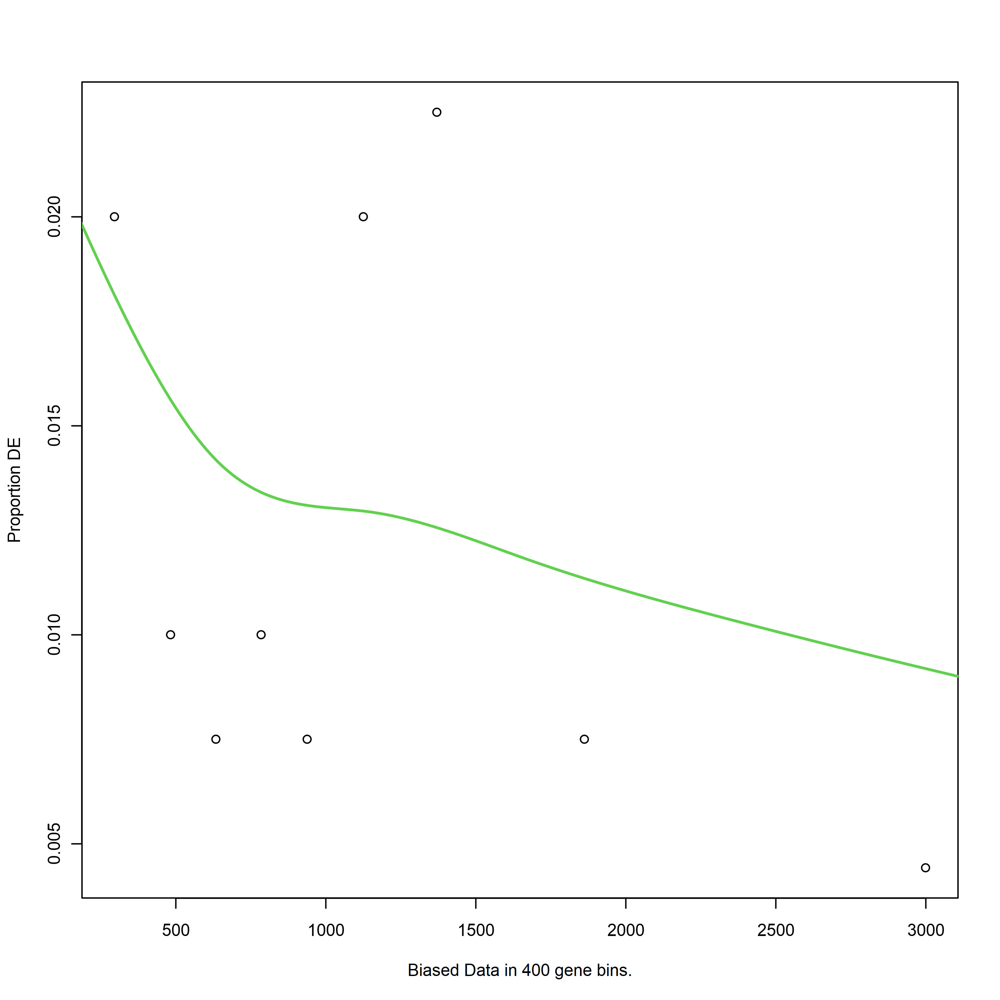

[1] "A3vsA2_rna"
[1] "down"


Using manually entered categories.

For 41 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "A3vsA2_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


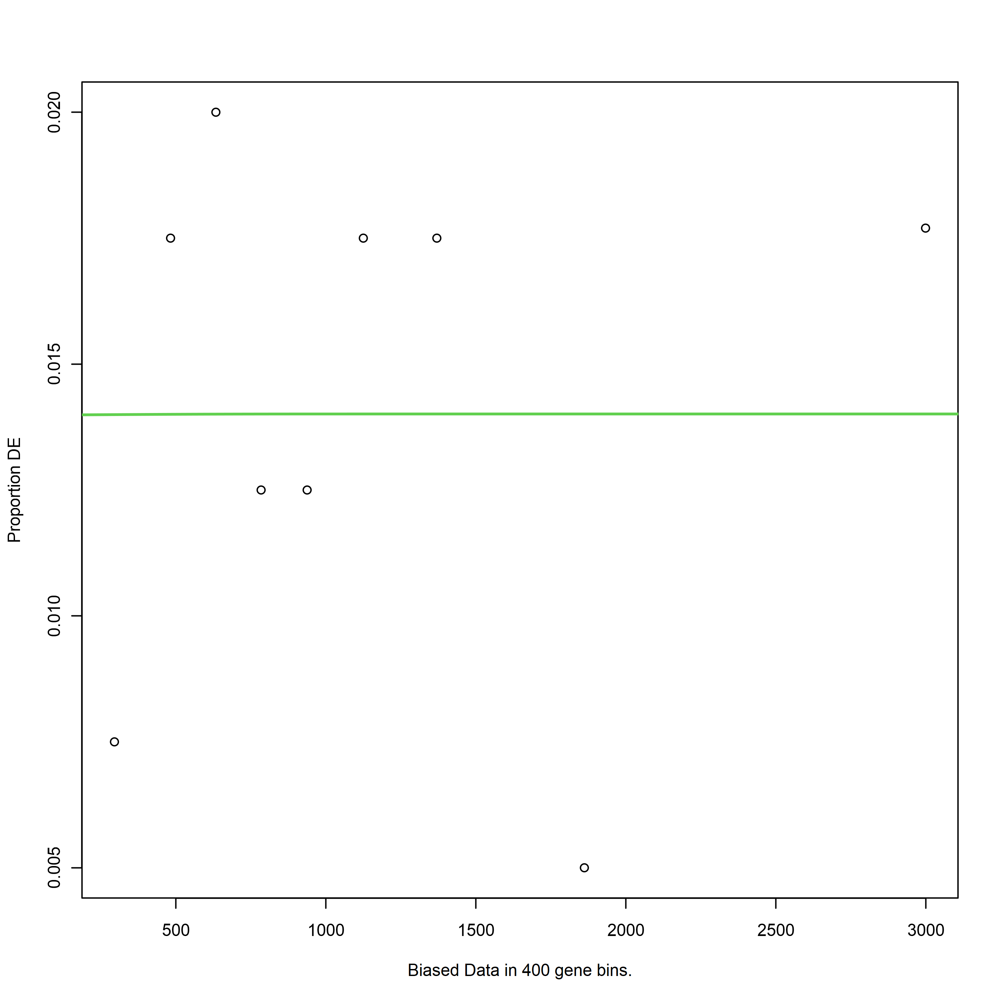

Using manually entered categories.

For 41 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



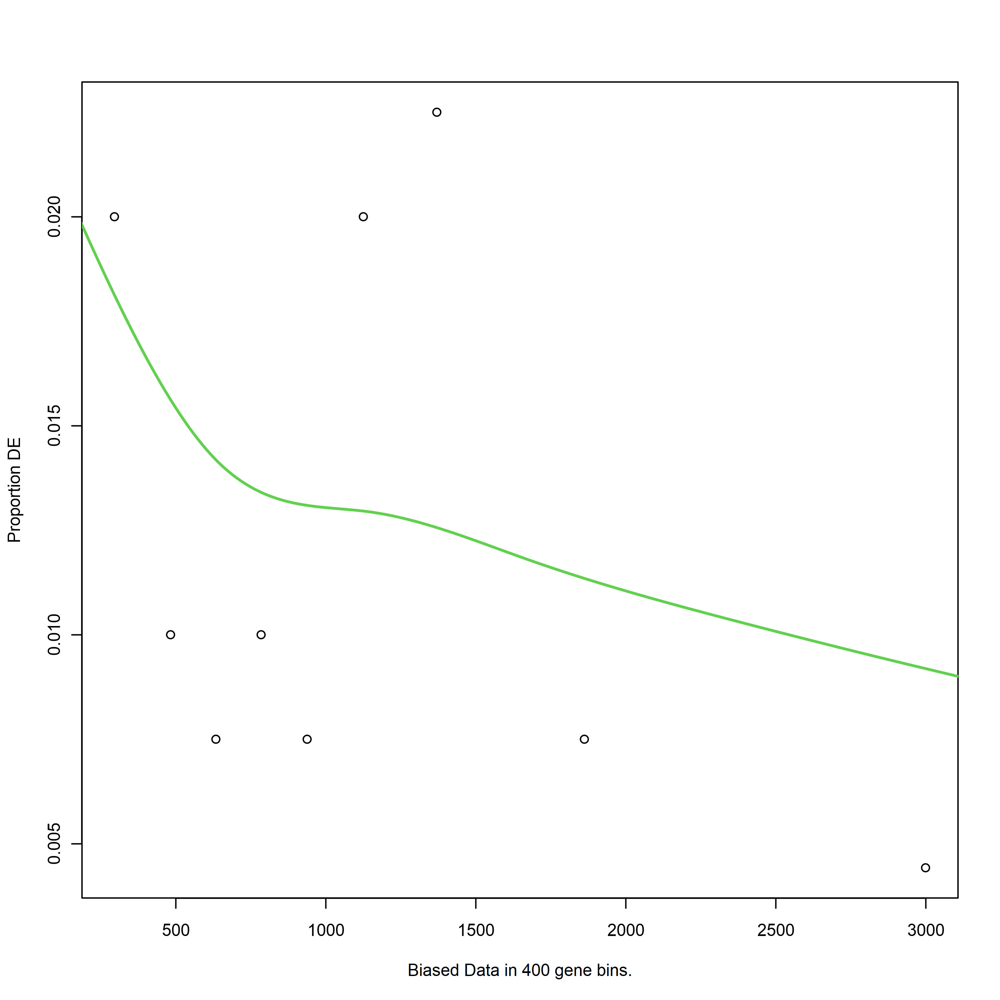

[1] "A3vsA2_rna"
[1] "down"


Using manually entered categories.

For 41 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "A3vsA2_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


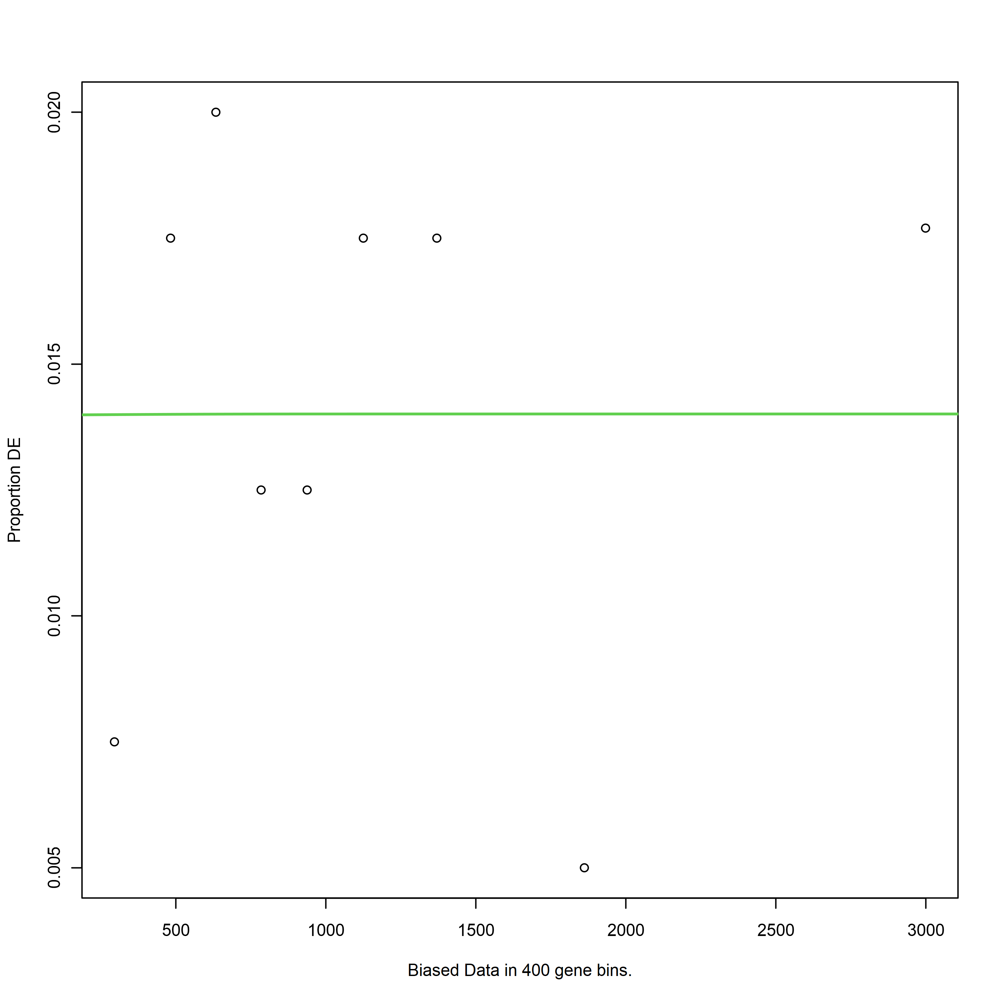

Using manually entered categories.

For 41 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C1vsA1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


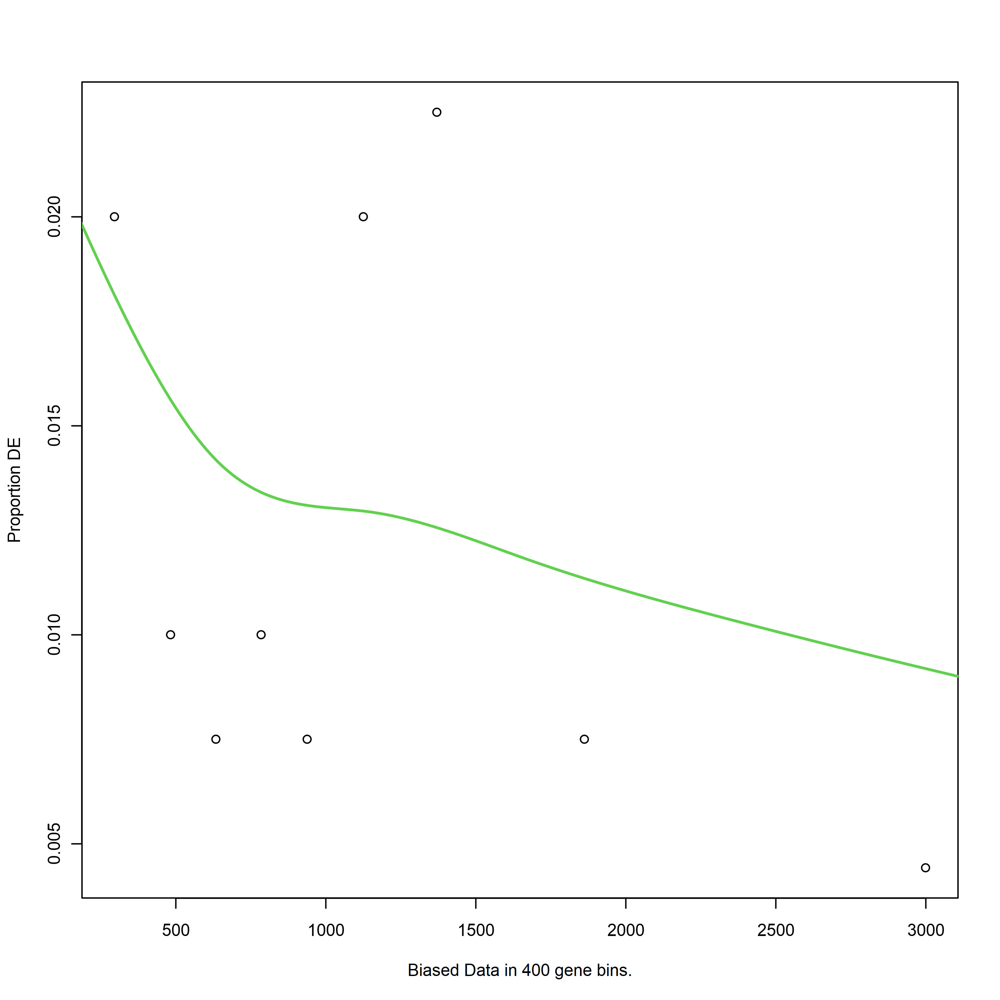

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C1vsA1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


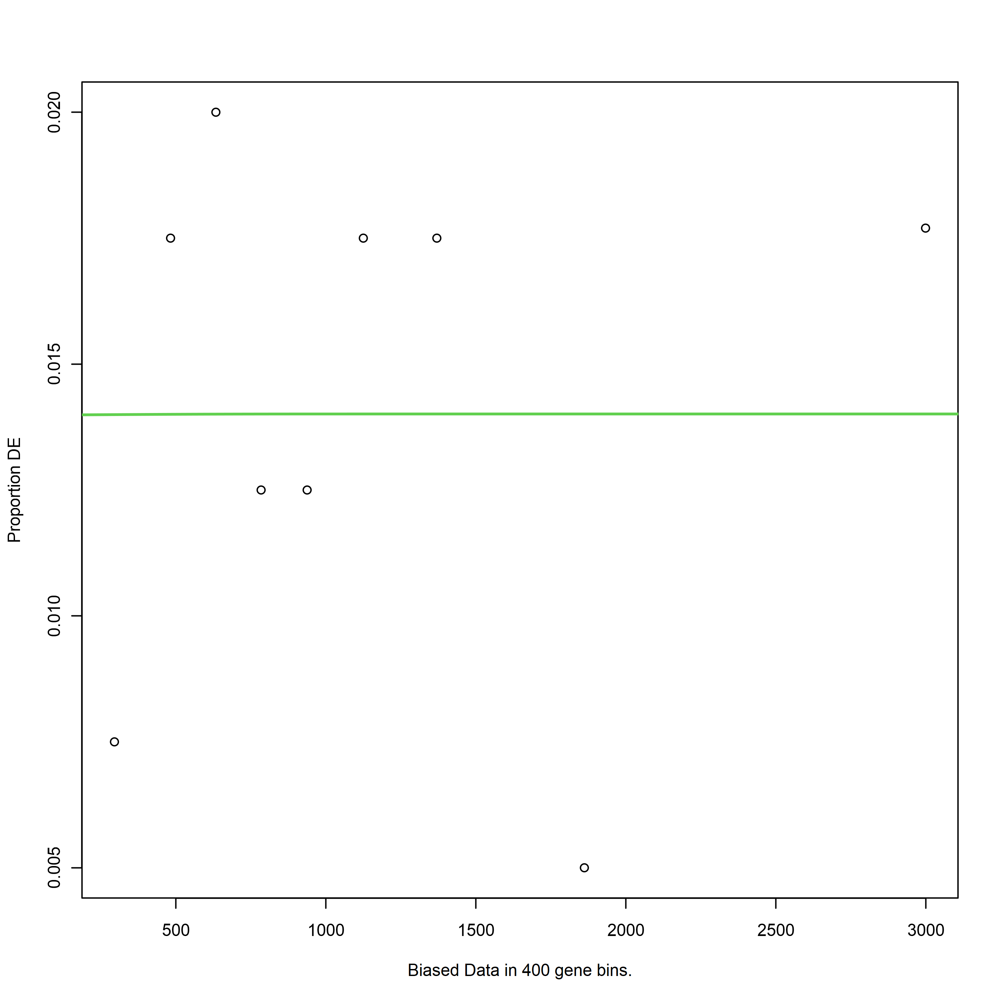

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C1vsA1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


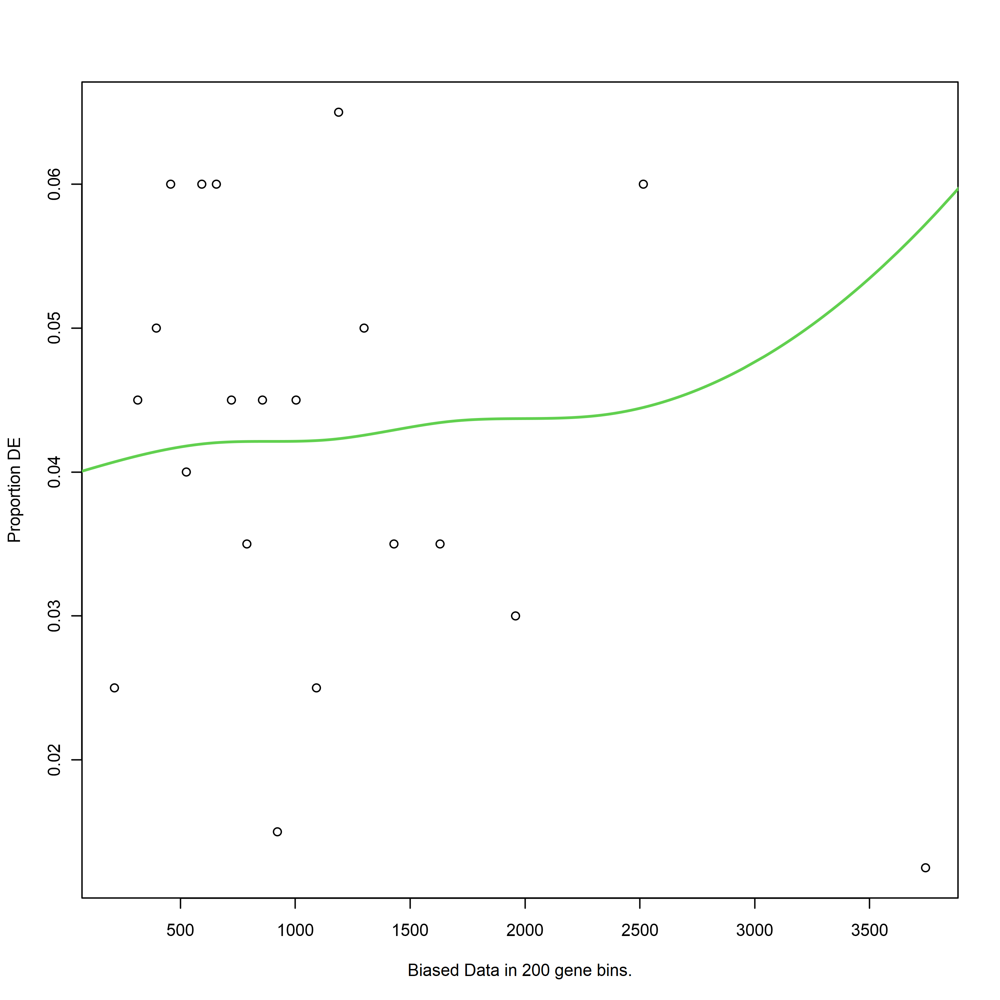

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C1vsA1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


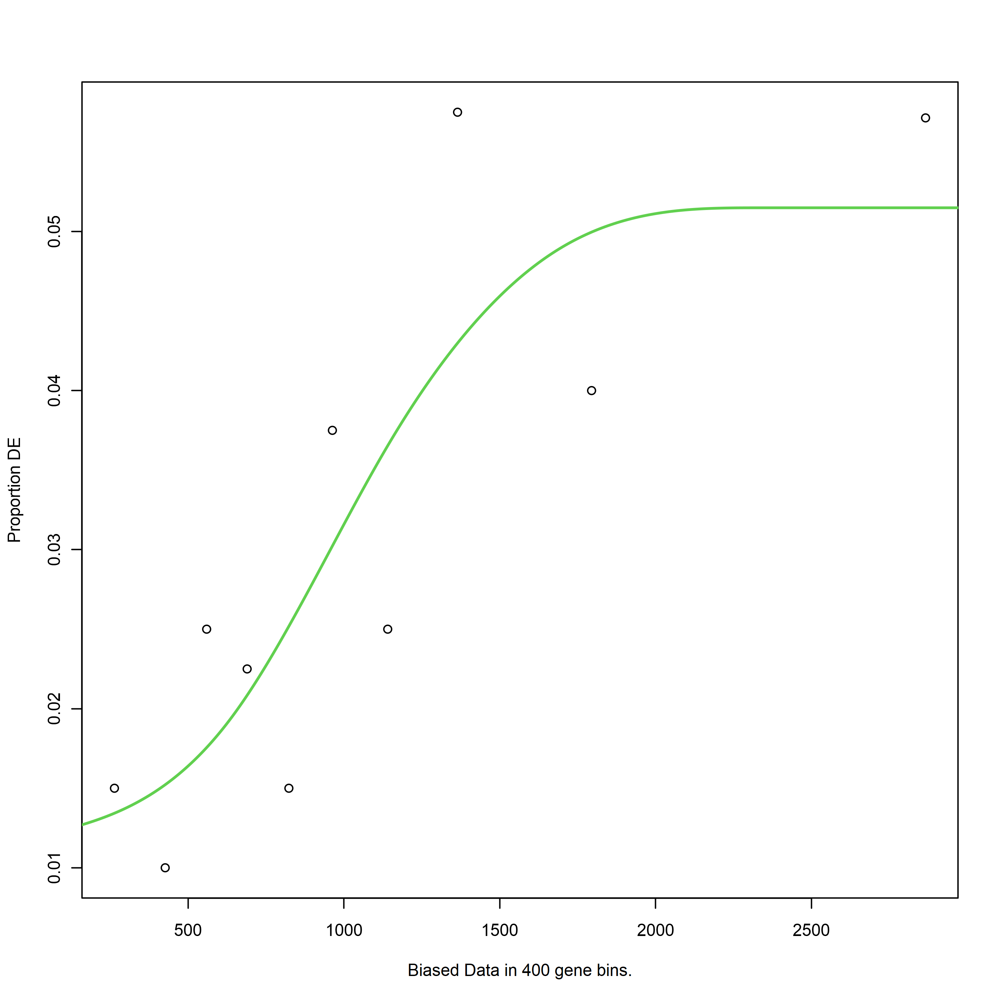

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C1vsA1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


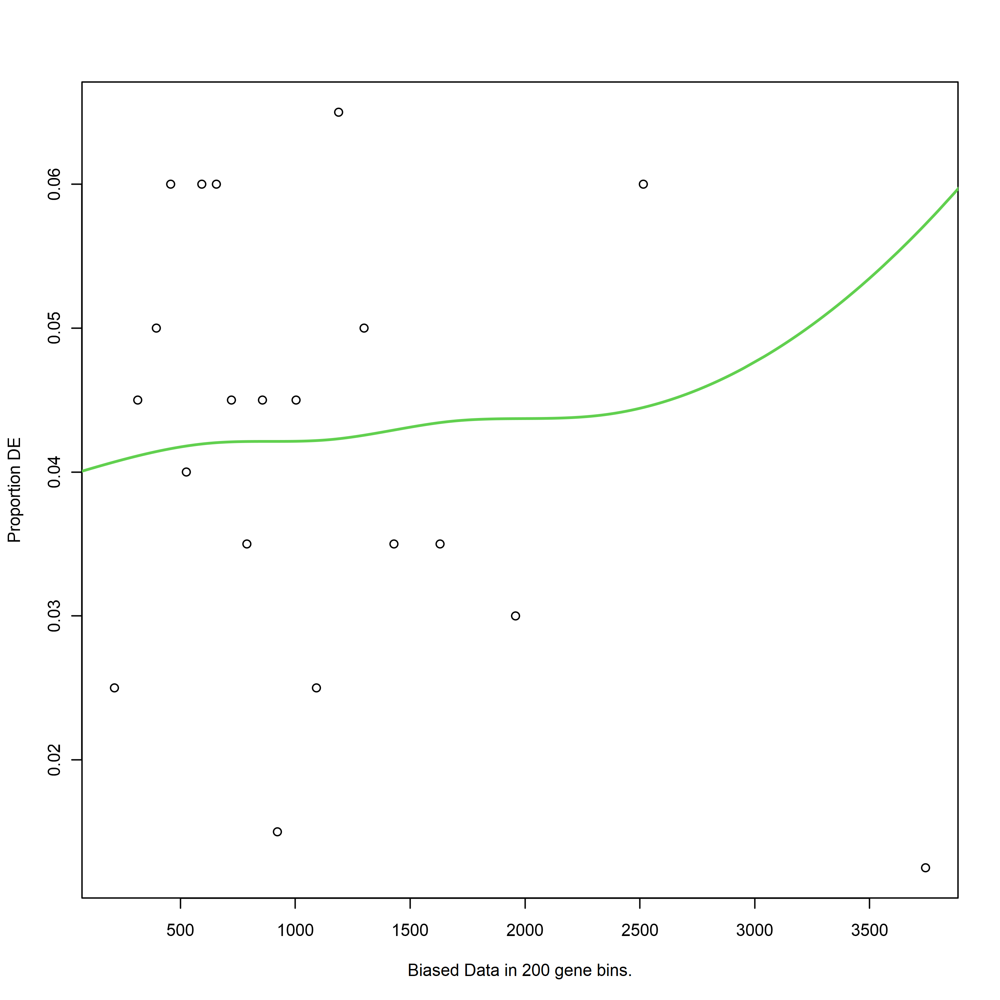

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C1vsA1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


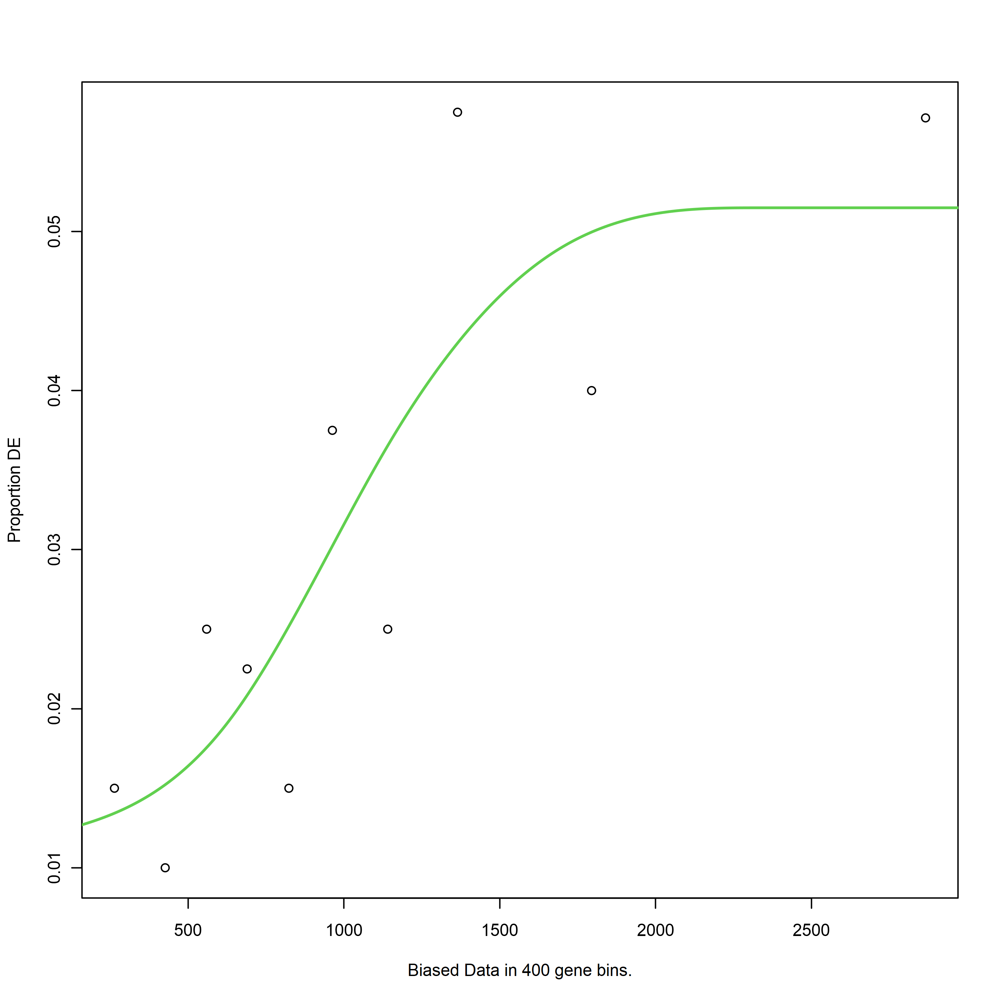

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C1vsA1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


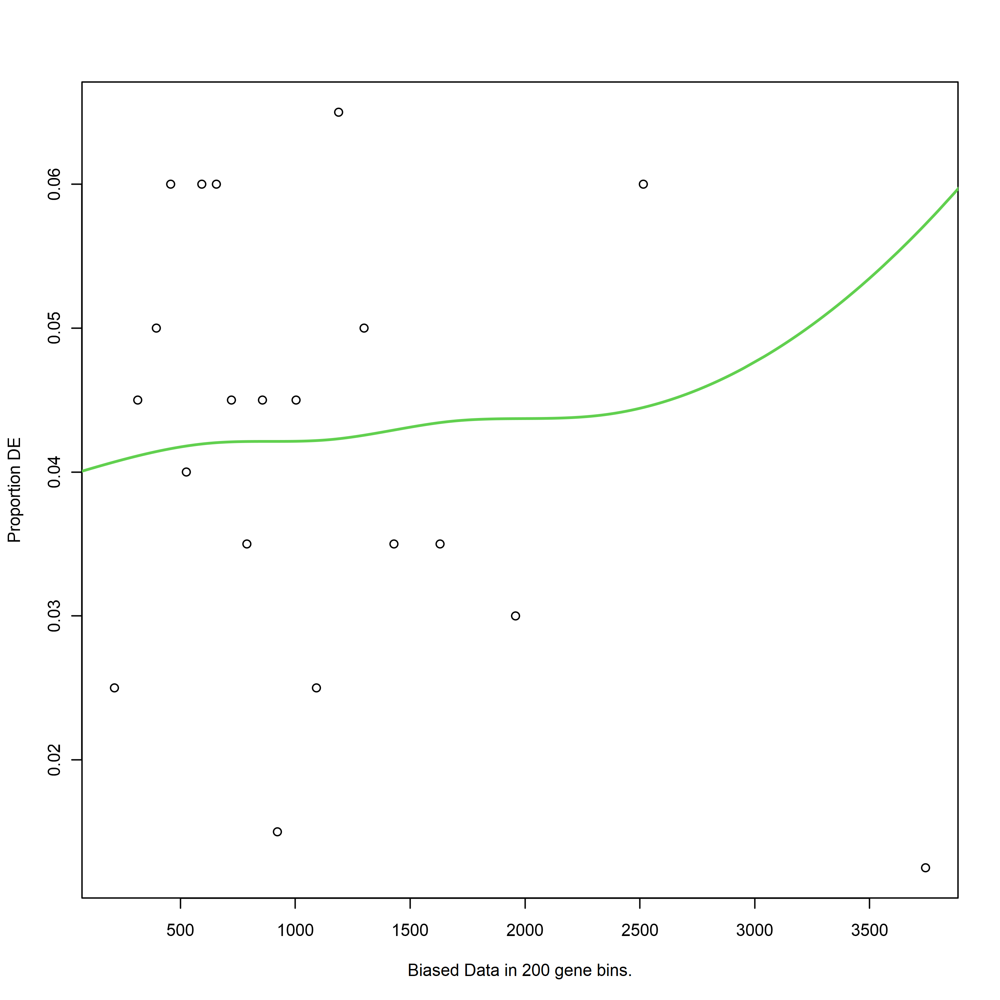

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C1vsA1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


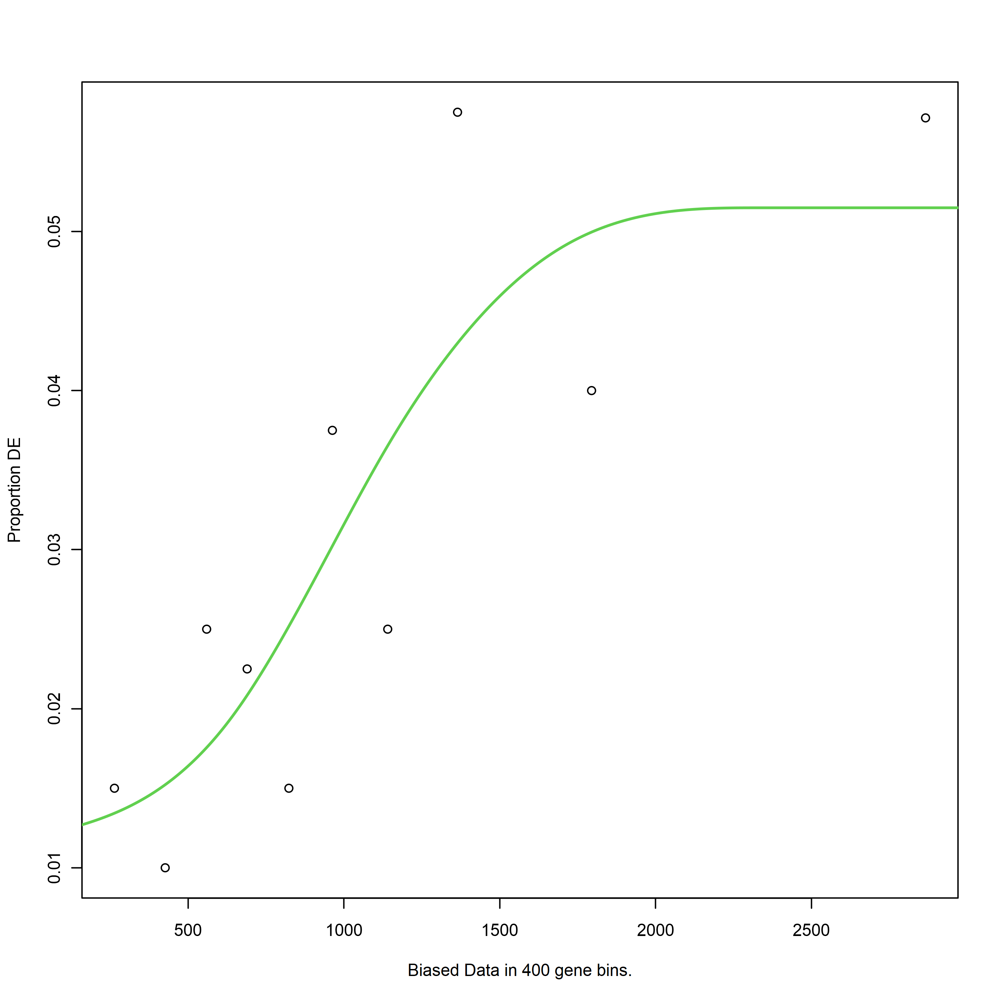

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C2vsC1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


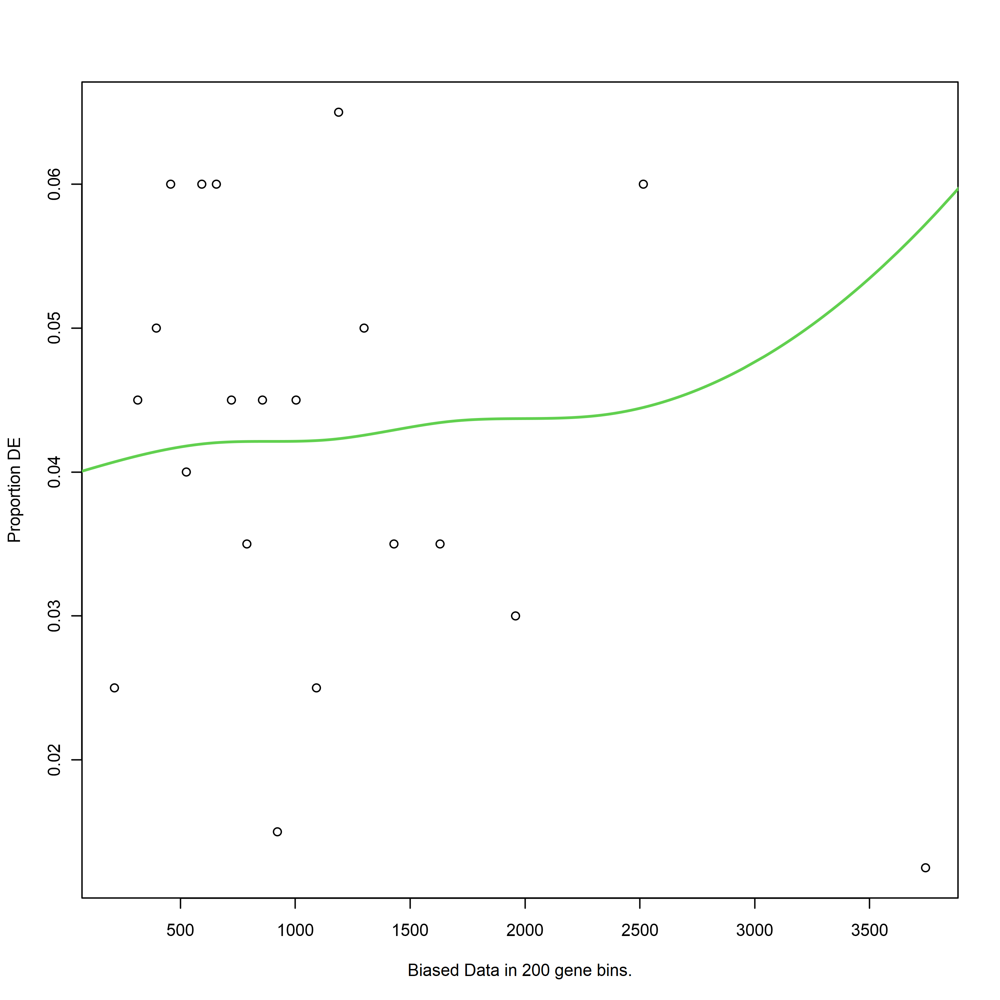

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C2vsC1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


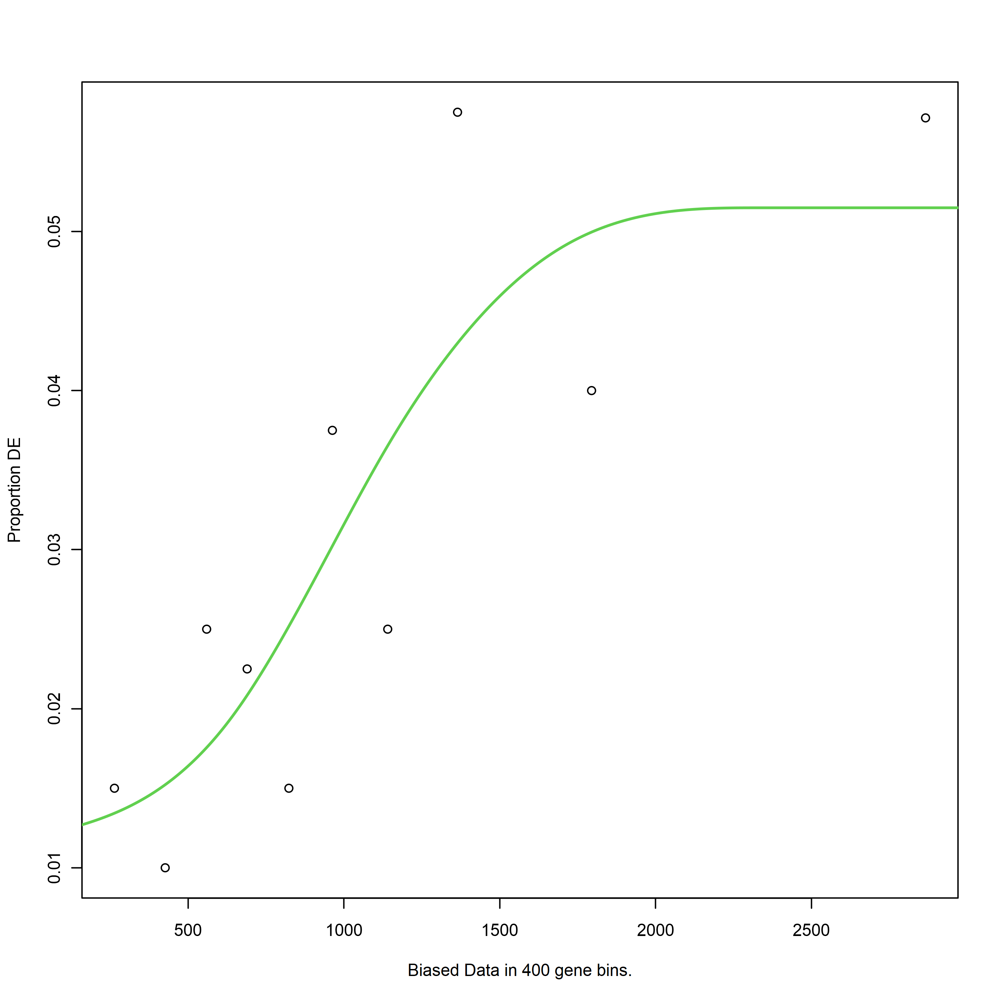

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C2vsC1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


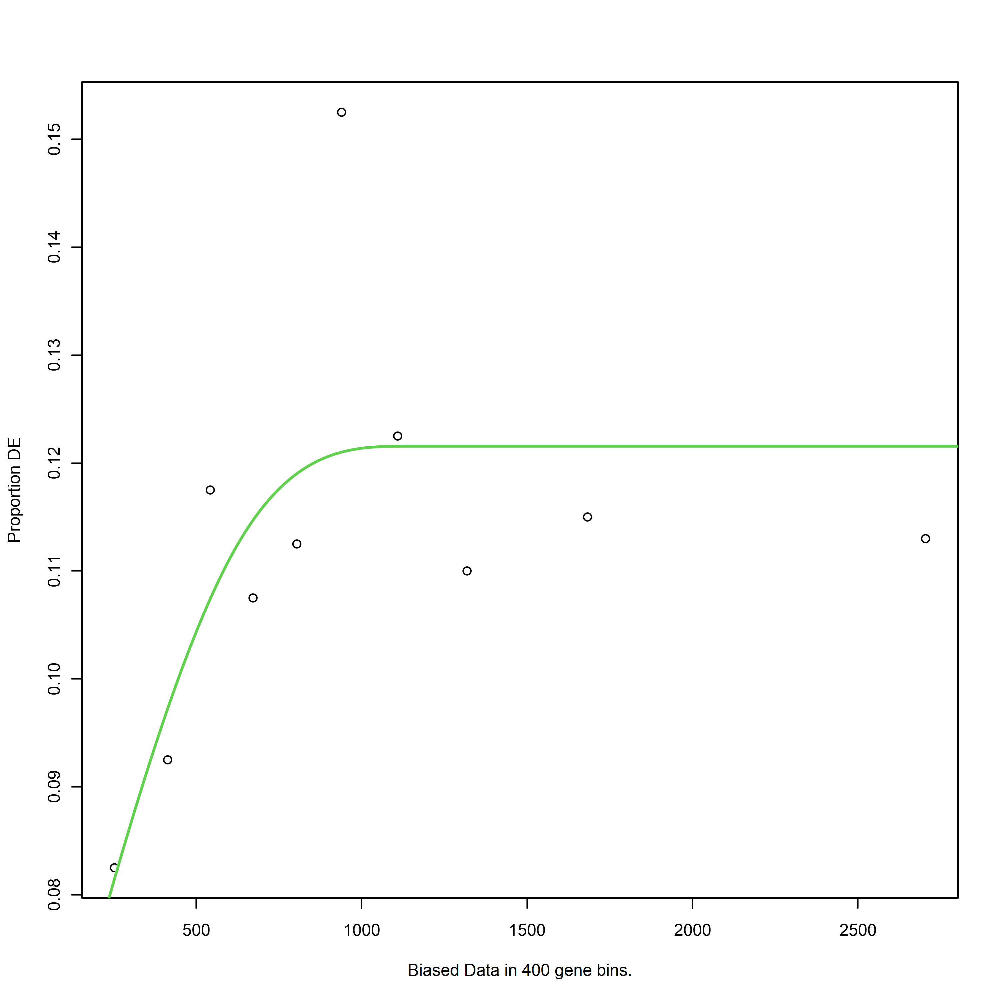

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C2vsC1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


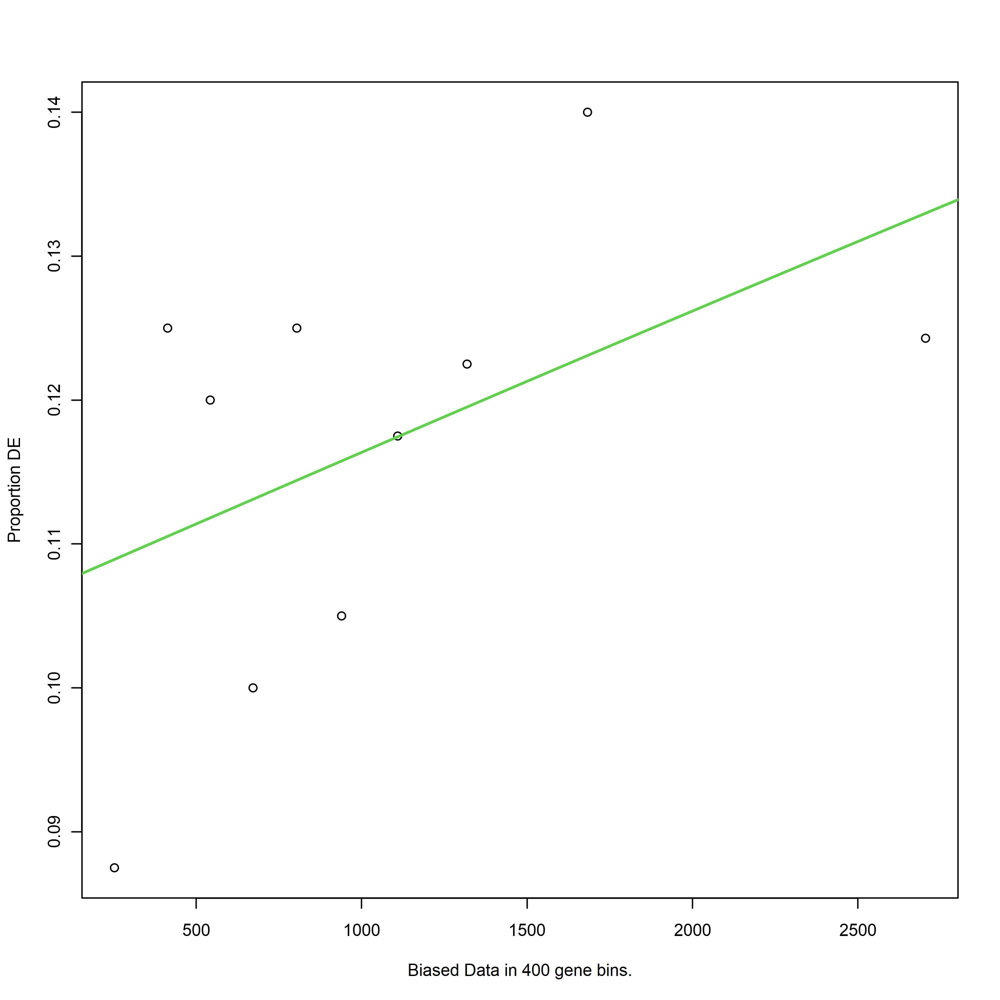

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C2vsC1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


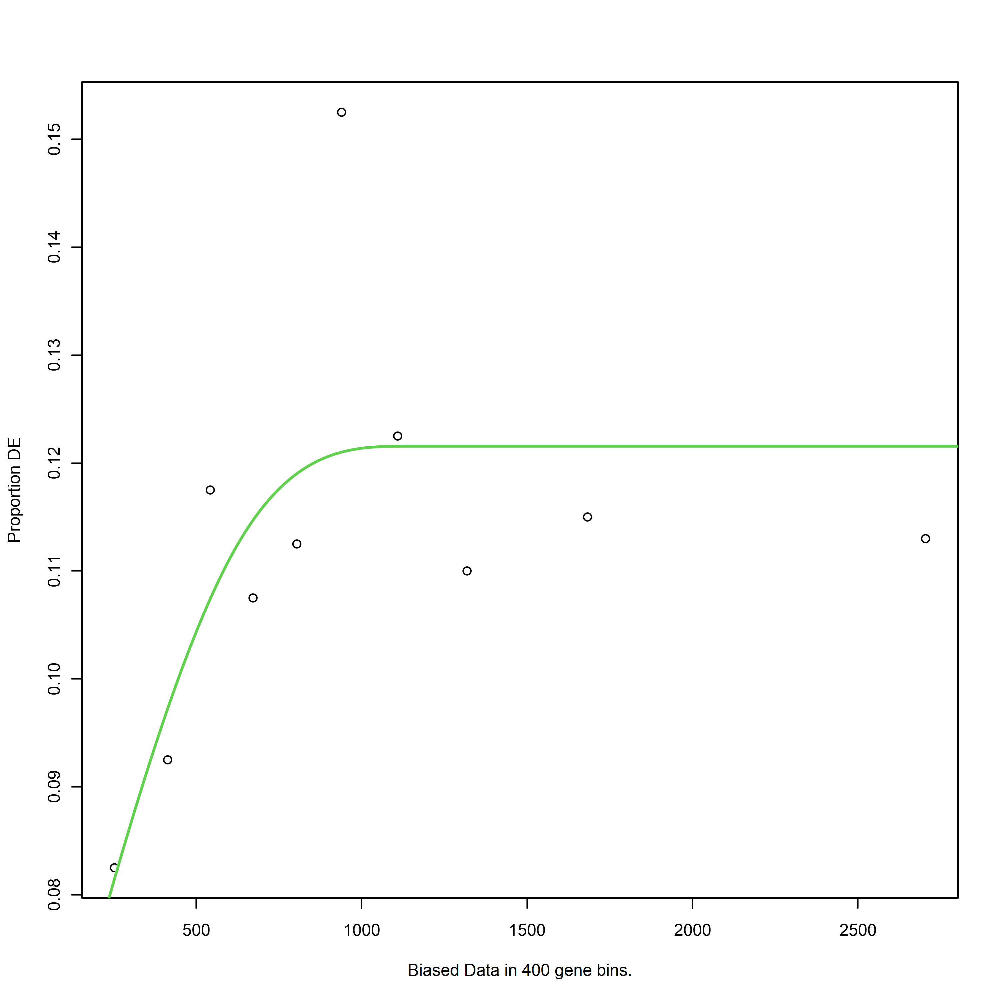

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C2vsC1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


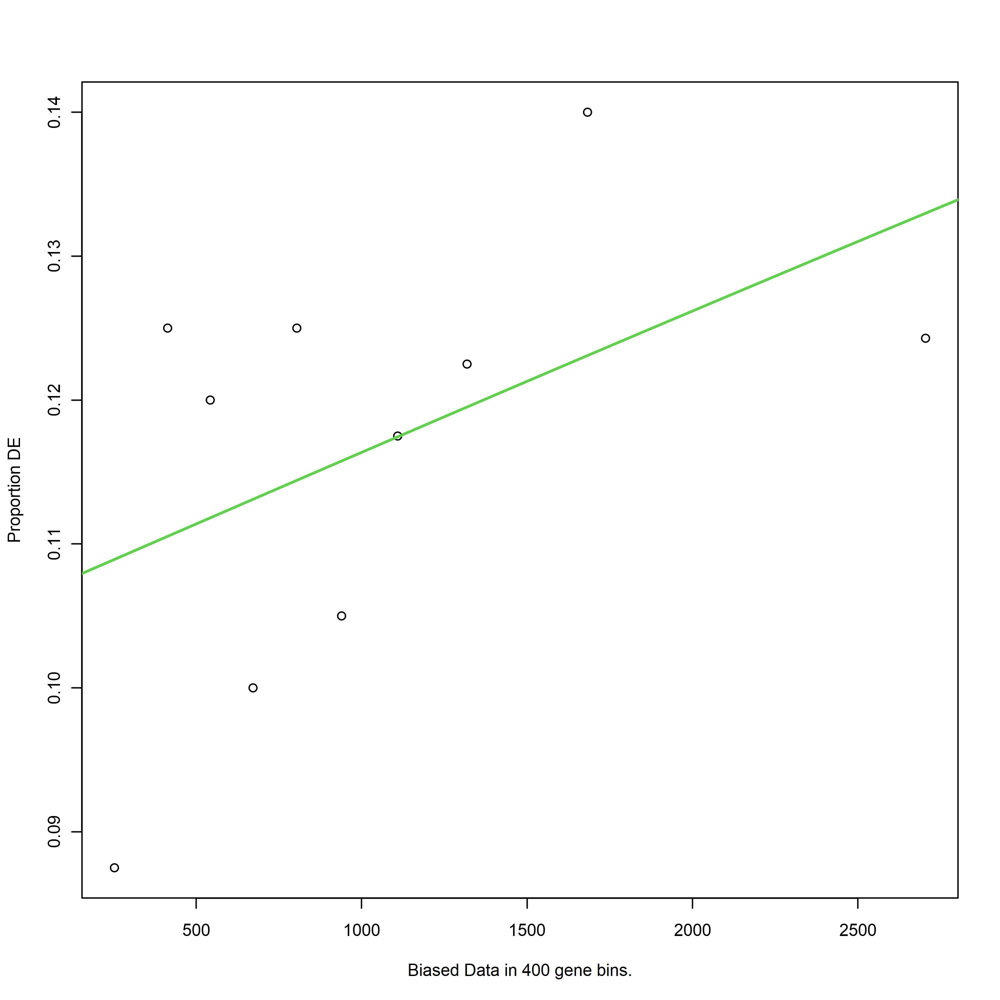

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C2vsC1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


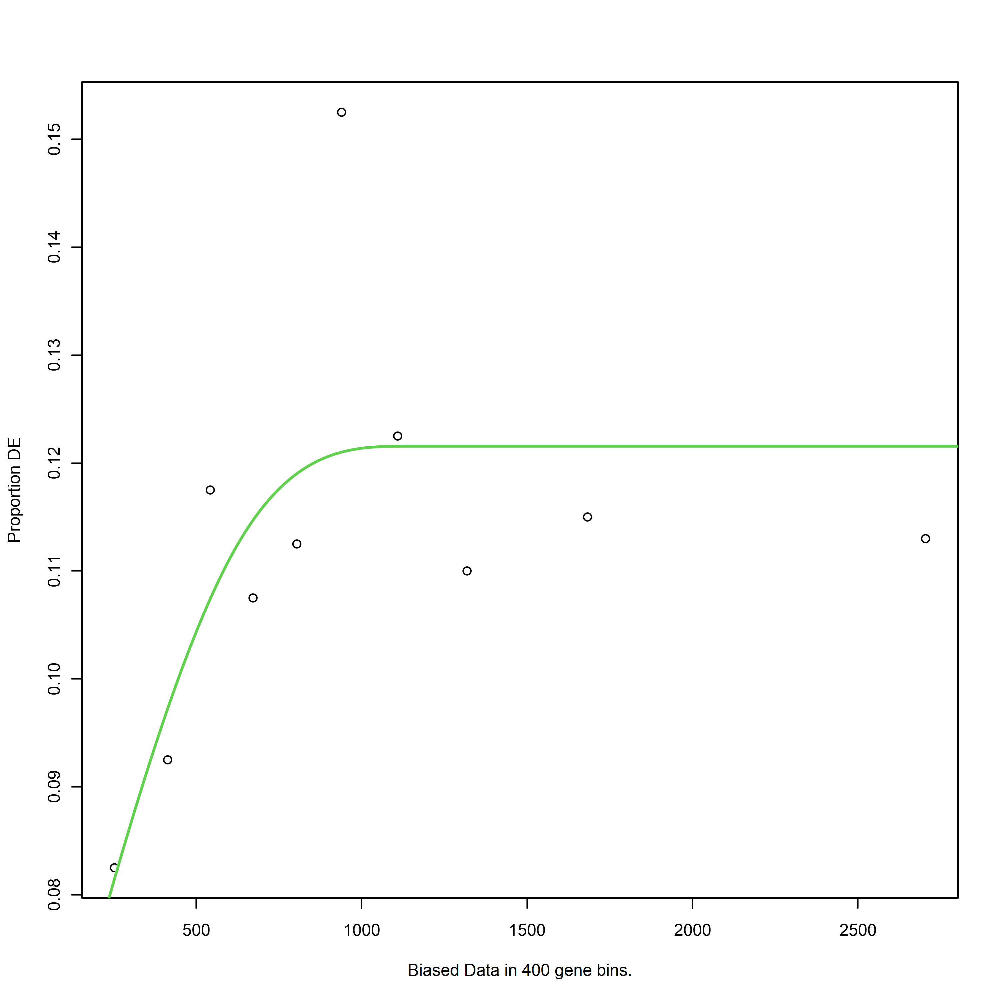

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C2vsC1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


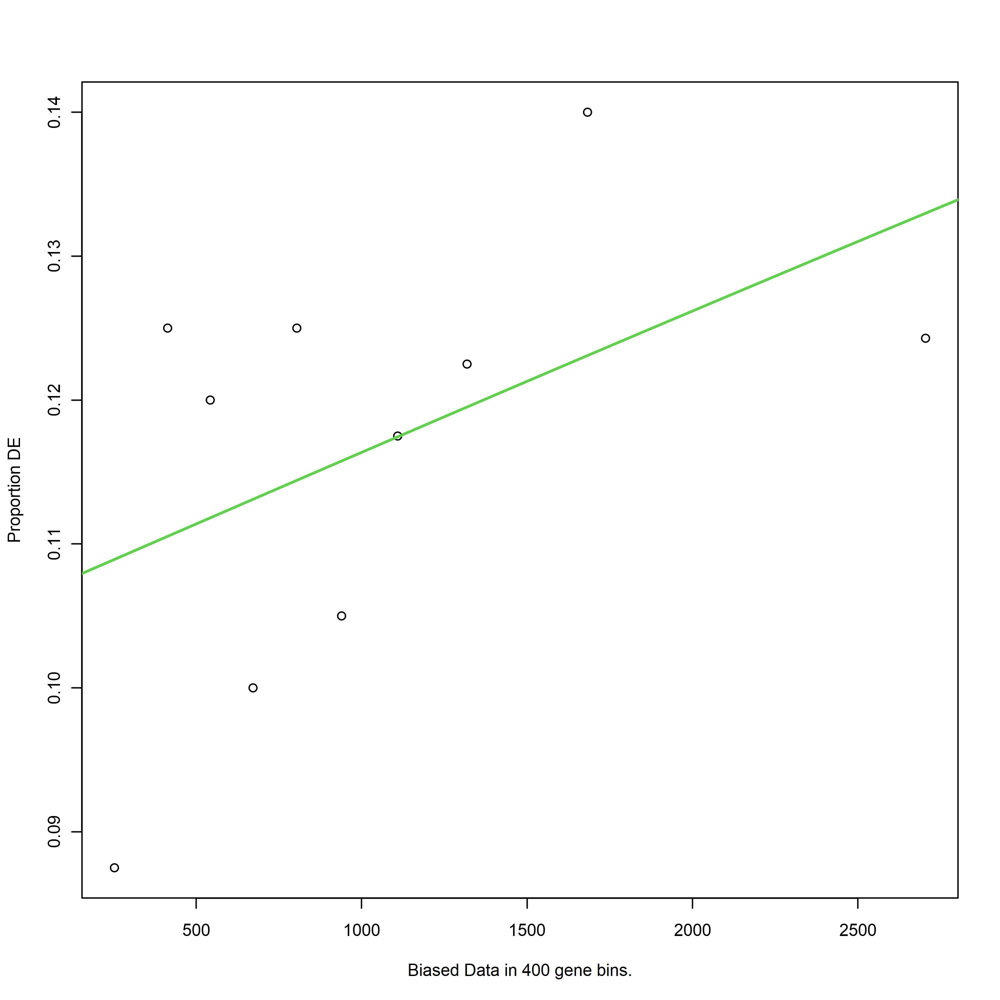

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C3vsC1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


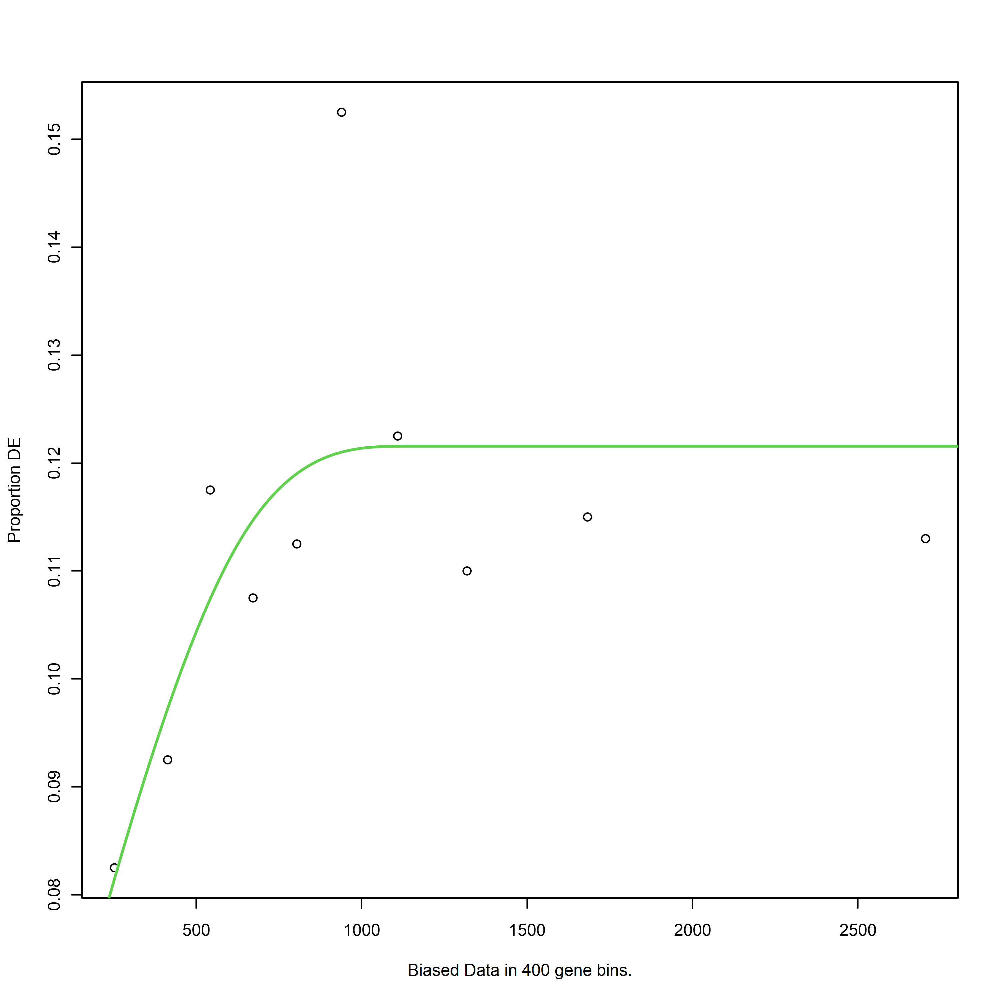

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C3vsC1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


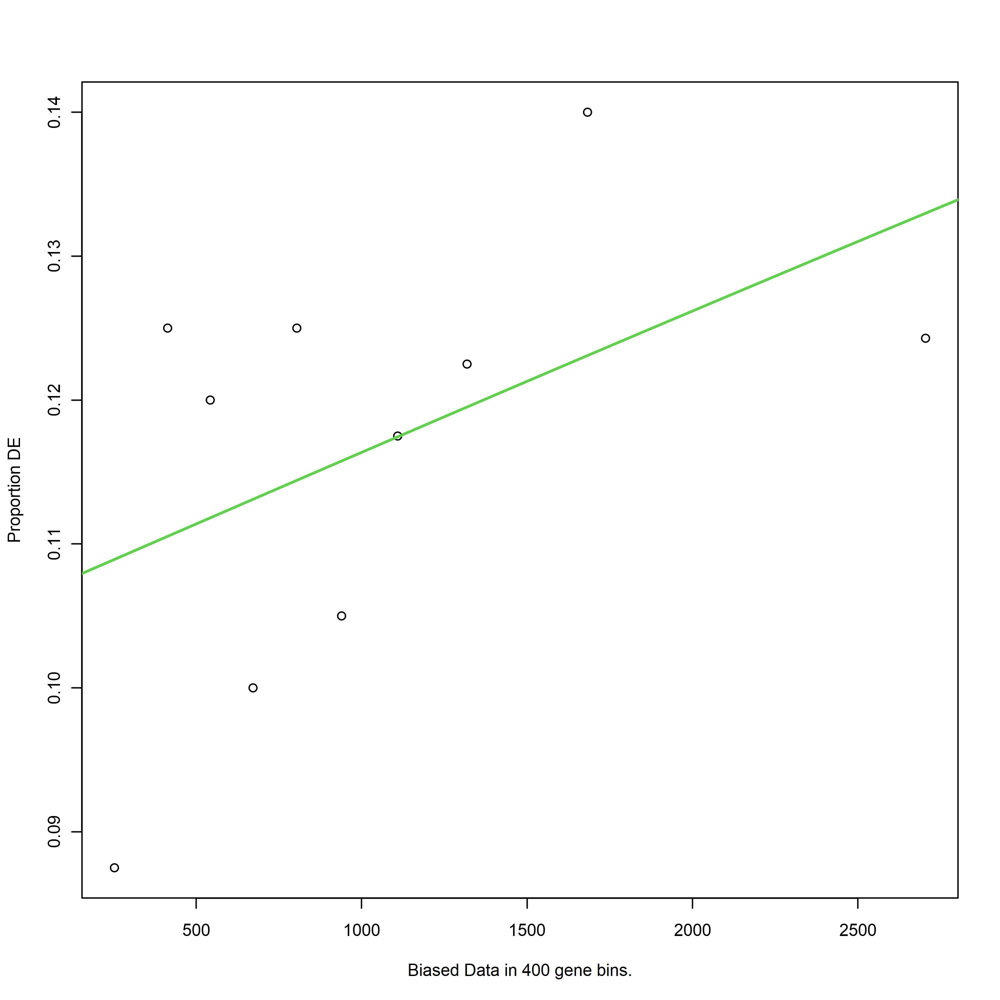

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C3vsC1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


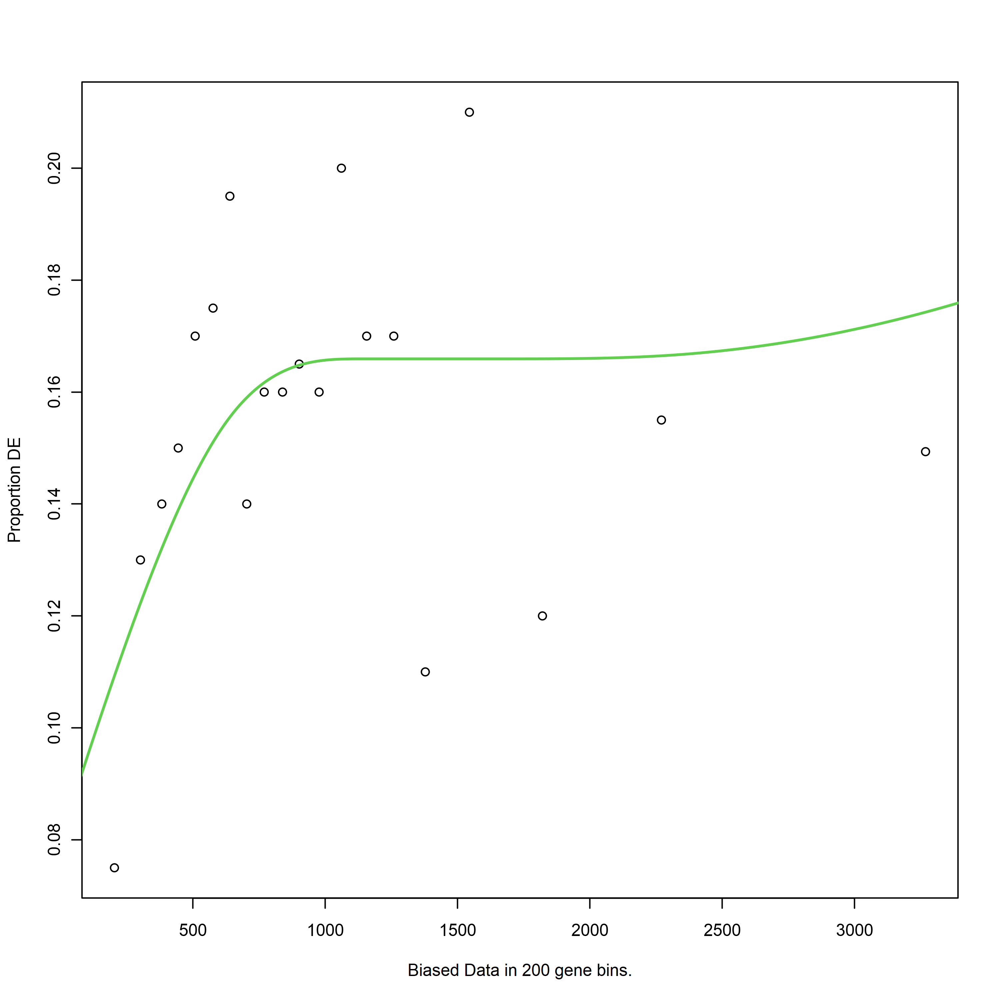

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C3vsC1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


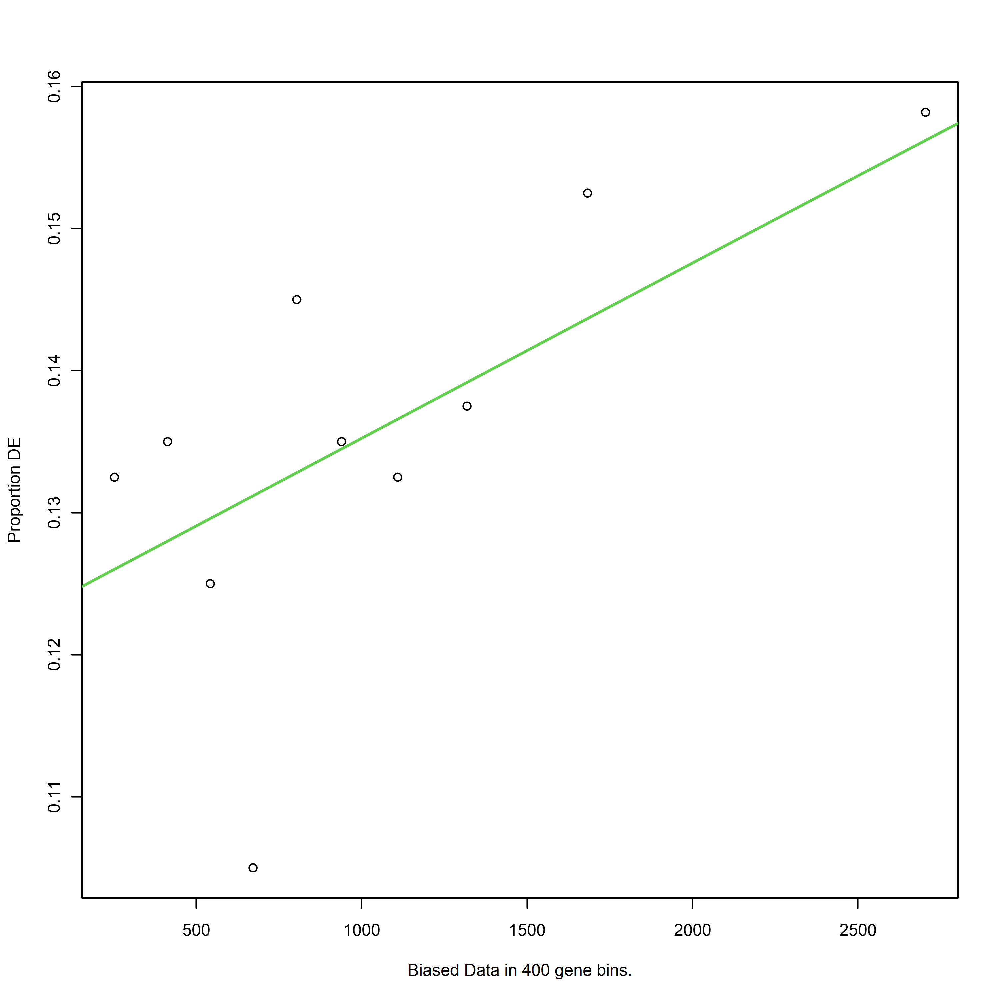

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C3vsC1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


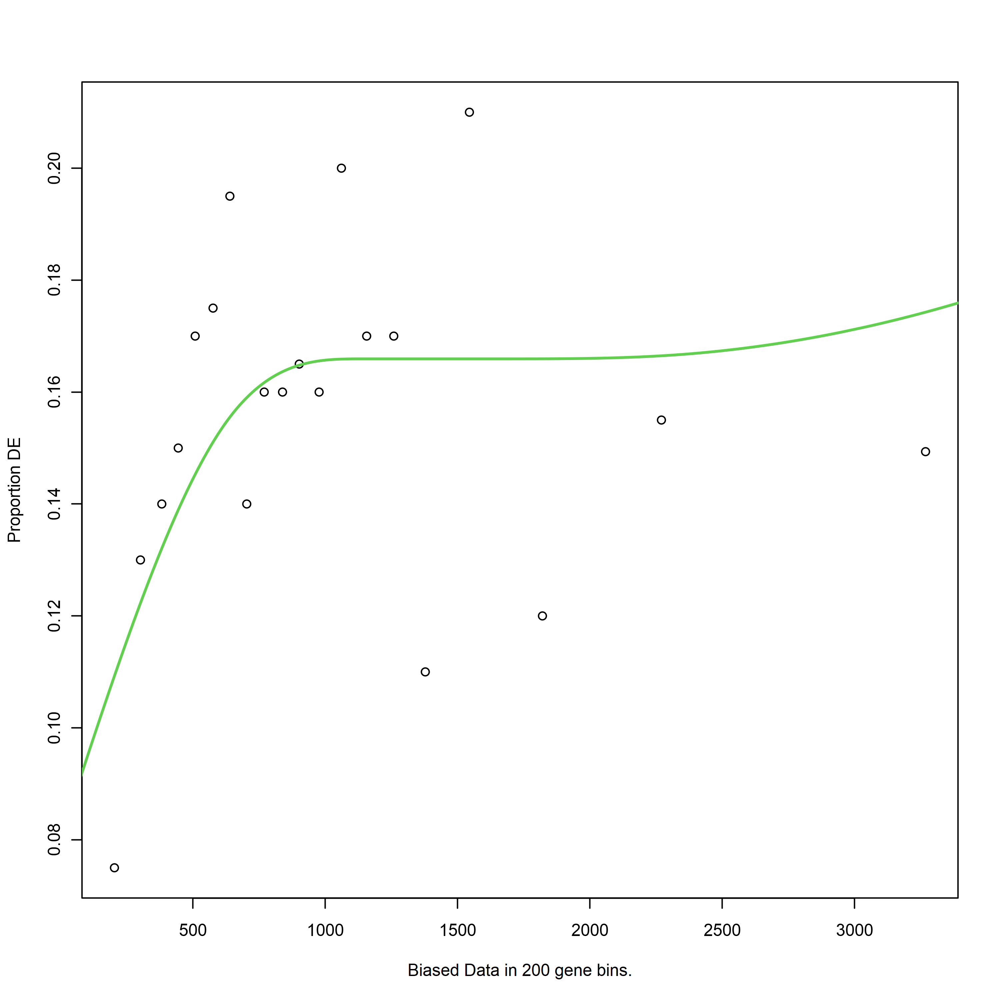

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C3vsC1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


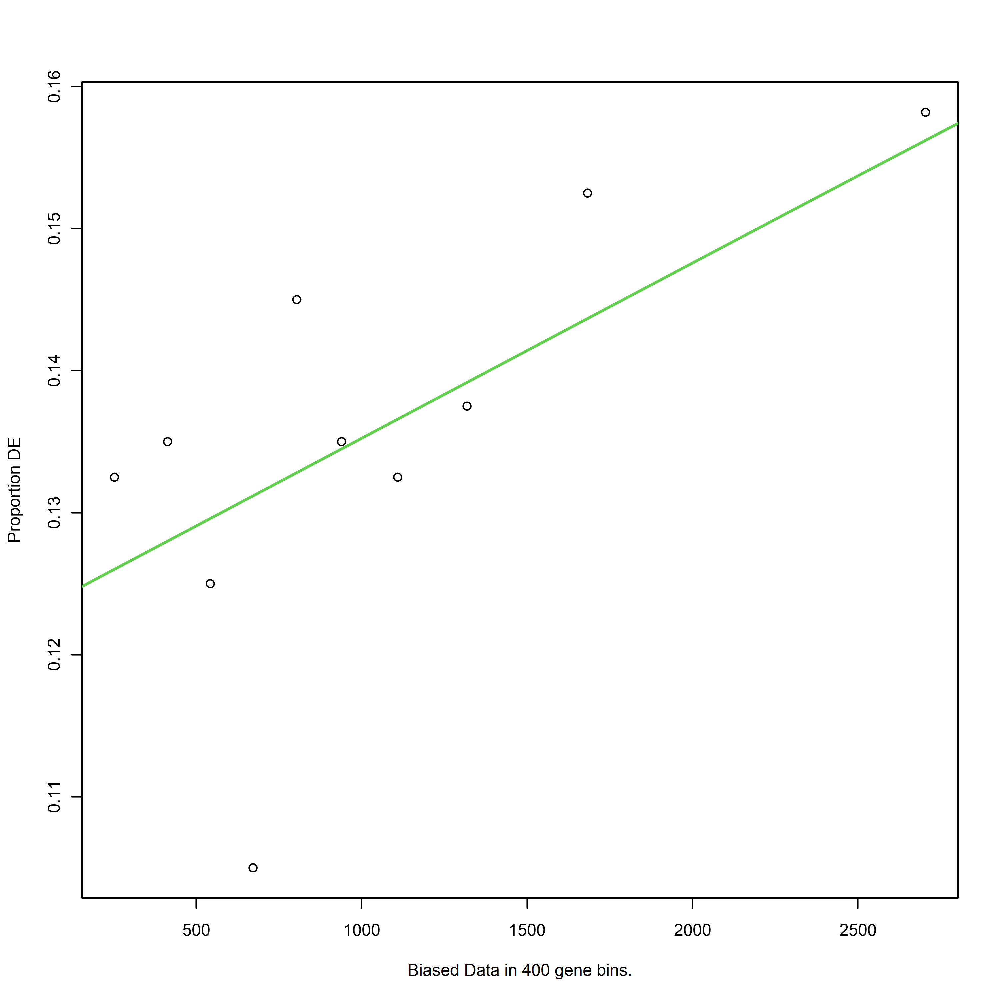

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C3vsC1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


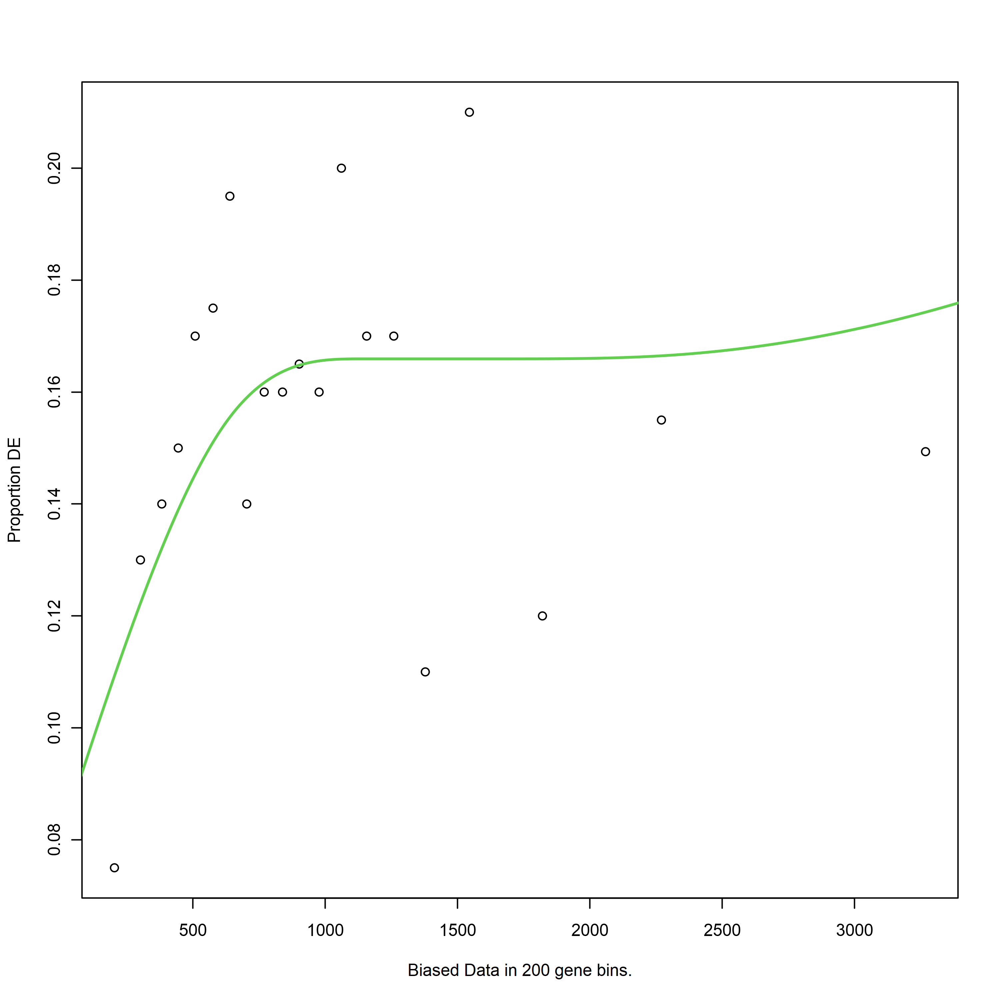

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C3vsC1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


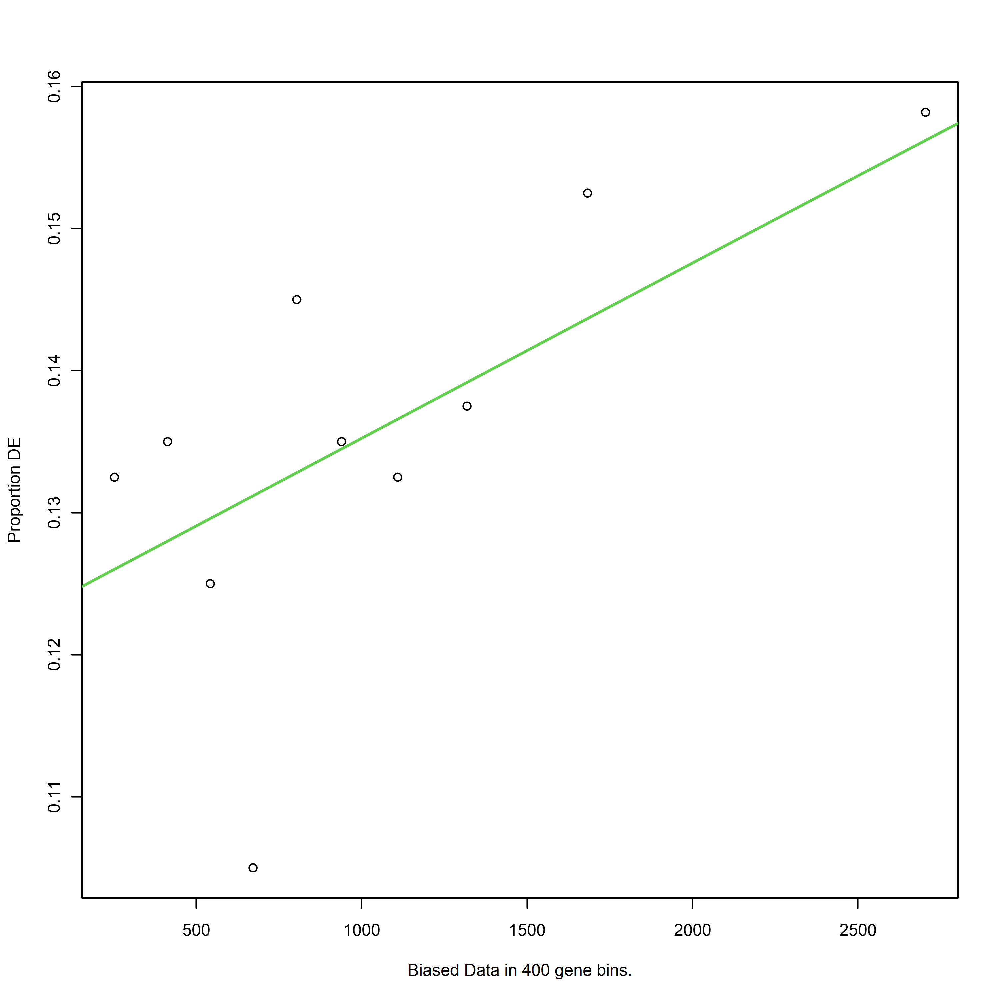

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C4vsC1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


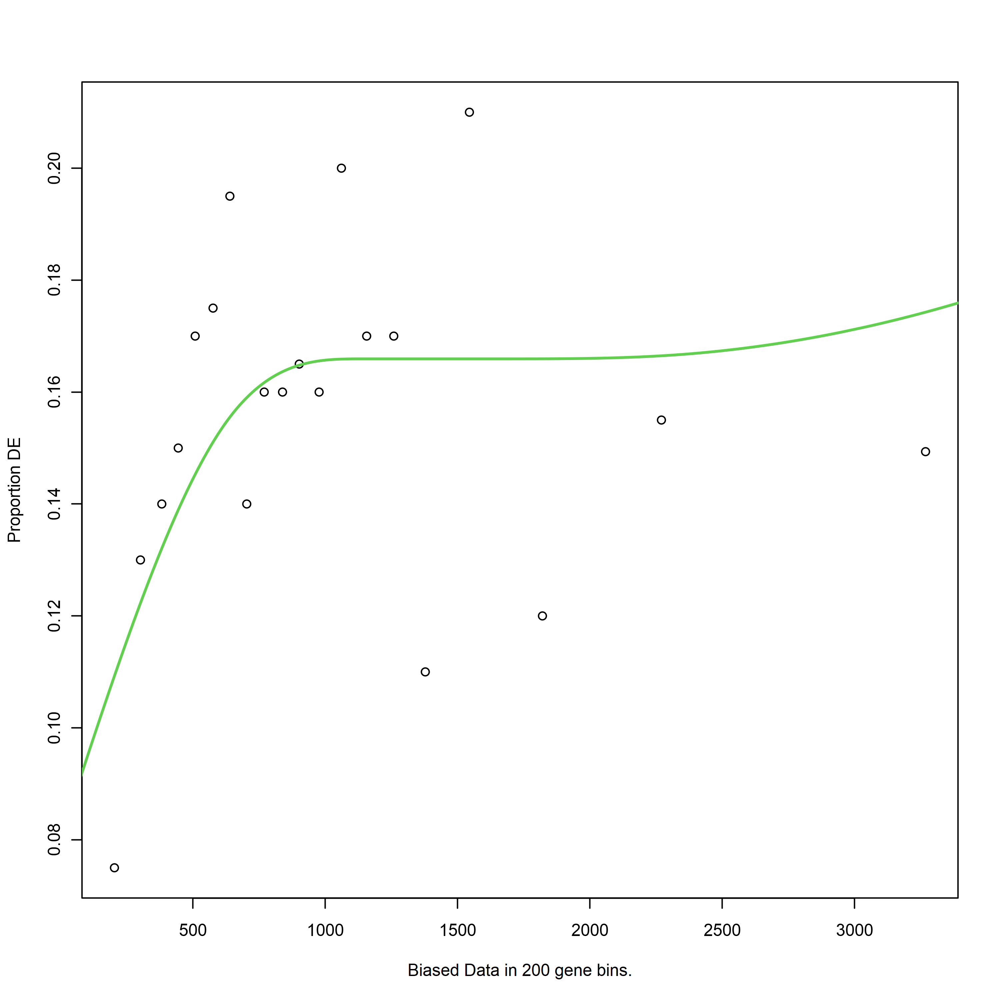

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



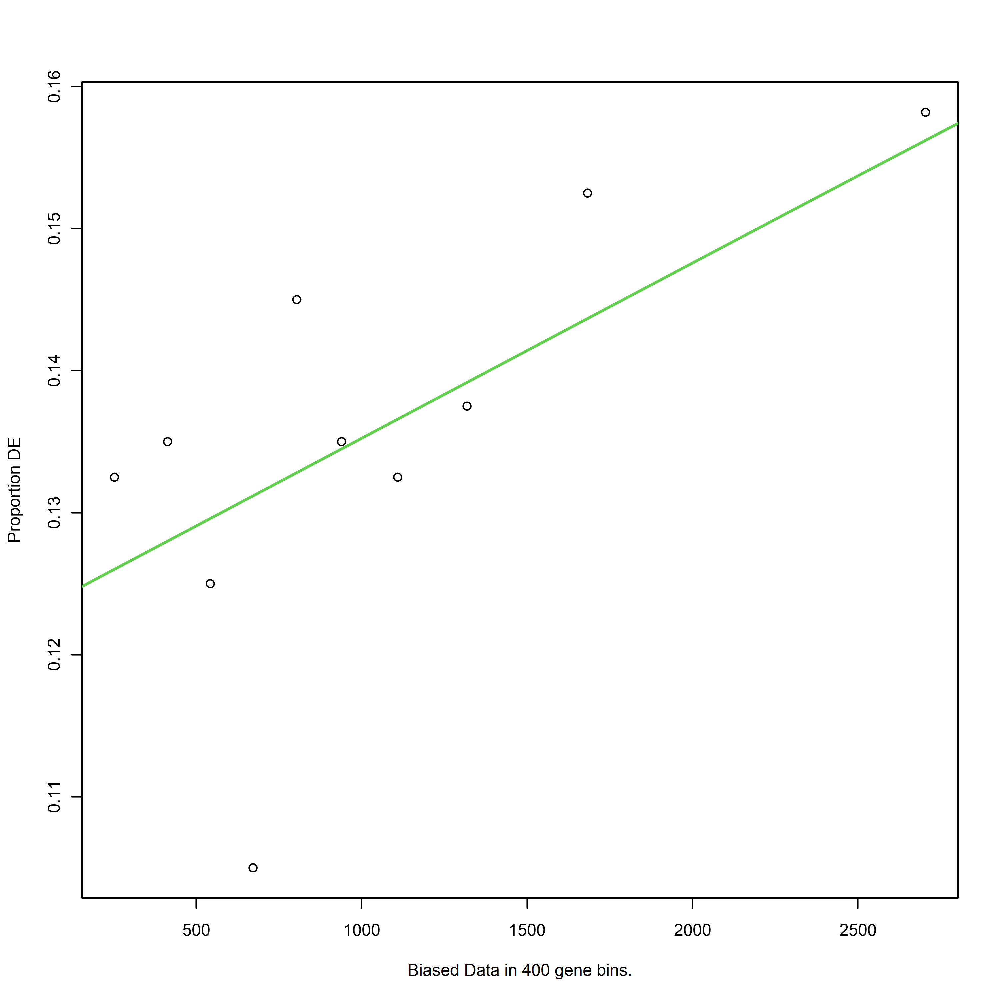

[1] "C4vsC1_rna"
[1] "up"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C4vsC1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


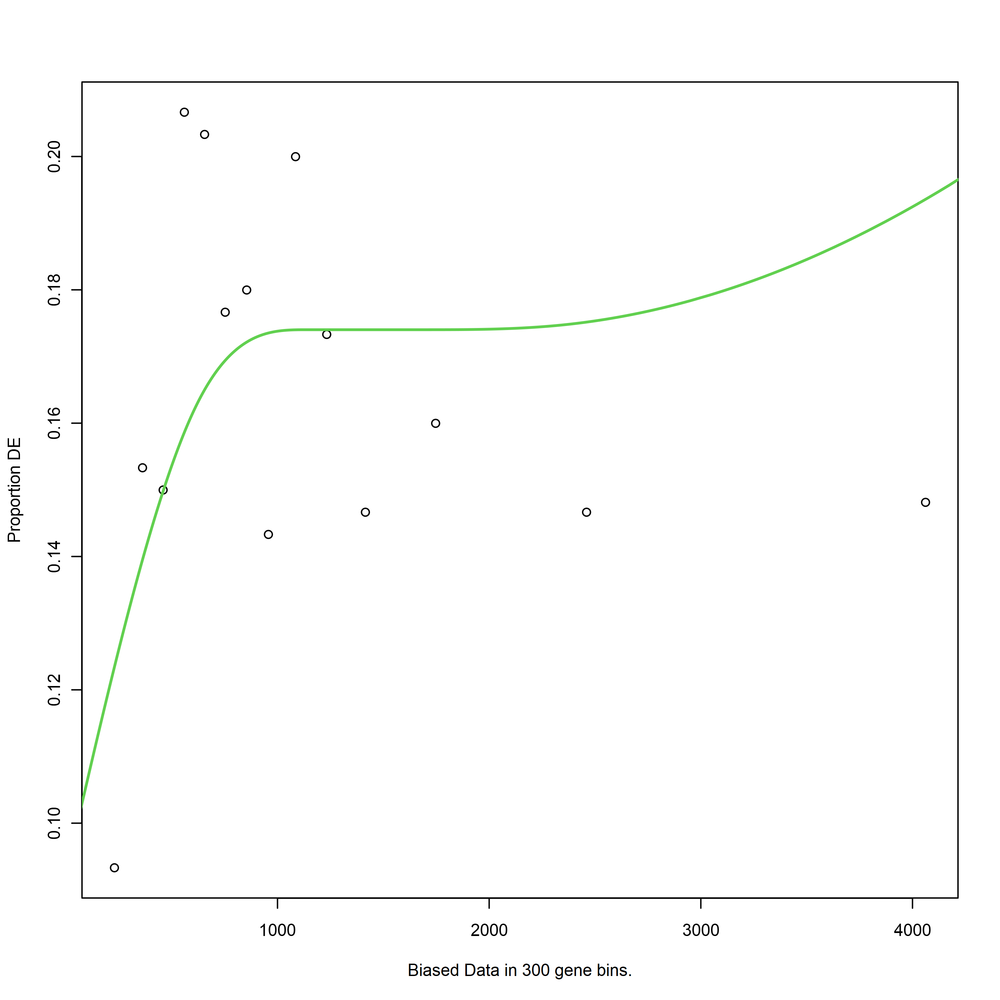

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



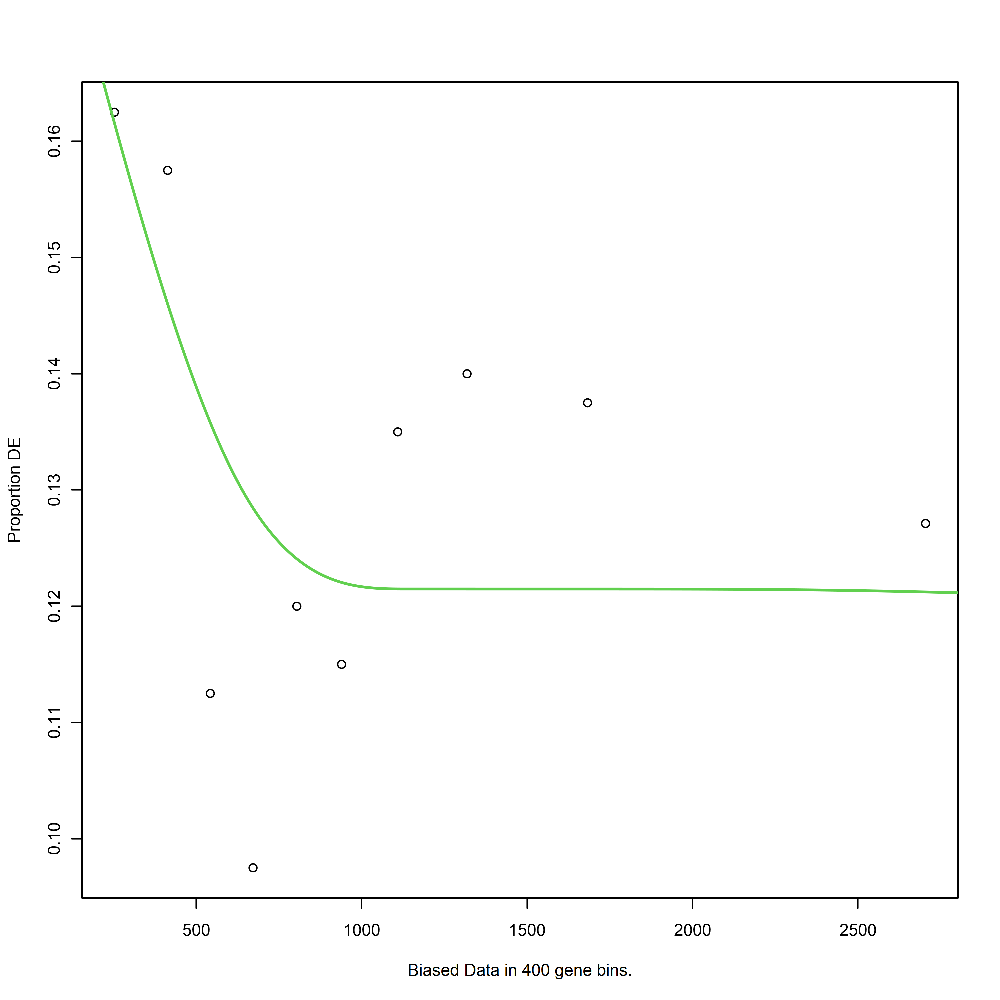

[1] "C4vsC1_rna"
[1] "up"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C4vsC1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


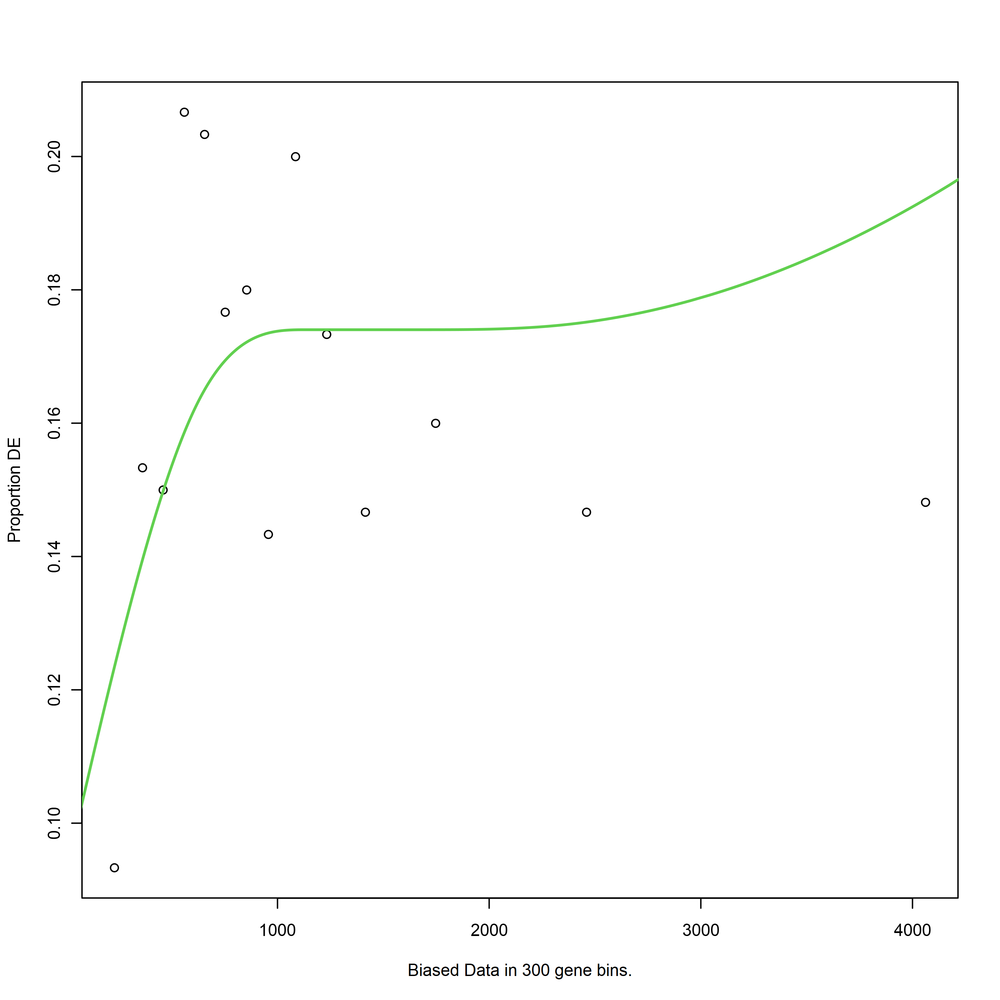

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



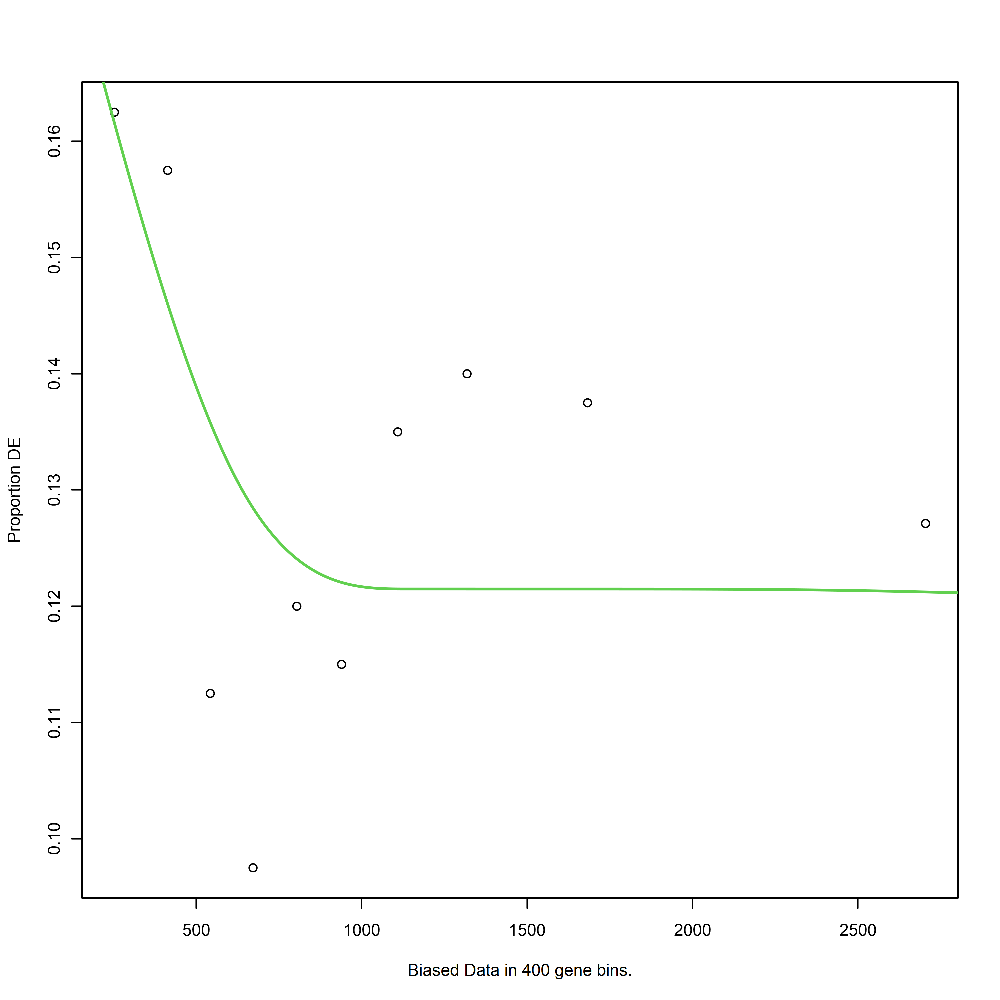

[1] "C4vsC1_rna"
[1] "up"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C4vsC1_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


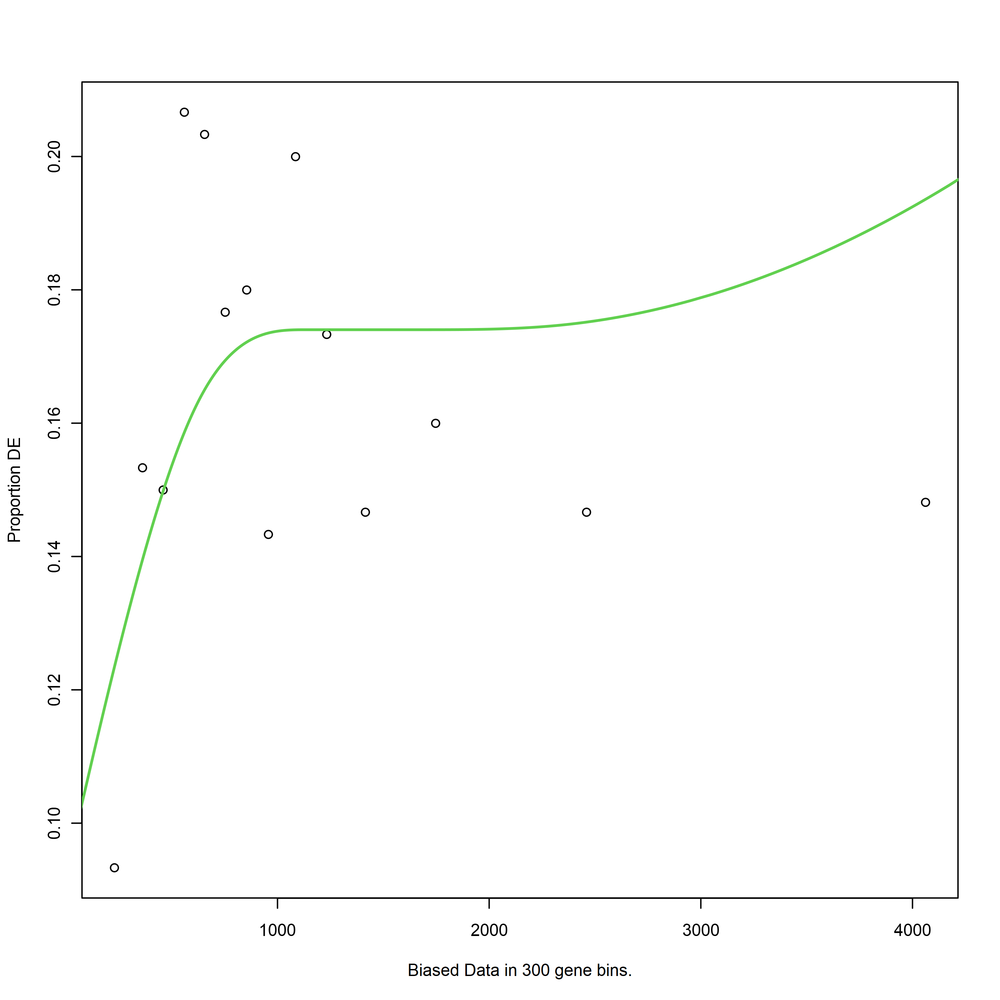

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



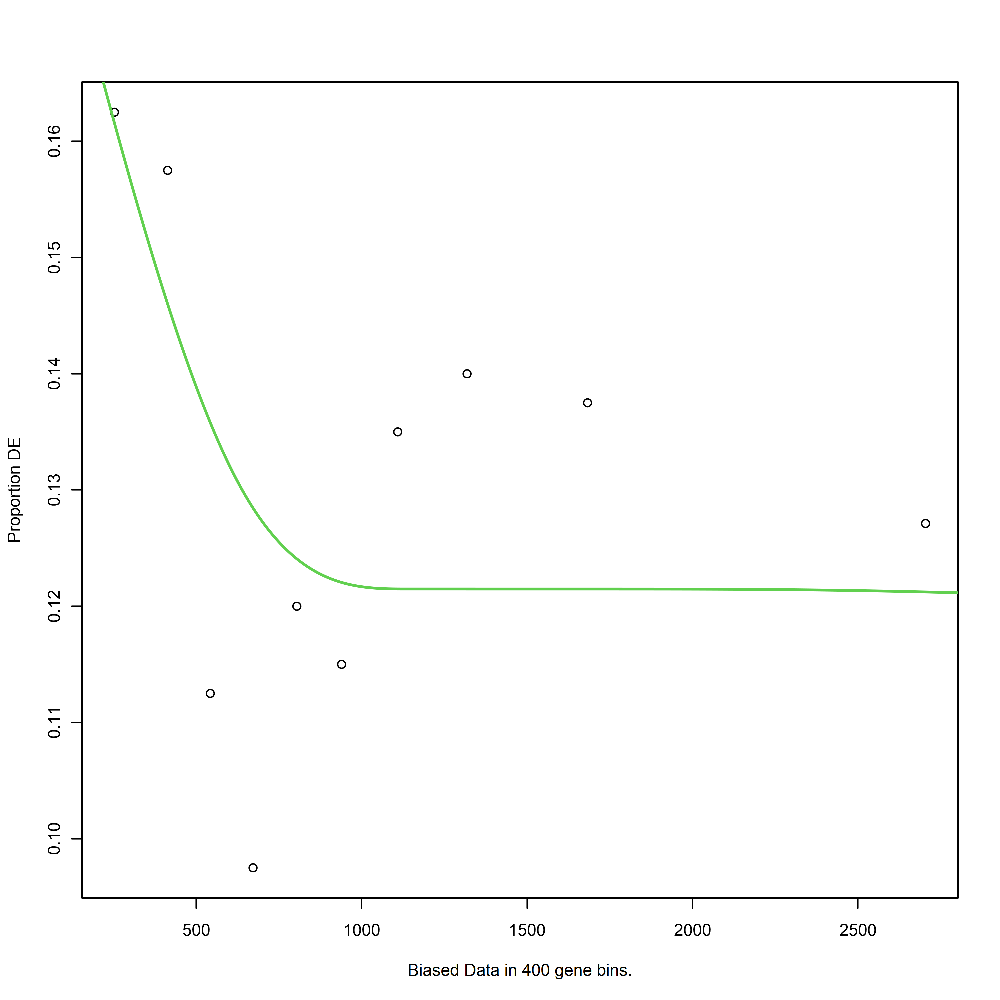

[1] "C4vsC1_rna"
[1] "up"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



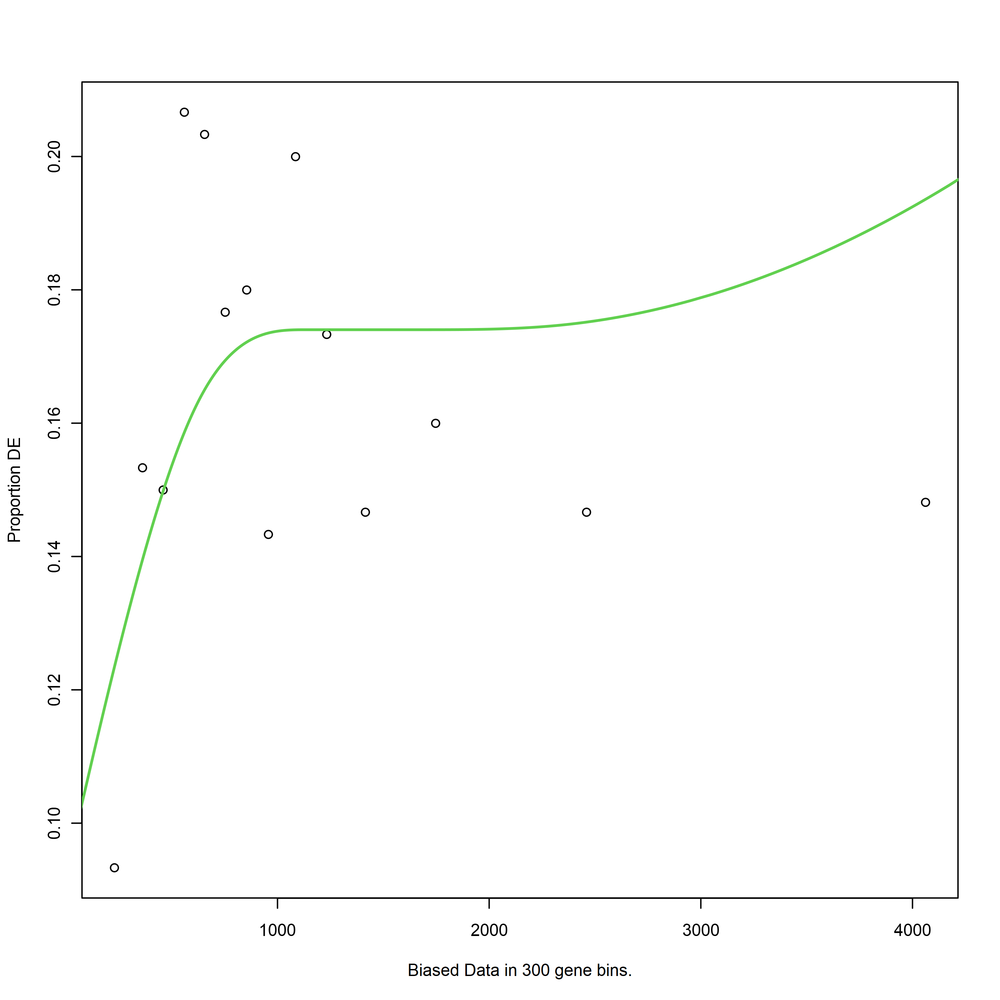

[1] "C5vsC1_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C5vsC1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


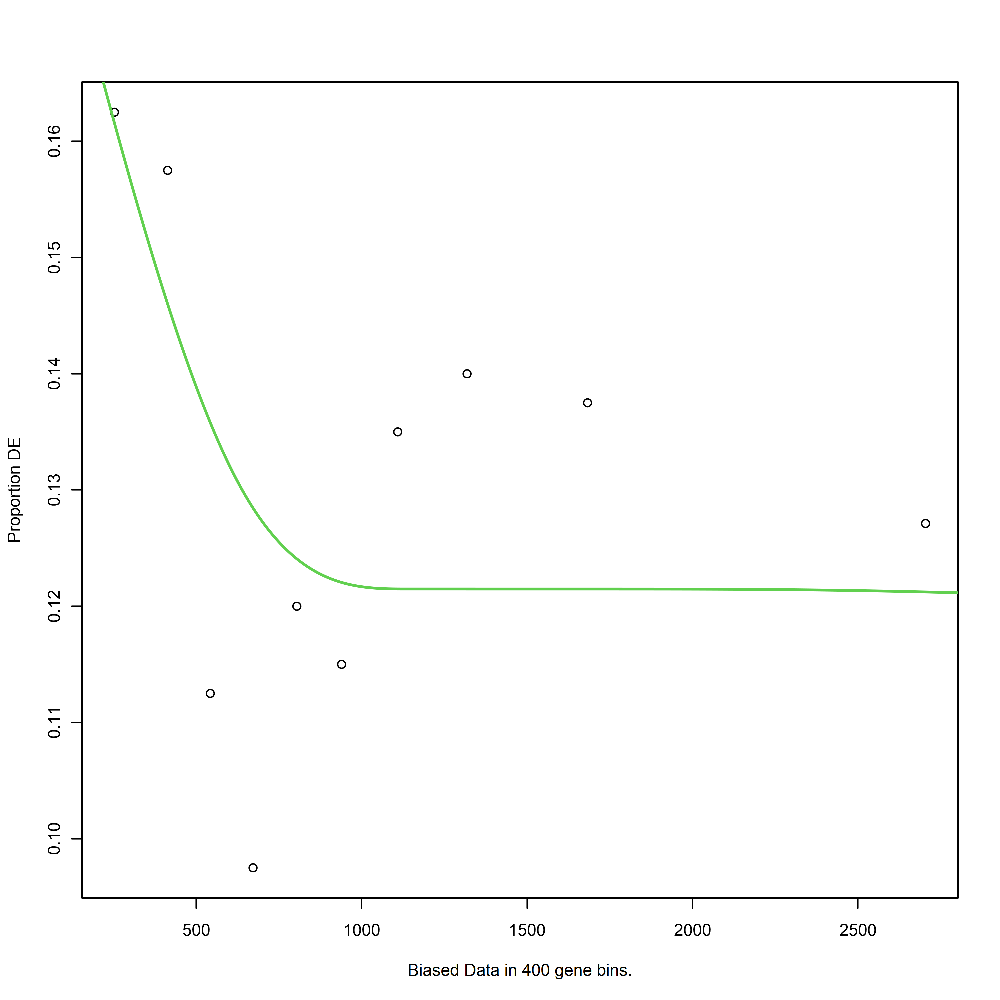

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



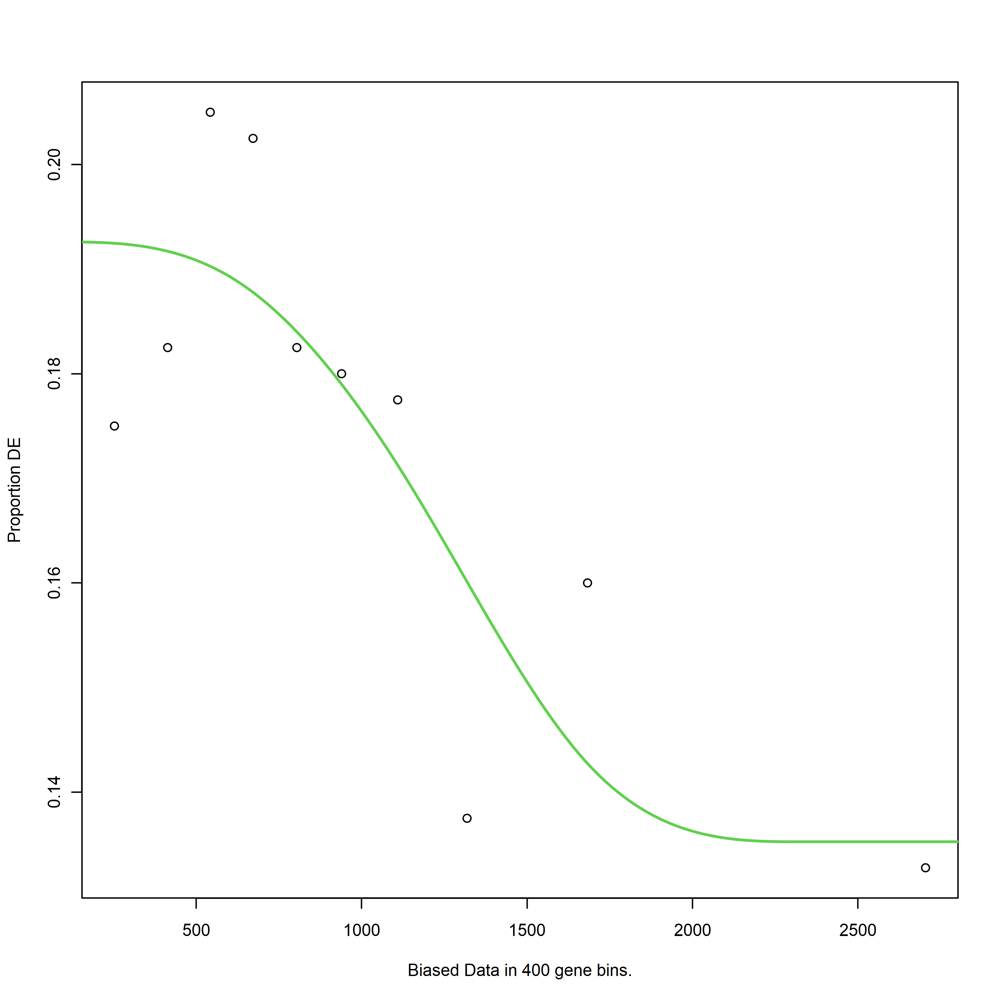

[1] "C5vsC1_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C5vsC1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


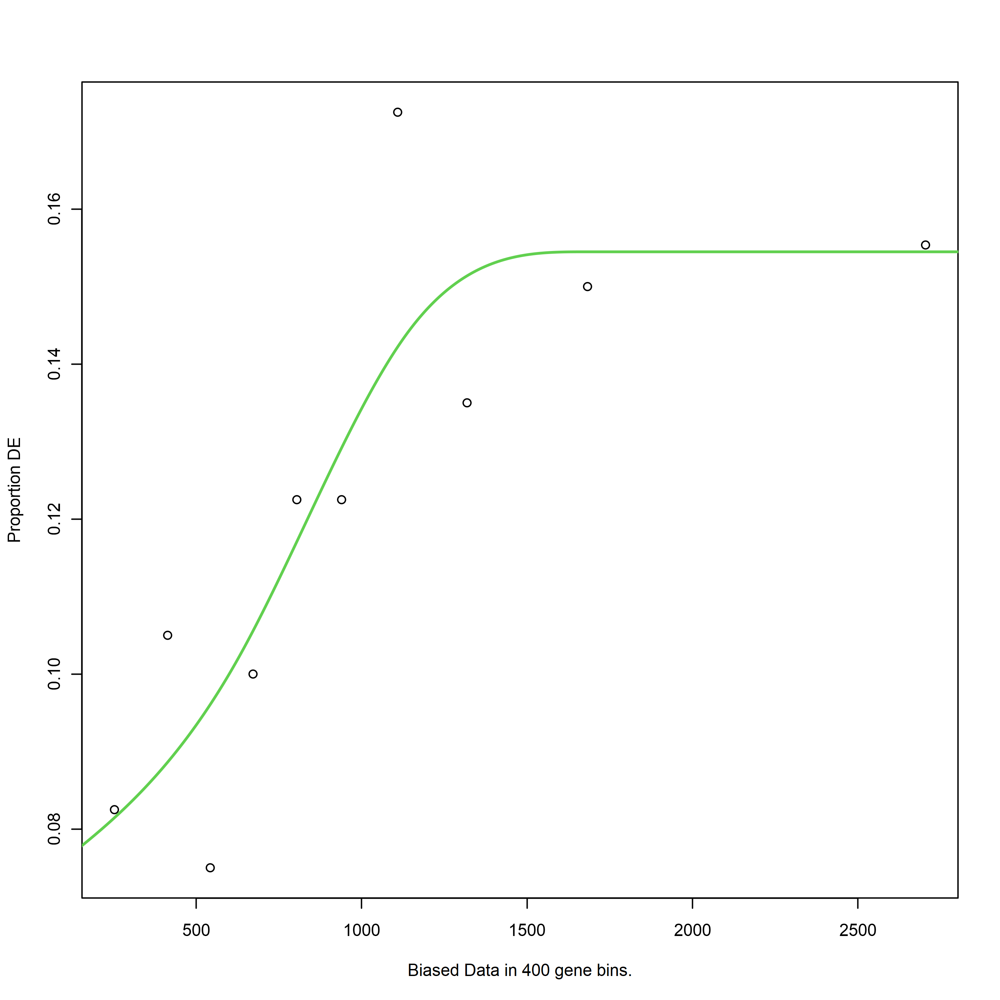

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



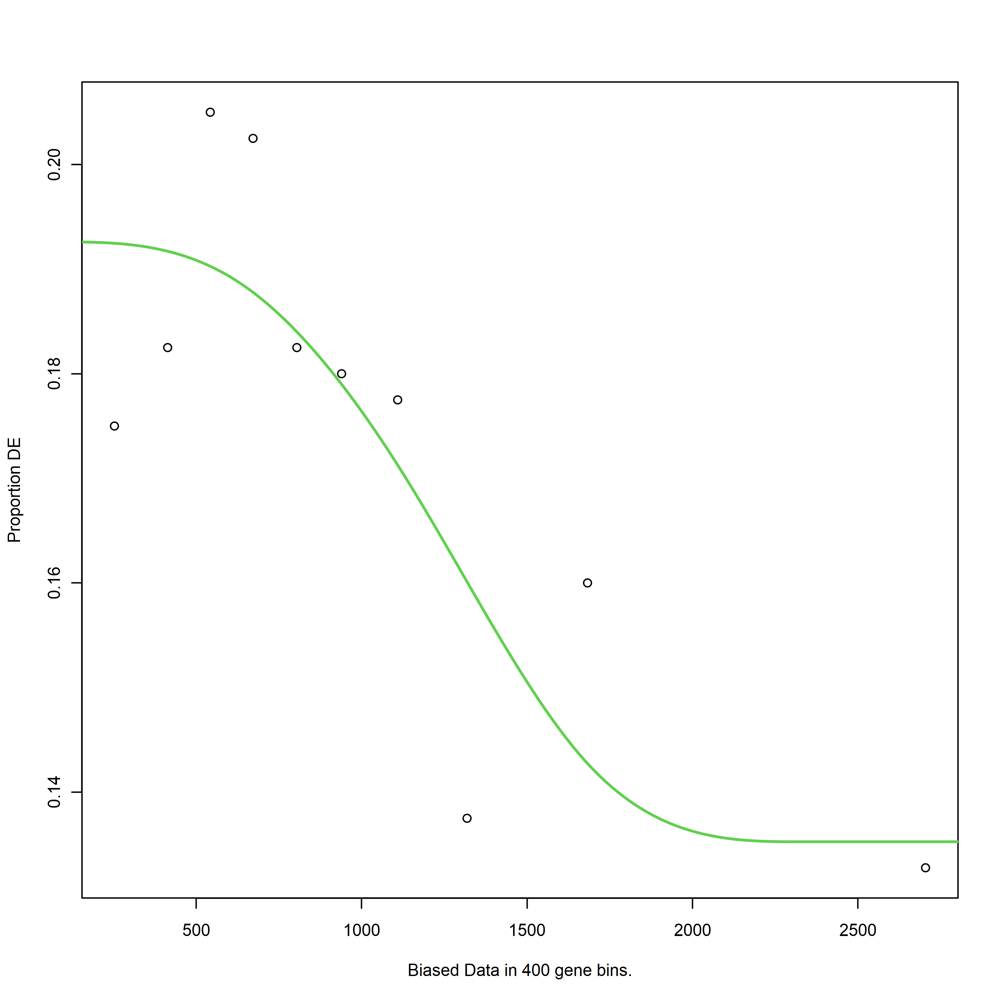

[1] "C5vsC1_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C5vsC1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


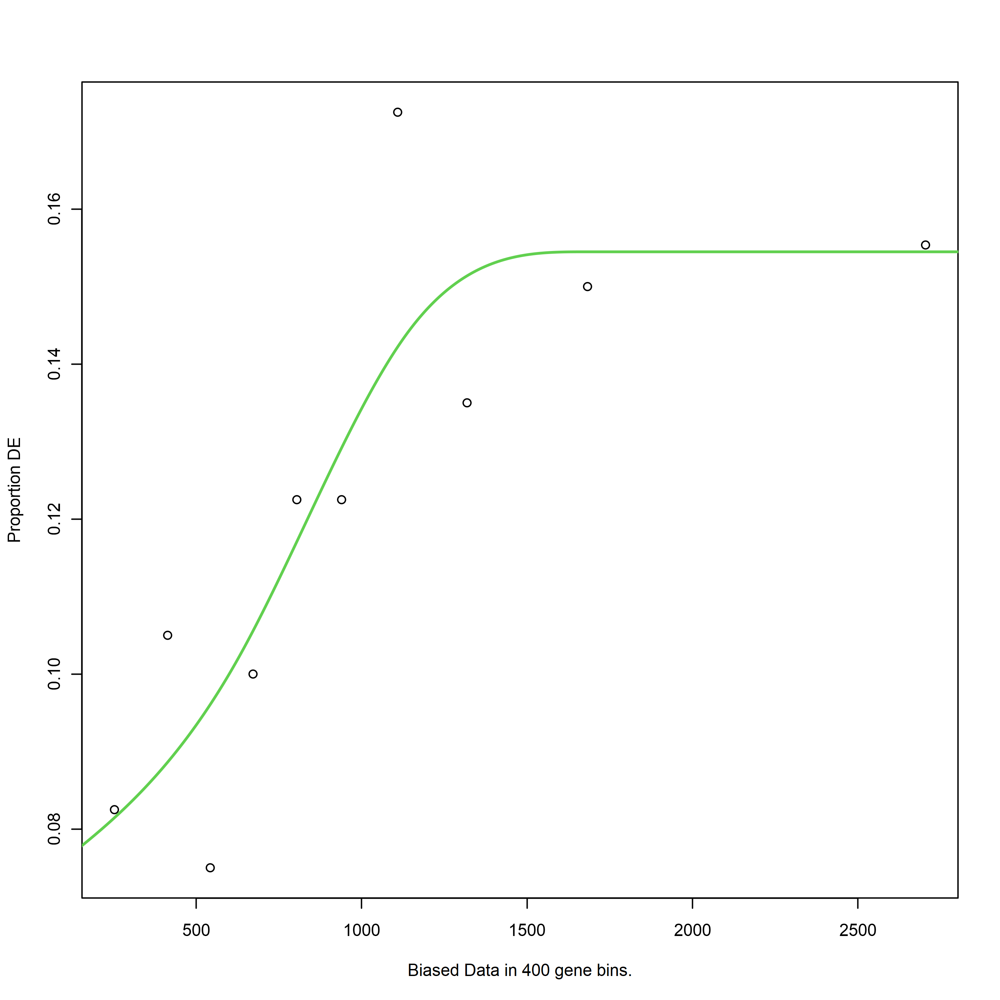

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



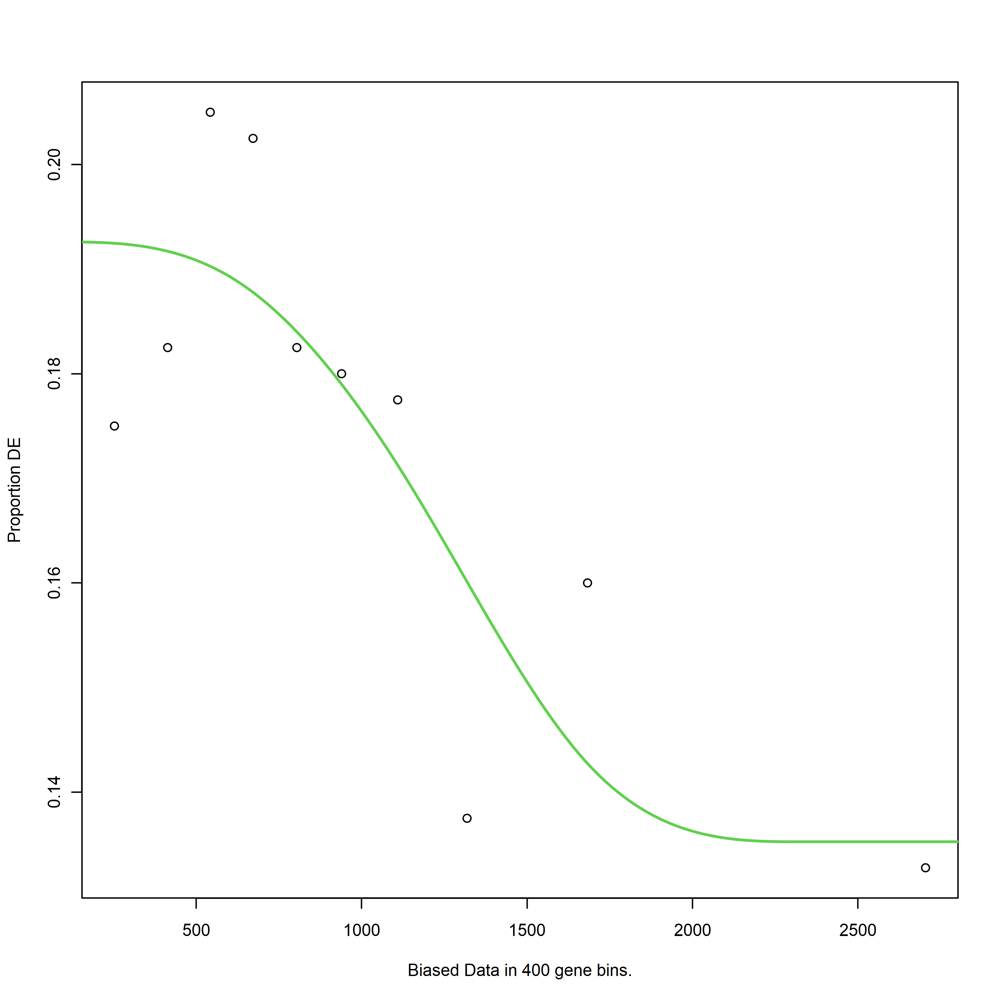

[1] "C5vsC1_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C5vsC1_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


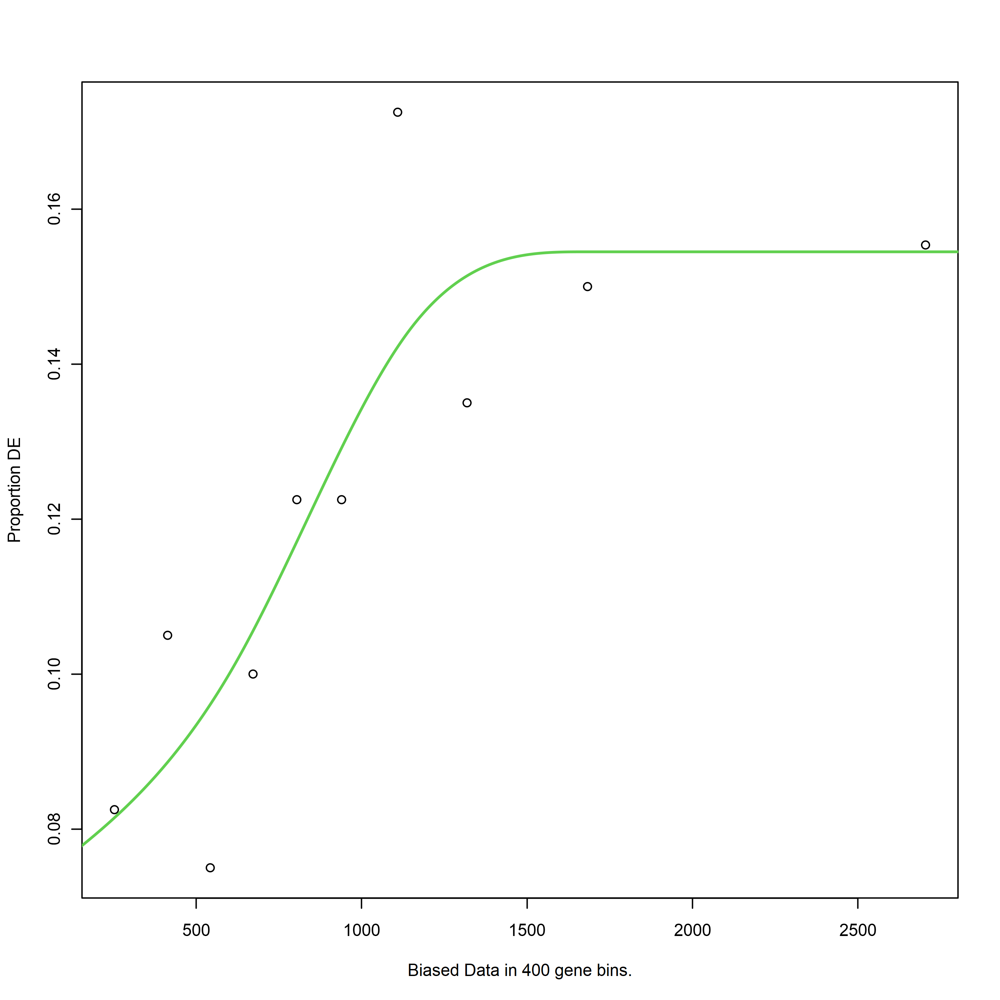

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C3vsC2_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


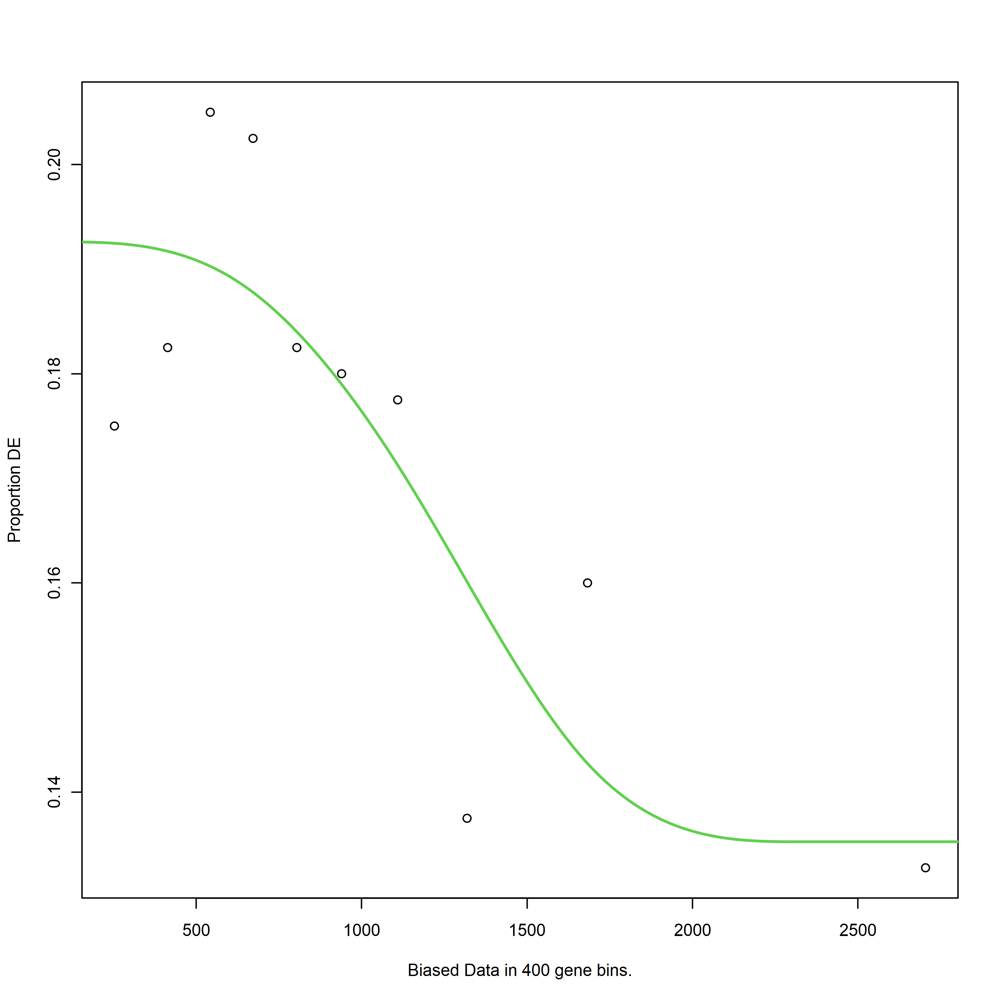

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



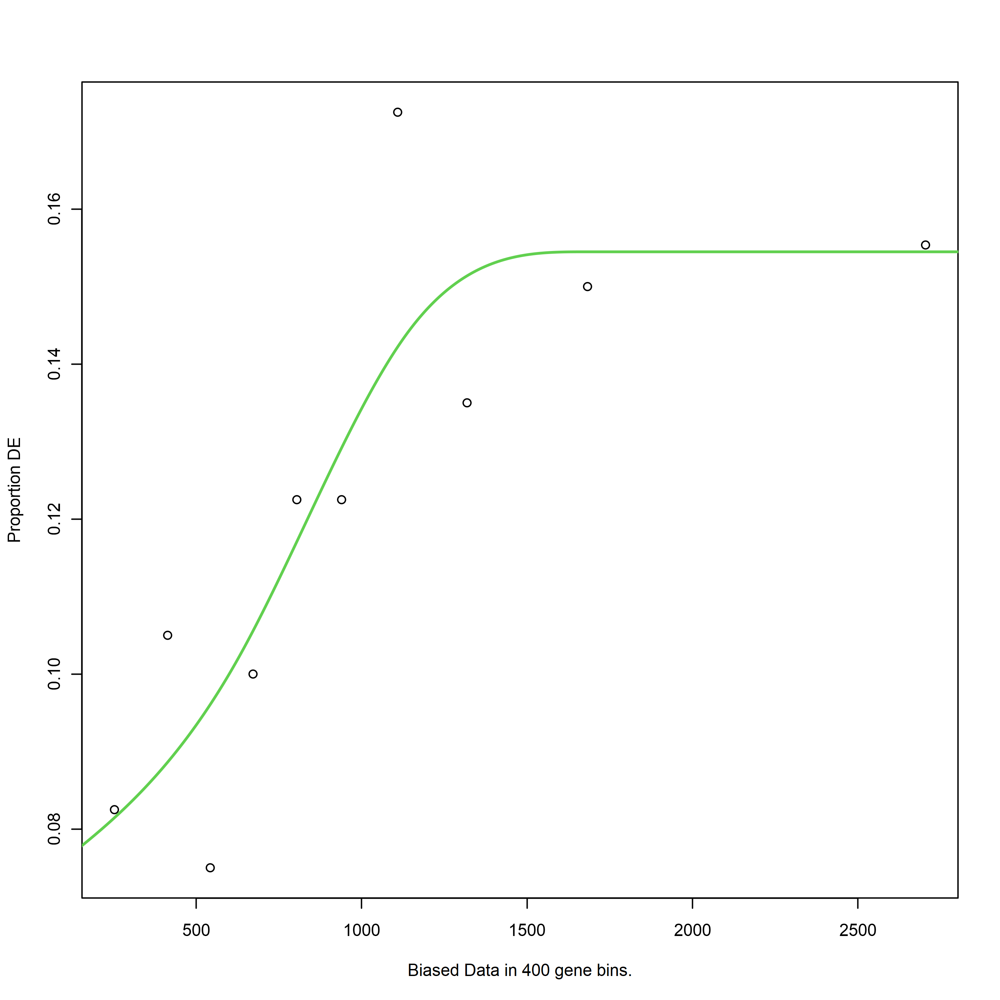

[1] "C3vsC2_rna"
[1] "up"


Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C3vsC2_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


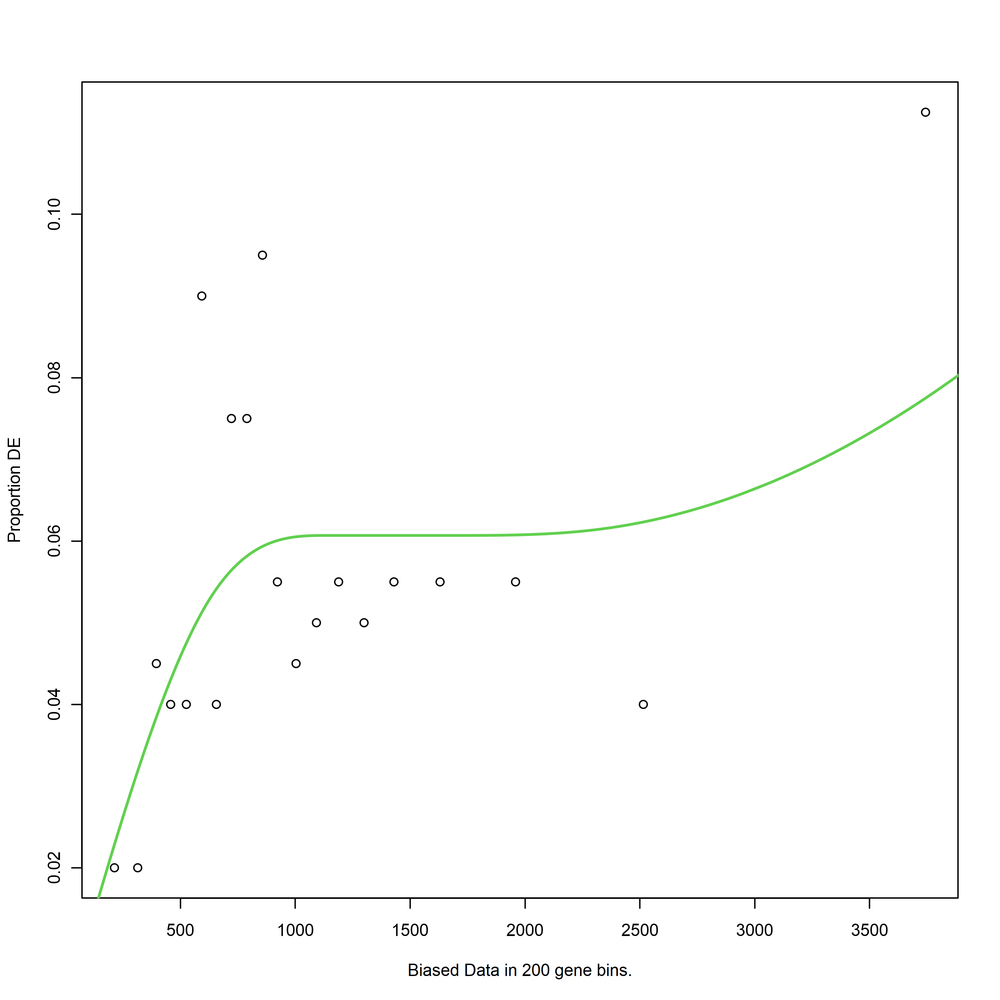

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



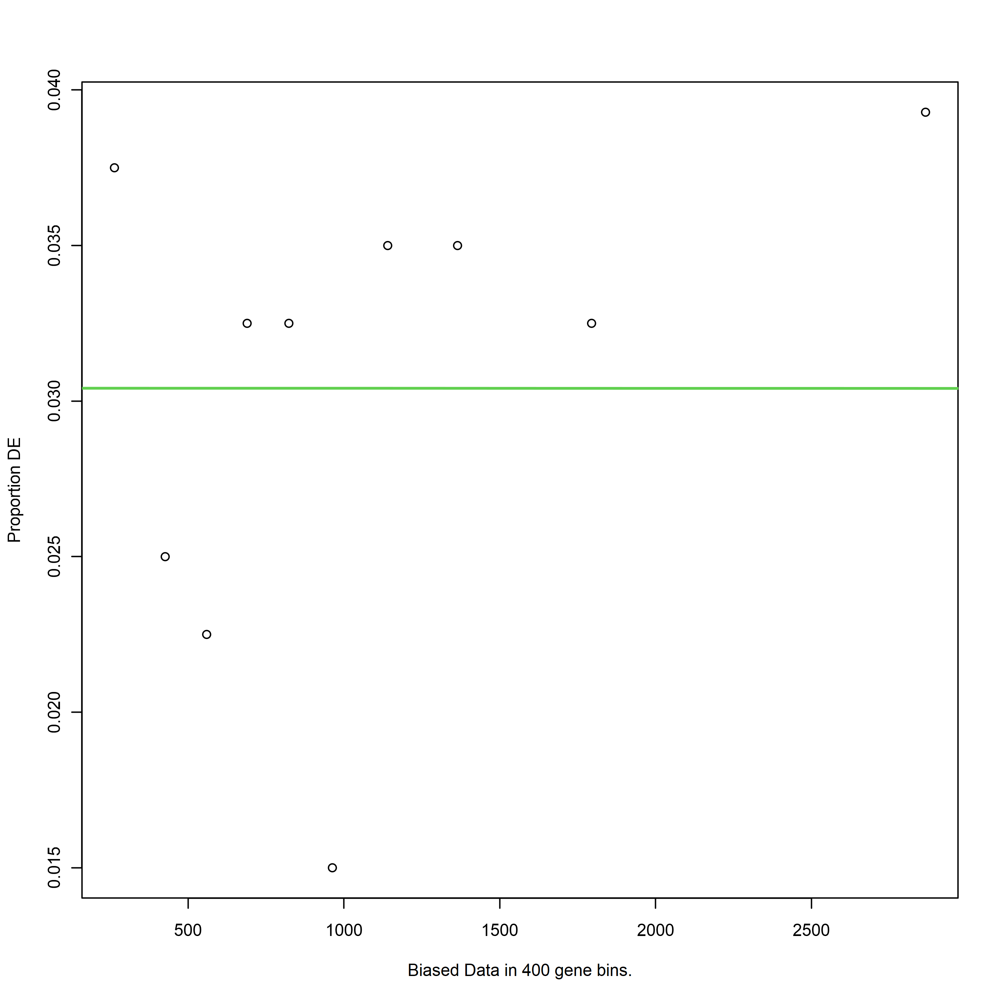

[1] "C3vsC2_rna"
[1] "up"


Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C3vsC2_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


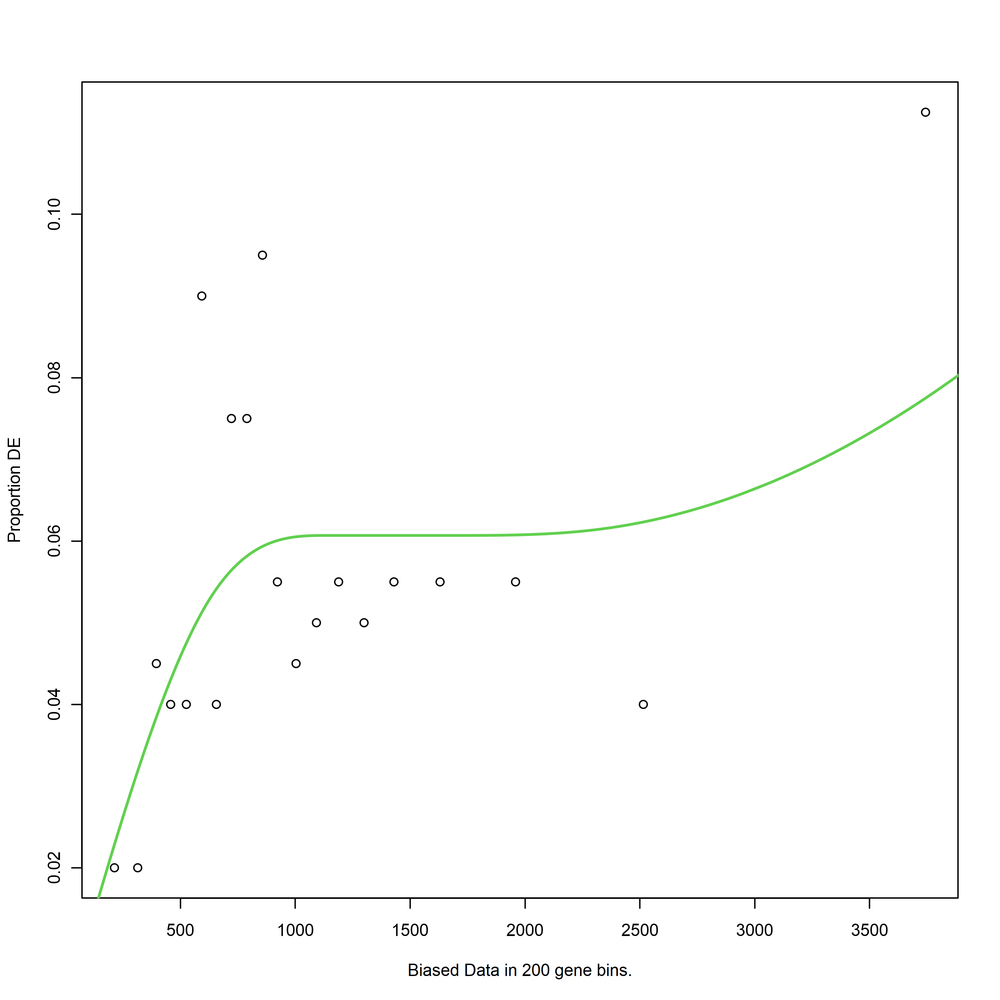

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



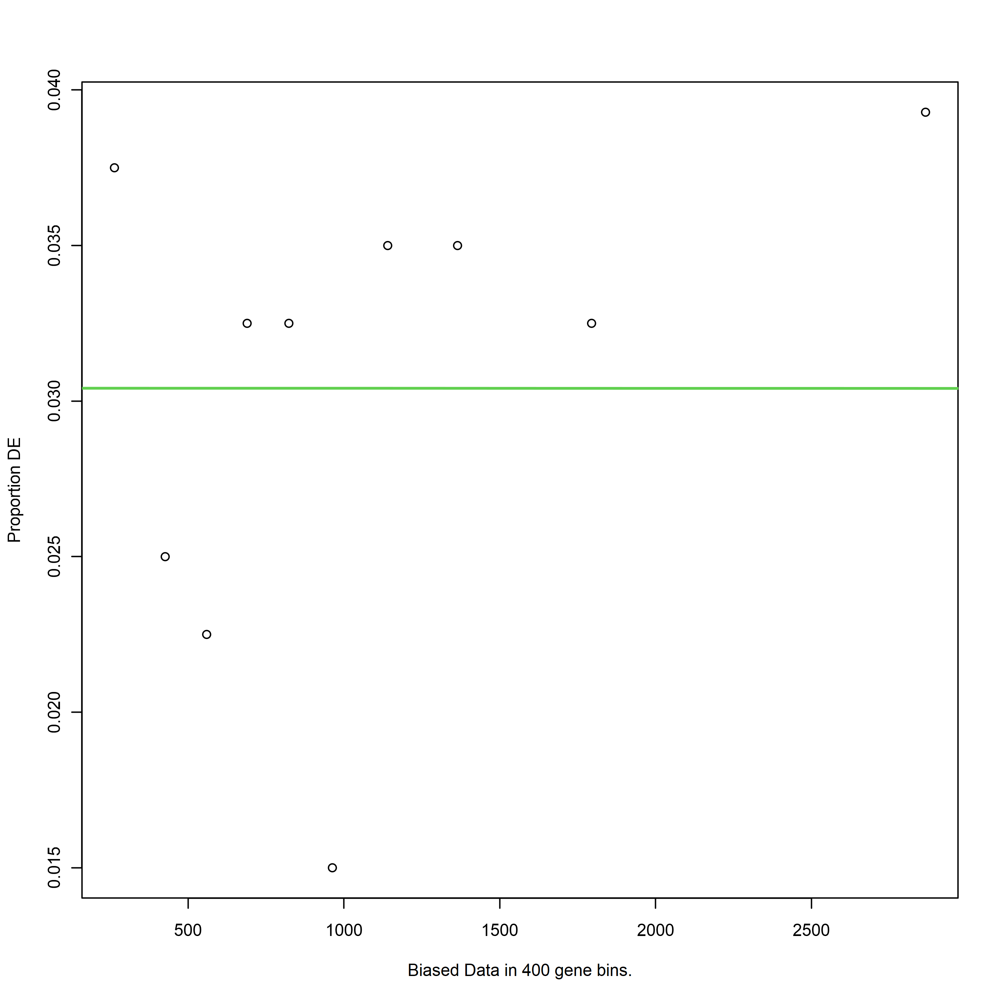

[1] "C3vsC2_rna"
[1] "up"


Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C3vsC2_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


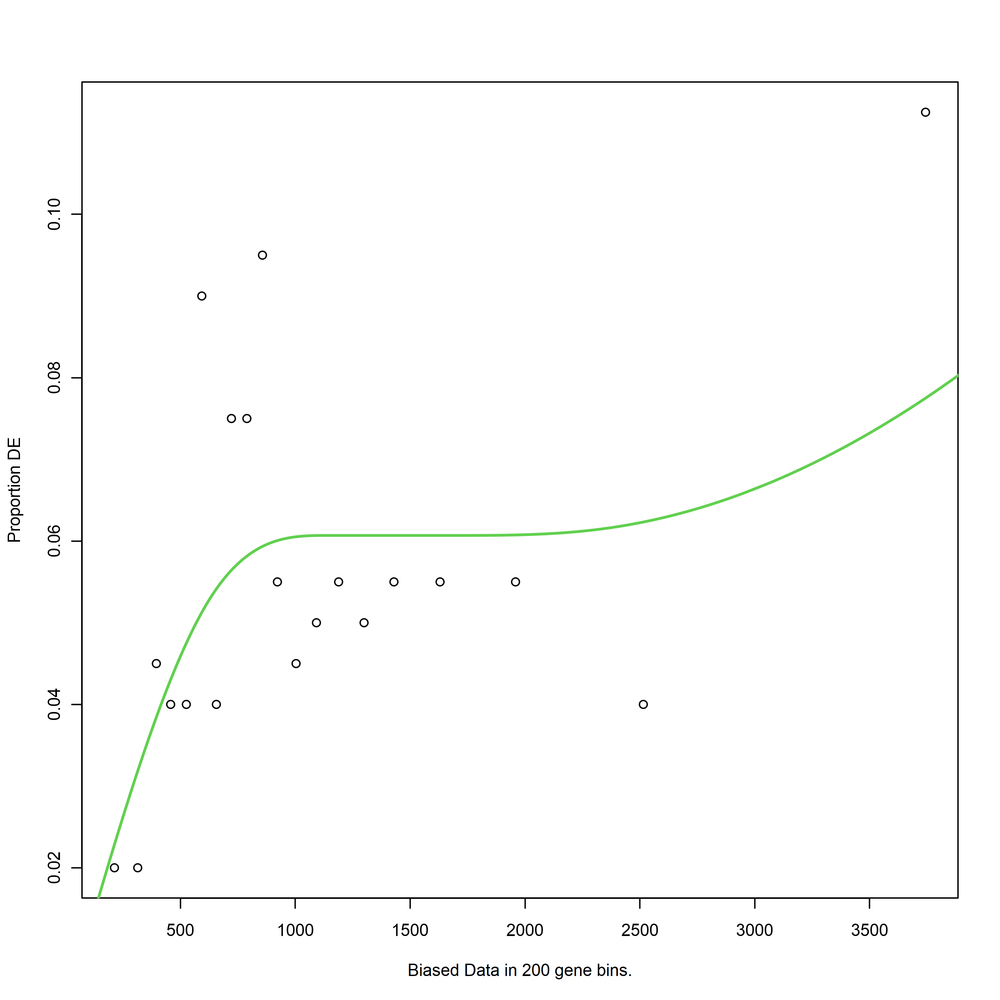

Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



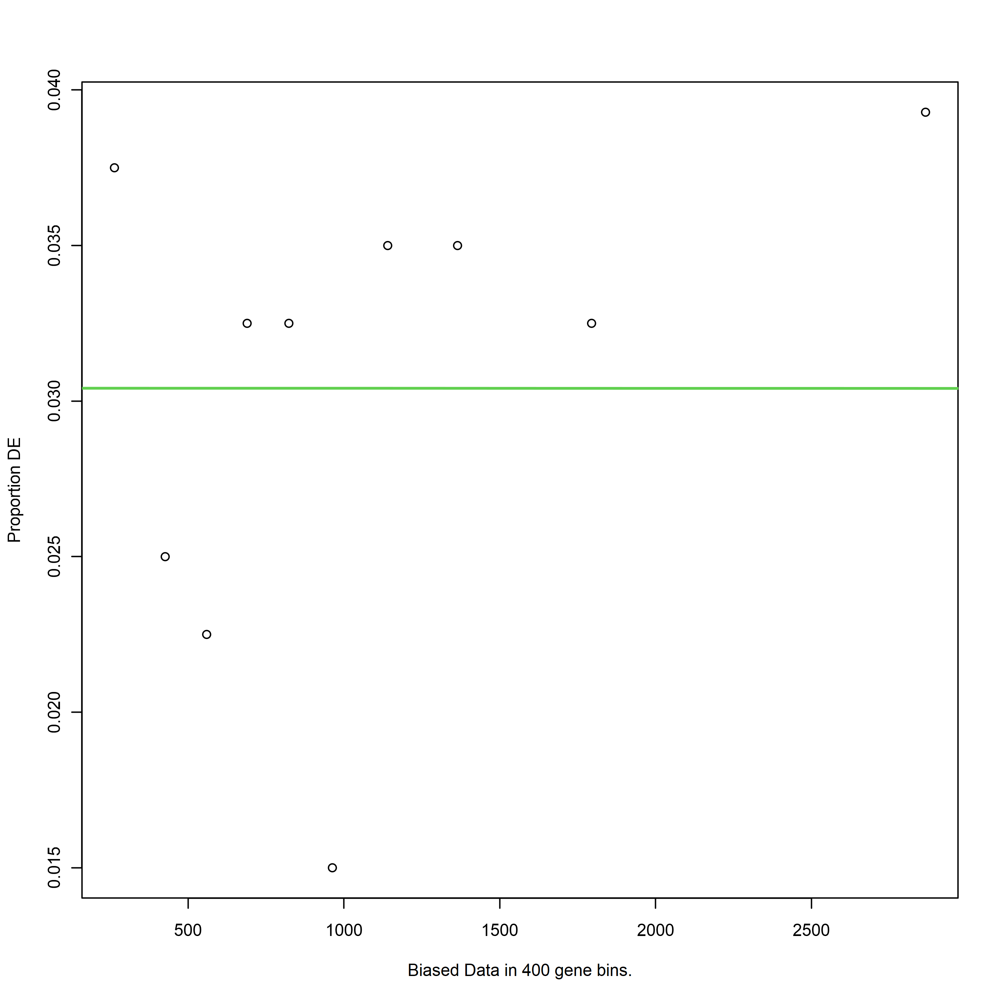

[1] "C3vsC2_rna"
[1] "up"


Using manually entered categories.

For 54 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C4vsC3_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


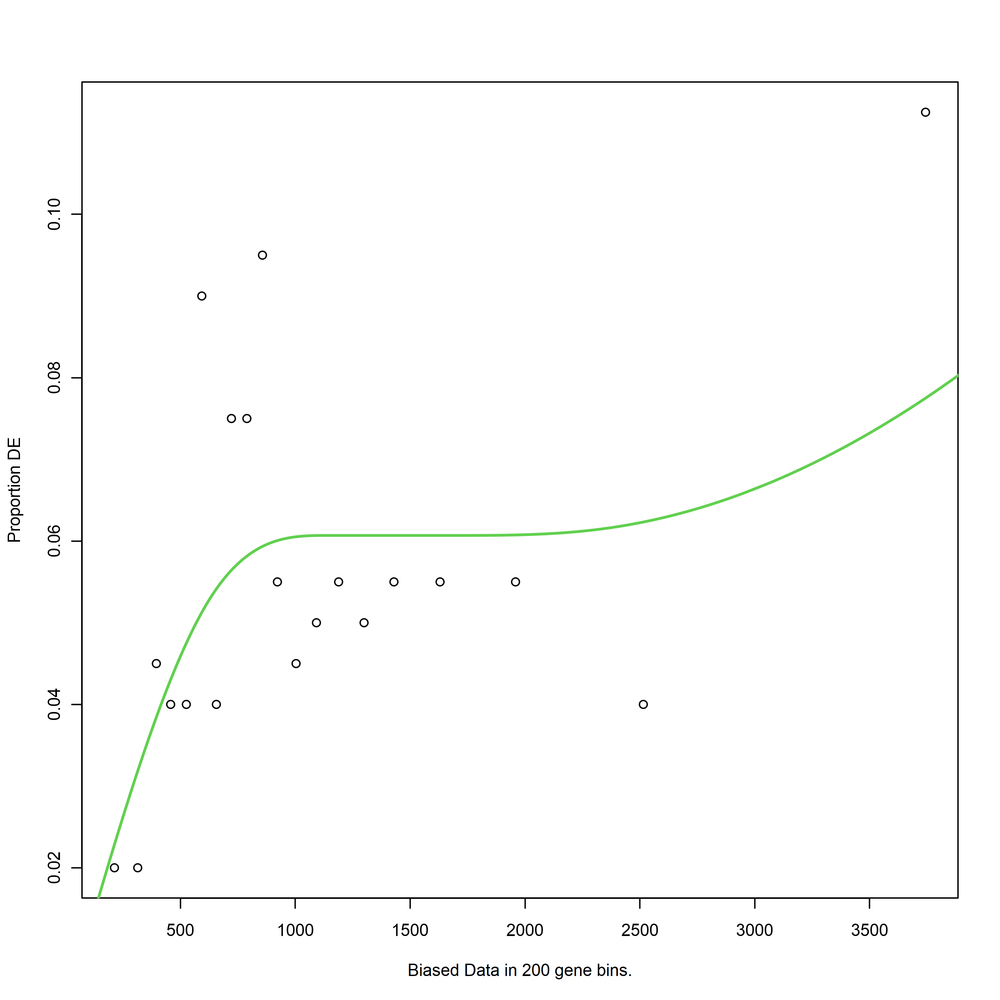

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C4vsC3_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


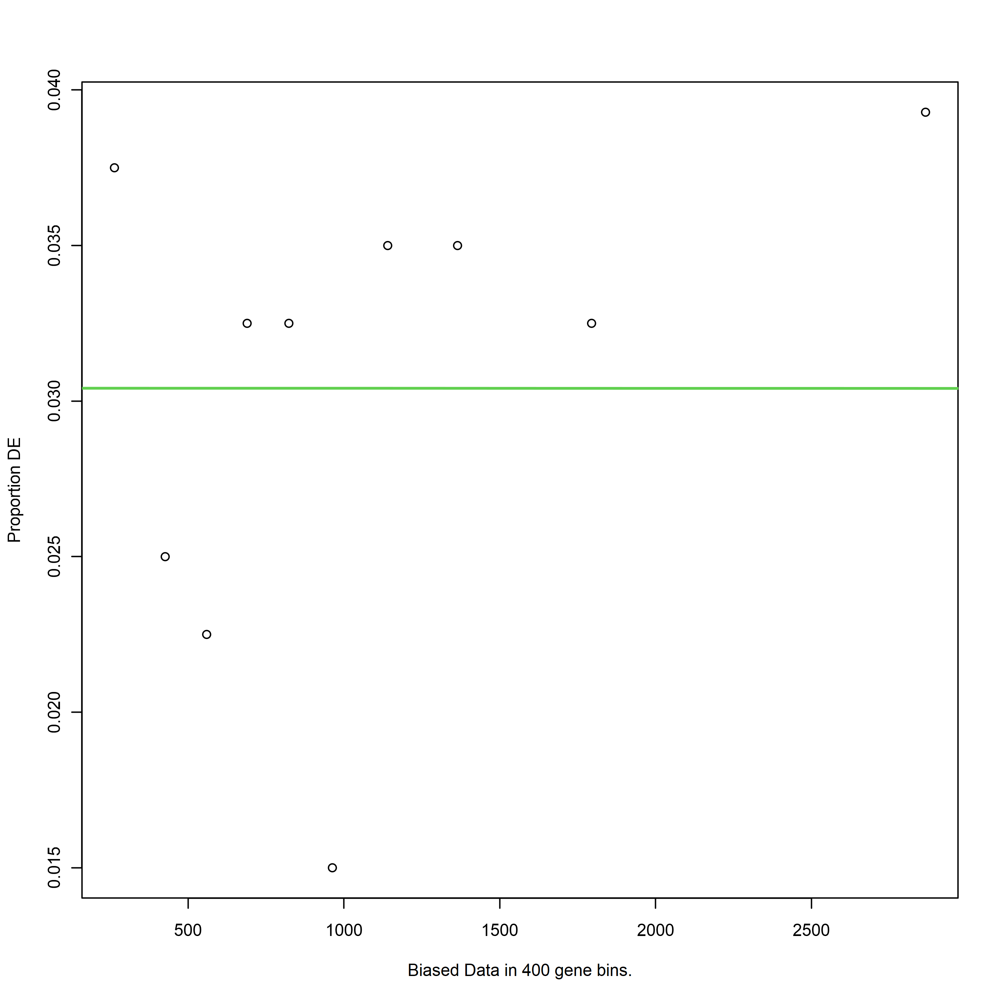

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C4vsC3_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


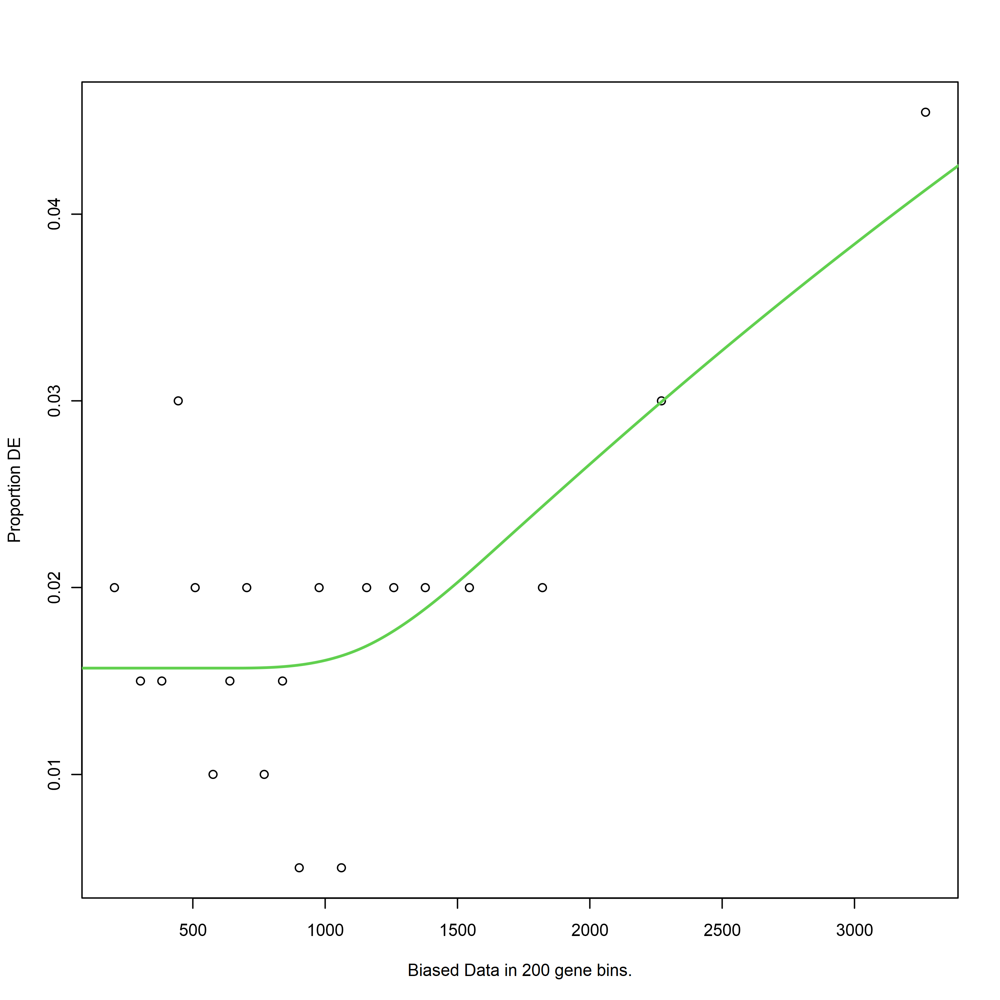

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C4vsC3_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


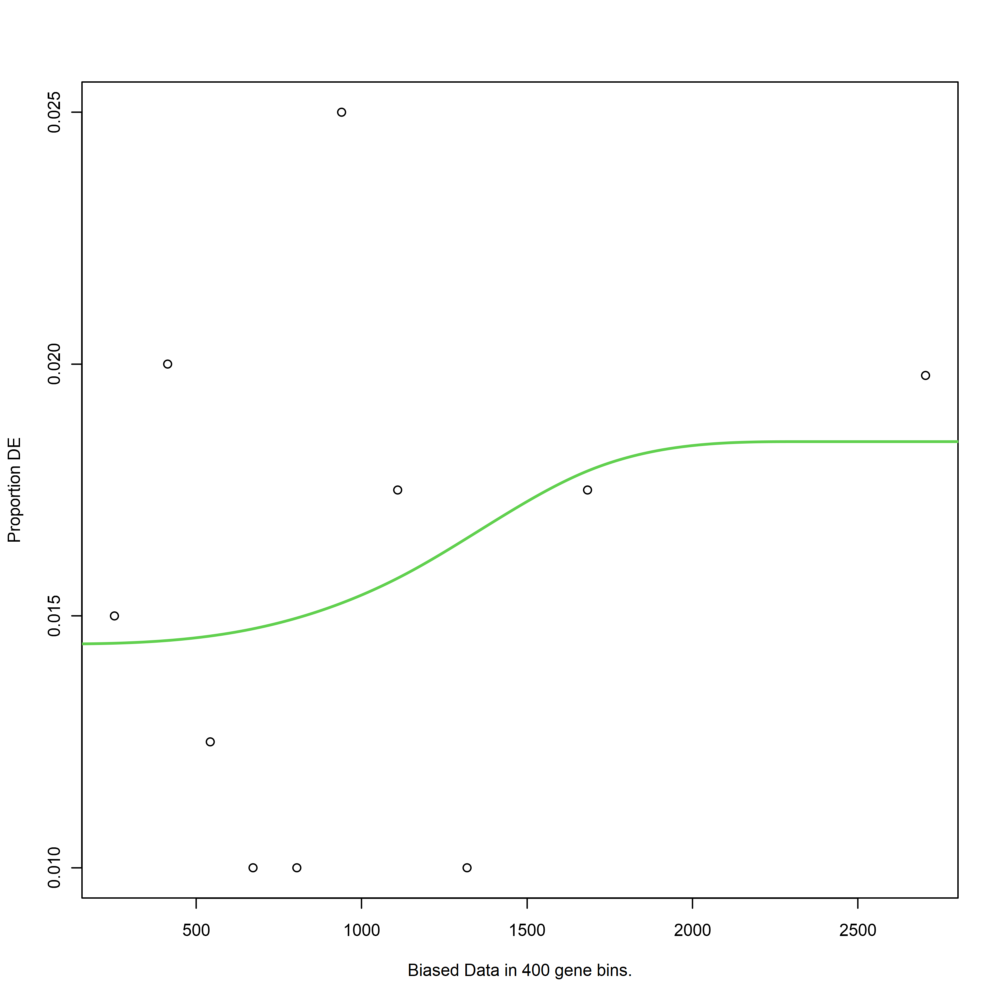

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C4vsC3_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


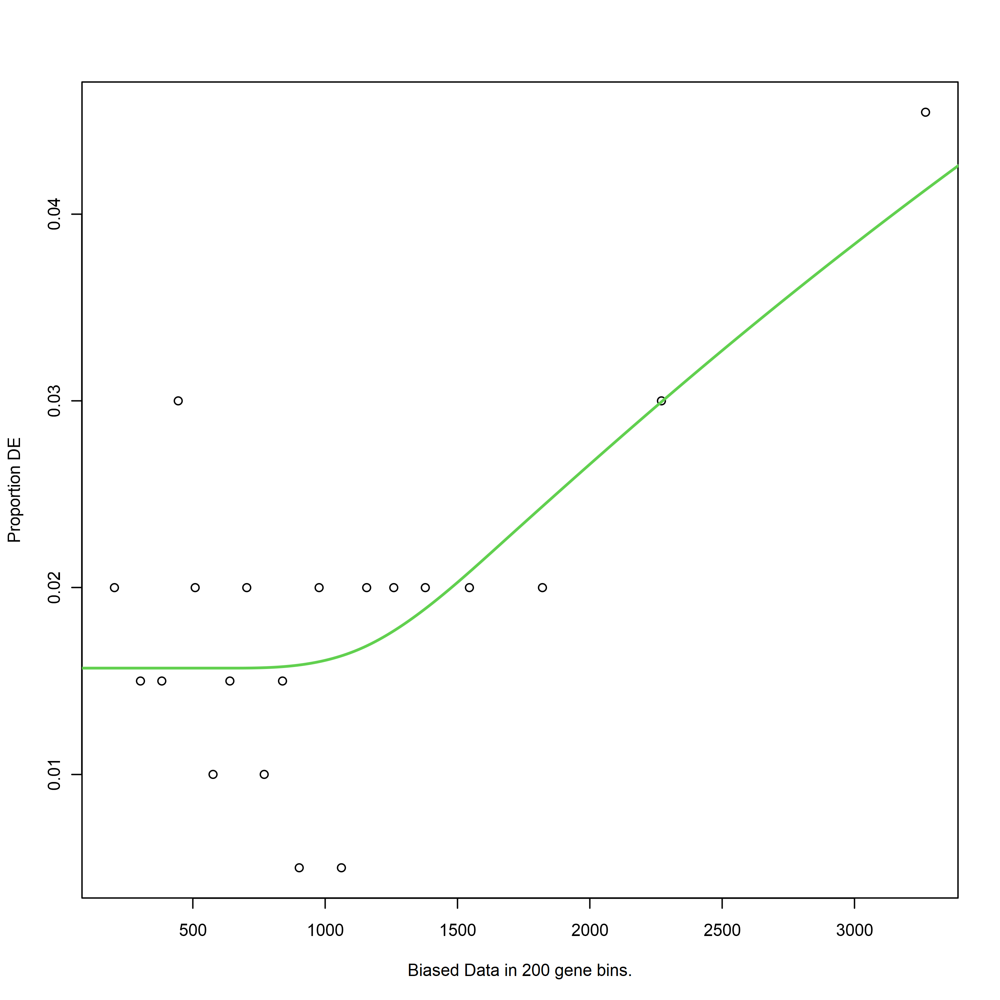

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C4vsC3_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


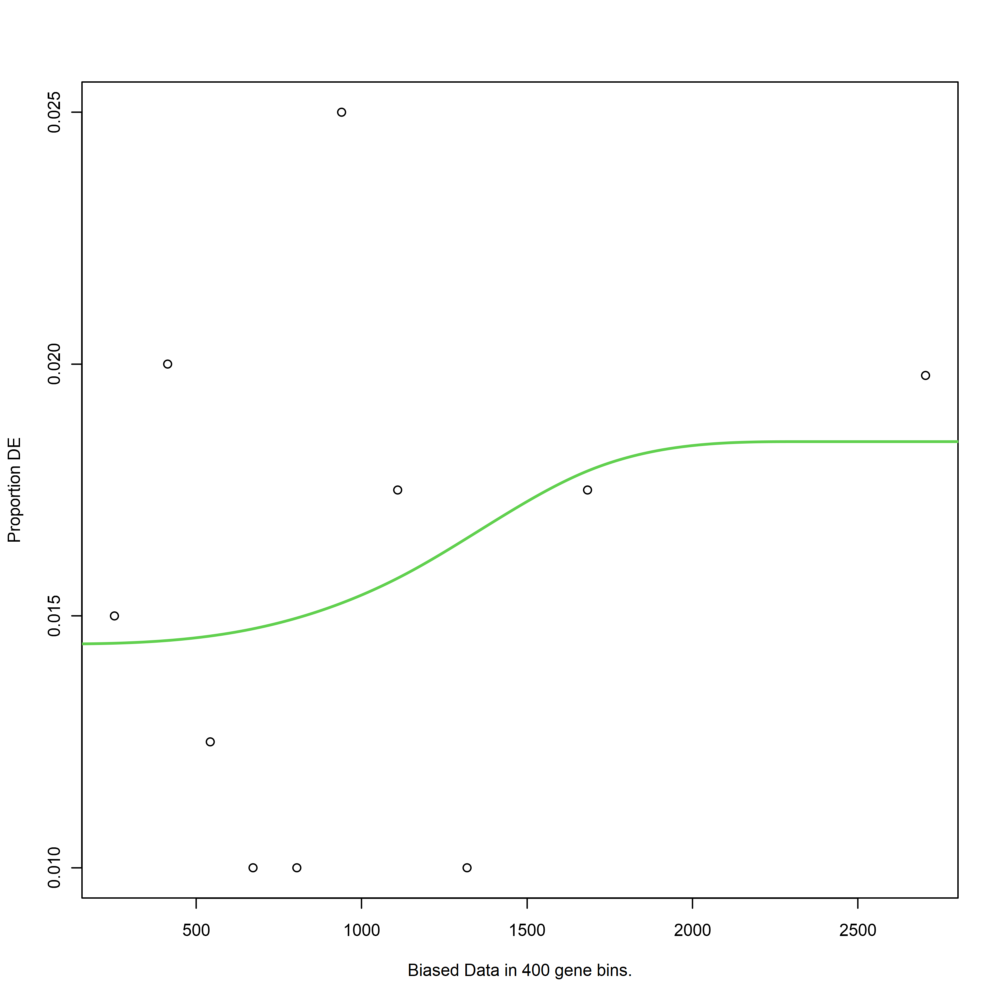

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C4vsC3_rna"
[1] "down"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


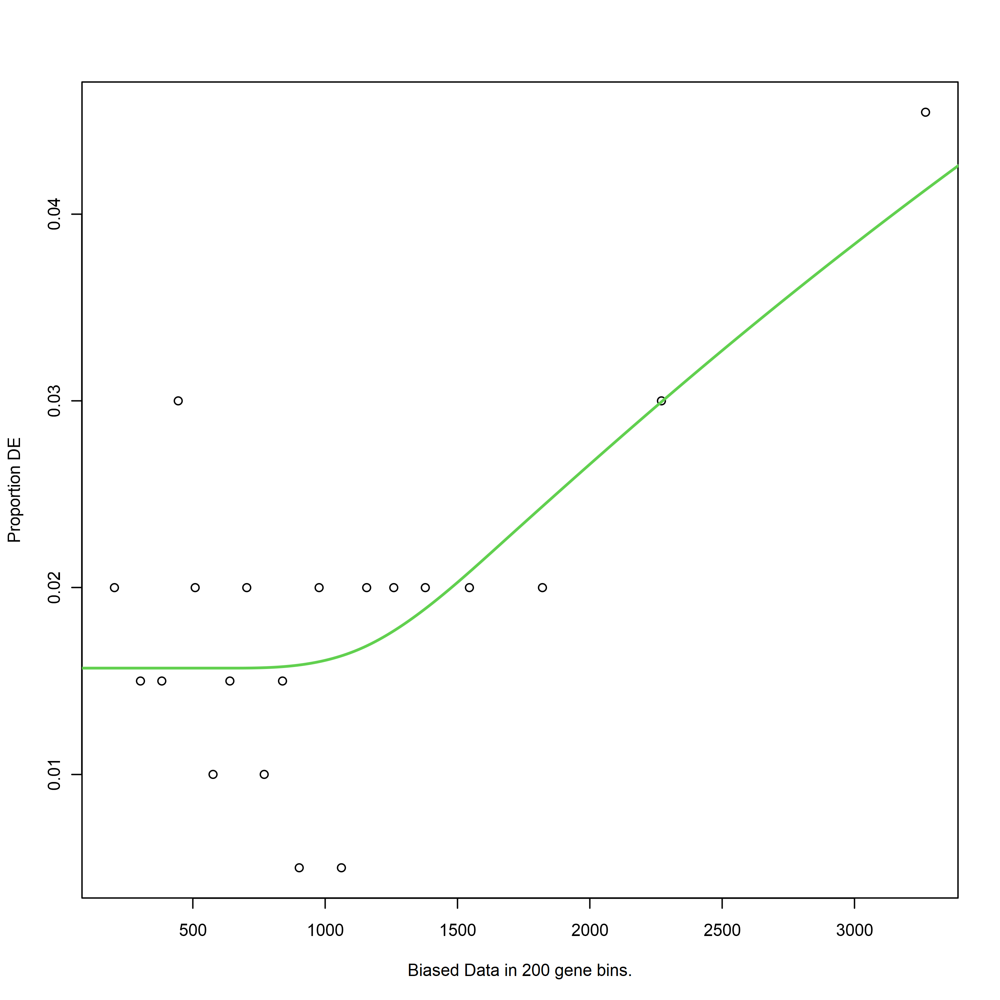

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



[1] "C4vsC3_rna"
[1] "up"


Warning message in pcls(G):
"initial point very close to some inequality constraints"


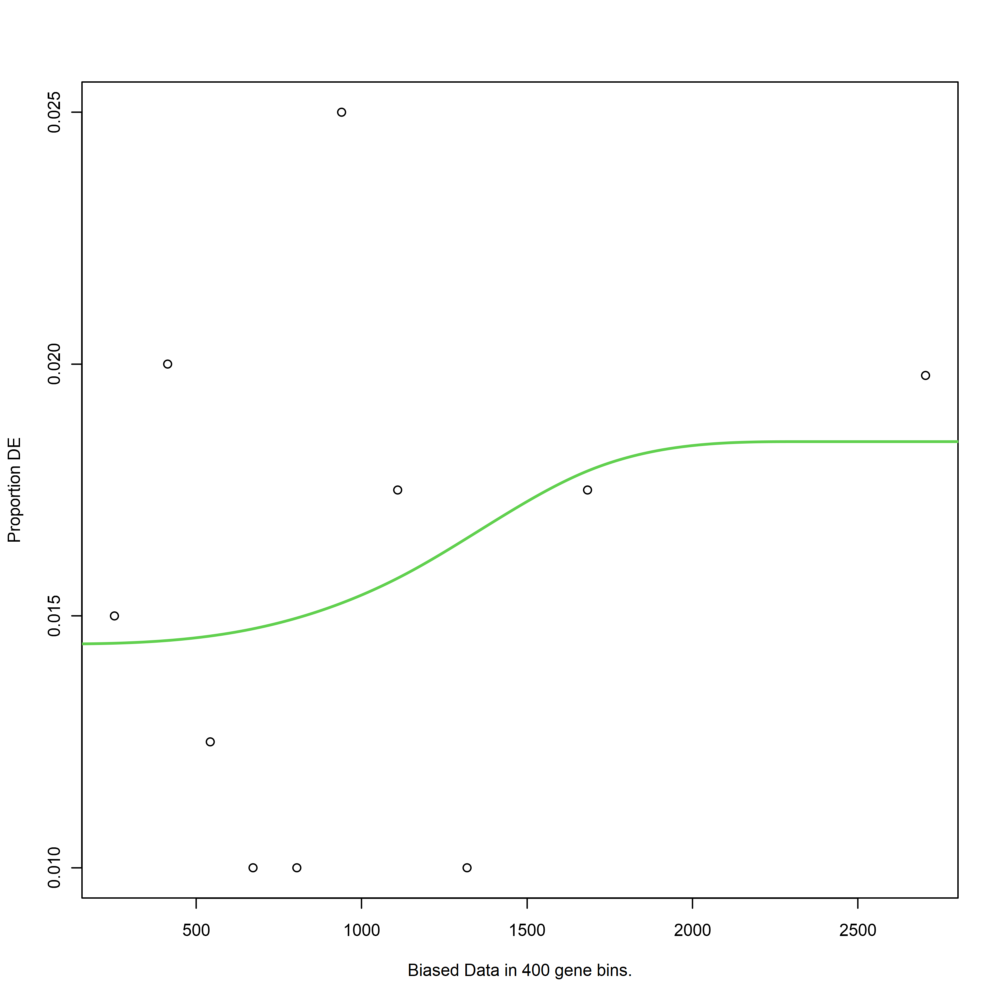

Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



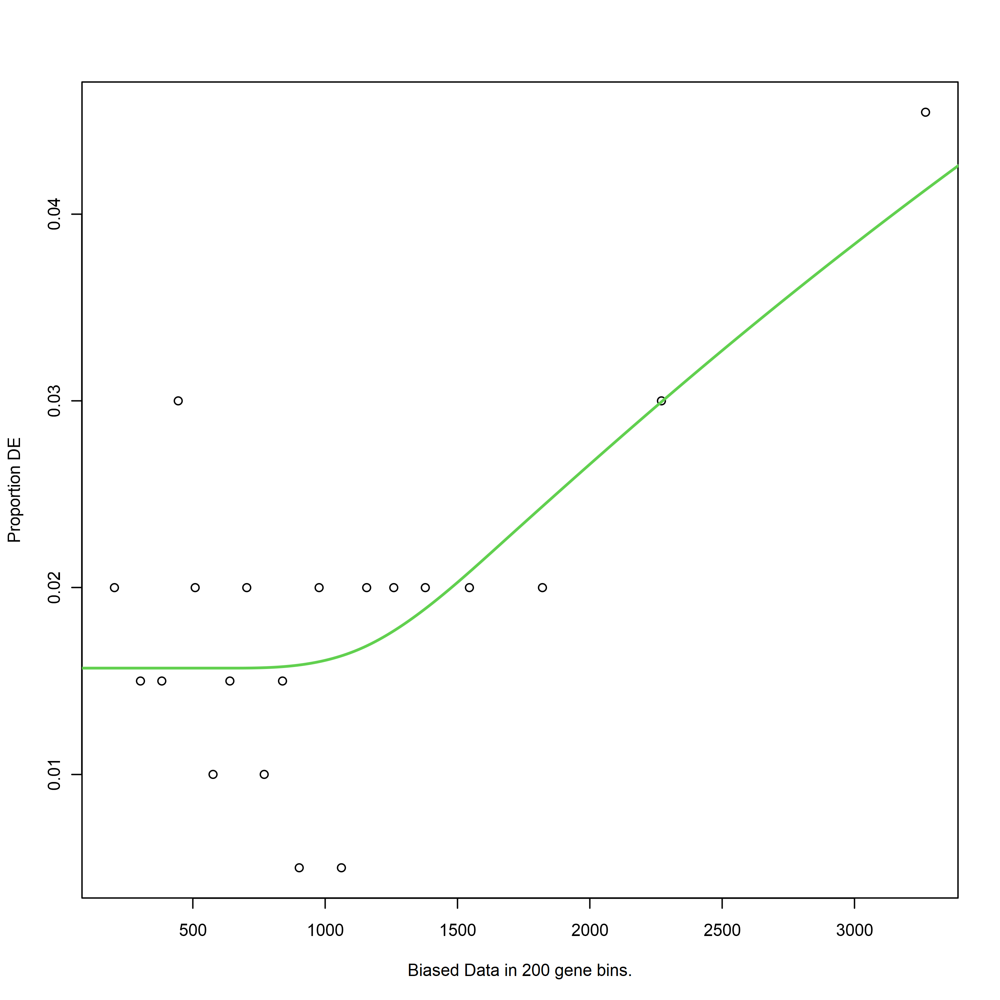

[1] "C5vsC4_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



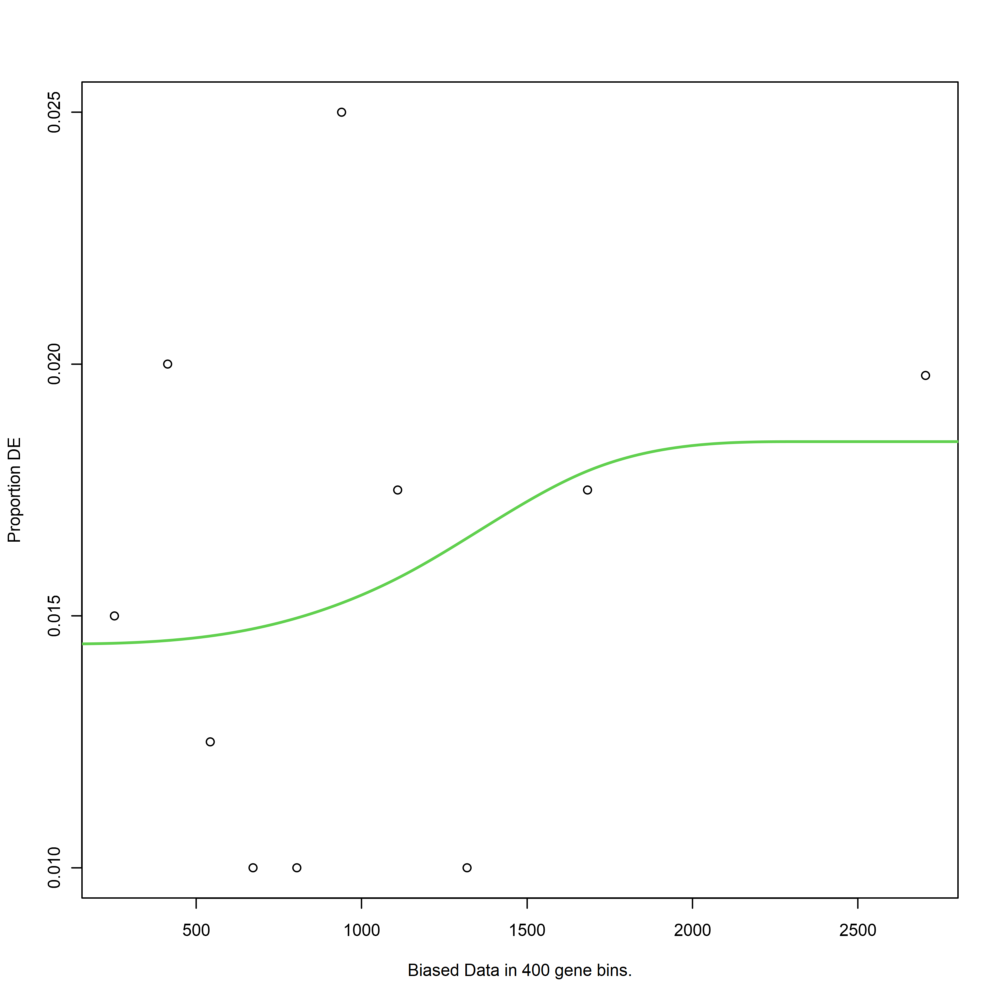

[1] "C5vsC4_rna"
[1] "up"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



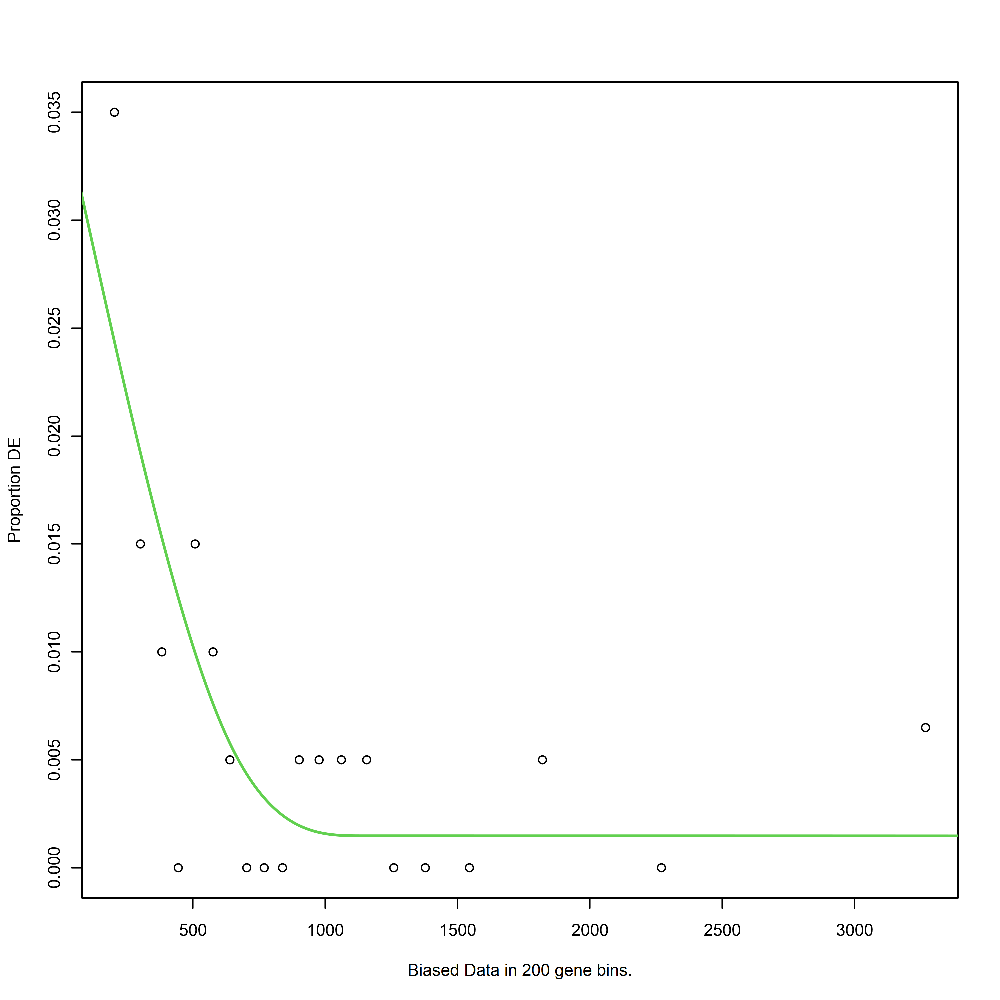

[1] "C5vsC4_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



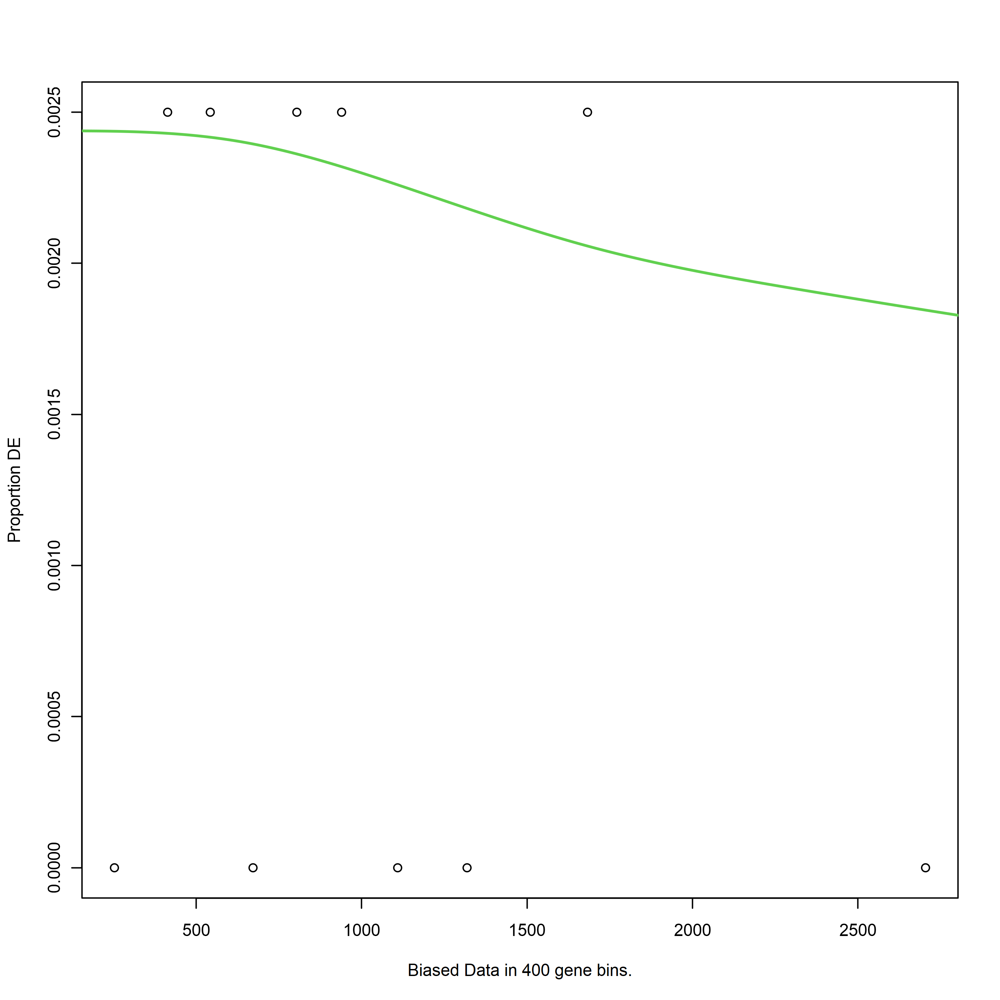

[1] "C5vsC4_rna"
[1] "up"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



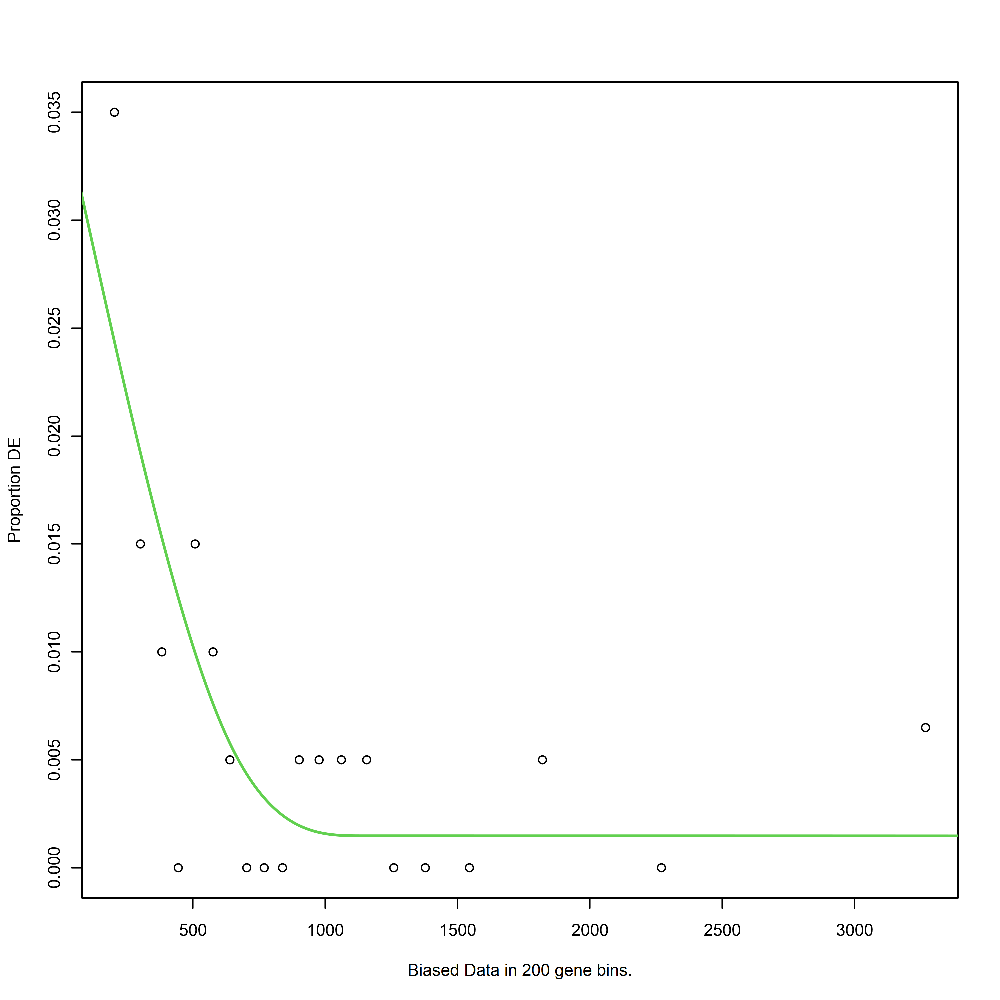

[1] "C5vsC4_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



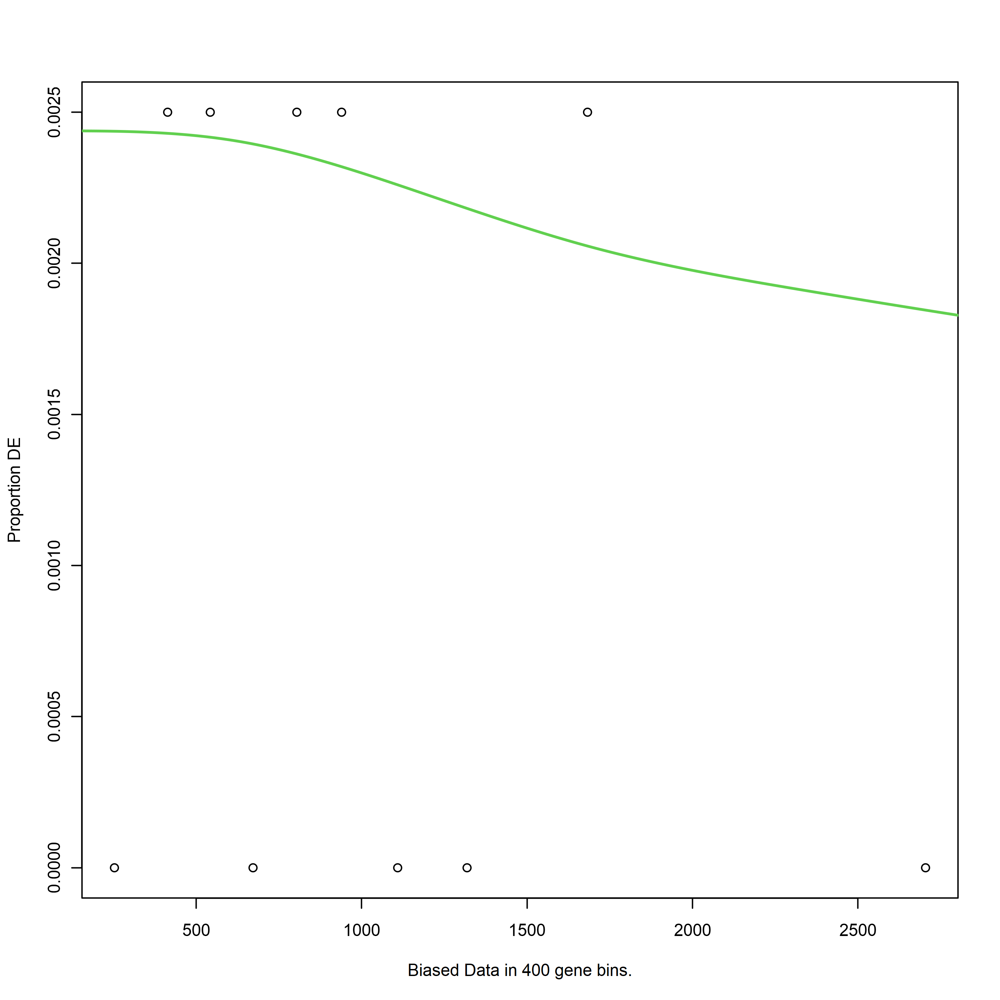

[1] "C5vsC4_rna"
[1] "up"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



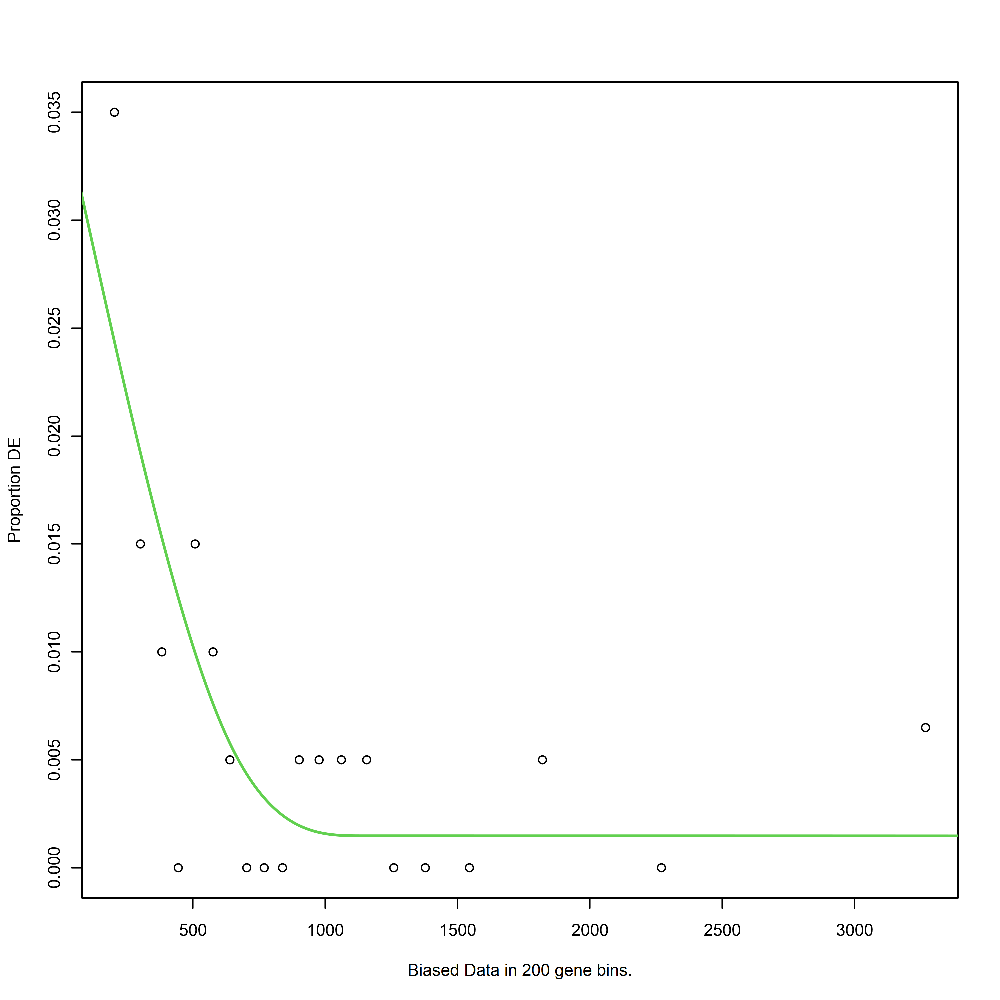

[1] "C5vsC4_rna"
[1] "down"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



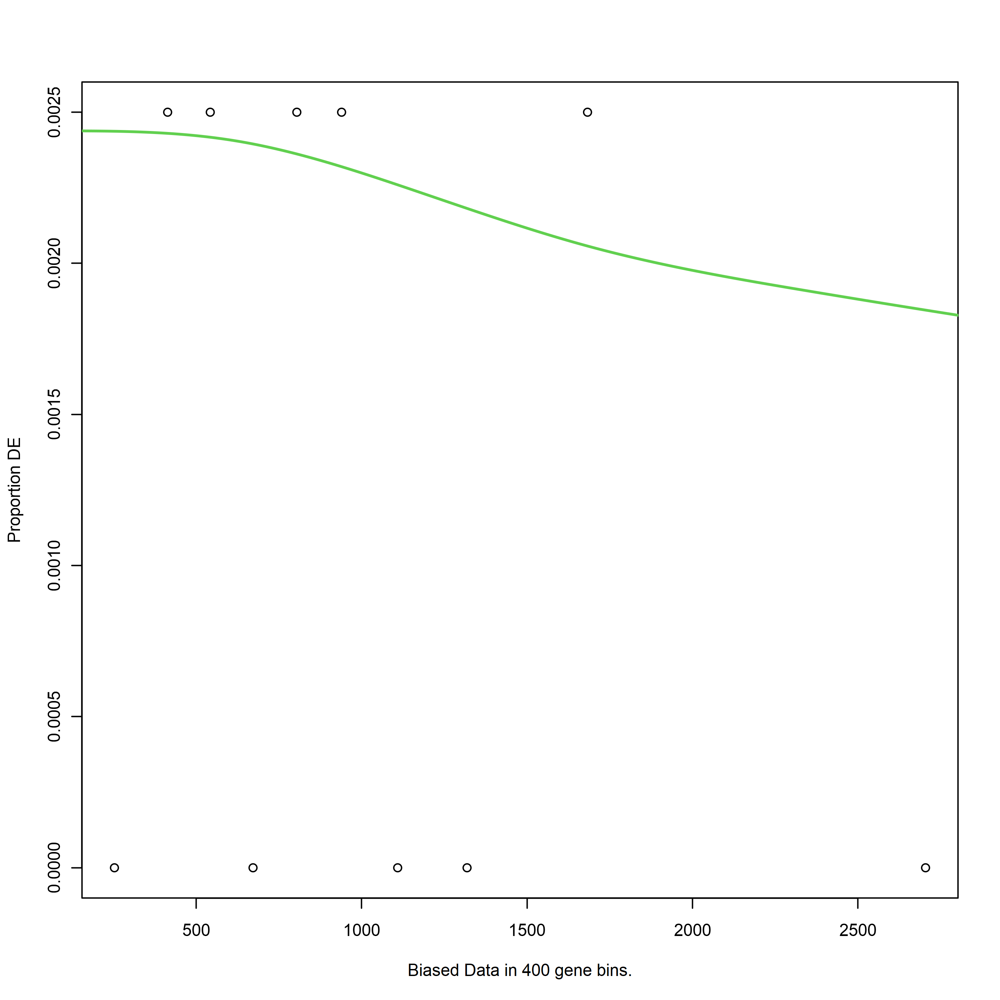

[1] "C5vsC4_rna"
[1] "up"


Using manually entered categories.

For 58 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...



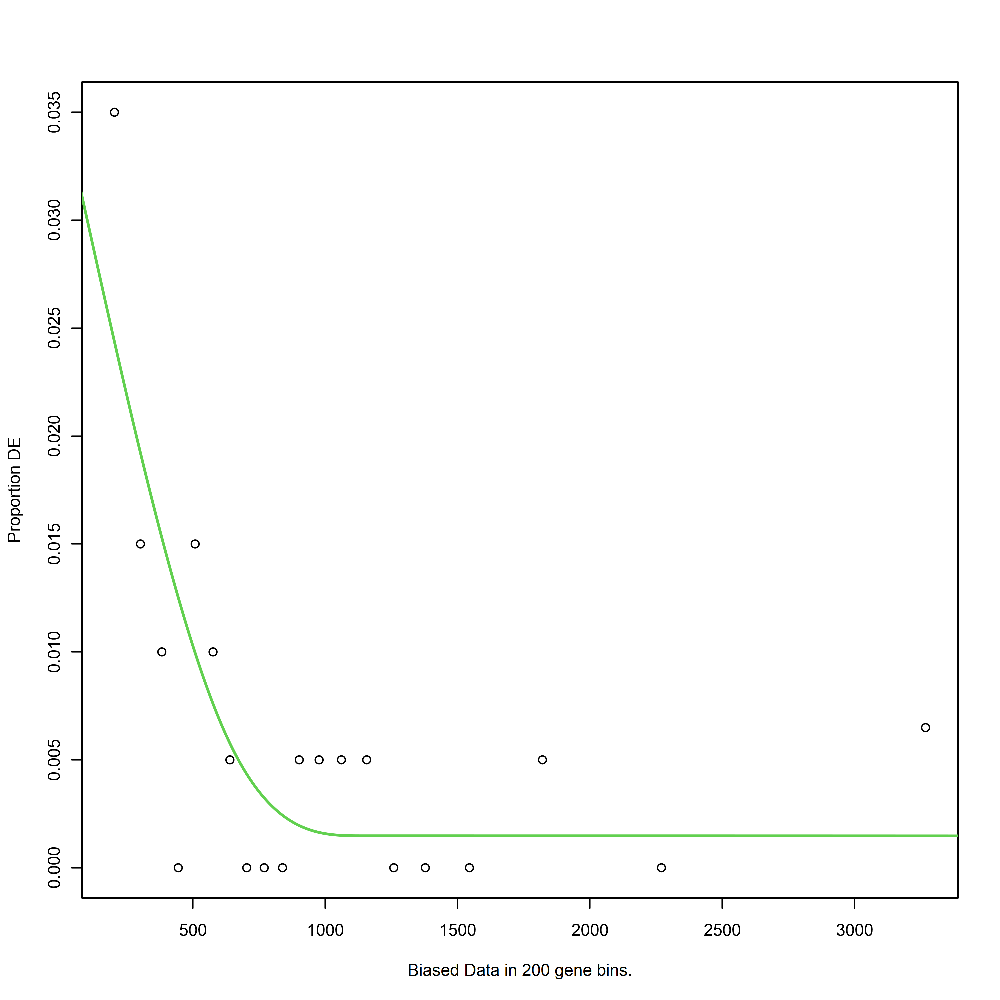

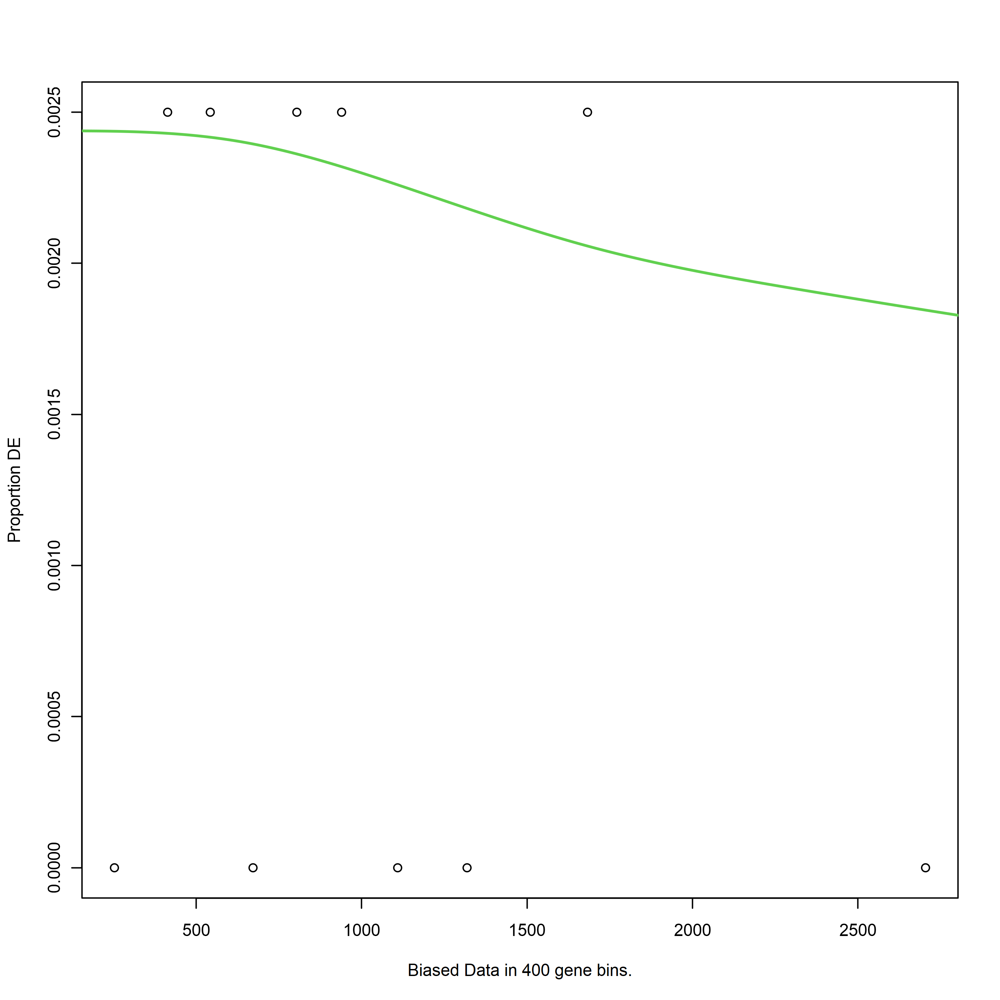

In [62]:
dlist = list()

for (contrastname in unique(df_all$contrast1)) 
{
    for (col in c('is_signal_b','ROS_degradation_b','Protease_Aminase_b','EXOprotease')) 
        {
        for (test in c('down', 'up')) #, 'is_de')) 
            {
              dlist[[length(dlist) + 1]] <- run_enrichment(contrastname, col, test)
        }

    }
}
goseq_res = bind_rows(dlist)


In [64]:
t(goseq_res)

category,FALSE,TRUE,TRUE,FALSE,TRUE,FALSE,TRUE,FALSE,FALSE,TRUE,⋯,FALSE,TRUE,FALSE,TRUE,FALSE,TRUE,FALSE,TRUE,FALSE,TRUE
over_represented_pvalue,0.000000e+00,1.000000e+00,7.639912e-15,1.000000e+00,5.119669e-01,8.496454e-01,1.840711e-01,9.604863e-01,9.753149e-02,1.000000e+00,⋯,9.795597e-01,1.000000e+00,9.214592e-01,1.000000e+00,9.621211e-01,1.000000e+00,9.731942e-01,1.000000e+00,9.845495e-01,1.000000e+00
padj,0.000000e+00,1.000000e+00,1.527982e-14,1.000000e+00,8.496454e-01,8.496454e-01,3.681422e-01,9.604863e-01,1.950630e-01,1.000000e+00,⋯,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00
under_represented_pvalue,1.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00,8.496454e-01,5.119669e-01,9.604863e-01,1.840711e-01,1.000000e+00,9.753149e-02,⋯,1.000000e+00,9.795597e-01,1.000000e+00,9.214592e-01,1.000000e+00,9.621211e-01,1.000000e+00,9.731942e-01,1.000000e+00,9.845495e-01
numDEInCat,145,3,91,94,1,147,2,183,148,0,⋯,5,0,24,0,5,0,24,0,5,0
numInCat,1768,461,461,1768,12,2217,12,2217,2204,25,⋯,3938,16,3921,33,3921,33,3940,14,3940,14
type,down,down,up,up,down,down,up,up,down,down,⋯,up,up,down,down,up,up,down,down,up,up
categoryname,is_signal_b,is_signal_b,is_signal_b,is_signal_b,ROS_degradation_b,ROS_degradation_b,ROS_degradation_b,ROS_degradation_b,Protease_Aminase_b,Protease_Aminase_b,⋯,ROS_degradation_b,ROS_degradation_b,Protease_Aminase_b,Protease_Aminase_b,Protease_Aminase_b,Protease_Aminase_b,EXOprotease,EXOprotease,EXOprotease,EXOprotease
contrast,C2vsC1_prot,C2vsC1_prot,C2vsC1_prot,C2vsC1_prot,C2vsC1_prot,C2vsC1_prot,C2vsC1_prot,C2vsC1_prot,C2vsC1_prot,C2vsC1_prot,⋯,C5vsC4_rna,C5vsC4_rna,C5vsC4_rna,C5vsC4_rna,C5vsC4_rna,C5vsC4_rna,C5vsC4_rna,C5vsC4_rna,C5vsC4_rna,C5vsC4_rna
organism,HOT1A3,HOT1A3,HOT1A3,HOT1A3,HOT1A3,HOT1A3,HOT1A3,HOT1A3,HOT1A3,HOT1A3,⋯,HOT1A3,HOT1A3,HOT1A3,HOT1A3,HOT1A3,HOT1A3,HOT1A3,HOT1A3,HOT1A3,HOT1A3


In [65]:
goseq_res

category,over_represented_pvalue,padj,under_represented_pvalue,numDEInCat,numInCat,type,categoryname,contrast,organism
<chr>,<dbl>,<dbl>,<dbl>,<int>,<int>,<chr>,<chr>,<chr>,<chr>
FALSE,0.000000e+00,0.000000e+00,1.000000e+00,145,1768,down,is_signal_b,C2vsC1_prot,HOT1A3
TRUE,1.000000e+00,1.000000e+00,0.000000e+00,3,461,down,is_signal_b,C2vsC1_prot,HOT1A3
TRUE,7.639912e-15,1.527982e-14,1.000000e+00,91,461,up,is_signal_b,C2vsC1_prot,HOT1A3
FALSE,1.000000e+00,1.000000e+00,0.000000e+00,94,1768,up,is_signal_b,C2vsC1_prot,HOT1A3
TRUE,5.119669e-01,8.496454e-01,8.496454e-01,1,12,down,ROS_degradation_b,C2vsC1_prot,HOT1A3
FALSE,8.496454e-01,8.496454e-01,5.119669e-01,147,2217,down,ROS_degradation_b,C2vsC1_prot,HOT1A3
TRUE,1.840711e-01,3.681422e-01,9.604863e-01,2,12,up,ROS_degradation_b,C2vsC1_prot,HOT1A3
FALSE,9.604863e-01,9.604863e-01,1.840711e-01,183,2217,up,ROS_degradation_b,C2vsC1_prot,HOT1A3
FALSE,9.753149e-02,1.950630e-01,1.000000e+00,148,2204,down,Protease_Aminase_b,C2vsC1_prot,HOT1A3


In [77]:
goseq_res = goseq_res %>% 
    filter(category == TRUE) %>%
    
    mutate(padj = over_represented_pvalue, PATH = categoryname)


In [78]:
t(head(goseq_res))

,1,2,3,4,5,6
category,TRUE,TRUE,TRUE,TRUE,TRUE,TRUE
over_represented_pvalue,1.000000e+00,7.639912e-15,5.119669e-01,1.840711e-01,1.000000e+00,3.942063e-01
padj,1.000000e+00,7.639912e-15,5.119669e-01,1.840711e-01,1.000000e+00,3.942063e-01
under_represented_pvalue,0.00000000,1.00000000,0.84964540,0.96048627,0.09753149,0.79720971
numDEInCat,3,91,1,2,0,4
numInCat,461,461,12,12,25,25
type,down,up,down,up,down,up
categoryname,is_signal_b,is_signal_b,ROS_degradation_b,ROS_degradation_b,Protease_Aminase_b,Protease_Aminase_b
contrast,C2vsC1_prot,C2vsC1_prot,C2vsC1_prot,C2vsC1_prot,C2vsC1_prot,C2vsC1_prot
organism,HOT1A3,HOT1A3,HOT1A3,HOT1A3,HOT1A3,HOT1A3


In [79]:
goseq_res %>% write_csv(file.path('DE_results', 'HOT1A3_GOSEQ_results_ROS_exoprotease.csv'))

In [44]:
#df_all %>% write_csv(file.path('DE_results', 'HOT1A3_all_FC_results.csv'))

In [71]:
top10 = goseq_res %>% 
  #filter(enrich == 'sub') %>%
  #filter(enrich == 'path') %>%
  filter(type %in% c('up', 'down')) %>%
  arrange(over_represented_pvalue) %>%
  head(n=50) 
top10 
#hpath_df %>% filter(path %in% top10$PATH) %>% select(main,sub, path) %>% distinct() %>% arrange(main)

,category,over_represented_pvalue,padj,under_represented_pvalue,numDEInCat,numInCat,type,categoryname,contrast,organism
,<chr>,<dbl>,<dbl>,<dbl>,<int>,<int>,<chr>,<chr>,<chr>,<chr>
1,TRUE,3.213484e-28,6.426968e-28,1.0000000,187,461,up,is_signal_b,A5vsA3_prot,HOT1A3
2,TRUE,3.623247e-28,7.246494e-28,1.0000000,208,461,up,is_signal_b,A5vsA1_prot,HOT1A3
3,TRUE,7.740524e-28,1.548105e-27,1.0000000,125,461,up,is_signal_b,A3vsA1_prot,HOT1A3
4,TRUE,7.639912e-15,1.527982e-14,1.0000000,91,461,up,is_signal_b,C2vsC1_prot,HOT1A3
5,TRUE,2.330217e-12,4.660434e-12,1.0000000,159,461,up,is_signal_b,C4vsC1_prot,HOT1A3
6,TRUE,3.772784e-12,7.545568e-12,1.0000000,181,461,up,is_signal_b,C5vsC1_prot,HOT1A3
7,TRUE,3.772784e-12,7.545568e-12,1.0000000,181,461,up,is_signal_b,C3vsC2_prot,HOT1A3
8,TRUE,3.772784e-12,7.545568e-12,1.0000000,181,461,up,is_signal_b,C4vsC3_prot,HOT1A3
9,TRUE,3.772784e-12,7.545568e-12,1.0000000,181,461,up,is_signal_b,C5vsC4_prot,HOT1A3


In [49]:
sessionInfo()

R version 4.2.0 (2022-04-22 ucrt)
Platform: x86_64-w64-mingw32/x64 (64-bit)
Running under: Windows 10 x64 (build 26100)

Matrix products: default

locale:
[1] LC_COLLATE=English_Israel.utf8  LC_CTYPE=English_Israel.utf8   
[3] LC_MONETARY=English_Israel.utf8 LC_NUMERIC=C                   
[5] LC_TIME=English_Israel.utf8    

attached base packages:
[1] grid      stats4    stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] ComplexHeatmap_2.14.0       ggrepel_0.9.1              
 [3] ComplexUpset_1.3.3          circlize_0.4.15            
 [5] corrplot_0.92               pheatmap_1.0.12            
 [7] lubridate_1.9.2             forcats_1.0.0              
 [9] stringr_1.5.0               dplyr_1.1.0                
[11] purrr_1.0.1                 readr_2.1.4                
[13] tidyr_1.3.0                 tibble_3.1.8               
[15] tidyverse_2.0.0             readxl_1.4.2               
[17] goseq_1.50.0                gen